<a href="https://colab.research.google.com/github/ahmadsetiawann/MachineLearning/blob/main/Klasifikasi_Citra_Ekspresi_Wajah_Skripsi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle

from google.colab import files

uploaded = files.upload()
for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

# Then move kaggle.json into the folder where the API expects to find it.
!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json


In [ ]:
!kaggle datasets download "khalilhamdy/face-expression"

 99% 167M/169M [00:07<00:00, 38.0MB/s]
100% 169M/169M [00:07<00:00, 22.9MB/s]


In [ ]:
!unzip face-expression.zip

Streaming output truncated to the last 5000 lines.
  inflating: images/validation/fear/8797.jpg  
  inflating: images/validation/fear/8818.jpg  
  inflating: images/validation/fear/886.jpg  
  inflating: images/validation/fear/9037.jpg  
  inflating: images/validation/fear/9040.jpg  
  inflating: images/validation/fear/9101.jpg  
  inflating: images/validation/fear/911.jpg  
  inflating: images/validation/fear/9179.jpg  
  inflating: images/validation/fear/9205.jpg  
  inflating: images/validation/fear/9232.jpg  
  inflating: images/validation/fear/9251.jpg  
  inflating: images/validation/fear/9261.jpg  
  inflating: images/validation/fear/9281.jpg  
  inflating: images/validation/fear/9302.jpg  
  inflating: images/validation/fear/9333.jpg  
  inflating: images/validation/fear/9369.jpg  
  inflating: images/validation/fear/9370.jpg  
  inflating: images/validation/fear/9474.jpg  
  inflating: images/validation/fear/949.jpg  
  inflating: images/validation/fear/9602.jpg  
  inflating:

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import os
import keras

# Importing Deep Learning Libraries
from tensorflow.keras.preprocessing.image import load_img, img_to_array
# from keras.preprocessing.image import load_img
from keras.preprocessing.image import ImageDataGenerator
from keras.layers import Dense,Input,Dropout,Flatten,Conv2D,Activation,MaxPooling2D
from keras.models import Model,Sequential
from keras.optimizers import Adam

In [ ]:
picture_size = 128
test_dir = "/content/images/images/validation"
train_dir = "/content/images/images/train"

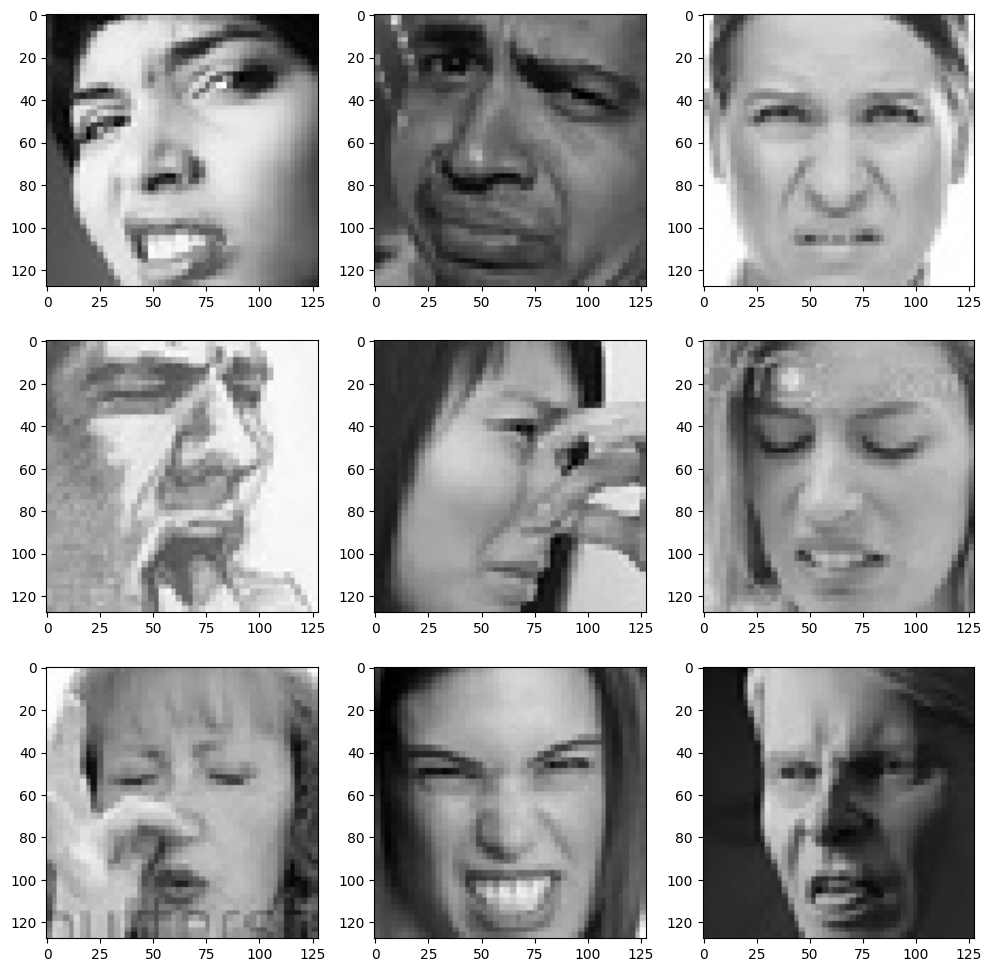

In [ ]:
expression = 'disgust'

plt.figure(figsize= (12,12))
for i in range(1, 10, 1):
    plt.subplot(3,3,i)
    img = load_img("images/images/train/"+expression+"/"+
                  os.listdir("images/images/train/" + expression)[i], target_size=(picture_size, picture_size))
    plt.imshow(img)
plt.show()

In [ ]:
batch_size  = 128

datagen_train  = ImageDataGenerator(
    rescale = 1/255, #skala piksel gambar menjadi rentang [0,1]
    shear_range = 0.2, #gangguan horizontal
    zoom_range = 0.2, #perbesar acak pada gambar
    horizontal_flip = True #flipping gambar secara horizontal
)

datagen_val = ImageDataGenerator(
    rescale= 1/255, #skala piksel gambar menjadi rentang [0,1]
    validation_split= 0.01

)


train_set = datagen_train.flow_from_directory(train_dir,
                                              target_size = (picture_size,picture_size),
                                              color_mode = "grayscale",
                                              batch_size=batch_size,
                                              class_mode='categorical'

)


test_set = datagen_val.flow_from_directory(test_dir,
                                              target_size = (picture_size,picture_size),
                                              color_mode = "grayscale",
                                              batch_size=batch_size,
                                              class_mode='categorical',
                                              subset = "training"
)
eval_set = datagen_val.flow_from_directory(test_dir,
                                              target_size = (picture_size,picture_size),
                                              color_mode = "grayscale",
                                              batch_size=batch_size,
                                              subset = "validation",
                                              shuffle=False
)


Found 57530 images belonging to 7 classes.
Found 7066 images belonging to 7 classes.


In [ ]:
from keras.optimizers import Adam


no_of_classes = 7

model = Sequential()

#1st CNN layer
model.add(Conv2D(64,(3,3),input_shape = (128,128,1)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size = (2,2)))


#2nd CNN layer
model.add(Conv2D(128,(3,3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size = (2,2)))

#3rd CNN layer
model.add(Conv2D(256,(3,3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size = (2,2)))

#4th CNN layer
model.add(Conv2D(512,(3,3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))


model.add(Flatten())

#Fully connected layer
model.add(Dense(1024))
model.add(Activation('relu'))
model.add(Dropout(0.2))

model.add(Dense(no_of_classes, activation='softmax'))
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 64)      640       
                                                                 
 activation (Activation)     (None, 126, 126, 64)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 64)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 128)       73856     
                                                                 
 activation_1 (Activation)   (None, 61, 61, 128)       0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 30, 30, 128)      0         
 2D)                                                    

In [ ]:
from keras.optimizers import Adam


epochs = 25

model.compile(loss='categorical_crossentropy',
              optimizer = Adam(learning_rate=0.001),
              metrics=['accuracy'])

In [ ]:
history = model.fit(train_set,
                                steps_per_epoch= train_set.n//train_set.batch_size,
                                epochs=epochs,
                                validation_data = test_set,
                                validation_steps=test_set.n//test_set.batch_size,
                    )



Epoch 1/25
449/449 [==============================] - 143s 292ms/step - loss: 1.6203 - accuracy: 0.3558 - val_loss: 1.3853 - val_accuracy: 0.4649
Epoch 2/25
449/449 [==============================] - 126s 280ms/step - loss: 1.3079 - accuracy: 0.4984 - val_loss: 1.2177 - val_accuracy: 0.5293
Epoch 3/25
449/449 [==============================] - 124s 275ms/step - loss: 1.1710 - accuracy: 0.5548 - val_loss: 1.0765 - val_accuracy: 0.5957
Epoch 4/25
449/449 [==============================] - 124s 277ms/step - loss: 1.0877 - accuracy: 0.5886 - val_loss: 1.0332 - val_accuracy: 0.6145
Epoch 5/25
449/449 [==============================] - 131s 293ms/step - loss: 1.0174 - accuracy: 0.6155 - val_loss: 0.9851 - val_accuracy: 0.6368
Epoch 6/25
449/449 [==============================] - 129s 288ms/step - loss: 0.9569 - accuracy: 0.6410 - val_loss: 0.9553 - val_accuracy: 0.6521
Epoch 7/25
449/449 [==============================] - 129s 288ms/step - loss: 0.9008 - accuracy: 0.6656 - val_loss: 0.9083 -

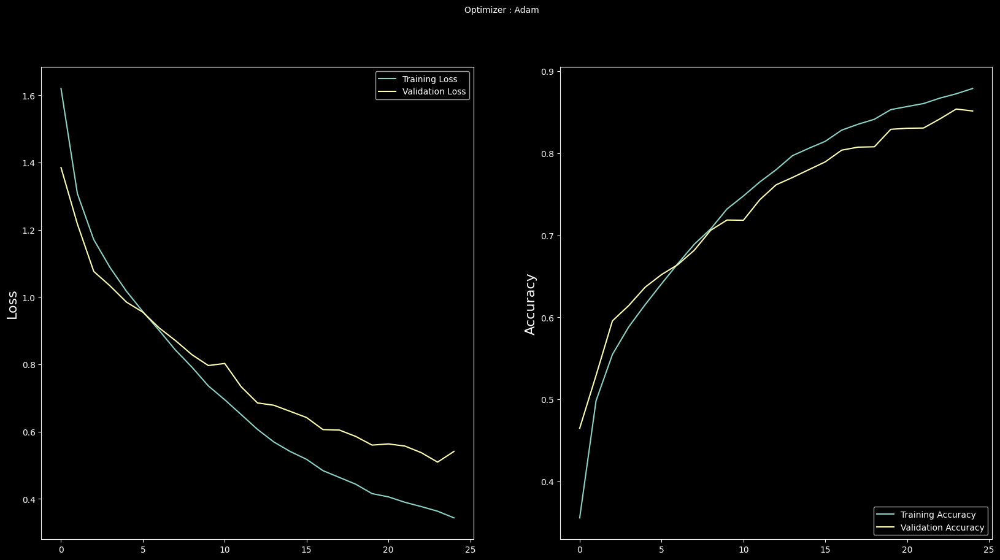

In [ ]:
plt.style.use('dark_background')

plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.suptitle('Optimizer : Adam', fontsize=10)
plt.ylabel('Loss', fontsize=16)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.ylabel('Accuracy', fontsize=16)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend(loc='lower right')
plt.show()

1/1 [==============================] - 0s 284ms/step


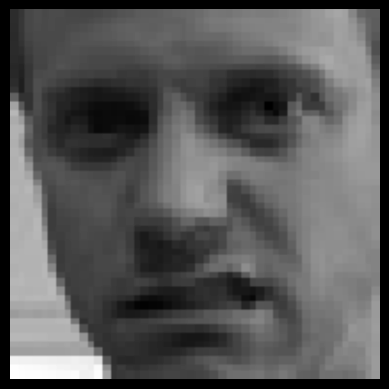

Image: /content/images/images/validation/disgust/28332.jpg
Predicted class: disgust
Probability: 61.1%
1/1 [==============================] - 0s 30ms/step


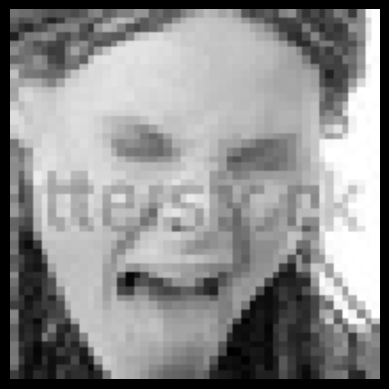

Image: /content/images/images/validation/disgust/16054.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


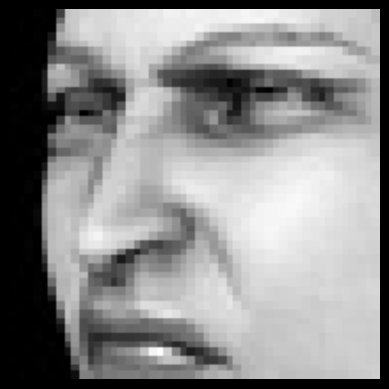

Image: /content/images/images/validation/disgust/15110.jpg
Predicted class: disgust
Probability: 66.9%
1/1 [==============================] - 0s 32ms/step


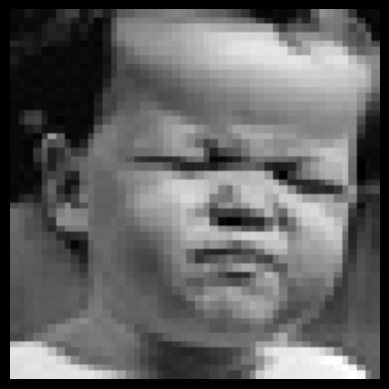

Image: /content/images/images/validation/disgust/31232.jpg
Predicted class: angry
Probability: 93.4%
1/1 [==============================] - 0s 30ms/step


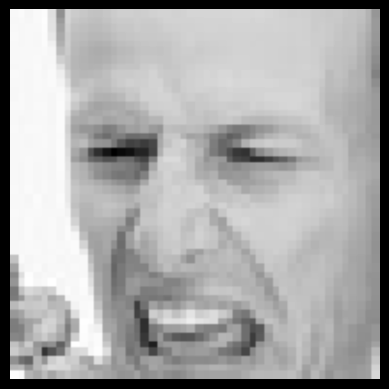

Image: /content/images/images/validation/disgust/35580.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 32ms/step


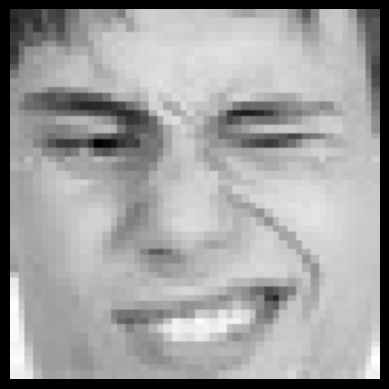

Image: /content/images/images/validation/disgust/18464.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 29ms/step


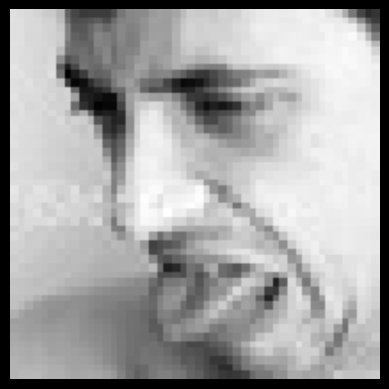

Image: /content/images/images/validation/disgust/32681.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 31ms/step


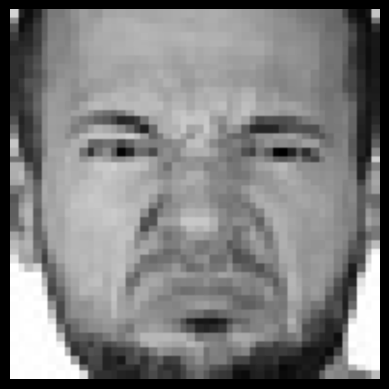

Image: /content/images/images/validation/disgust/33995.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 32ms/step


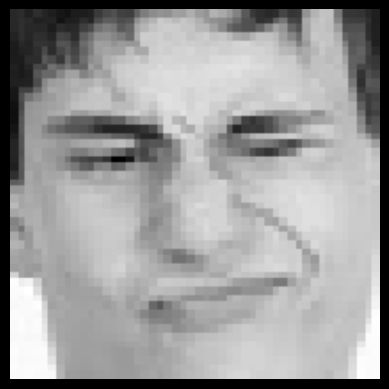

Image: /content/images/images/validation/disgust/573.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 37ms/step


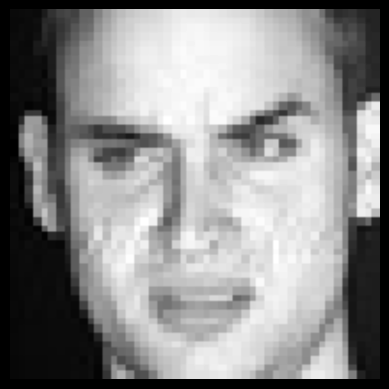

Image: /content/images/images/validation/disgust/6231.jpg
Predicted class: disgust
Probability: 98.6%
1/1 [==============================] - 0s 28ms/step


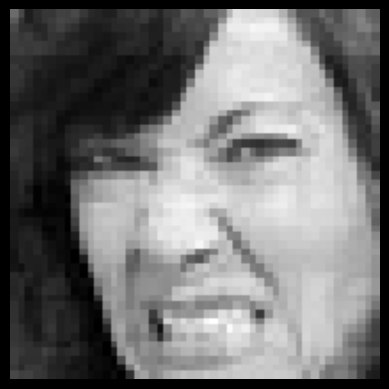

Image: /content/images/images/validation/disgust/22320.jpg
Predicted class: disgust
Probability: 99.8%
1/1 [==============================] - 0s 30ms/step


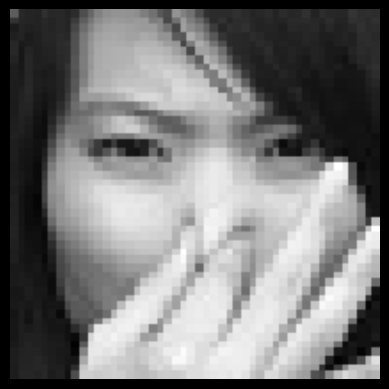

Image: /content/images/images/validation/disgust/20761.jpg
Predicted class: disgust
Probability: 88.7%
1/1 [==============================] - 0s 28ms/step


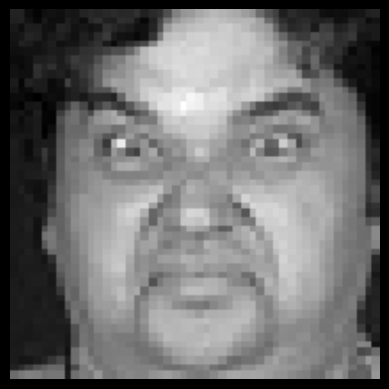

Image: /content/images/images/validation/disgust/33209.jpg
Predicted class: angry
Probability: 86.0%
1/1 [==============================] - 0s 29ms/step


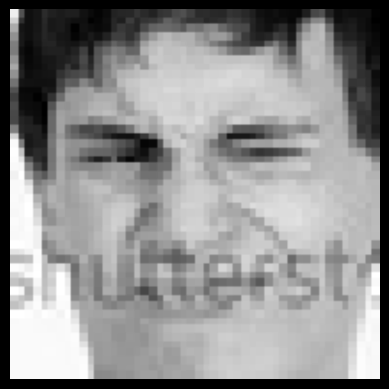

Image: /content/images/images/validation/disgust/7455.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 29ms/step


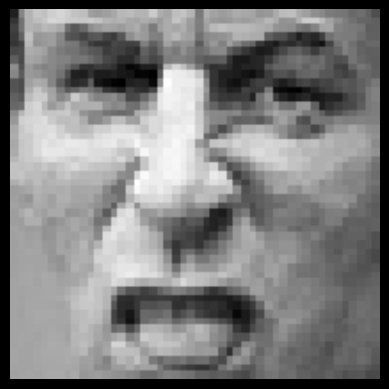

Image: /content/images/images/validation/disgust/13597.jpg
Predicted class: disgust
Probability: 86.9%
1/1 [==============================] - 0s 30ms/step


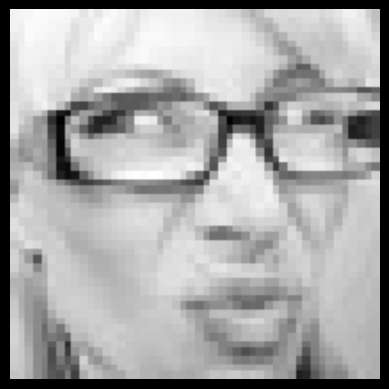

Image: /content/images/images/validation/disgust/13372.jpg
Predicted class: disgust
Probability: 97.8%
1/1 [==============================] - 0s 28ms/step


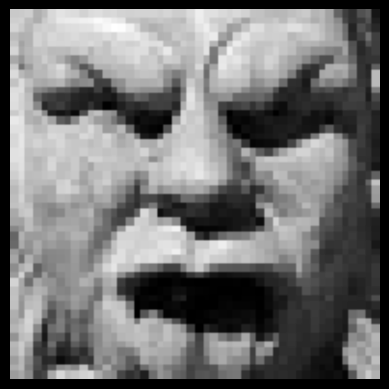

Image: /content/images/images/validation/disgust/16264.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 23ms/step


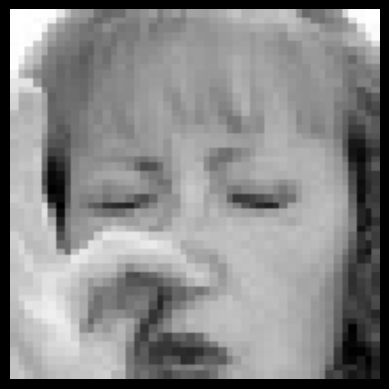

Image: /content/images/images/validation/disgust/19649.jpg
Predicted class: disgust
Probability: 98.6%
1/1 [==============================] - 0s 25ms/step


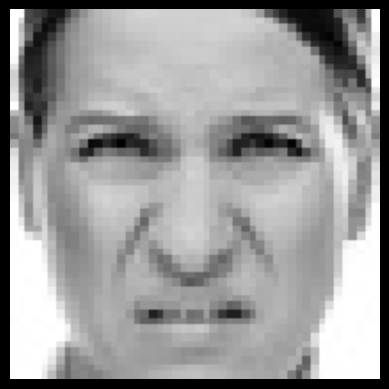

Image: /content/images/images/validation/disgust/21765.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


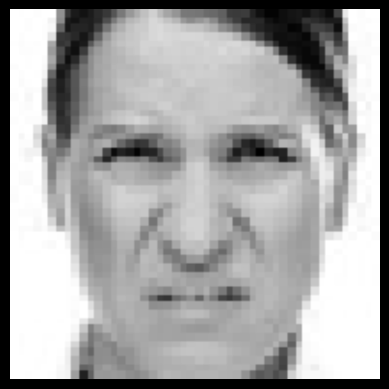

Image: /content/images/images/validation/disgust/3778.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


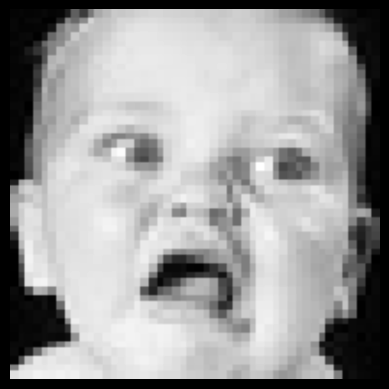

Image: /content/images/images/validation/disgust/11222.jpg
Predicted class: disgust
Probability: 98.9%
1/1 [==============================] - 0s 29ms/step


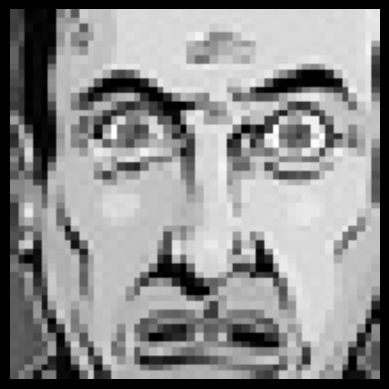

Image: /content/images/images/validation/disgust/3521.jpg
Predicted class: fear
Probability: 67.2%
1/1 [==============================] - 0s 31ms/step


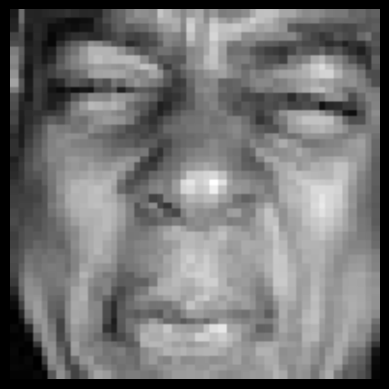

Image: /content/images/images/validation/disgust/10435.jpg
Predicted class: disgust
Probability: 99.6%
1/1 [==============================] - 0s 36ms/step


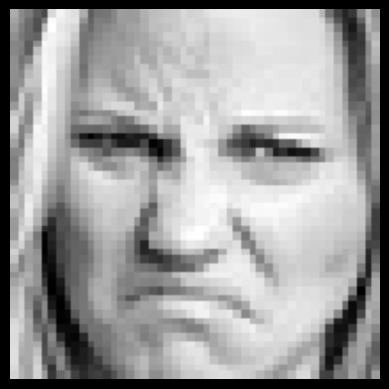

Image: /content/images/images/validation/disgust/30601.jpg
Predicted class: angry
Probability: 99.8%
1/1 [==============================] - 0s 28ms/step


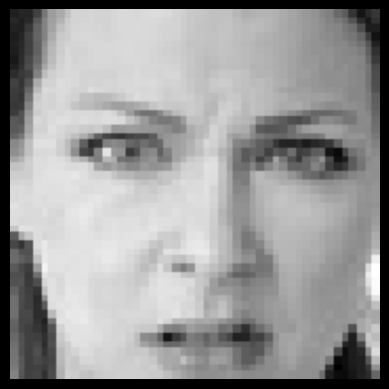

Image: /content/images/images/validation/disgust/4265.jpg
Predicted class: fear
Probability: 64.1%
1/1 [==============================] - 0s 30ms/step


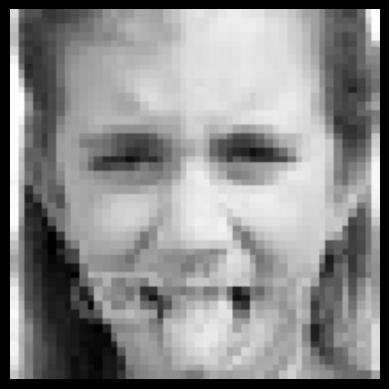

Image: /content/images/images/validation/disgust/33284.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 33ms/step


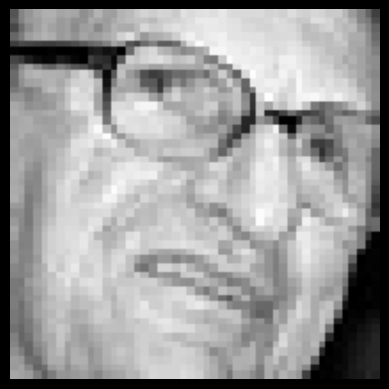

Image: /content/images/images/validation/disgust/8415.jpg
Predicted class: disgust
Probability: 96.7%
1/1 [==============================] - 0s 24ms/step


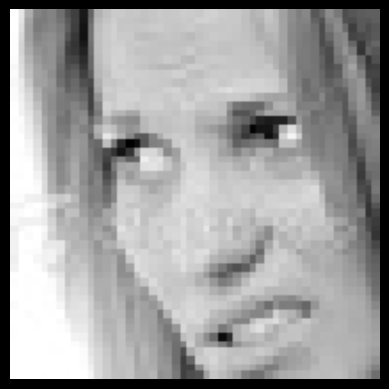

Image: /content/images/images/validation/disgust/29269.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 24ms/step


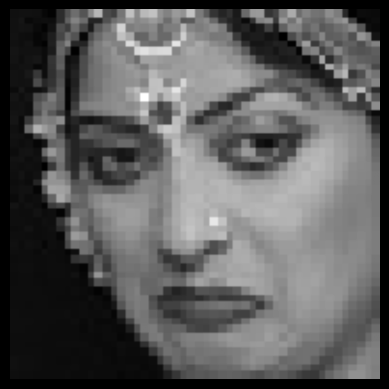

Image: /content/images/images/validation/disgust/19831.jpg
Predicted class: disgust
Probability: 94.9%
1/1 [==============================] - 0s 30ms/step


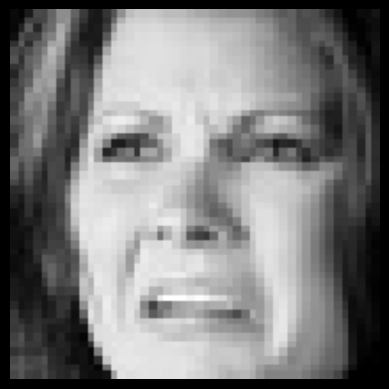

Image: /content/images/images/validation/disgust/33561.jpg
Predicted class: disgust
Probability: 99.8%
1/1 [==============================] - 0s 20ms/step


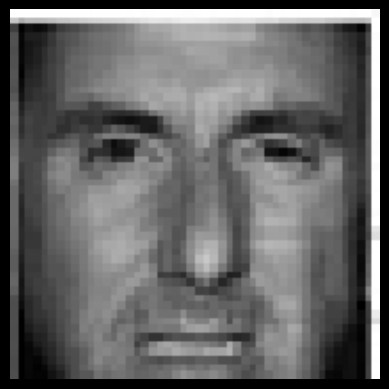

Image: /content/images/images/validation/disgust/29158.jpg
Predicted class: disgust
Probability: 99.7%
1/1 [==============================] - 0s 25ms/step


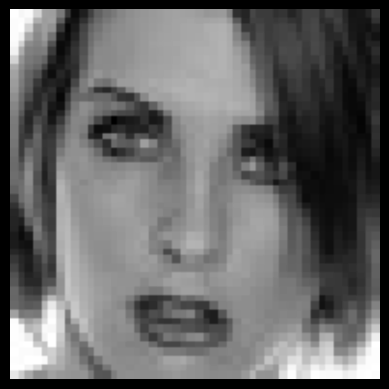

Image: /content/images/images/validation/disgust/14041.jpg
Predicted class: angry
Probability: 28.9%
1/1 [==============================] - 0s 25ms/step


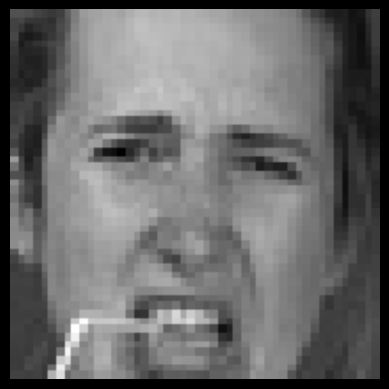

Image: /content/images/images/validation/disgust/8585.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


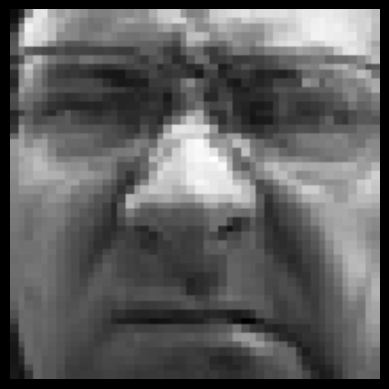

Image: /content/images/images/validation/disgust/8948.jpg
Predicted class: disgust
Probability: 99.4%
1/1 [==============================] - 0s 27ms/step


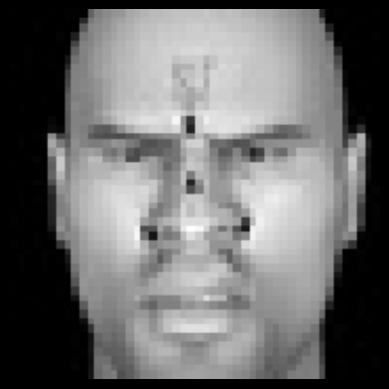

Image: /content/images/images/validation/disgust/4312.jpg
Predicted class: disgust
Probability: 63.9%
1/1 [==============================] - 0s 23ms/step


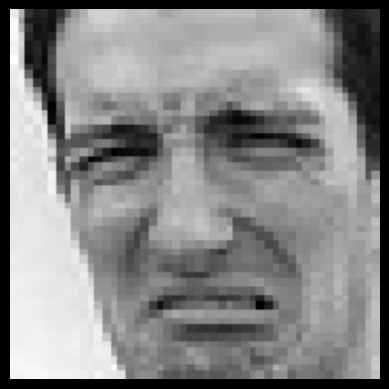

Image: /content/images/images/validation/disgust/7835.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 25ms/step


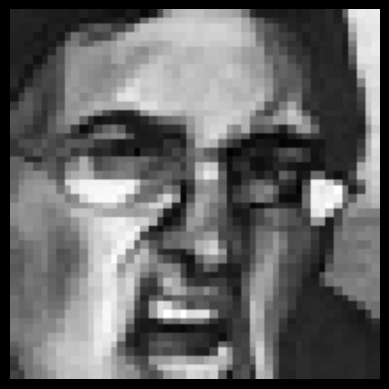

Image: /content/images/images/validation/disgust/23665.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 24ms/step


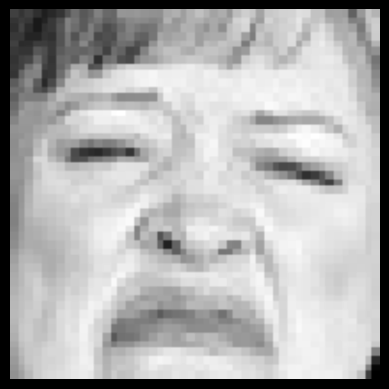

Image: /content/images/images/validation/disgust/12417.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 27ms/step


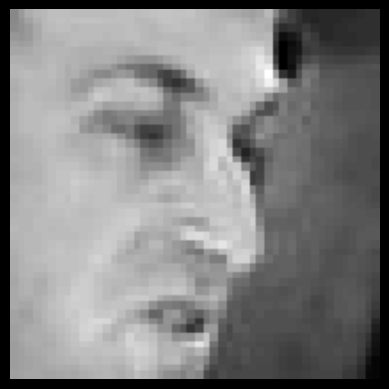

Image: /content/images/images/validation/disgust/9504.jpg
Predicted class: disgust
Probability: 80.6%
1/1 [==============================] - 0s 26ms/step


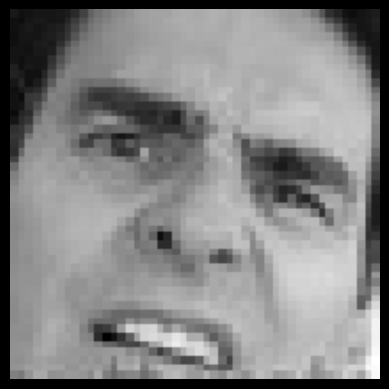

Image: /content/images/images/validation/disgust/1843.jpg
Predicted class: disgust
Probability: 95.2%
1/1 [==============================] - 0s 20ms/step


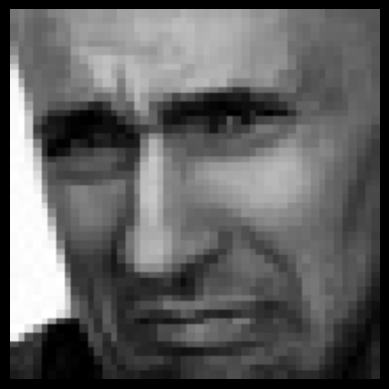

Image: /content/images/images/validation/disgust/4004.jpg
Predicted class: disgust
Probability: 99.6%
1/1 [==============================] - 0s 22ms/step


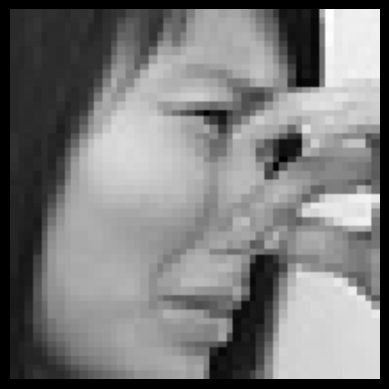

Image: /content/images/images/validation/disgust/21851.jpg
Predicted class: disgust
Probability: 99.2%
1/1 [==============================] - 0s 24ms/step


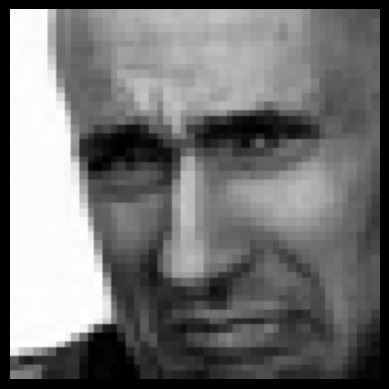

Image: /content/images/images/validation/disgust/34432.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 22ms/step


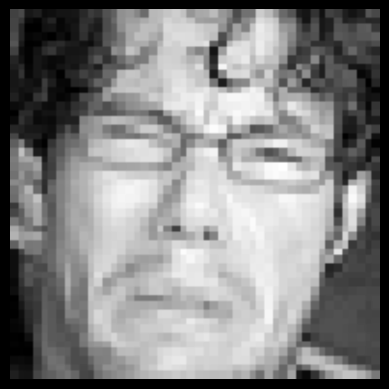

Image: /content/images/images/validation/disgust/19734.jpg
Predicted class: disgust
Probability: 99.8%
1/1 [==============================] - 0s 25ms/step


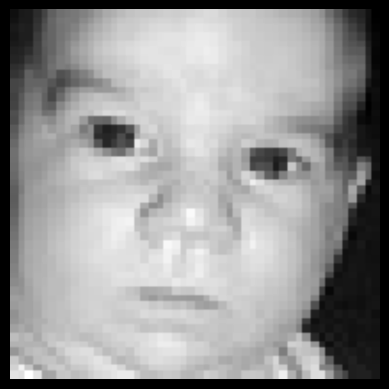

Image: /content/images/images/validation/disgust/18077.jpg
Predicted class: angry
Probability: 60.2%
1/1 [==============================] - 0s 29ms/step


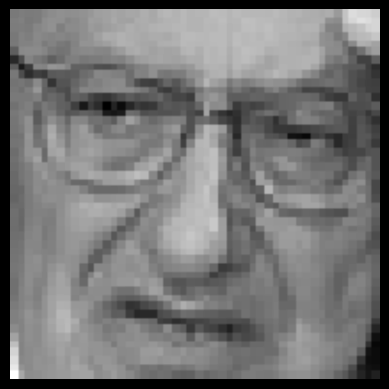

Image: /content/images/images/validation/disgust/12753.jpg
Predicted class: disgust
Probability: 69.7%
1/1 [==============================] - 0s 25ms/step


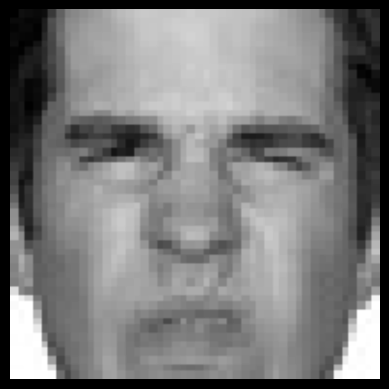

Image: /content/images/images/validation/disgust/16718.jpg
Predicted class: disgust
Probability: 99.8%
1/1 [==============================] - 0s 20ms/step


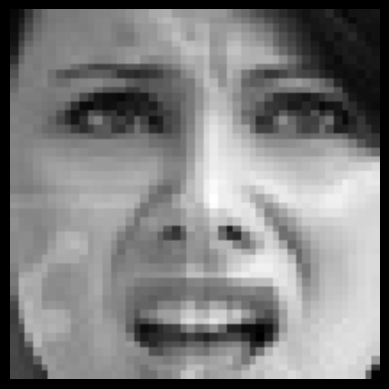

Image: /content/images/images/validation/disgust/533.jpg
Predicted class: disgust
Probability: 99.4%
1/1 [==============================] - 0s 26ms/step


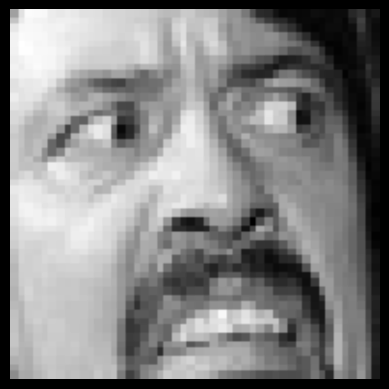

Image: /content/images/images/validation/disgust/7405.jpg
Predicted class: disgust
Probability: 84.0%
1/1 [==============================] - 0s 34ms/step


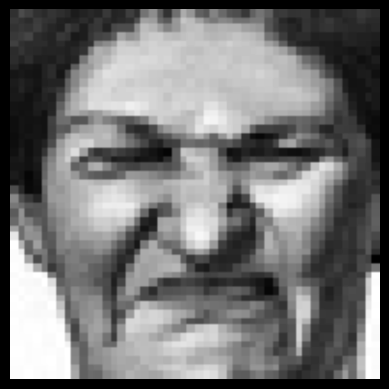

Image: /content/images/images/validation/disgust/7192.jpg
Predicted class: disgust
Probability: 94.6%
1/1 [==============================] - 0s 28ms/step


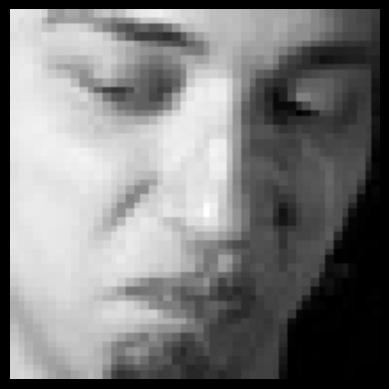

Image: /content/images/images/validation/disgust/4737.jpg
Predicted class: disgust
Probability: 95.7%
1/1 [==============================] - 0s 22ms/step


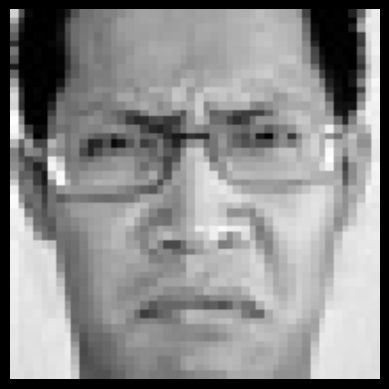

Image: /content/images/images/validation/disgust/28987.jpg
Predicted class: angry
Probability: 95.2%
1/1 [==============================] - 0s 27ms/step


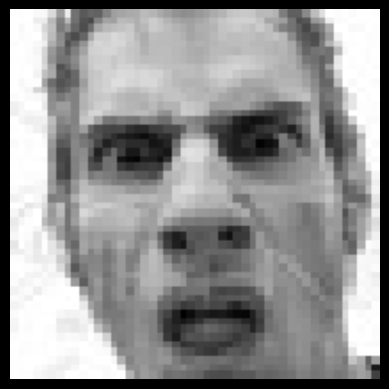

Image: /content/images/images/validation/disgust/13847.jpg
Predicted class: disgust
Probability: 96.9%
1/1 [==============================] - 0s 19ms/step


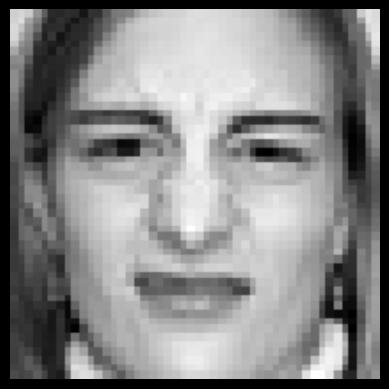

Image: /content/images/images/validation/disgust/25538.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 25ms/step


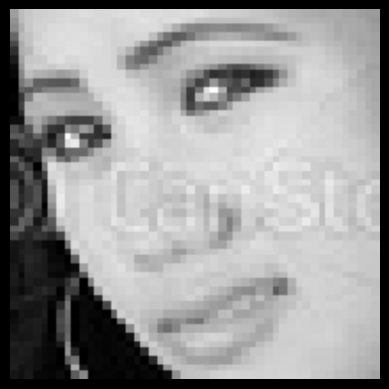

Image: /content/images/images/validation/disgust/28710.jpg
Predicted class: disgust
Probability: 99.8%
1/1 [==============================] - 0s 33ms/step


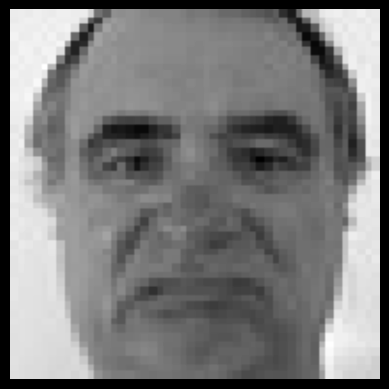

Image: /content/images/images/validation/disgust/19801.jpg
Predicted class: disgust
Probability: 62.1%
1/1 [==============================] - 0s 26ms/step


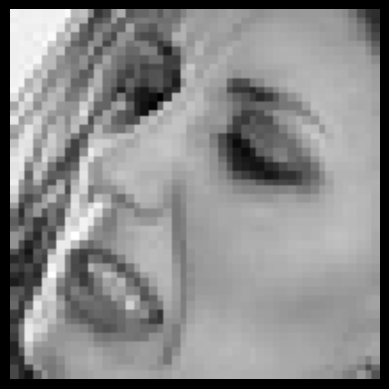

Image: /content/images/images/validation/disgust/2275.jpg
Predicted class: disgust
Probability: 99.8%
1/1 [==============================] - 0s 23ms/step


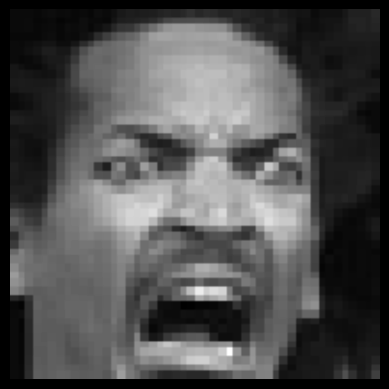

Image: /content/images/images/validation/disgust/25267.jpg
Predicted class: disgust
Probability: 76.1%
1/1 [==============================] - 0s 25ms/step


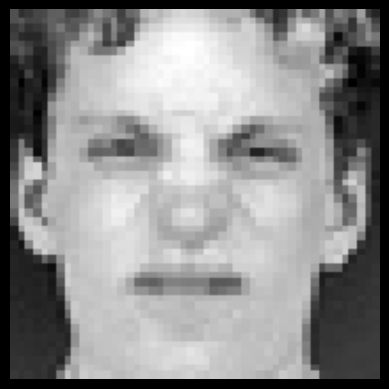

Image: /content/images/images/validation/disgust/21744.jpg
Predicted class: disgust
Probability: 88.9%
1/1 [==============================] - 0s 24ms/step


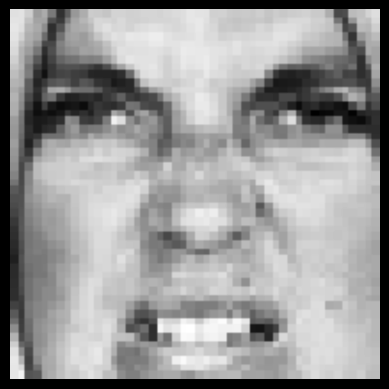

Image: /content/images/images/validation/disgust/31828.jpg
Predicted class: disgust
Probability: 99.6%
1/1 [==============================] - 0s 43ms/step


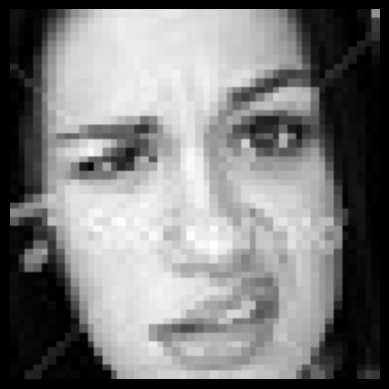

Image: /content/images/images/validation/disgust/19770.jpg
Predicted class: disgust
Probability: 94.1%
1/1 [==============================] - 0s 23ms/step


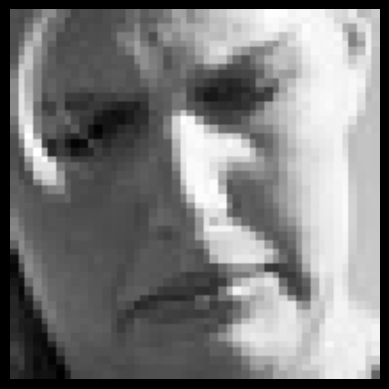

Image: /content/images/images/validation/disgust/14869.jpg
Predicted class: disgust
Probability: 98.8%
1/1 [==============================] - 0s 23ms/step


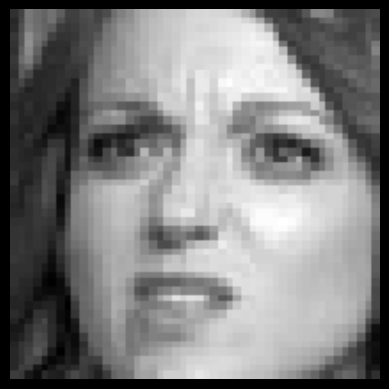

Image: /content/images/images/validation/disgust/10532.jpg
Predicted class: disgust
Probability: 83.5%
1/1 [==============================] - 0s 23ms/step


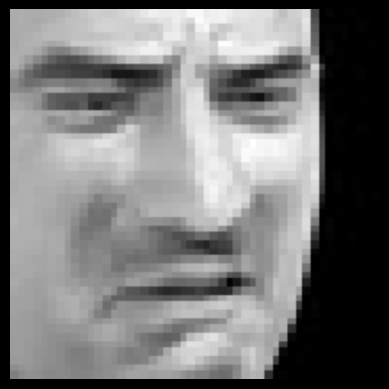

Image: /content/images/images/validation/disgust/13652.jpg
Predicted class: disgust
Probability: 99.3%
1/1 [==============================] - 0s 35ms/step


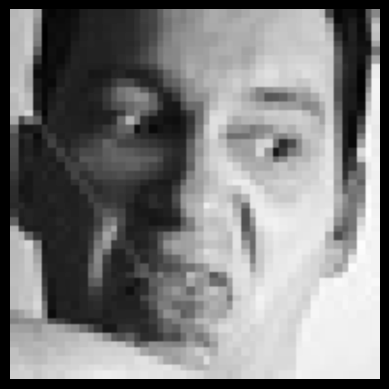

Image: /content/images/images/validation/disgust/24578.jpg
Predicted class: disgust
Probability: 73.6%
1/1 [==============================] - 0s 28ms/step


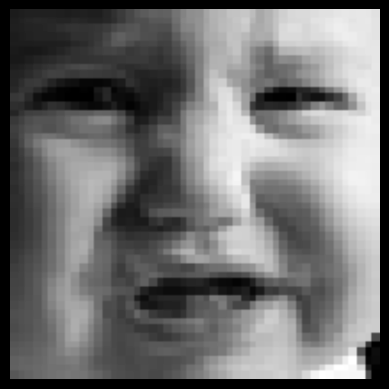

Image: /content/images/images/validation/disgust/2732.jpg
Predicted class: disgust
Probability: 94.1%
1/1 [==============================] - 0s 25ms/step


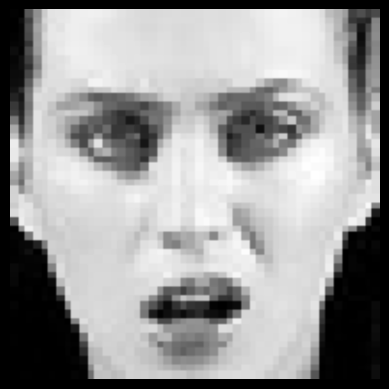

Image: /content/images/images/validation/disgust/28390.jpg
Predicted class: disgust
Probability: 99.1%
1/1 [==============================] - 0s 28ms/step


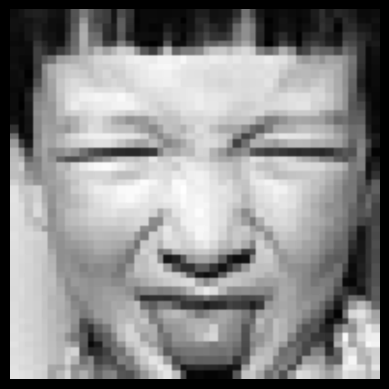

Image: /content/images/images/validation/disgust/8893.jpg
Predicted class: disgust
Probability: 92.4%
1/1 [==============================] - 0s 40ms/step


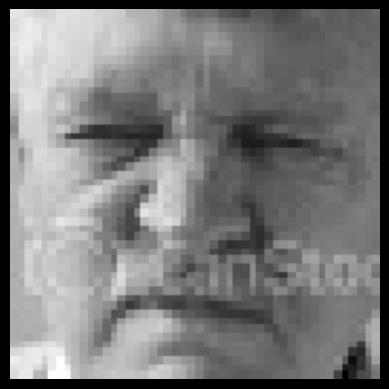

Image: /content/images/images/validation/disgust/6926.jpg
Predicted class: disgust
Probability: 99.7%
1/1 [==============================] - 0s 56ms/step


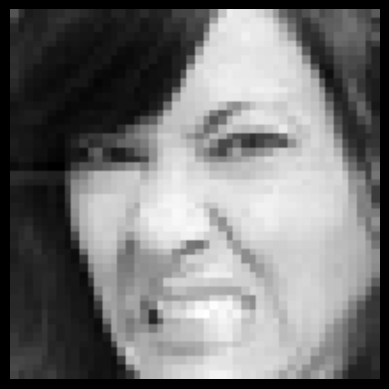

Image: /content/images/images/validation/disgust/30719.jpg
Predicted class: disgust
Probability: 99.1%
1/1 [==============================] - 0s 48ms/step


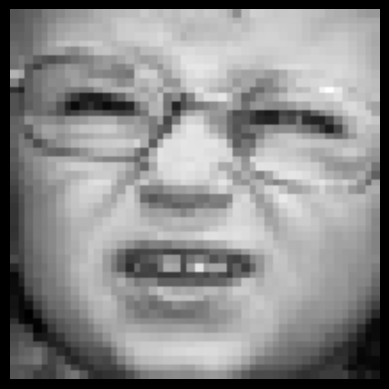

Image: /content/images/images/validation/disgust/34519.jpg
Predicted class: angry
Probability: 55.6%
1/1 [==============================] - 0s 30ms/step


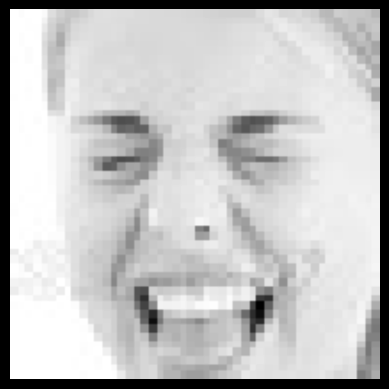

Image: /content/images/images/validation/disgust/4481.jpg
Predicted class: disgust
Probability: 98.1%
1/1 [==============================] - 0s 42ms/step


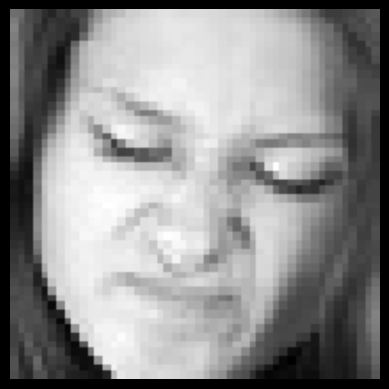

Image: /content/images/images/validation/disgust/2742.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


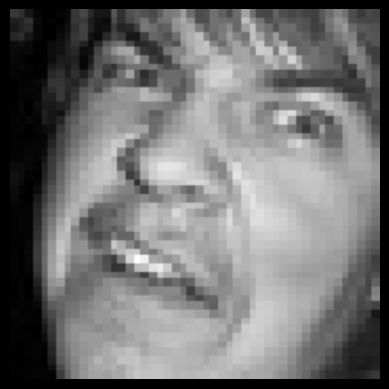

Image: /content/images/images/validation/disgust/26859.jpg
Predicted class: disgust
Probability: 99.1%
1/1 [==============================] - 0s 35ms/step


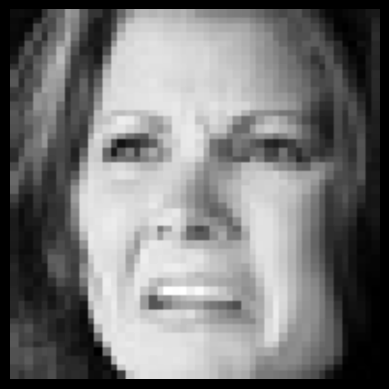

Image: /content/images/images/validation/disgust/16121.jpg
Predicted class: disgust
Probability: 99.8%
1/1 [==============================] - 0s 69ms/step


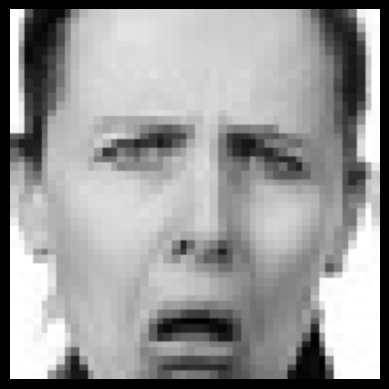

Image: /content/images/images/validation/disgust/7068.jpg
Predicted class: disgust
Probability: 99.6%
1/1 [==============================] - 0s 44ms/step


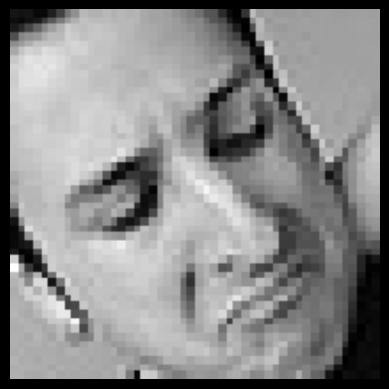

Image: /content/images/images/validation/disgust/25541.jpg
Predicted class: disgust
Probability: 99.7%
1/1 [==============================] - 0s 32ms/step


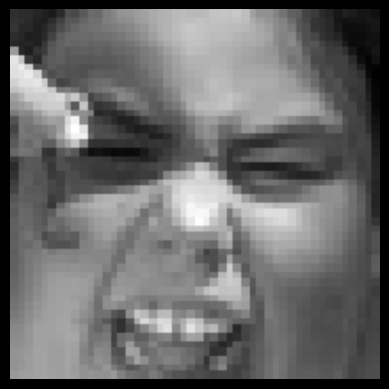

Image: /content/images/images/validation/disgust/30499.jpg
Predicted class: angry
Probability: 92.6%
1/1 [==============================] - 0s 29ms/step


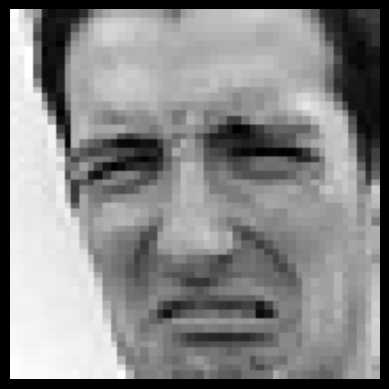

Image: /content/images/images/validation/disgust/11639.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


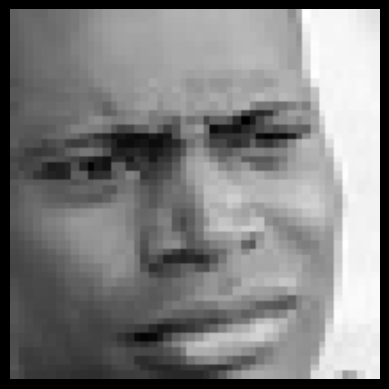

Image: /content/images/images/validation/disgust/9043.jpg
Predicted class: angry
Probability: 61.4%
1/1 [==============================] - 0s 42ms/step


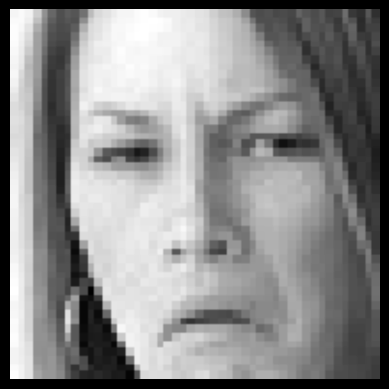

Image: /content/images/images/validation/disgust/4002.jpg
Predicted class: angry
Probability: 39.2%
1/1 [==============================] - 0s 42ms/step


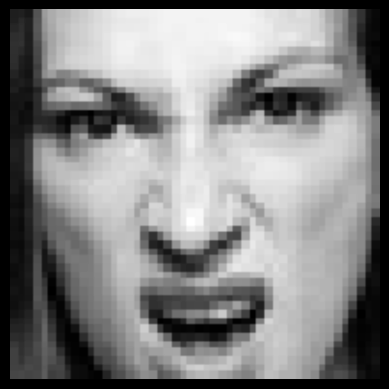

Image: /content/images/images/validation/disgust/5085.jpg
Predicted class: disgust
Probability: 81.5%
1/1 [==============================] - 0s 49ms/step


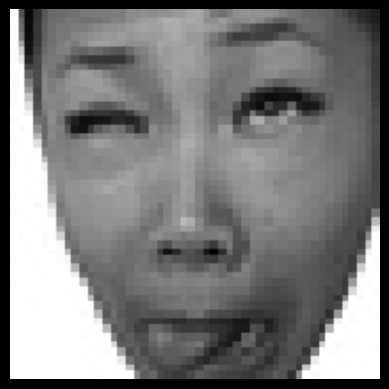

Image: /content/images/images/validation/disgust/31323.jpg
Predicted class: neutral
Probability: 90.3%
1/1 [==============================] - 0s 41ms/step


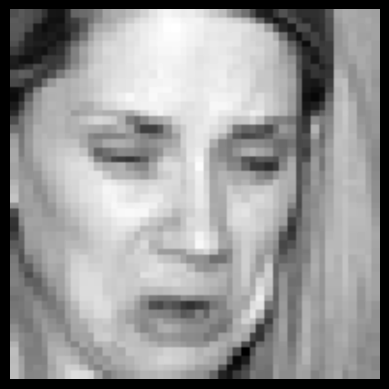

Image: /content/images/images/validation/disgust/23153.jpg
Predicted class: disgust
Probability: 54.0%
1/1 [==============================] - 0s 26ms/step


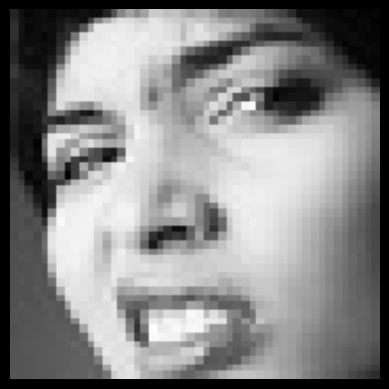

Image: /content/images/images/validation/disgust/14954.jpg
Predicted class: disgust
Probability: 99.3%
1/1 [==============================] - 0s 25ms/step


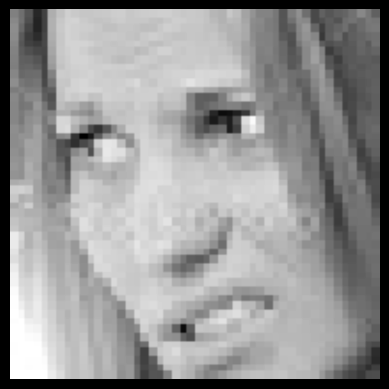

Image: /content/images/images/validation/disgust/8726.jpg
Predicted class: disgust
Probability: 99.6%
1/1 [==============================] - 0s 29ms/step


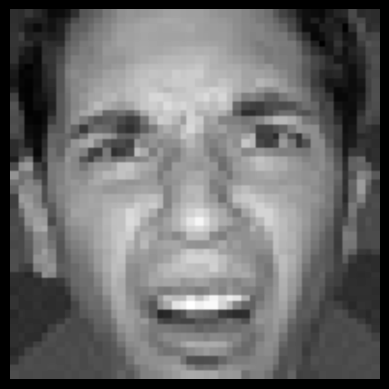

Image: /content/images/images/validation/disgust/3101.jpg
Predicted class: disgust
Probability: 98.0%
1/1 [==============================] - 0s 29ms/step


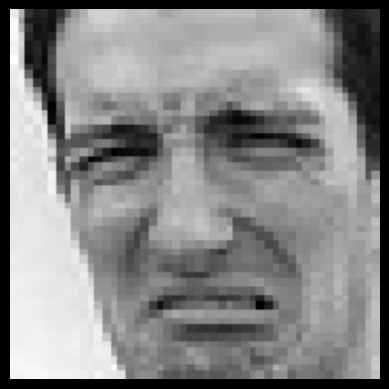

Image: /content/images/images/validation/disgust/11529.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


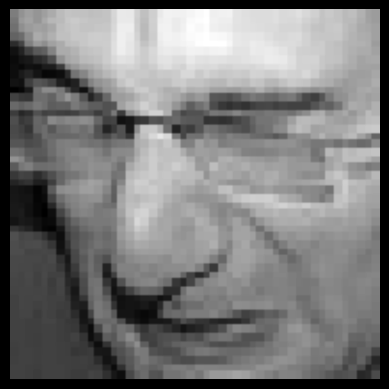

Image: /content/images/images/validation/disgust/10053.jpg
Predicted class: disgust
Probability: 89.7%
1/1 [==============================] - 0s 29ms/step


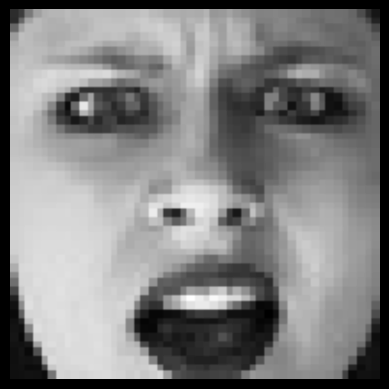

Image: /content/images/images/validation/disgust/3690.jpg
Predicted class: disgust
Probability: 81.4%
1/1 [==============================] - 0s 28ms/step


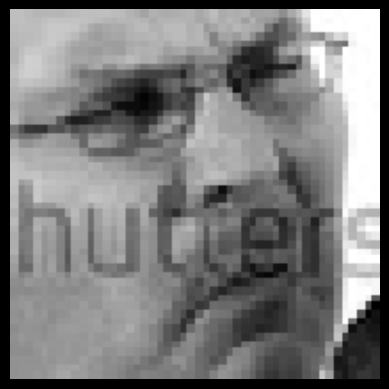

Image: /content/images/images/validation/disgust/30347.jpg
Predicted class: neutral
Probability: 53.5%
1/1 [==============================] - 0s 26ms/step


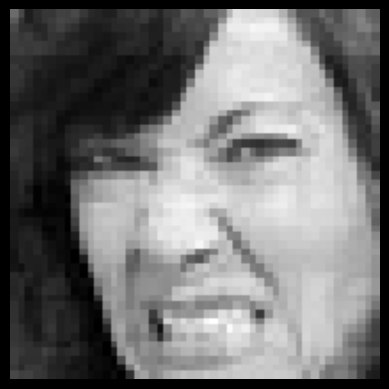

Image: /content/images/images/validation/disgust/7592.jpg
Predicted class: disgust
Probability: 99.8%
1/1 [==============================] - 0s 30ms/step


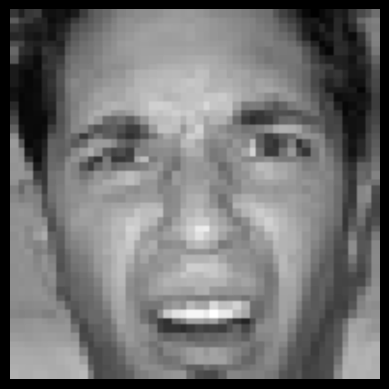

Image: /content/images/images/validation/disgust/23141.jpg
Predicted class: disgust
Probability: 99.1%
1/1 [==============================] - 0s 36ms/step


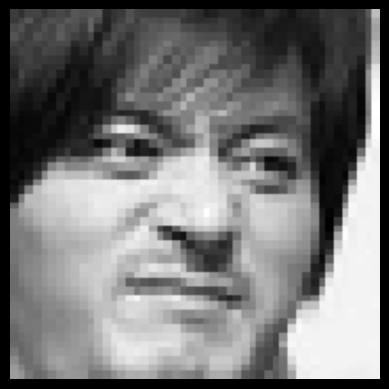

Image: /content/images/images/validation/disgust/30907.jpg
Predicted class: angry
Probability: 75.0%
1/1 [==============================] - 0s 26ms/step


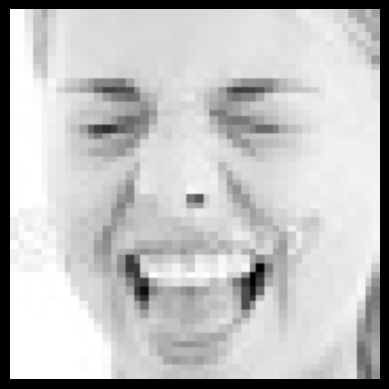

Image: /content/images/images/validation/disgust/16021.jpg
Predicted class: disgust
Probability: 97.5%
1/1 [==============================] - 0s 26ms/step


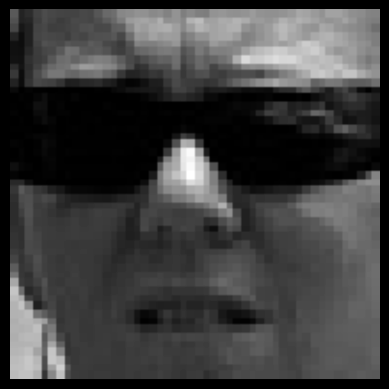

Image: /content/images/images/validation/disgust/23876.jpg
Predicted class: disgust
Probability: 99.3%
1/1 [==============================] - 0s 31ms/step


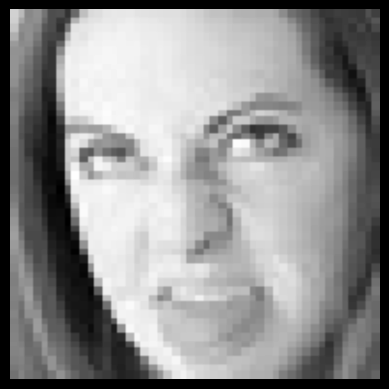

Image: /content/images/images/validation/disgust/14958.jpg
Predicted class: disgust
Probability: 99.0%
1/1 [==============================] - 0s 29ms/step


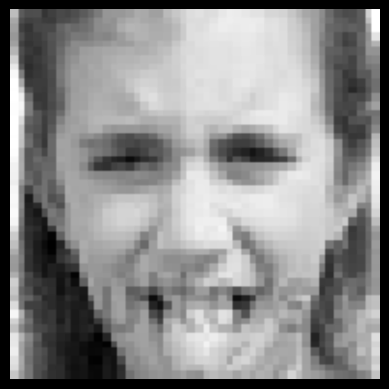

Image: /content/images/images/validation/disgust/35376.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 35ms/step


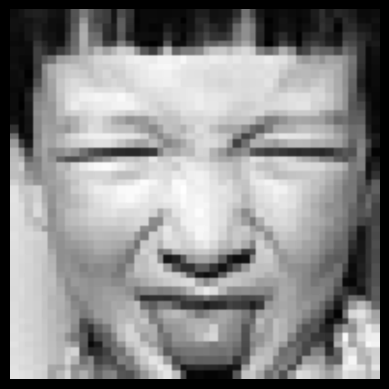

Image: /content/images/images/validation/disgust/30761.jpg
Predicted class: disgust
Probability: 92.4%
1/1 [==============================] - 0s 27ms/step


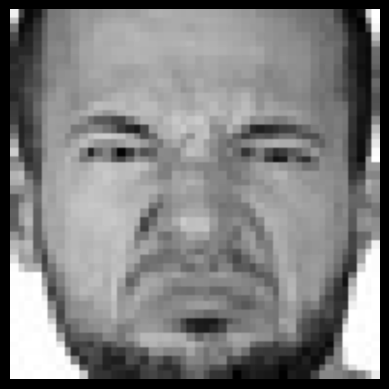

Image: /content/images/images/validation/disgust/9297.jpg
Predicted class: disgust
Probability: 99.9%
1/1 [==============================] - 0s 25ms/step


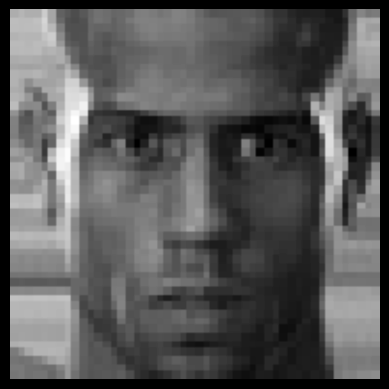

Image: /content/images/images/validation/neutral/11689.jpg
Predicted class: neutral
Probability: 45.1%
1/1 [==============================] - 0s 29ms/step


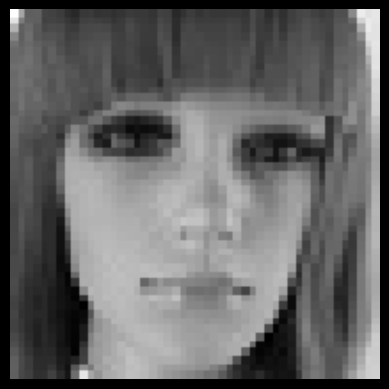

Image: /content/images/images/validation/neutral/4802.jpg
Predicted class: neutral
Probability: 36.6%
1/1 [==============================] - 0s 30ms/step


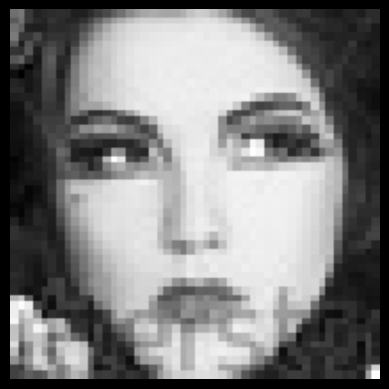

Image: /content/images/images/validation/neutral/24051.jpg
Predicted class: neutral
Probability: 70.0%
1/1 [==============================] - 0s 26ms/step


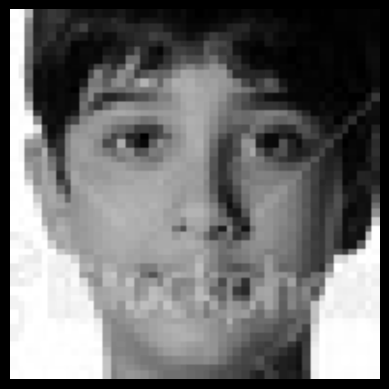

Image: /content/images/images/validation/neutral/1313.jpg
Predicted class: fear
Probability: 55.2%
1/1 [==============================] - 0s 29ms/step


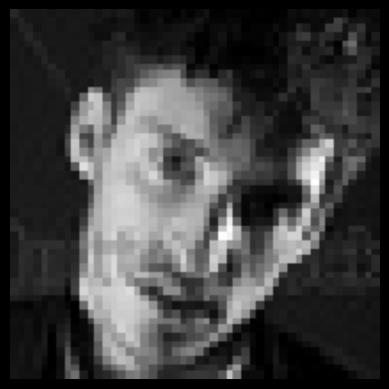

Image: /content/images/images/validation/neutral/26187.jpg
Predicted class: neutral
Probability: 61.7%
1/1 [==============================] - 0s 33ms/step


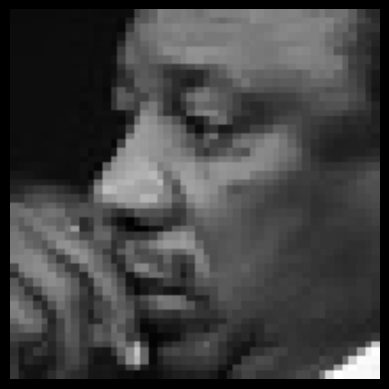

Image: /content/images/images/validation/neutral/25701.jpg
Predicted class: neutral
Probability: 69.0%
1/1 [==============================] - 0s 28ms/step


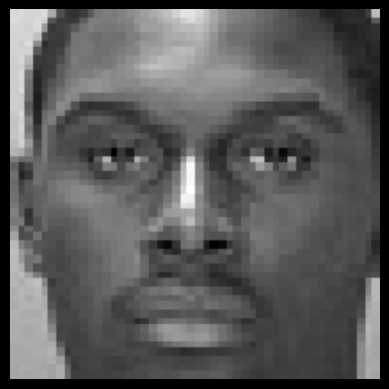

Image: /content/images/images/validation/neutral/6502.jpg
Predicted class: neutral
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


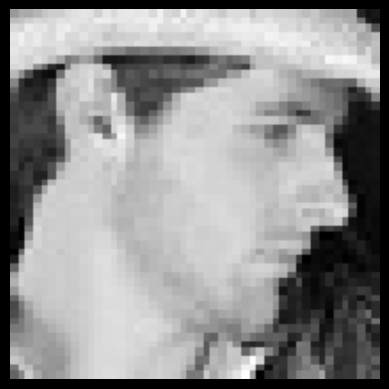

Image: /content/images/images/validation/neutral/16969.jpg
Predicted class: neutral
Probability: 99.4%
1/1 [==============================] - 0s 28ms/step


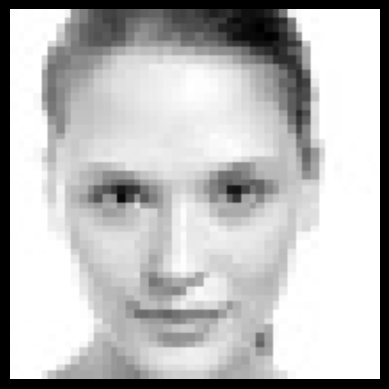

Image: /content/images/images/validation/neutral/17555.jpg
Predicted class: neutral
Probability: 85.1%
1/1 [==============================] - 0s 36ms/step


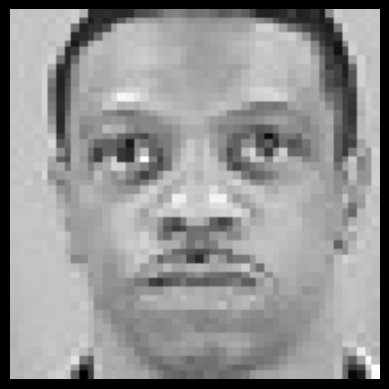

Image: /content/images/images/validation/neutral/32870.jpg
Predicted class: neutral
Probability: 99.8%
1/1 [==============================] - 0s 27ms/step


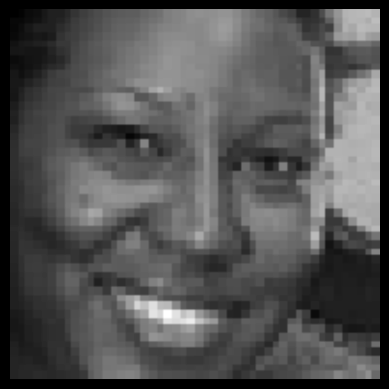

Image: /content/images/images/validation/neutral/18973.jpg
Predicted class: happy
Probability: 78.0%
1/1 [==============================] - 0s 26ms/step


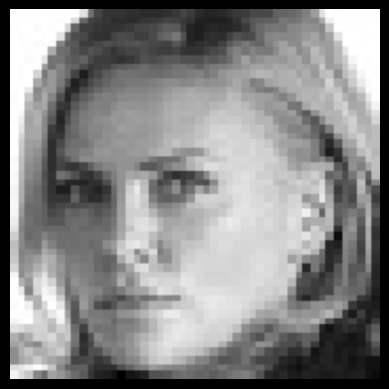

Image: /content/images/images/validation/neutral/18703.jpg
Predicted class: neutral
Probability: 95.1%
1/1 [==============================] - 0s 34ms/step


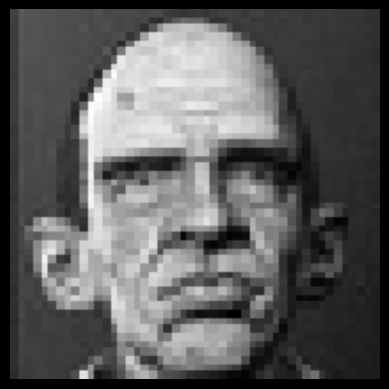

Image: /content/images/images/validation/neutral/1206.jpg
Predicted class: neutral
Probability: 88.9%
1/1 [==============================] - 0s 31ms/step


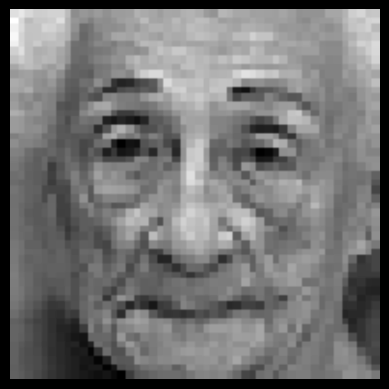

Image: /content/images/images/validation/neutral/11462.jpg
Predicted class: neutral
Probability: 99.5%
1/1 [==============================] - 0s 26ms/step


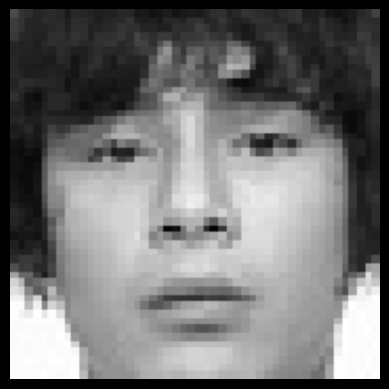

Image: /content/images/images/validation/neutral/14542.jpg
Predicted class: neutral
Probability: 99.7%
1/1 [==============================] - 0s 31ms/step


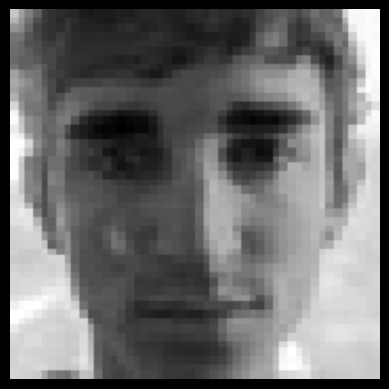

Image: /content/images/images/validation/neutral/35129.jpg
Predicted class: neutral
Probability: 92.9%
1/1 [==============================] - 0s 28ms/step


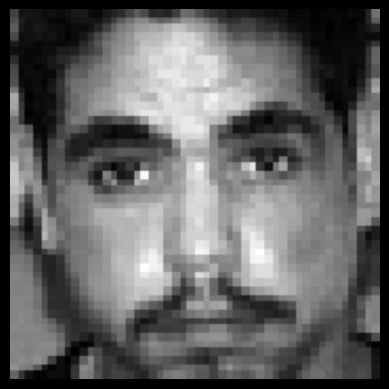

Image: /content/images/images/validation/neutral/15070.jpg
Predicted class: neutral
Probability: 46.9%
1/1 [==============================] - 0s 30ms/step


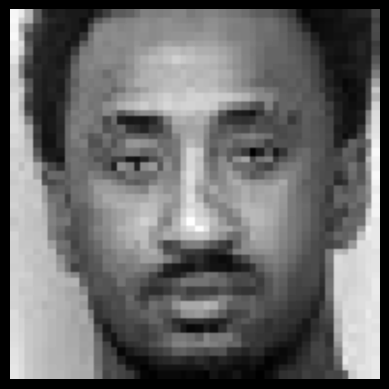

Image: /content/images/images/validation/neutral/8247.jpg
Predicted class: neutral
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


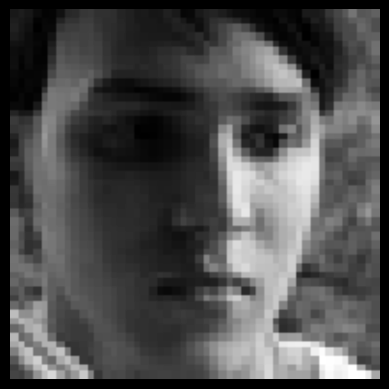

Image: /content/images/images/validation/neutral/29324.jpg
Predicted class: neutral
Probability: 75.9%
1/1 [==============================] - 0s 32ms/step


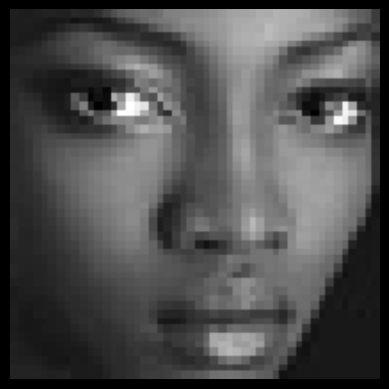

Image: /content/images/images/validation/neutral/28531.jpg
Predicted class: angry
Probability: 55.4%
1/1 [==============================] - 0s 28ms/step


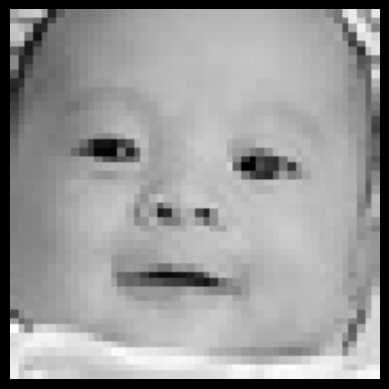

Image: /content/images/images/validation/neutral/27533.jpg
Predicted class: neutral
Probability: 99.3%
1/1 [==============================] - 0s 31ms/step


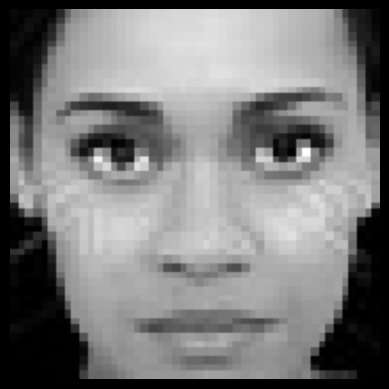

Image: /content/images/images/validation/neutral/22410.jpg
Predicted class: neutral
Probability: 83.2%
1/1 [==============================] - 0s 36ms/step


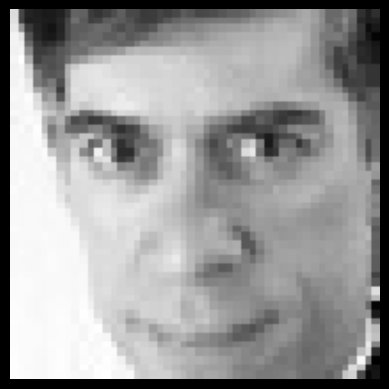

Image: /content/images/images/validation/neutral/25520.jpg
Predicted class: neutral
Probability: 99.6%
1/1 [==============================] - 0s 30ms/step


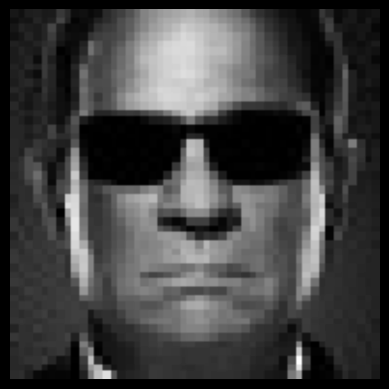

Image: /content/images/images/validation/neutral/10624.jpg
Predicted class: neutral
Probability: 91.8%
1/1 [==============================] - 0s 36ms/step


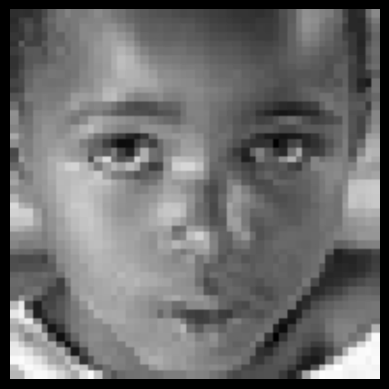

Image: /content/images/images/validation/neutral/21337.jpg
Predicted class: neutral
Probability: 97.2%
1/1 [==============================] - 0s 35ms/step


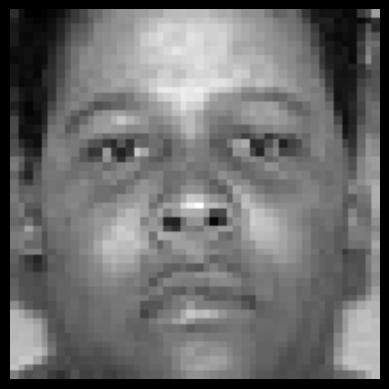

Image: /content/images/images/validation/neutral/34875.jpg
Predicted class: neutral
Probability: 99.9%
1/1 [==============================] - 0s 35ms/step


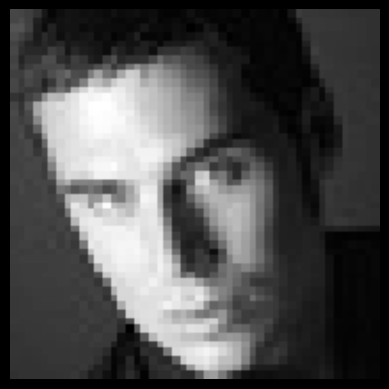

Image: /content/images/images/validation/neutral/28499.jpg
Predicted class: neutral
Probability: 98.9%
1/1 [==============================] - 0s 29ms/step


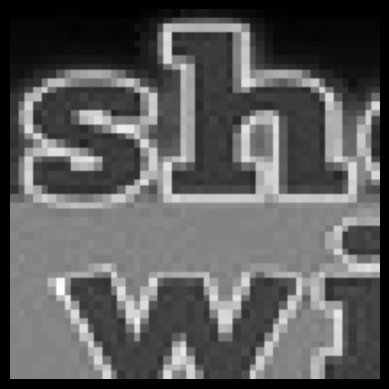

Image: /content/images/images/validation/neutral/12289.jpg
Predicted class: neutral
Probability: 99.5%
1/1 [==============================] - 0s 31ms/step


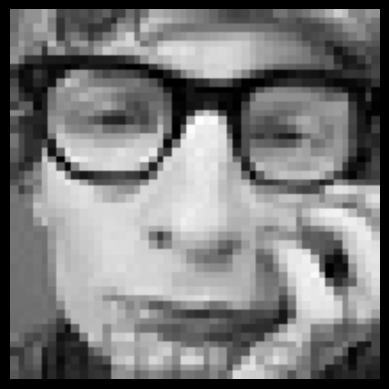

Image: /content/images/images/validation/neutral/16257.jpg
Predicted class: neutral
Probability: 94.4%
1/1 [==============================] - 0s 49ms/step


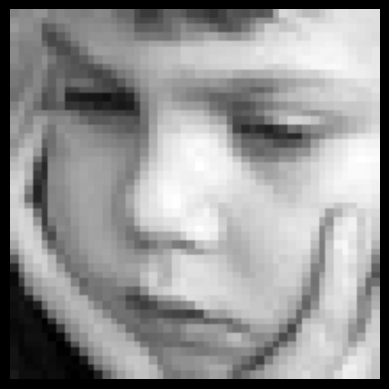

Image: /content/images/images/validation/neutral/25841.jpg
Predicted class: fear
Probability: 49.2%
1/1 [==============================] - 0s 26ms/step


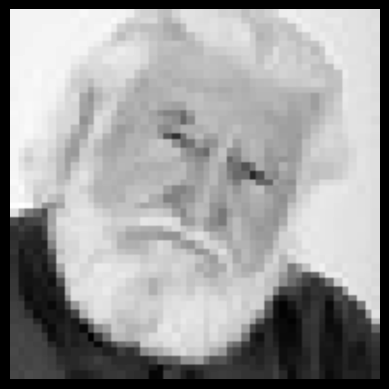

Image: /content/images/images/validation/neutral/30220.jpg
Predicted class: neutral
Probability: 64.1%
1/1 [==============================] - 0s 32ms/step


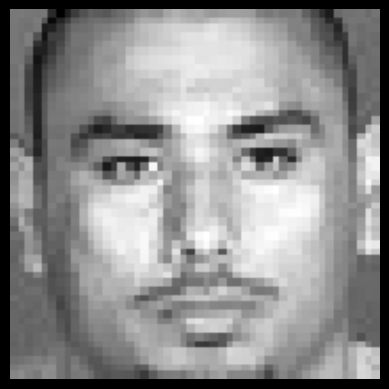

Image: /content/images/images/validation/neutral/16324.jpg
Predicted class: neutral
Probability: 88.7%
1/1 [==============================] - 0s 58ms/step


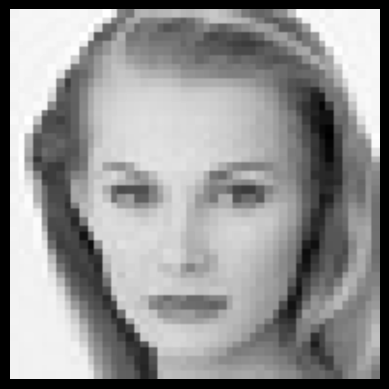

Image: /content/images/images/validation/neutral/1222.jpg
Predicted class: neutral
Probability: 98.2%
1/1 [==============================] - 0s 49ms/step


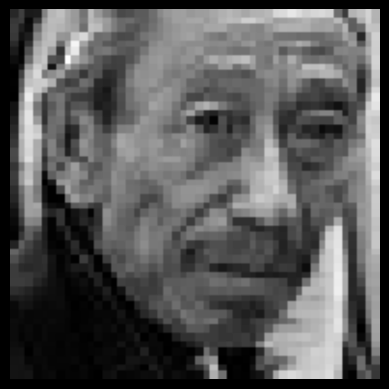

Image: /content/images/images/validation/neutral/18301.jpg
Predicted class: neutral
Probability: 90.0%
1/1 [==============================] - 0s 45ms/step


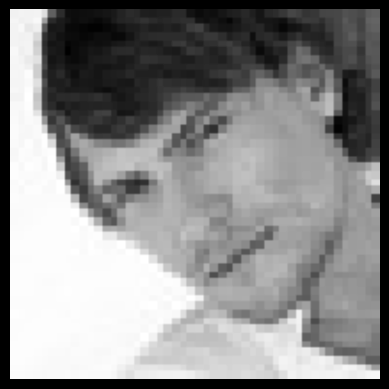

Image: /content/images/images/validation/neutral/7551.jpg
Predicted class: neutral
Probability: 92.3%
1/1 [==============================] - 0s 38ms/step


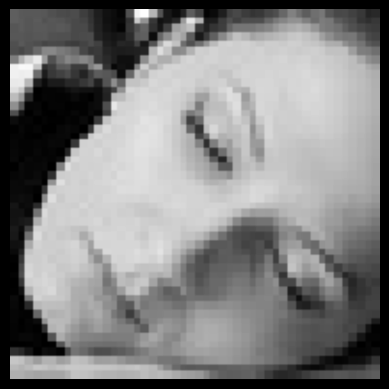

Image: /content/images/images/validation/neutral/26023.jpg
Predicted class: neutral
Probability: 99.9%
1/1 [==============================] - 0s 39ms/step


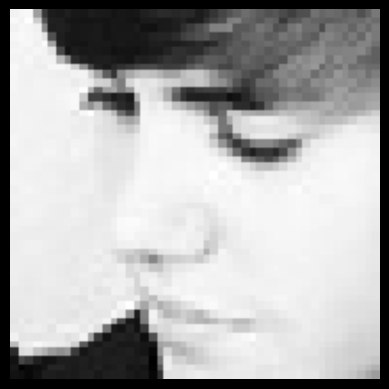

Image: /content/images/images/validation/neutral/15529.jpg
Predicted class: angry
Probability: 72.2%
1/1 [==============================] - 0s 36ms/step


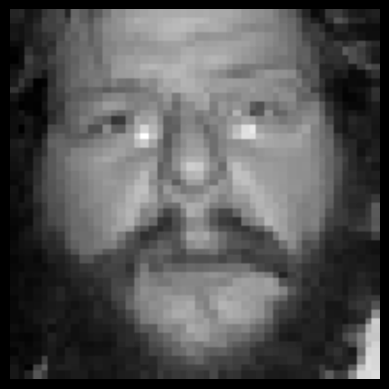

Image: /content/images/images/validation/neutral/9360.jpg
Predicted class: neutral
Probability: 99.8%
1/1 [==============================] - 0s 42ms/step


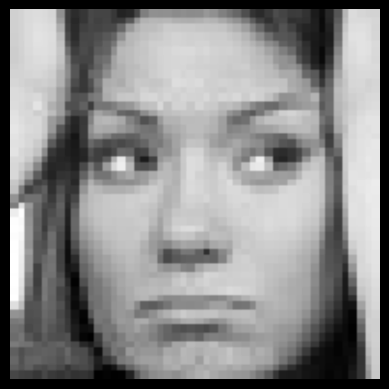

Image: /content/images/images/validation/neutral/24931.jpg
Predicted class: fear
Probability: 42.6%
1/1 [==============================] - 0s 32ms/step


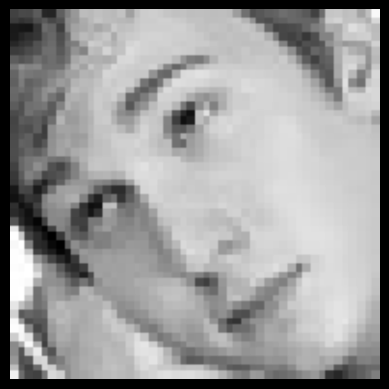

Image: /content/images/images/validation/neutral/10048.jpg
Predicted class: neutral
Probability: 87.8%
1/1 [==============================] - 0s 49ms/step


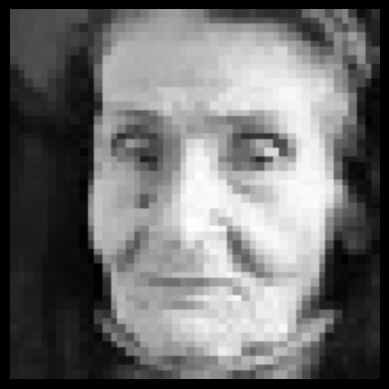

Image: /content/images/images/validation/neutral/3795.jpg
Predicted class: neutral
Probability: 98.7%
1/1 [==============================] - 0s 34ms/step


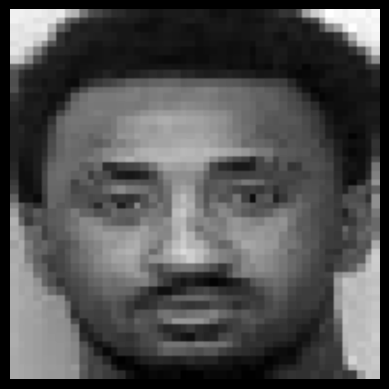

Image: /content/images/images/validation/neutral/26453.jpg
Predicted class: neutral
Probability: 98.5%
1/1 [==============================] - 0s 26ms/step


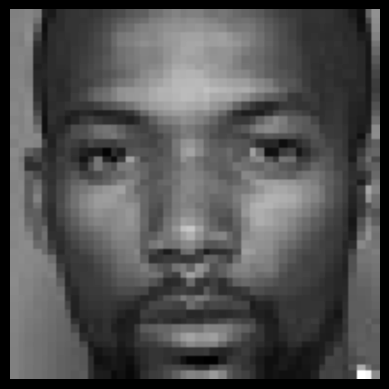

Image: /content/images/images/validation/neutral/13897.jpg
Predicted class: neutral
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


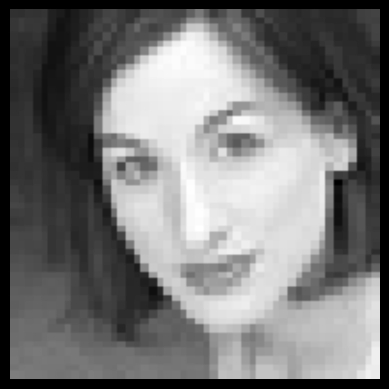

Image: /content/images/images/validation/neutral/11977.jpg
Predicted class: neutral
Probability: 90.0%
1/1 [==============================] - 0s 25ms/step


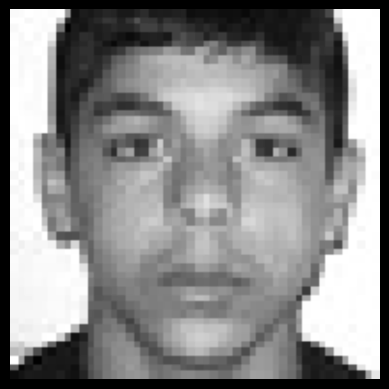

Image: /content/images/images/validation/neutral/24443.jpg
Predicted class: neutral
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


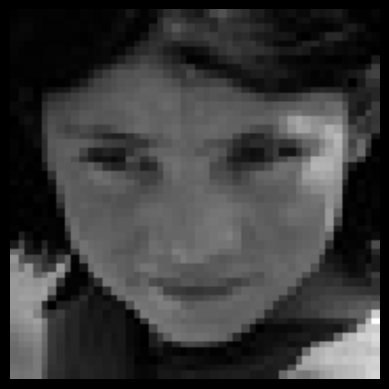

Image: /content/images/images/validation/neutral/29848.jpg
Predicted class: angry
Probability: 48.9%
1/1 [==============================] - 0s 38ms/step


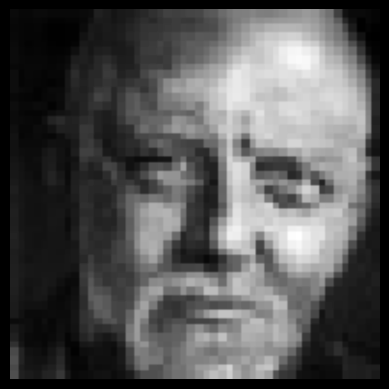

Image: /content/images/images/validation/neutral/19390.jpg
Predicted class: neutral
Probability: 92.1%
1/1 [==============================] - 0s 37ms/step


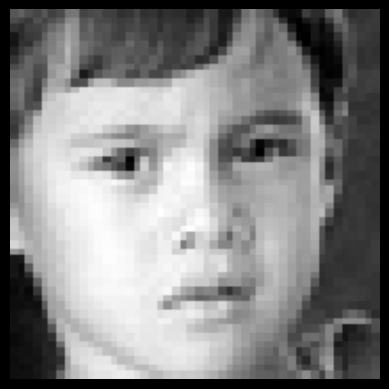

Image: /content/images/images/validation/neutral/20948.jpg
Predicted class: sad
Probability: 40.7%
1/1 [==============================] - 0s 27ms/step


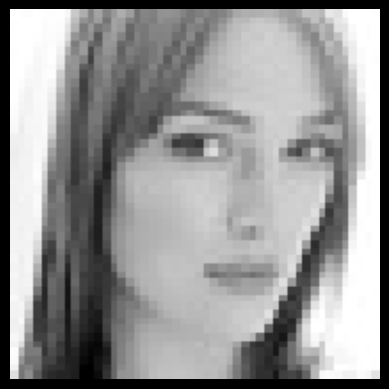

Image: /content/images/images/validation/neutral/15007.jpg
Predicted class: neutral
Probability: 97.6%
1/1 [==============================] - 0s 48ms/step


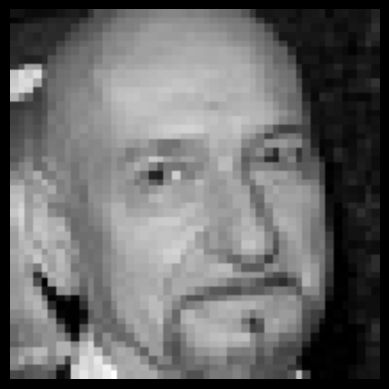

Image: /content/images/images/validation/neutral/3899.jpg
Predicted class: angry
Probability: 52.2%
1/1 [==============================] - 0s 27ms/step


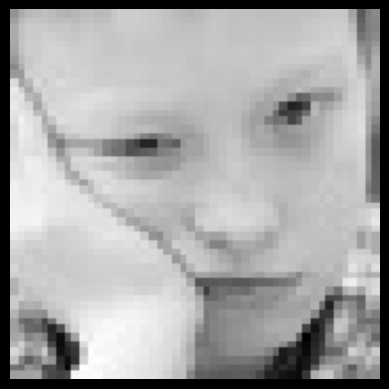

Image: /content/images/images/validation/neutral/15570.jpg
Predicted class: neutral
Probability: 93.3%
1/1 [==============================] - 0s 36ms/step


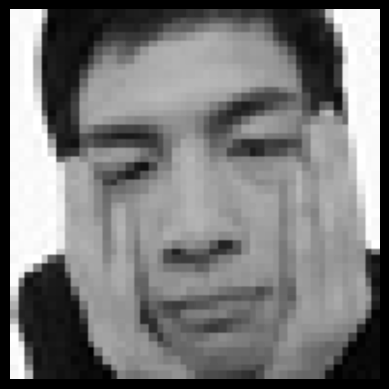

Image: /content/images/images/validation/neutral/23348.jpg
Predicted class: neutral
Probability: 84.3%
1/1 [==============================] - 0s 40ms/step


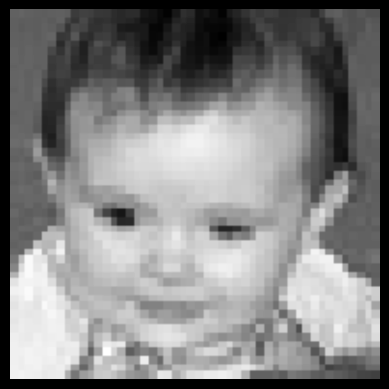

Image: /content/images/images/validation/neutral/29840.jpg
Predicted class: angry
Probability: 82.8%
1/1 [==============================] - 0s 26ms/step


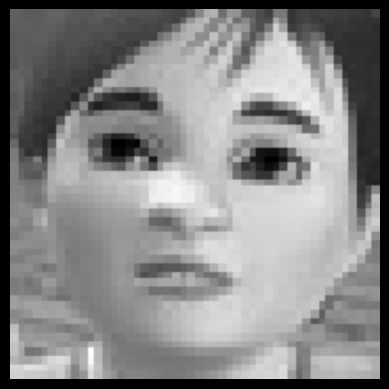

Image: /content/images/images/validation/neutral/20933.jpg
Predicted class: neutral
Probability: 77.5%
1/1 [==============================] - 0s 35ms/step


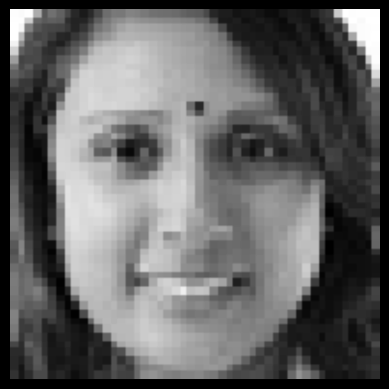

Image: /content/images/images/validation/neutral/2019.jpg
Predicted class: happy
Probability: 89.4%
1/1 [==============================] - 0s 33ms/step


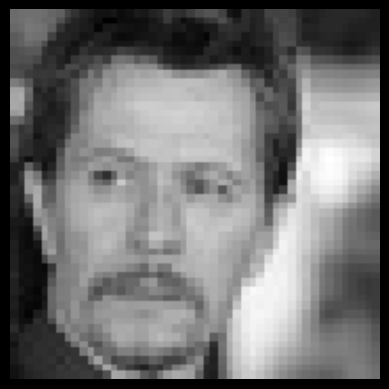

Image: /content/images/images/validation/neutral/15293.jpg
Predicted class: neutral
Probability: 87.8%
1/1 [==============================] - 0s 27ms/step


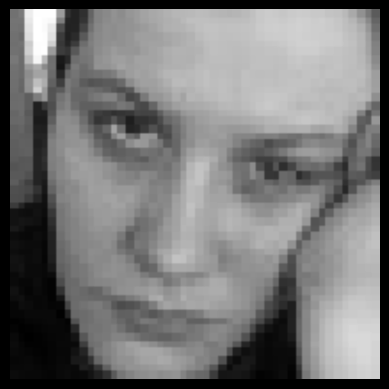

Image: /content/images/images/validation/neutral/25497.jpg
Predicted class: fear
Probability: 62.1%
1/1 [==============================] - 0s 31ms/step


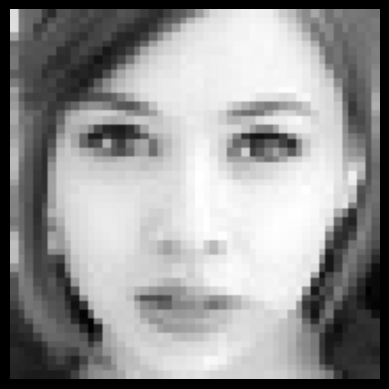

Image: /content/images/images/validation/neutral/2223.jpg
Predicted class: neutral
Probability: 97.5%
1/1 [==============================] - 0s 25ms/step


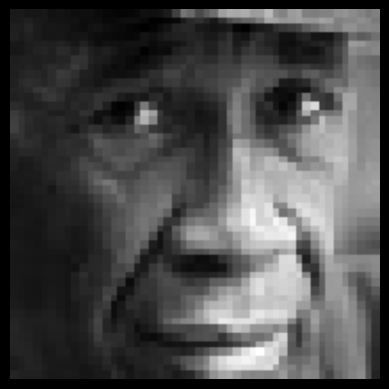

Image: /content/images/images/validation/neutral/7462.jpg
Predicted class: neutral
Probability: 74.2%
1/1 [==============================] - 0s 36ms/step


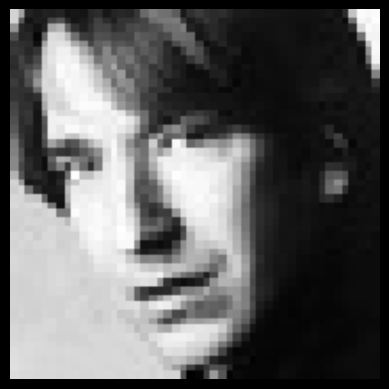

Image: /content/images/images/validation/neutral/2564.jpg
Predicted class: neutral
Probability: 98.2%
1/1 [==============================] - 0s 26ms/step


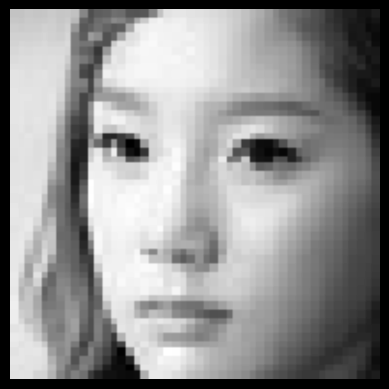

Image: /content/images/images/validation/neutral/15102.jpg
Predicted class: neutral
Probability: 90.0%
1/1 [==============================] - 0s 25ms/step


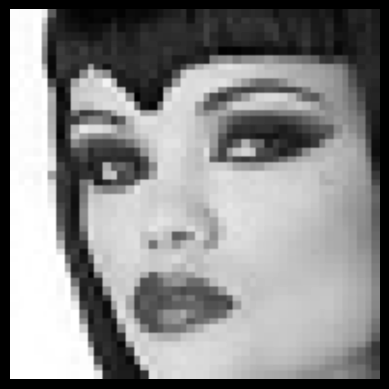

Image: /content/images/images/validation/neutral/20432.jpg
Predicted class: neutral
Probability: 95.6%
1/1 [==============================] - 0s 43ms/step


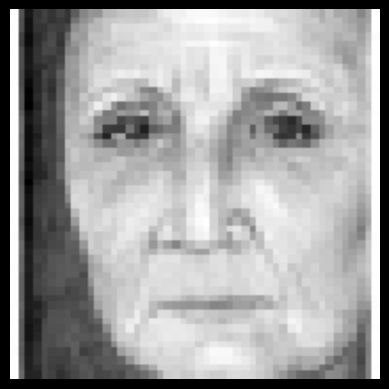

Image: /content/images/images/validation/neutral/21150.jpg
Predicted class: sad
Probability: 49.5%
1/1 [==============================] - 0s 28ms/step


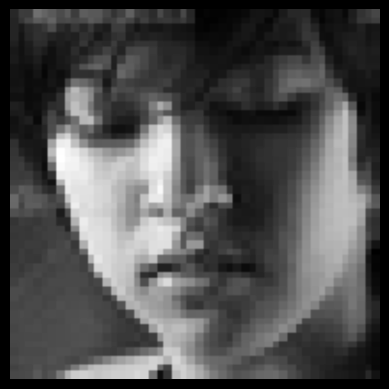

Image: /content/images/images/validation/neutral/22354.jpg
Predicted class: sad
Probability: 49.3%
1/1 [==============================] - 0s 27ms/step


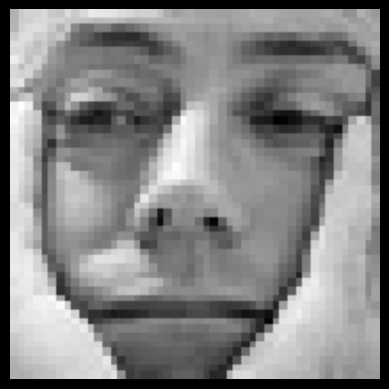

Image: /content/images/images/validation/neutral/201.jpg
Predicted class: neutral
Probability: 98.4%
1/1 [==============================] - 0s 30ms/step


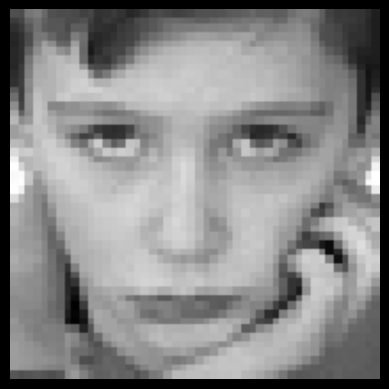

Image: /content/images/images/validation/neutral/1819.jpg
Predicted class: neutral
Probability: 98.3%
1/1 [==============================] - 0s 27ms/step


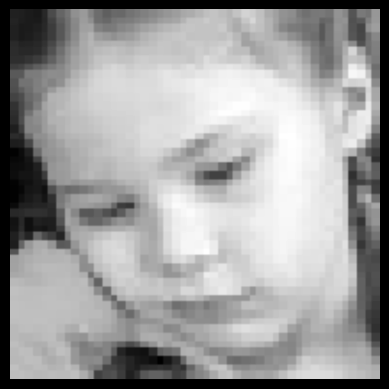

Image: /content/images/images/validation/neutral/9381.jpg
Predicted class: neutral
Probability: 99.3%
1/1 [==============================] - 0s 37ms/step


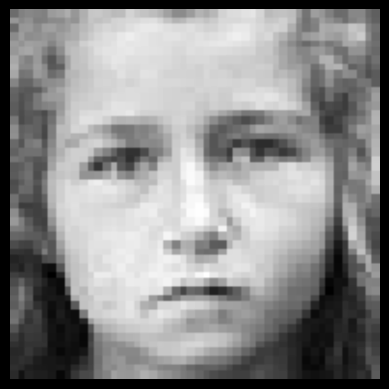

Image: /content/images/images/validation/neutral/23565.jpg
Predicted class: sad
Probability: 48.6%
1/1 [==============================] - 0s 27ms/step


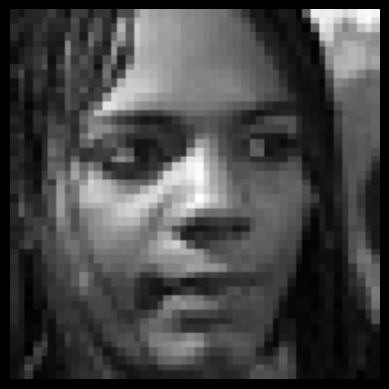

Image: /content/images/images/validation/neutral/23634.jpg
Predicted class: neutral
Probability: 92.3%
1/1 [==============================] - 0s 28ms/step


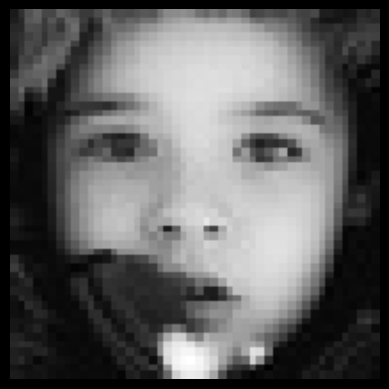

Image: /content/images/images/validation/neutral/14859.jpg
Predicted class: neutral
Probability: 92.3%
1/1 [==============================] - 0s 25ms/step


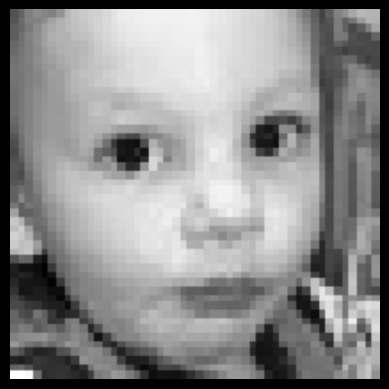

Image: /content/images/images/validation/neutral/21962.jpg
Predicted class: neutral
Probability: 71.3%
1/1 [==============================] - 0s 29ms/step


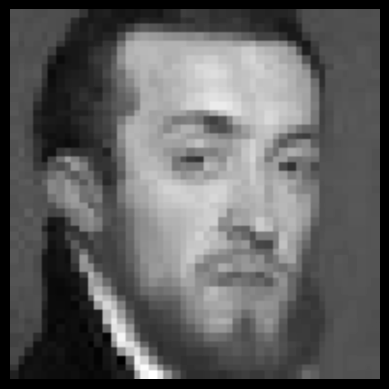

Image: /content/images/images/validation/neutral/4748.jpg
Predicted class: neutral
Probability: 69.7%
1/1 [==============================] - 0s 46ms/step


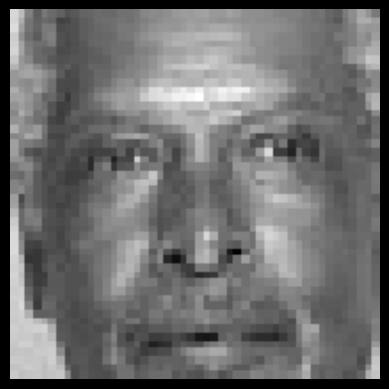

Image: /content/images/images/validation/neutral/27985.jpg
Predicted class: neutral
Probability: 97.6%
1/1 [==============================] - 0s 28ms/step


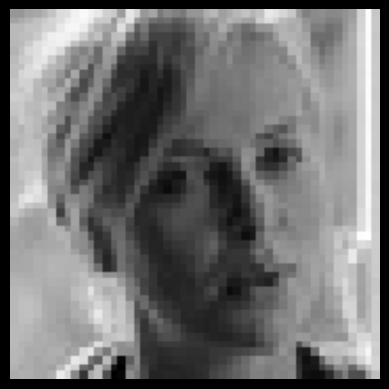

Image: /content/images/images/validation/neutral/23012.jpg
Predicted class: neutral
Probability: 58.9%
1/1 [==============================] - 0s 29ms/step


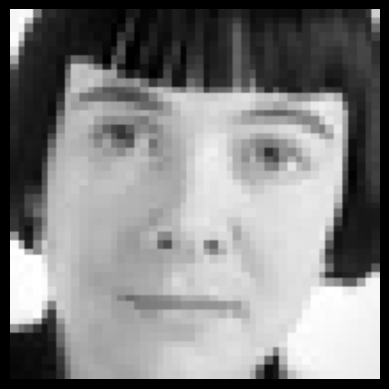

Image: /content/images/images/validation/neutral/31189.jpg
Predicted class: neutral
Probability: 98.8%
1/1 [==============================] - 0s 55ms/step


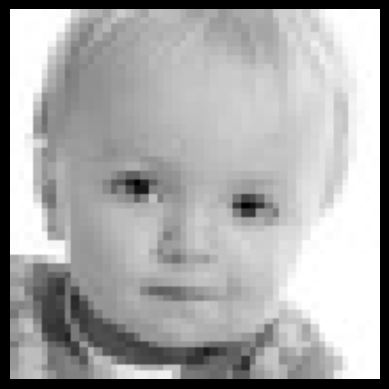

Image: /content/images/images/validation/neutral/17424.jpg
Predicted class: neutral
Probability: 98.9%
1/1 [==============================] - 0s 25ms/step


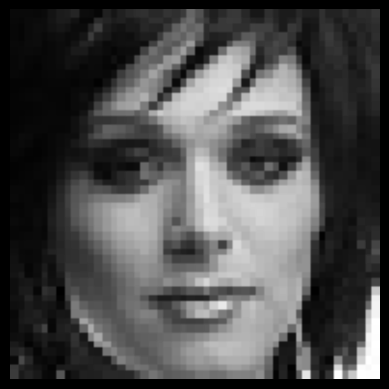

Image: /content/images/images/validation/neutral/22924.jpg
Predicted class: neutral
Probability: 98.8%
1/1 [==============================] - 0s 25ms/step


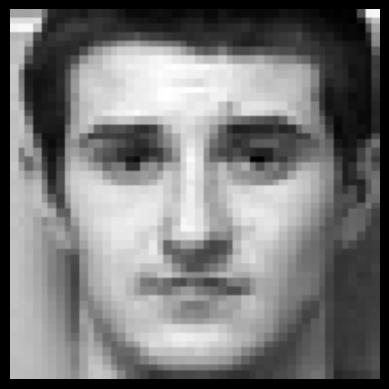

Image: /content/images/images/validation/neutral/17015.jpg
Predicted class: neutral
Probability: 73.8%
1/1 [==============================] - 0s 26ms/step


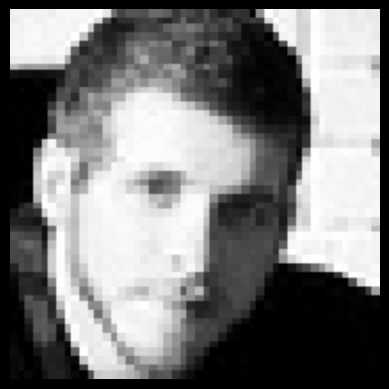

Image: /content/images/images/validation/neutral/12933.jpg
Predicted class: sad
Probability: 69.0%
1/1 [==============================] - 0s 30ms/step


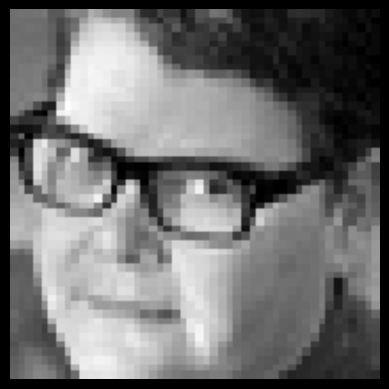

Image: /content/images/images/validation/neutral/14362.jpg
Predicted class: neutral
Probability: 84.9%
1/1 [==============================] - 0s 29ms/step


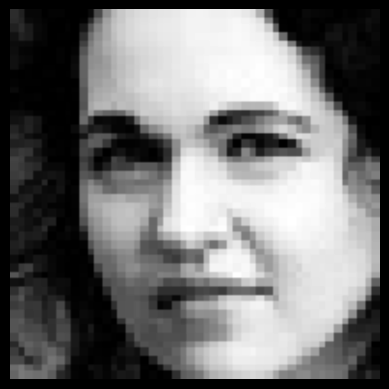

Image: /content/images/images/validation/neutral/17131.jpg
Predicted class: angry
Probability: 43.9%
1/1 [==============================] - 0s 52ms/step


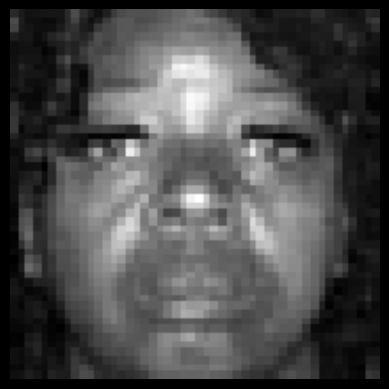

Image: /content/images/images/validation/neutral/2792.jpg
Predicted class: neutral
Probability: 99.3%
1/1 [==============================] - 0s 25ms/step


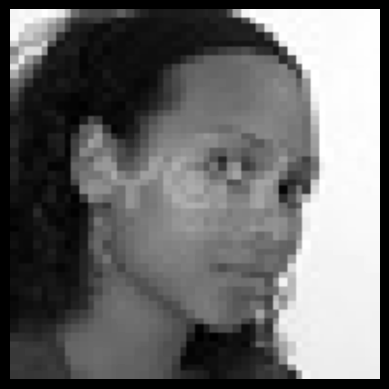

Image: /content/images/images/validation/neutral/4124.jpg
Predicted class: neutral
Probability: 95.4%
1/1 [==============================] - 0s 26ms/step


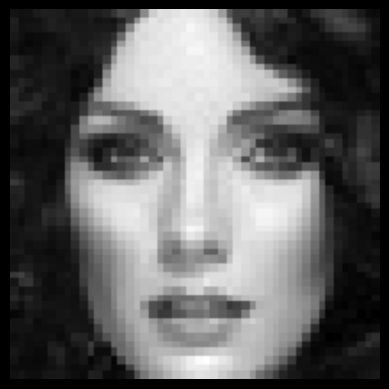

Image: /content/images/images/validation/neutral/22787.jpg
Predicted class: neutral
Probability: 97.0%
1/1 [==============================] - 0s 27ms/step


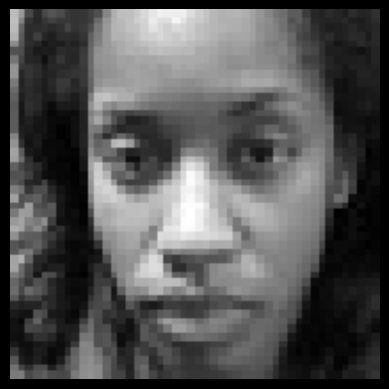

Image: /content/images/images/validation/neutral/33317.jpg
Predicted class: neutral
Probability: 96.8%
1/1 [==============================] - 0s 37ms/step


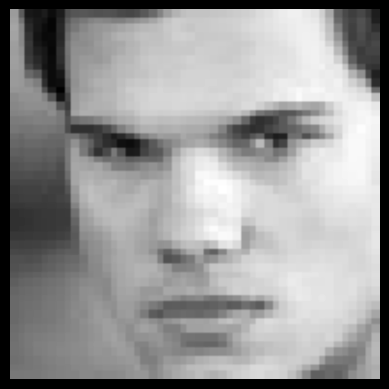

Image: /content/images/images/validation/neutral/18168.jpg
Predicted class: neutral
Probability: 58.1%
1/1 [==============================] - 0s 60ms/step


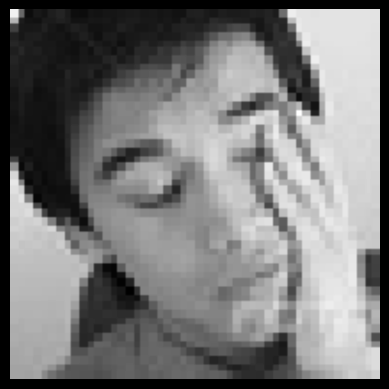

Image: /content/images/images/validation/neutral/31478.jpg
Predicted class: neutral
Probability: 57.3%
1/1 [==============================] - 0s 46ms/step


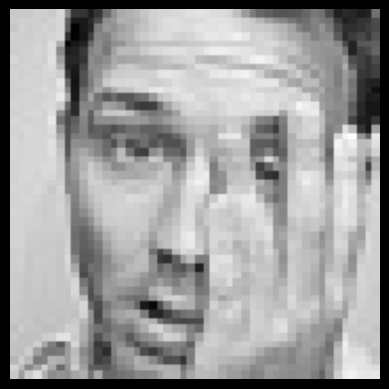

Image: /content/images/images/validation/neutral/35775.jpg
Predicted class: fear
Probability: 41.1%
1/1 [==============================] - 0s 59ms/step


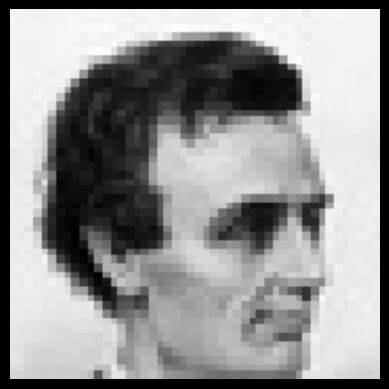

Image: /content/images/images/validation/neutral/2535.jpg
Predicted class: neutral
Probability: 98.7%
1/1 [==============================] - 0s 46ms/step


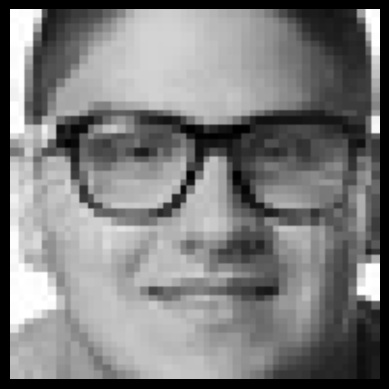

Image: /content/images/images/validation/neutral/28269.jpg
Predicted class: happy
Probability: 57.9%
1/1 [==============================] - 0s 57ms/step


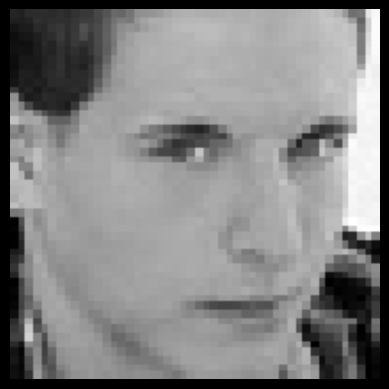

Image: /content/images/images/validation/neutral/20274.jpg
Predicted class: sad
Probability: 59.1%
1/1 [==============================] - 0s 47ms/step


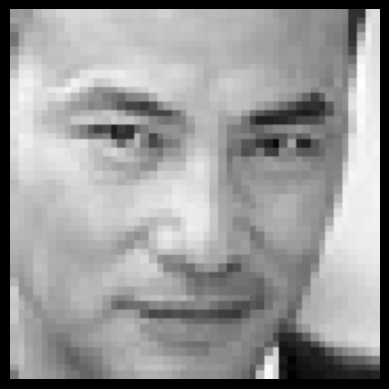

Image: /content/images/images/validation/neutral/4953.jpg
Predicted class: neutral
Probability: 78.2%
1/1 [==============================] - 0s 29ms/step


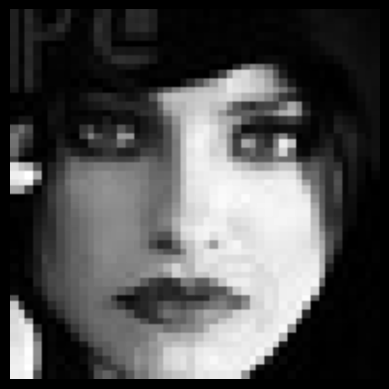

Image: /content/images/images/validation/neutral/8280.jpg
Predicted class: neutral
Probability: 97.0%
1/1 [==============================] - 0s 40ms/step


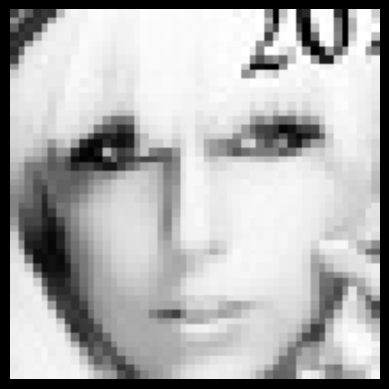

Image: /content/images/images/validation/neutral/22617.jpg
Predicted class: neutral
Probability: 86.0%
1/1 [==============================] - 0s 27ms/step


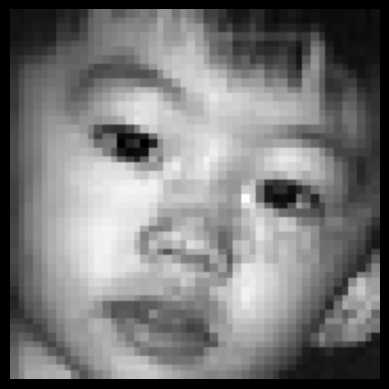

Image: /content/images/images/validation/neutral/26464.jpg
Predicted class: neutral
Probability: 99.8%
1/1 [==============================] - 0s 26ms/step


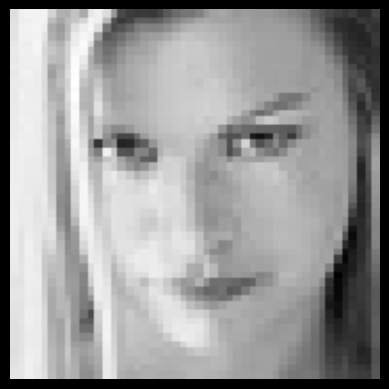

Image: /content/images/images/validation/neutral/5323.jpg
Predicted class: neutral
Probability: 96.5%
1/1 [==============================] - 0s 43ms/step


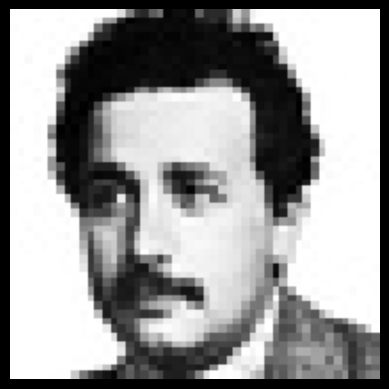

Image: /content/images/images/validation/neutral/21167.jpg
Predicted class: neutral
Probability: 99.9%
1/1 [==============================] - 0s 47ms/step


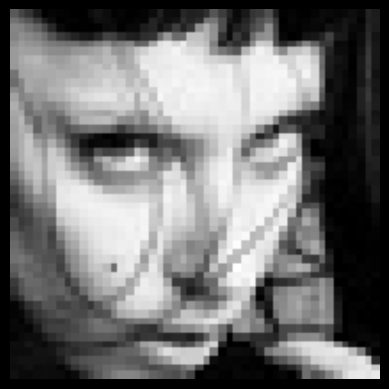

Image: /content/images/images/validation/neutral/31546.jpg
Predicted class: sad
Probability: 97.7%
1/1 [==============================] - 0s 36ms/step


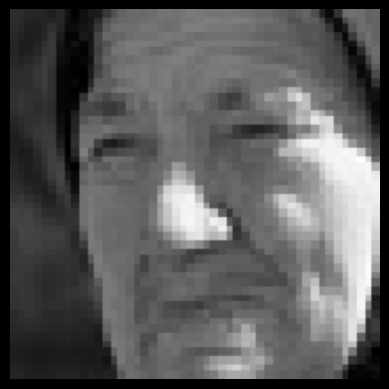

Image: /content/images/images/validation/neutral/16196.jpg
Predicted class: neutral
Probability: 91.1%
1/1 [==============================] - 0s 57ms/step


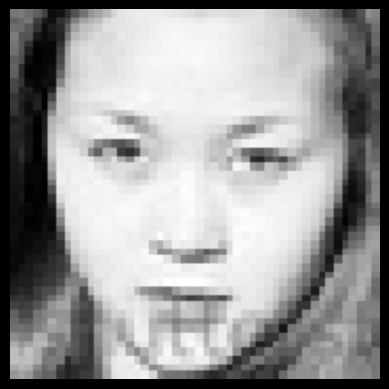

Image: /content/images/images/validation/neutral/35852.jpg
Predicted class: neutral
Probability: 91.7%
1/1 [==============================] - 0s 26ms/step


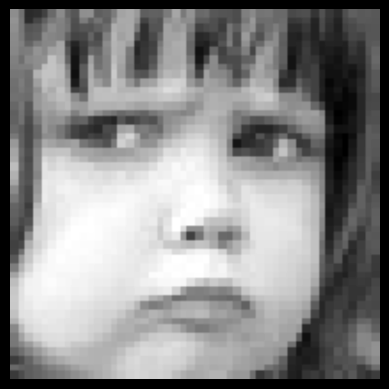

Image: /content/images/images/validation/angry/6965.jpg
Predicted class: angry
Probability: 84.3%
1/1 [==============================] - 0s 28ms/step


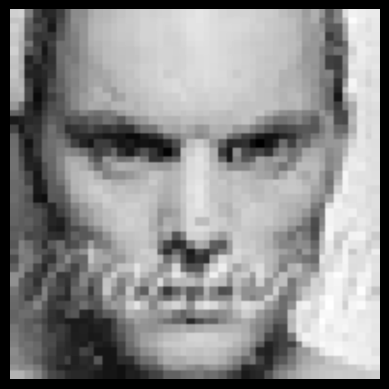

Image: /content/images/images/validation/angry/21135.jpg
Predicted class: angry
Probability: 71.9%
1/1 [==============================] - 0s 30ms/step


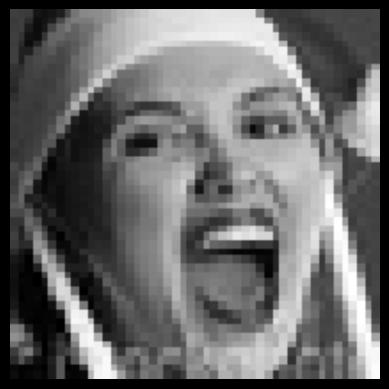

Image: /content/images/images/validation/angry/7136.jpg
Predicted class: angry
Probability: 98.7%
1/1 [==============================] - 0s 26ms/step


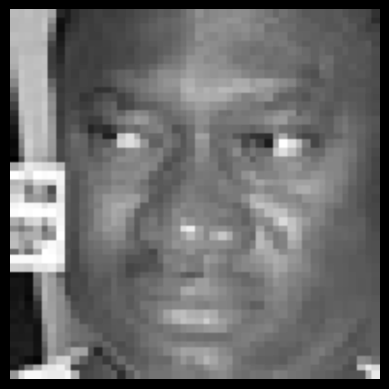

Image: /content/images/images/validation/angry/26025.jpg
Predicted class: angry
Probability: 98.7%
1/1 [==============================] - 0s 30ms/step


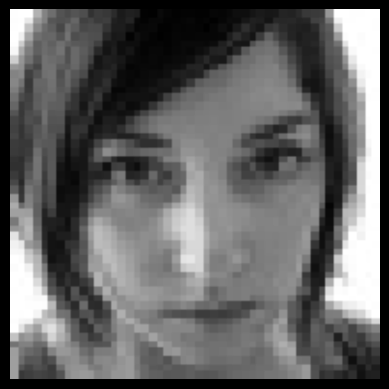

Image: /content/images/images/validation/angry/5739.jpg
Predicted class: fear
Probability: 48.3%
1/1 [==============================] - 0s 27ms/step


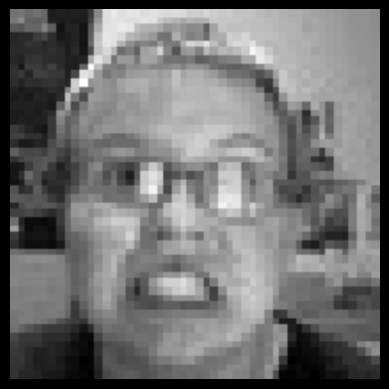

Image: /content/images/images/validation/angry/18534.jpg
Predicted class: angry
Probability: 58.0%
1/1 [==============================] - 0s 27ms/step


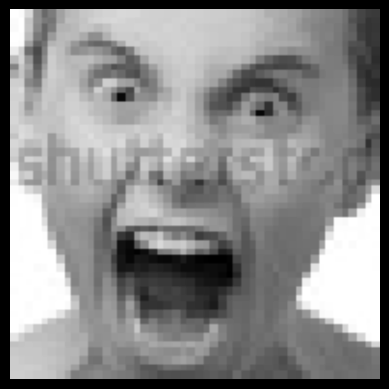

Image: /content/images/images/validation/angry/17705.jpg
Predicted class: angry
Probability: 86.6%
1/1 [==============================] - 0s 27ms/step


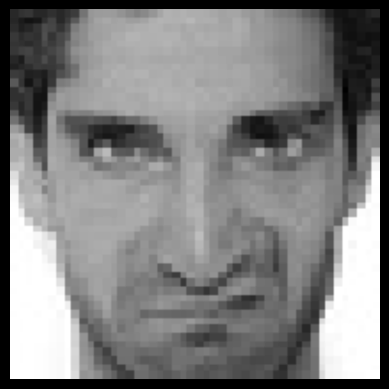

Image: /content/images/images/validation/angry/4015.jpg
Predicted class: angry
Probability: 93.2%
1/1 [==============================] - 0s 35ms/step


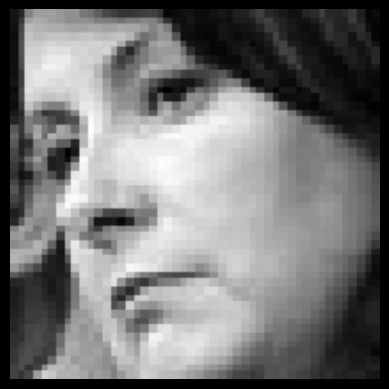

Image: /content/images/images/validation/angry/17752.jpg
Predicted class: angry
Probability: 95.0%
1/1 [==============================] - 0s 30ms/step


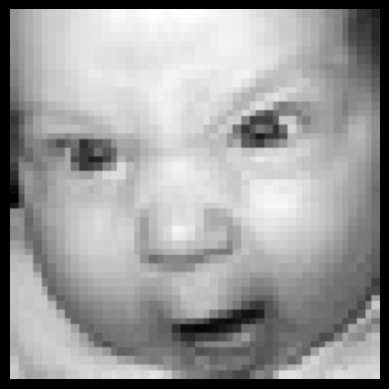

Image: /content/images/images/validation/angry/18779.jpg
Predicted class: angry
Probability: 89.9%
1/1 [==============================] - 0s 34ms/step


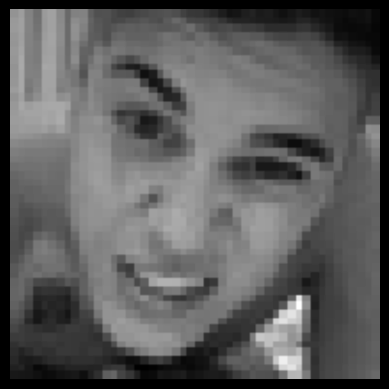

Image: /content/images/images/validation/angry/26597.jpg
Predicted class: angry
Probability: 94.3%
1/1 [==============================] - 0s 34ms/step


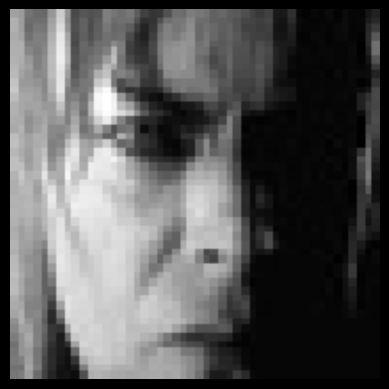

Image: /content/images/images/validation/angry/29527.jpg
Predicted class: fear
Probability: 31.2%
1/1 [==============================] - 0s 34ms/step


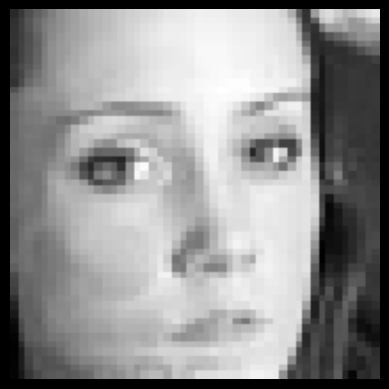

Image: /content/images/images/validation/angry/10583.jpg
Predicted class: angry
Probability: 67.4%
1/1 [==============================] - 0s 34ms/step


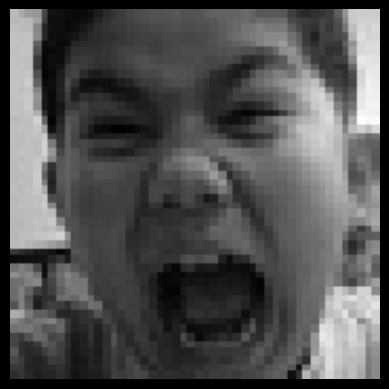

Image: /content/images/images/validation/angry/9331.jpg
Predicted class: angry
Probability: 92.4%
1/1 [==============================] - 0s 27ms/step


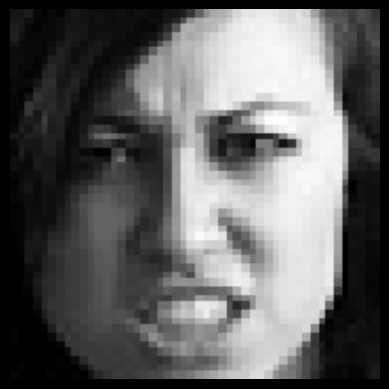

Image: /content/images/images/validation/angry/6283.jpg
Predicted class: angry
Probability: 99.7%
1/1 [==============================] - 0s 34ms/step


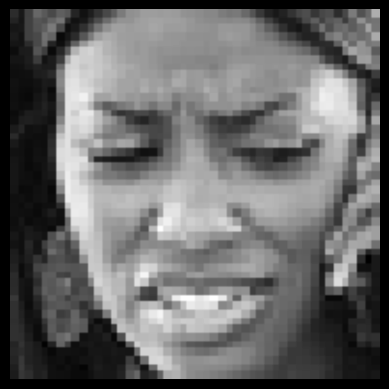

Image: /content/images/images/validation/angry/35210.jpg
Predicted class: angry
Probability: 67.3%
1/1 [==============================] - 0s 41ms/step


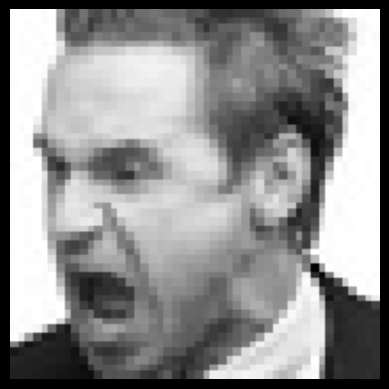

Image: /content/images/images/validation/angry/4077.jpg
Predicted class: angry
Probability: 99.8%
1/1 [==============================] - 0s 37ms/step


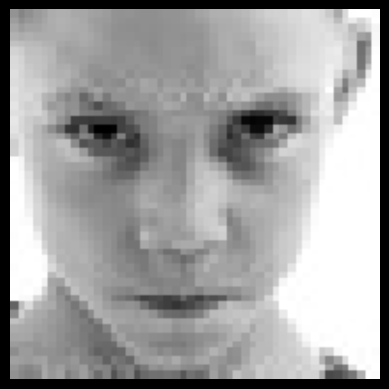

Image: /content/images/images/validation/angry/20505.jpg
Predicted class: angry
Probability: 98.9%
1/1 [==============================] - 0s 32ms/step


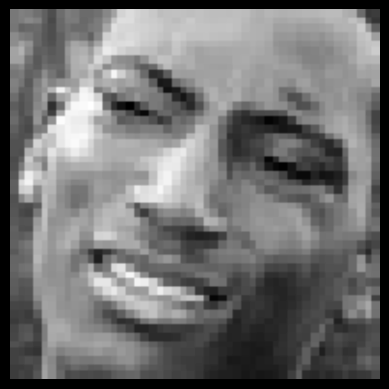

Image: /content/images/images/validation/angry/29614.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 33ms/step


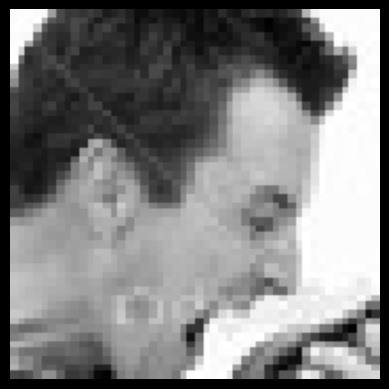

Image: /content/images/images/validation/angry/1736.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 33ms/step


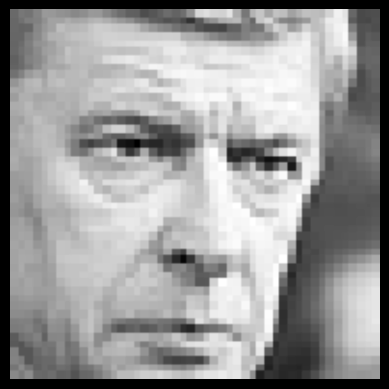

Image: /content/images/images/validation/angry/31544.jpg
Predicted class: sad
Probability: 54.2%
1/1 [==============================] - 0s 37ms/step


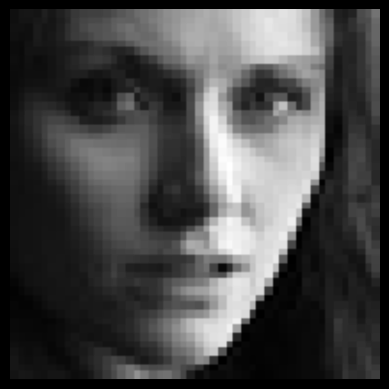

Image: /content/images/images/validation/angry/16557.jpg
Predicted class: angry
Probability: 92.9%
1/1 [==============================] - 0s 43ms/step


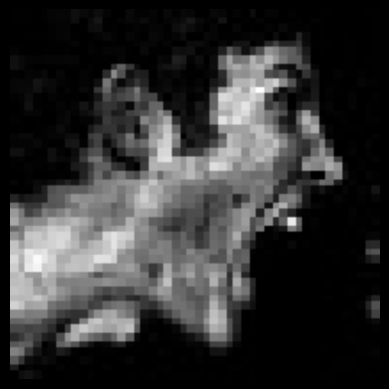

Image: /content/images/images/validation/angry/6426.jpg
Predicted class: angry
Probability: 45.7%
1/1 [==============================] - 0s 34ms/step


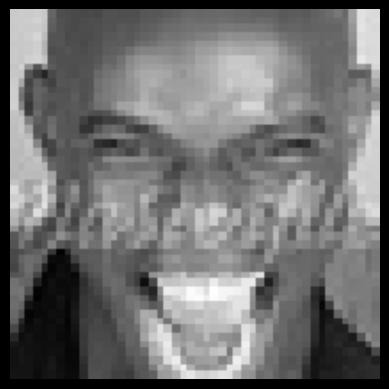

Image: /content/images/images/validation/angry/5637.jpg
Predicted class: angry
Probability: 96.9%
1/1 [==============================] - 0s 44ms/step


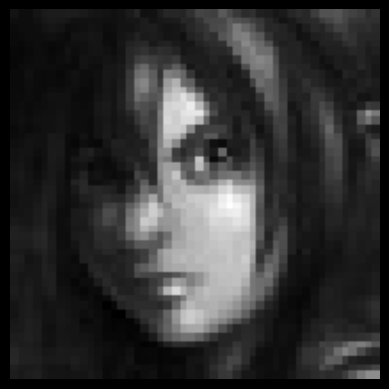

Image: /content/images/images/validation/angry/4660.jpg
Predicted class: angry
Probability: 98.3%
1/1 [==============================] - 0s 44ms/step


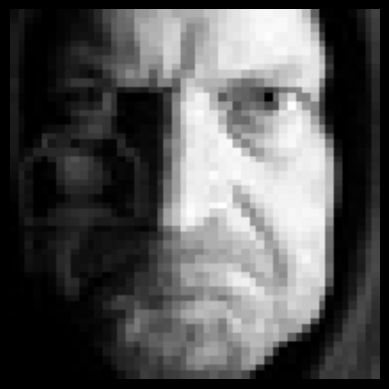

Image: /content/images/images/validation/angry/17344.jpg
Predicted class: angry
Probability: 99.6%
1/1 [==============================] - 0s 28ms/step


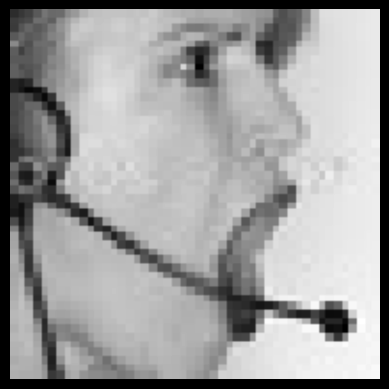

Image: /content/images/images/validation/angry/32506.jpg
Predicted class: happy
Probability: 75.4%
1/1 [==============================] - 0s 27ms/step


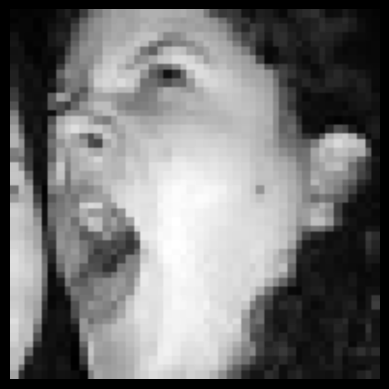

Image: /content/images/images/validation/angry/20739.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


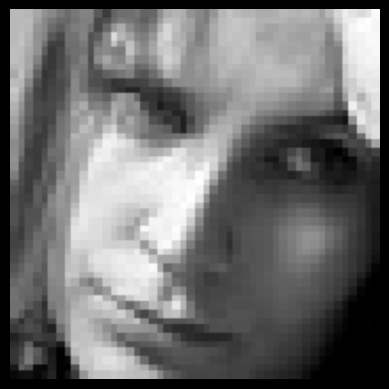

Image: /content/images/images/validation/angry/8593.jpg
Predicted class: angry
Probability: 95.1%
1/1 [==============================] - 0s 35ms/step


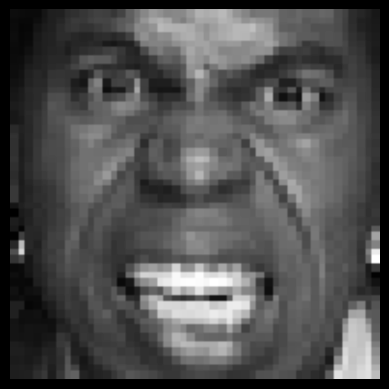

Image: /content/images/images/validation/angry/10554.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 27ms/step


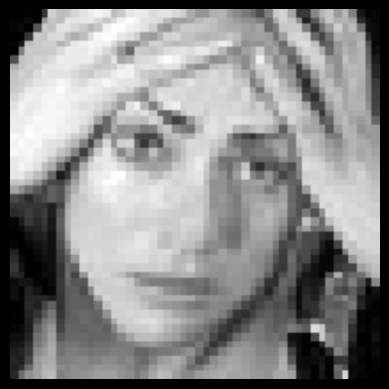

Image: /content/images/images/validation/angry/16222.jpg
Predicted class: sad
Probability: 94.4%
1/1 [==============================] - 0s 43ms/step


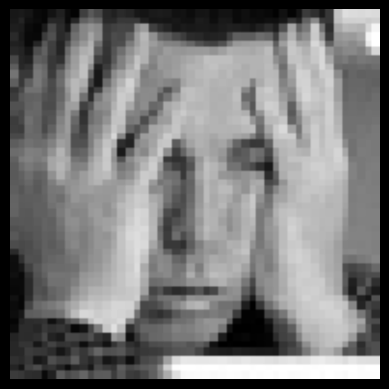

Image: /content/images/images/validation/angry/10065.jpg
Predicted class: angry
Probability: 95.5%
1/1 [==============================] - 0s 29ms/step


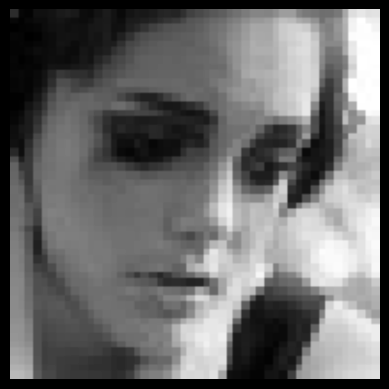

Image: /content/images/images/validation/angry/4397.jpg
Predicted class: angry
Probability: 60.5%
1/1 [==============================] - 0s 28ms/step


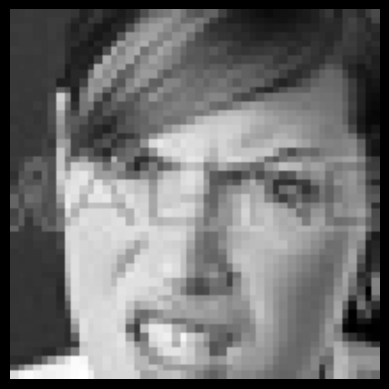

Image: /content/images/images/validation/angry/1071.jpg
Predicted class: angry
Probability: 56.5%
1/1 [==============================] - 0s 26ms/step


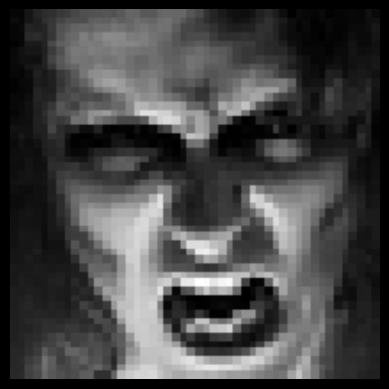

Image: /content/images/images/validation/angry/20290.jpg
Predicted class: angry
Probability: 98.2%
1/1 [==============================] - 0s 38ms/step


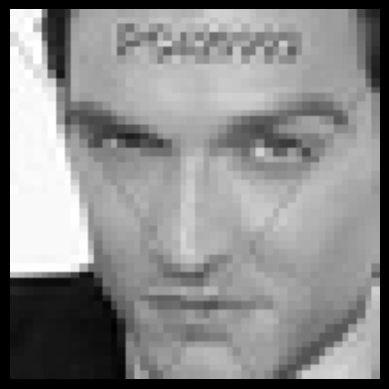

Image: /content/images/images/validation/angry/24819.jpg
Predicted class: angry
Probability: 99.3%
1/1 [==============================] - 0s 30ms/step


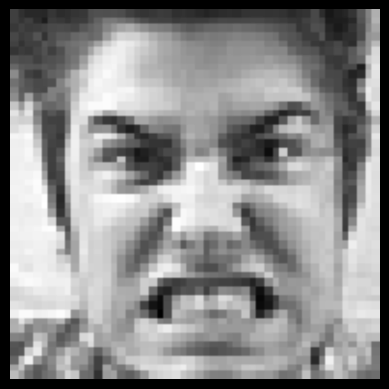

Image: /content/images/images/validation/angry/23532.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 29ms/step


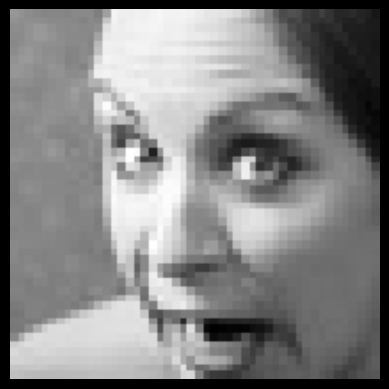

Image: /content/images/images/validation/angry/1386.jpg
Predicted class: angry
Probability: 86.4%
1/1 [==============================] - 0s 26ms/step


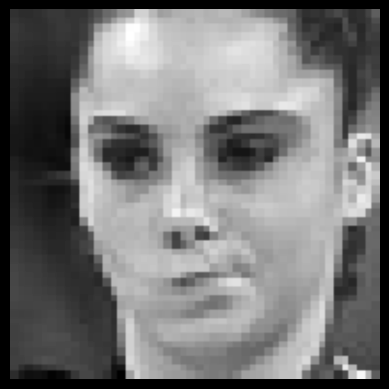

Image: /content/images/images/validation/angry/1438.jpg
Predicted class: angry
Probability: 60.9%
1/1 [==============================] - 0s 29ms/step


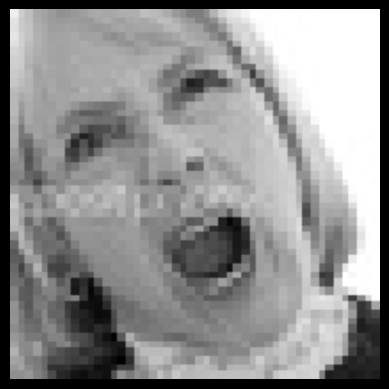

Image: /content/images/images/validation/angry/8734.jpg
Predicted class: angry
Probability: 94.1%
1/1 [==============================] - 0s 34ms/step


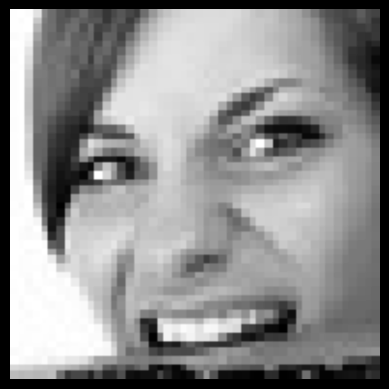

Image: /content/images/images/validation/angry/24435.jpg
Predicted class: happy
Probability: 41.6%
1/1 [==============================] - 0s 59ms/step


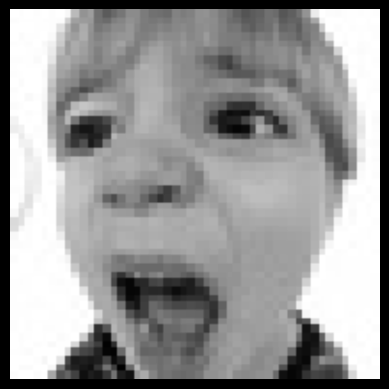

Image: /content/images/images/validation/angry/15715.jpg
Predicted class: angry
Probability: 90.0%
1/1 [==============================] - 0s 26ms/step


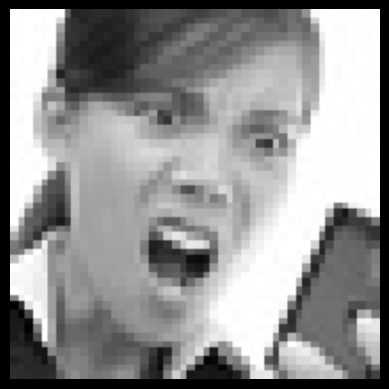

Image: /content/images/images/validation/angry/29588.jpg
Predicted class: angry
Probability: 99.0%
1/1 [==============================] - 0s 46ms/step


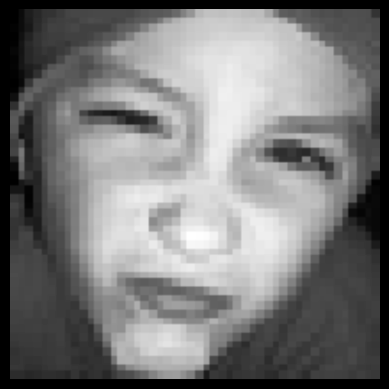

Image: /content/images/images/validation/angry/19060.jpg
Predicted class: angry
Probability: 59.3%
1/1 [==============================] - 0s 26ms/step


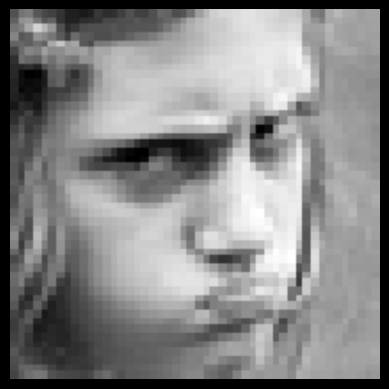

Image: /content/images/images/validation/angry/23780.jpg
Predicted class: angry
Probability: 84.7%
1/1 [==============================] - 0s 30ms/step


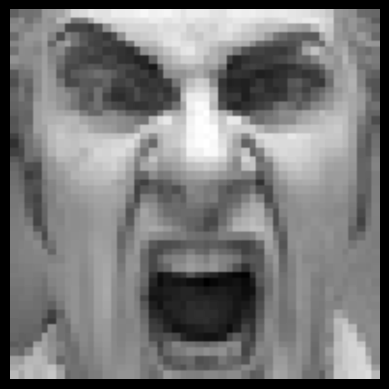

Image: /content/images/images/validation/angry/20736.jpg
Predicted class: angry
Probability: 85.4%
1/1 [==============================] - 0s 54ms/step


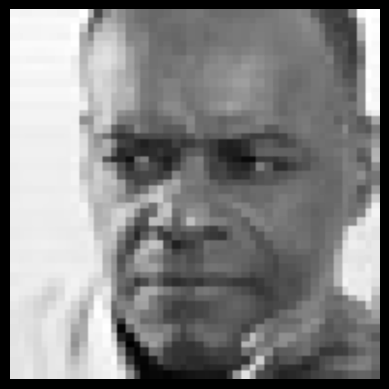

Image: /content/images/images/validation/angry/31033.jpg
Predicted class: angry
Probability: 95.9%
1/1 [==============================] - 0s 65ms/step


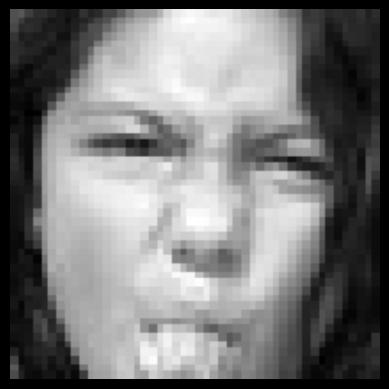

Image: /content/images/images/validation/angry/7492.jpg
Predicted class: angry
Probability: 59.7%
1/1 [==============================] - 0s 34ms/step


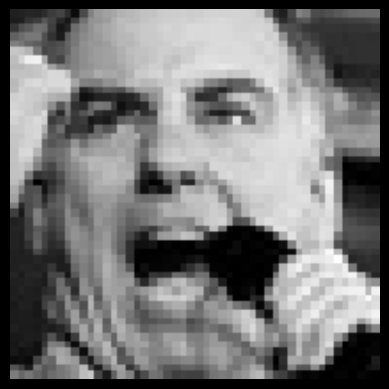

Image: /content/images/images/validation/angry/19152.jpg
Predicted class: angry
Probability: 99.1%
1/1 [==============================] - 0s 36ms/step


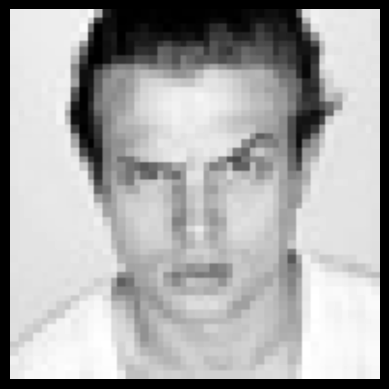

Image: /content/images/images/validation/angry/1106.jpg
Predicted class: angry
Probability: 99.3%
1/1 [==============================] - 0s 31ms/step


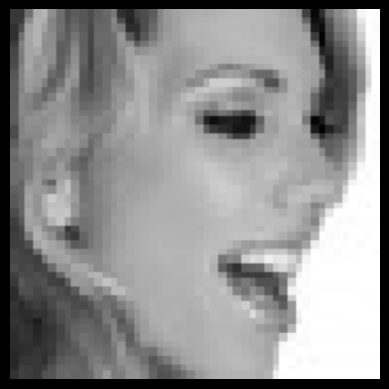

Image: /content/images/images/validation/angry/27777.jpg
Predicted class: angry
Probability: 46.3%
1/1 [==============================] - 0s 45ms/step


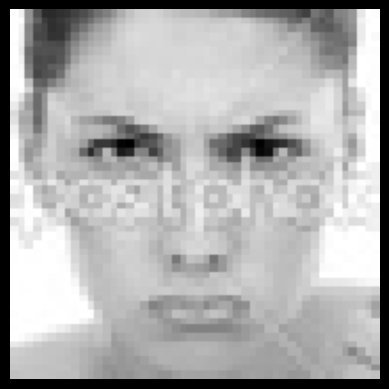

Image: /content/images/images/validation/angry/6484.jpg
Predicted class: angry
Probability: 99.4%
1/1 [==============================] - 0s 48ms/step


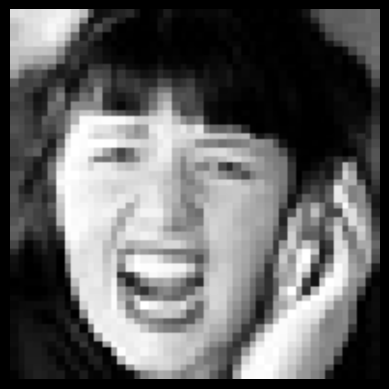

Image: /content/images/images/validation/angry/17209.jpg
Predicted class: angry
Probability: 96.0%
1/1 [==============================] - 0s 48ms/step


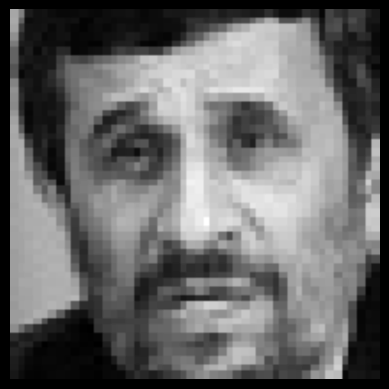

Image: /content/images/images/validation/angry/32575.jpg
Predicted class: neutral
Probability: 65.2%
1/1 [==============================] - 0s 47ms/step


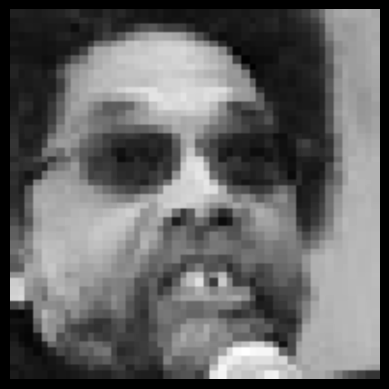

Image: /content/images/images/validation/angry/12695.jpg
Predicted class: angry
Probability: 93.5%
1/1 [==============================] - 0s 54ms/step


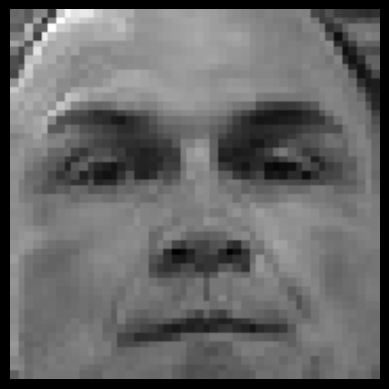

Image: /content/images/images/validation/angry/1215.jpg
Predicted class: angry
Probability: 69.4%
1/1 [==============================] - 0s 32ms/step


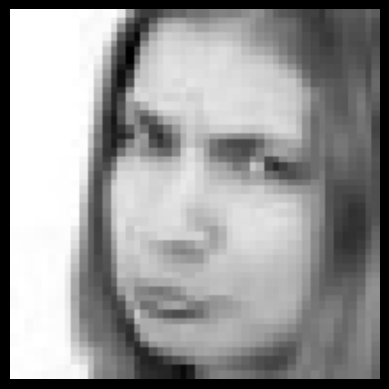

Image: /content/images/images/validation/angry/11266.jpg
Predicted class: angry
Probability: 93.9%
1/1 [==============================] - 0s 35ms/step


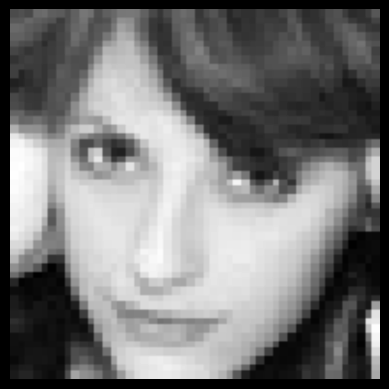

Image: /content/images/images/validation/angry/764.jpg
Predicted class: angry
Probability: 99.4%
1/1 [==============================] - 0s 27ms/step


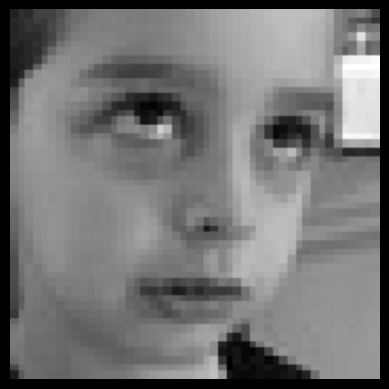

Image: /content/images/images/validation/angry/16565.jpg
Predicted class: angry
Probability: 47.7%
1/1 [==============================] - 0s 48ms/step


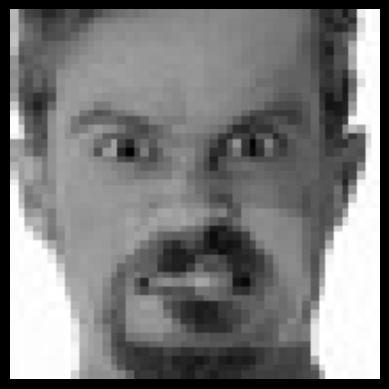

Image: /content/images/images/validation/angry/12183.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 46ms/step


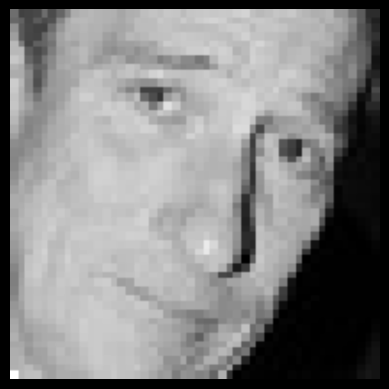

Image: /content/images/images/validation/angry/34040.jpg
Predicted class: sad
Probability: 81.7%
1/1 [==============================] - 0s 29ms/step


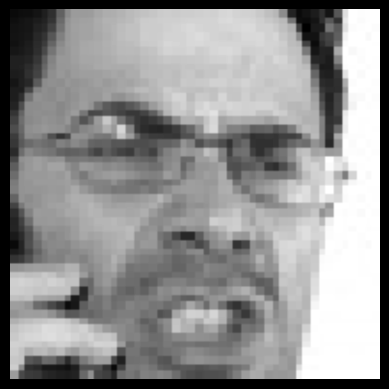

Image: /content/images/images/validation/angry/25886.jpg
Predicted class: angry
Probability: 98.1%
1/1 [==============================] - 0s 51ms/step


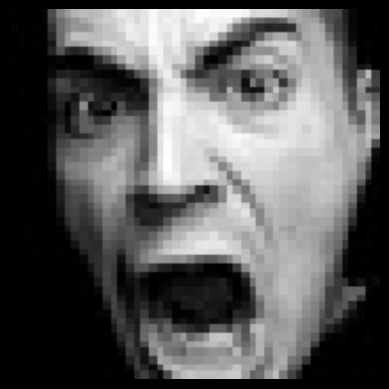

Image: /content/images/images/validation/angry/33105.jpg
Predicted class: fear
Probability: 91.2%
1/1 [==============================] - 0s 34ms/step


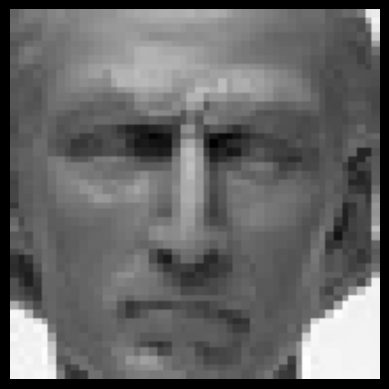

Image: /content/images/images/validation/angry/14831.jpg
Predicted class: angry
Probability: 80.7%
1/1 [==============================] - 0s 31ms/step


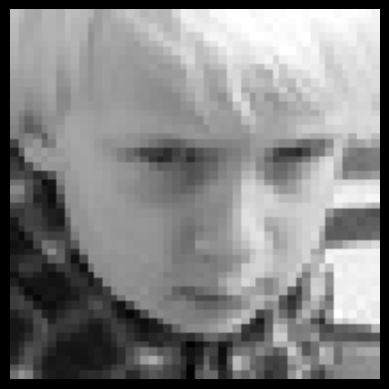

Image: /content/images/images/validation/angry/14381.jpg
Predicted class: angry
Probability: 62.8%
1/1 [==============================] - 0s 33ms/step


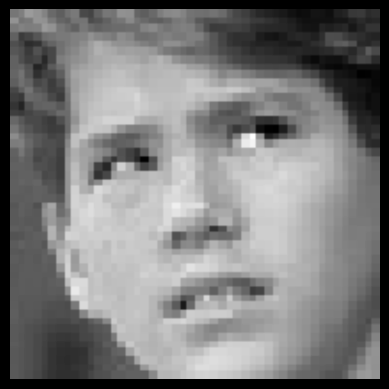

Image: /content/images/images/validation/angry/13431.jpg
Predicted class: angry
Probability: 49.0%
1/1 [==============================] - 0s 39ms/step


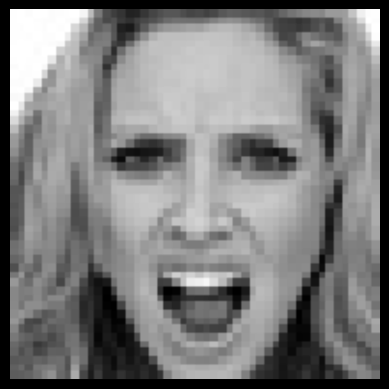

Image: /content/images/images/validation/angry/2557.jpg
Predicted class: angry
Probability: 99.2%
1/1 [==============================] - 0s 30ms/step


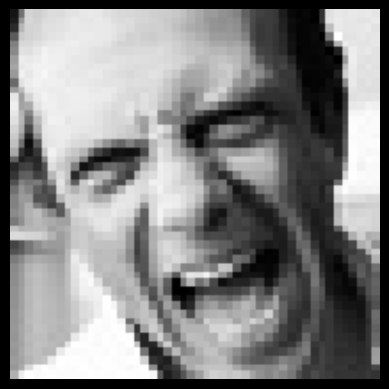

Image: /content/images/images/validation/angry/19923.jpg
Predicted class: angry
Probability: 99.8%
1/1 [==============================] - 0s 29ms/step


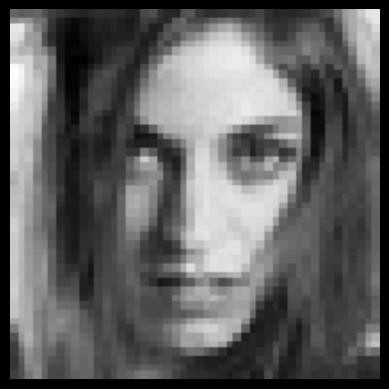

Image: /content/images/images/validation/angry/8103.jpg
Predicted class: neutral
Probability: 72.2%
1/1 [==============================] - 0s 42ms/step


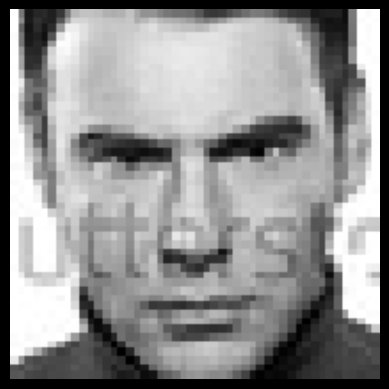

Image: /content/images/images/validation/angry/35407.jpg
Predicted class: neutral
Probability: 67.4%
1/1 [==============================] - 0s 36ms/step


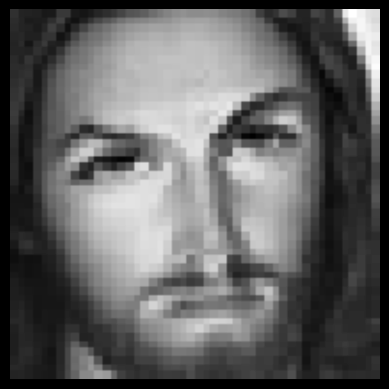

Image: /content/images/images/validation/angry/25795.jpg
Predicted class: angry
Probability: 49.5%
1/1 [==============================] - 0s 35ms/step


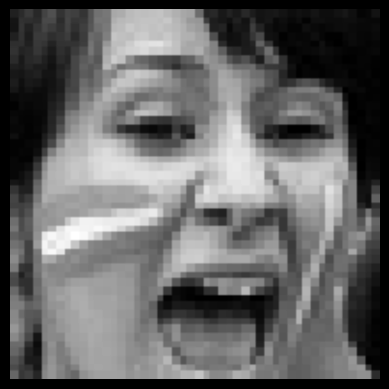

Image: /content/images/images/validation/angry/27054.jpg
Predicted class: angry
Probability: 99.6%
1/1 [==============================] - 0s 29ms/step


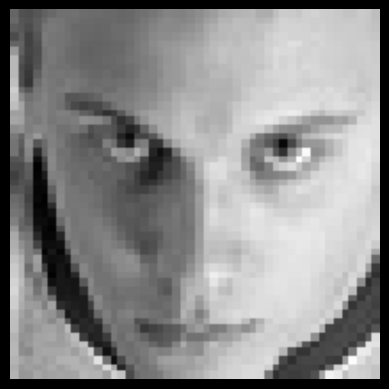

Image: /content/images/images/validation/angry/27744.jpg
Predicted class: fear
Probability: 44.0%
1/1 [==============================] - 0s 37ms/step


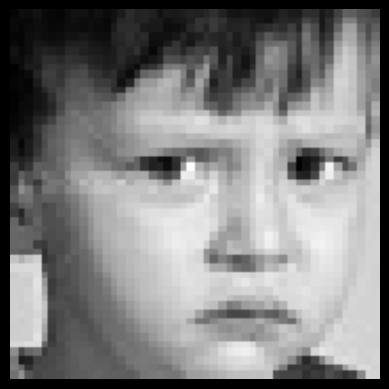

Image: /content/images/images/validation/angry/13279.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 43ms/step


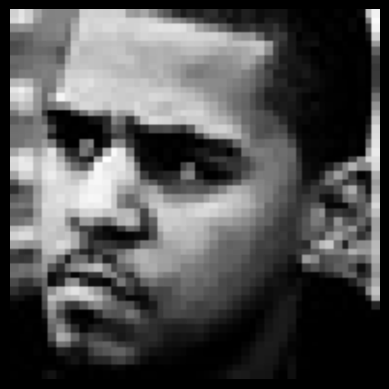

Image: /content/images/images/validation/angry/28148.jpg
Predicted class: angry
Probability: 98.2%
1/1 [==============================] - 0s 32ms/step


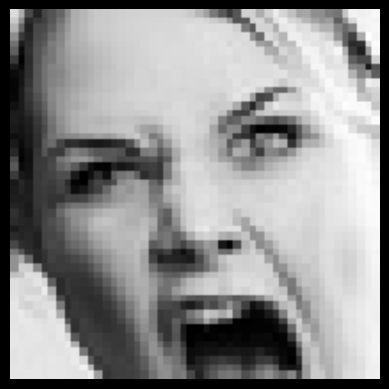

Image: /content/images/images/validation/angry/6420.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 31ms/step


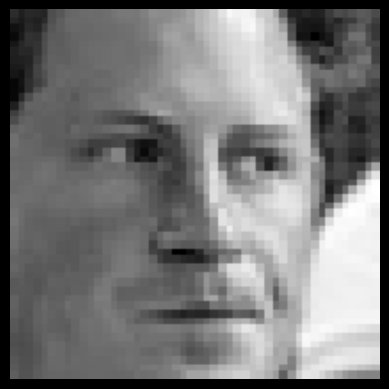

Image: /content/images/images/validation/angry/28884.jpg
Predicted class: sad
Probability: 41.5%
1/1 [==============================] - 0s 28ms/step


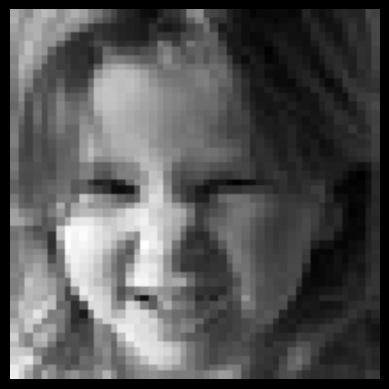

Image: /content/images/images/validation/angry/25542.jpg
Predicted class: angry
Probability: 98.6%
1/1 [==============================] - 0s 31ms/step


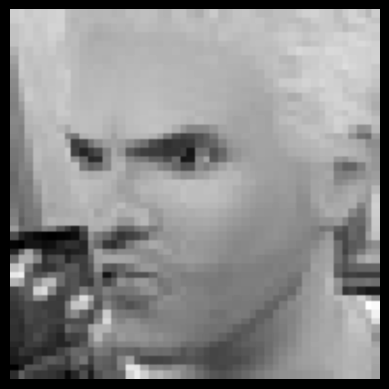

Image: /content/images/images/validation/angry/14706.jpg
Predicted class: angry
Probability: 96.5%
1/1 [==============================] - 0s 30ms/step


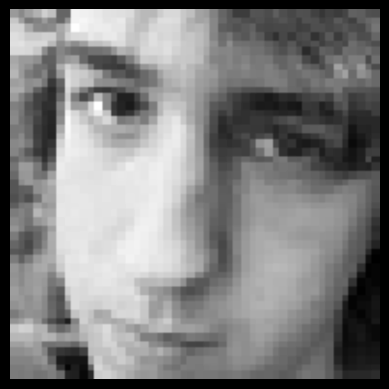

Image: /content/images/images/validation/angry/19392.jpg
Predicted class: angry
Probability: 35.2%
1/1 [==============================] - 0s 30ms/step


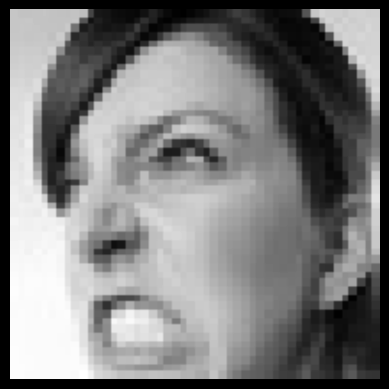

Image: /content/images/images/validation/angry/13267.jpg
Predicted class: angry
Probability: 99.0%
1/1 [==============================] - 0s 27ms/step


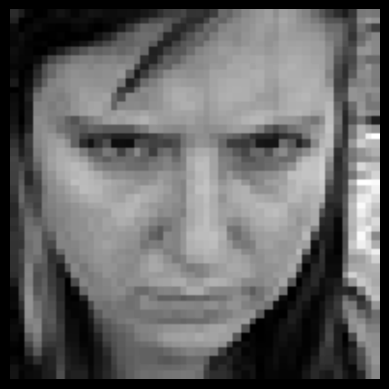

Image: /content/images/images/validation/angry/5519.jpg
Predicted class: angry
Probability: 96.9%
1/1 [==============================] - 0s 27ms/step


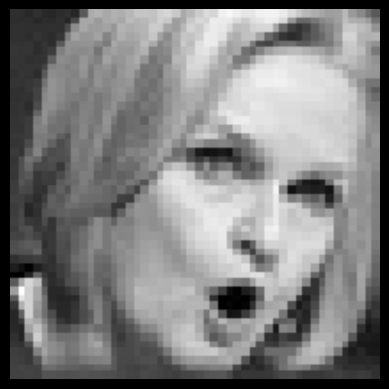

Image: /content/images/images/validation/angry/17316.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 27ms/step


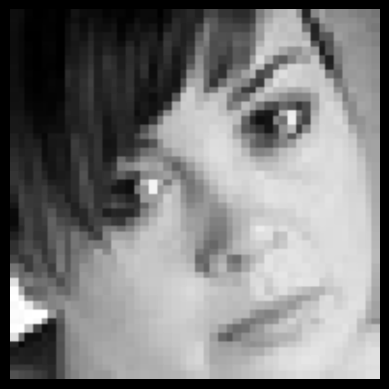

Image: /content/images/images/validation/angry/10818.jpg
Predicted class: angry
Probability: 56.7%
1/1 [==============================] - 0s 27ms/step


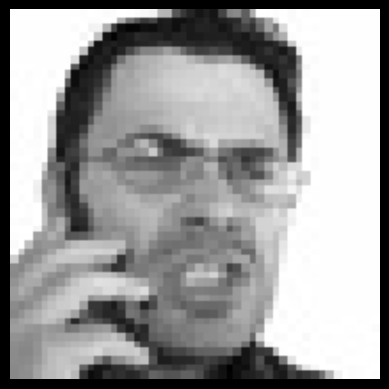

Image: /content/images/images/validation/angry/25813.jpg
Predicted class: angry
Probability: 96.4%
1/1 [==============================] - 0s 30ms/step


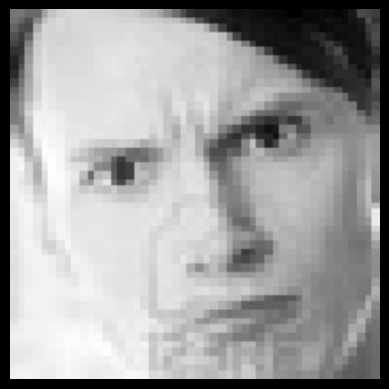

Image: /content/images/images/validation/angry/11467.jpg
Predicted class: angry
Probability: 52.2%
1/1 [==============================] - 0s 30ms/step


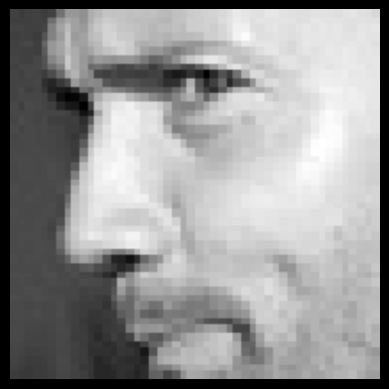

Image: /content/images/images/validation/angry/15474.jpg
Predicted class: sad
Probability: 87.5%
1/1 [==============================] - 0s 27ms/step


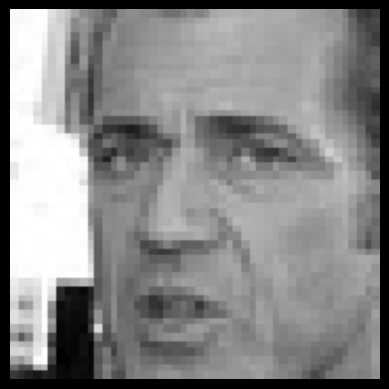

Image: /content/images/images/validation/angry/29085.jpg
Predicted class: fear
Probability: 64.5%
1/1 [==============================] - 0s 42ms/step


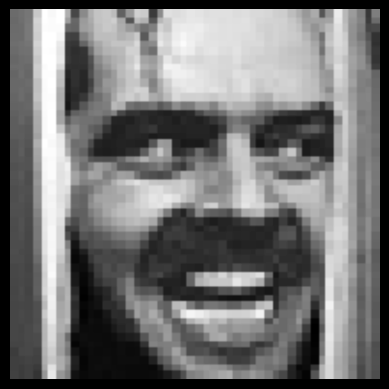

Image: /content/images/images/validation/angry/7589.jpg
Predicted class: angry
Probability: 95.7%
1/1 [==============================] - 0s 44ms/step


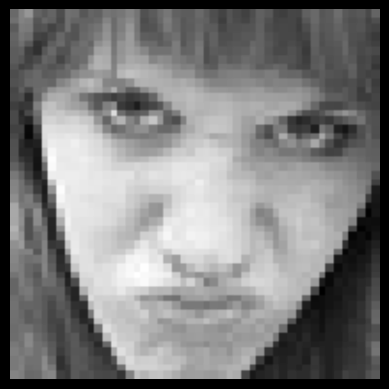

Image: /content/images/images/validation/angry/15848.jpg
Predicted class: angry
Probability: 97.1%
1/1 [==============================] - 0s 28ms/step


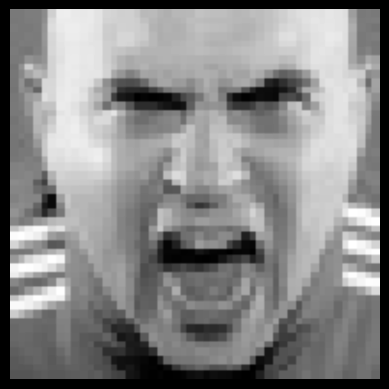

Image: /content/images/images/validation/angry/16792.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


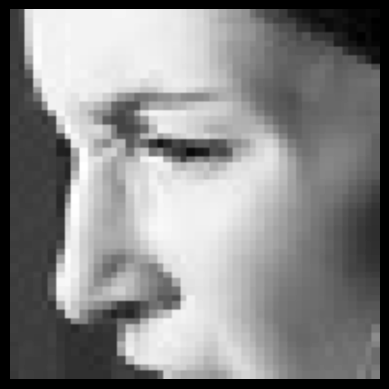

Image: /content/images/images/validation/angry/19485.jpg
Predicted class: angry
Probability: 93.4%
1/1 [==============================] - 0s 27ms/step


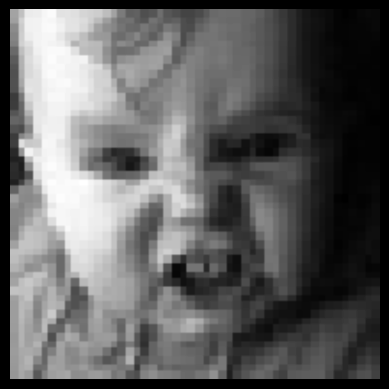

Image: /content/images/images/validation/angry/15919.jpg
Predicted class: angry
Probability: 98.9%
1/1 [==============================] - 0s 31ms/step


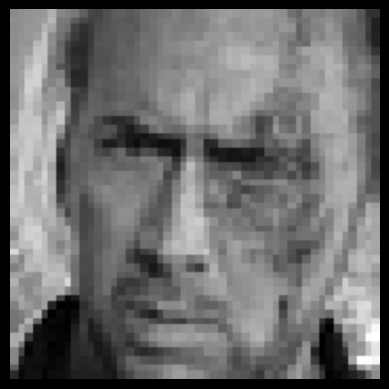

Image: /content/images/images/validation/angry/35145.jpg
Predicted class: angry
Probability: 99.8%
1/1 [==============================] - 0s 29ms/step


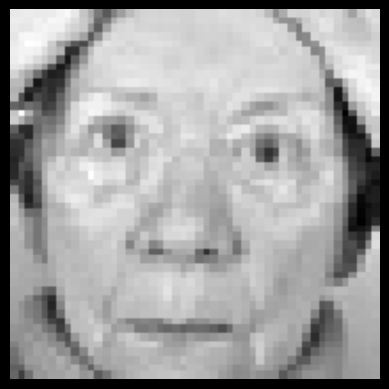

Image: /content/images/images/validation/angry/18161.jpg
Predicted class: angry
Probability: 46.8%
1/1 [==============================] - 0s 30ms/step


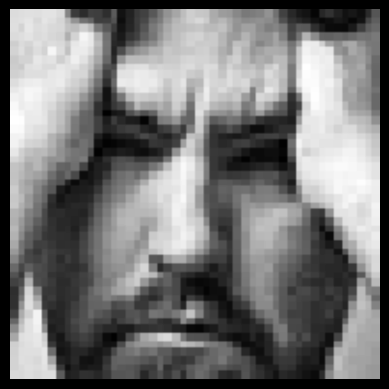

Image: /content/images/images/validation/angry/13582.jpg
Predicted class: fear
Probability: 44.5%
1/1 [==============================] - 0s 29ms/step


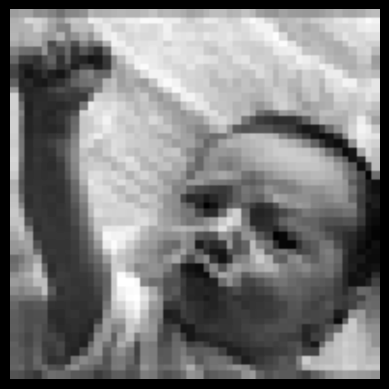

Image: /content/images/images/validation/angry/18492.jpg
Predicted class: angry
Probability: 96.0%
1/1 [==============================] - 0s 34ms/step


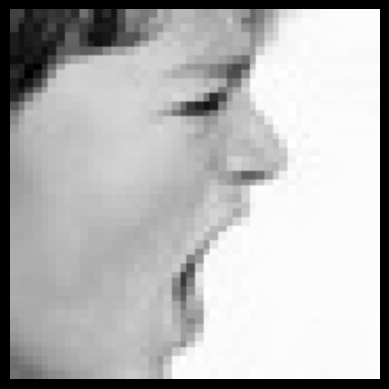

Image: /content/images/images/validation/angry/2055.jpg
Predicted class: disgust
Probability: 60.2%
1/1 [==============================] - 0s 26ms/step


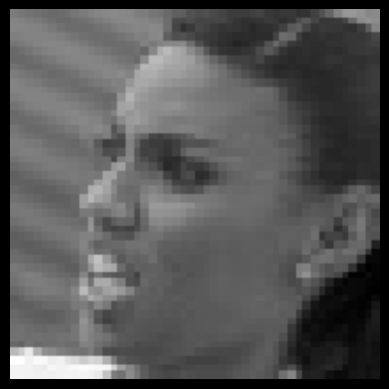

Image: /content/images/images/validation/angry/10382.jpg
Predicted class: angry
Probability: 98.9%
1/1 [==============================] - 0s 28ms/step


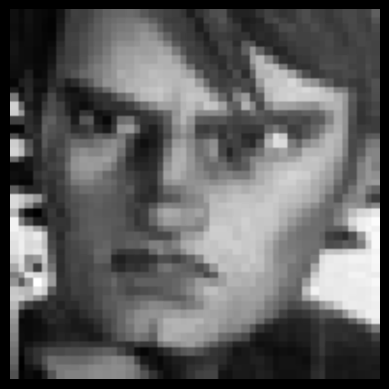

Image: /content/images/images/validation/angry/30004.jpg
Predicted class: angry
Probability: 46.5%
1/1 [==============================] - 0s 42ms/step


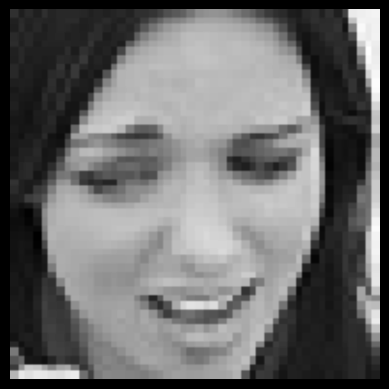

Image: /content/images/images/validation/fear/11360.jpg
Predicted class: fear
Probability: 81.3%
1/1 [==============================] - 0s 33ms/step


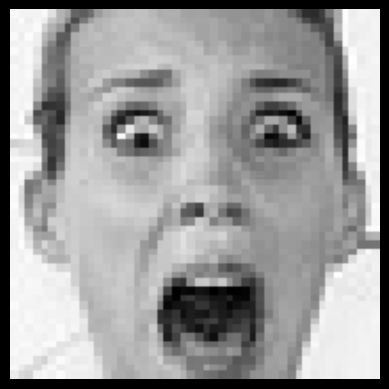

Image: /content/images/images/validation/fear/1128.jpg
Predicted class: fear
Probability: 64.5%
1/1 [==============================] - 0s 48ms/step


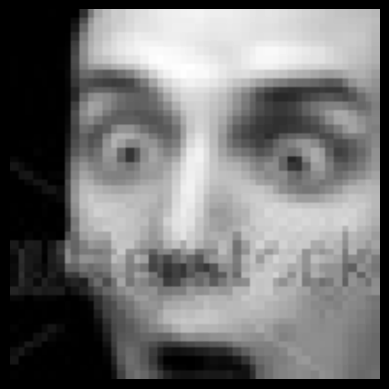

Image: /content/images/images/validation/fear/6366.jpg
Predicted class: fear
Probability: 90.5%
1/1 [==============================] - 0s 37ms/step


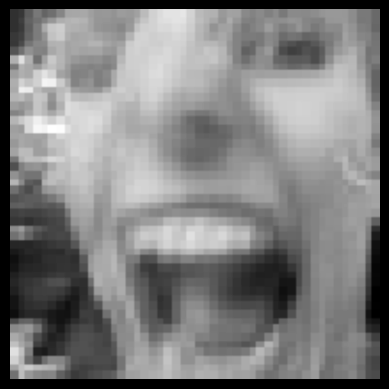

Image: /content/images/images/validation/fear/10043.jpg
Predicted class: fear
Probability: 96.3%
1/1 [==============================] - 0s 50ms/step


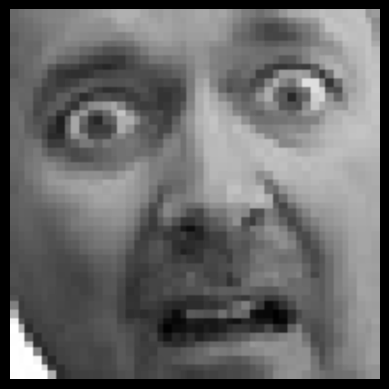

Image: /content/images/images/validation/fear/19020.jpg
Predicted class: fear
Probability: 47.8%
1/1 [==============================] - 0s 31ms/step


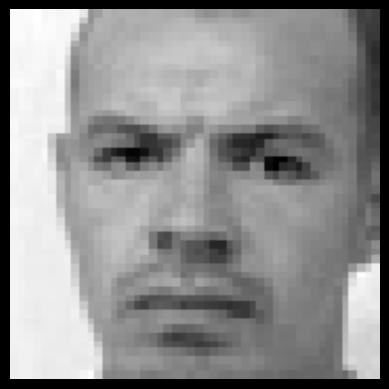

Image: /content/images/images/validation/fear/33535.jpg
Predicted class: fear
Probability: 98.4%
1/1 [==============================] - 0s 39ms/step


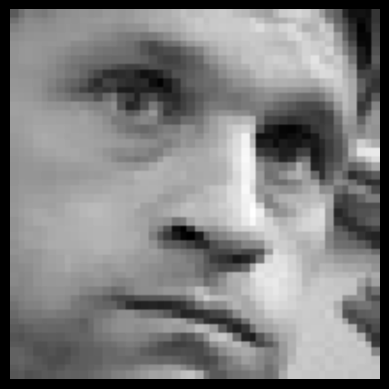

Image: /content/images/images/validation/fear/12496.jpg
Predicted class: fear
Probability: 92.0%
1/1 [==============================] - 0s 45ms/step


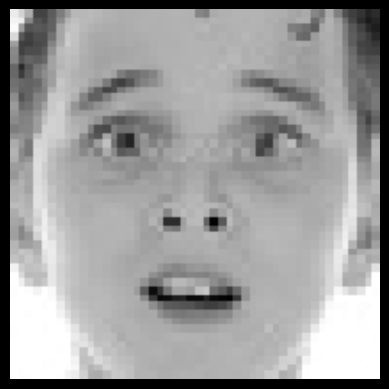

Image: /content/images/images/validation/fear/22520.jpg
Predicted class: fear
Probability: 81.4%
1/1 [==============================] - 0s 35ms/step


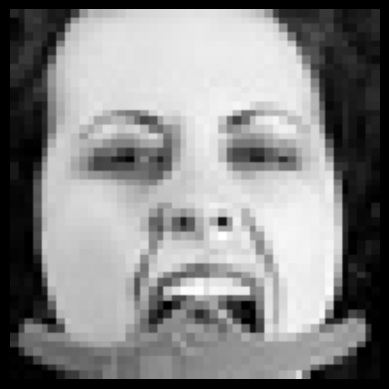

Image: /content/images/images/validation/fear/17479.jpg
Predicted class: fear
Probability: 65.2%
1/1 [==============================] - 0s 34ms/step


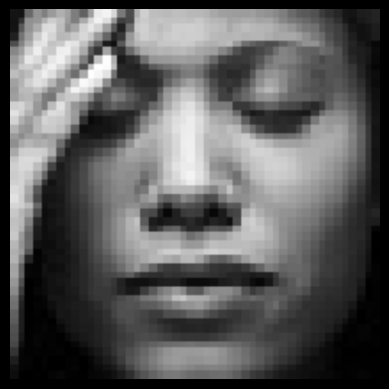

Image: /content/images/images/validation/fear/6876.jpg
Predicted class: fear
Probability: 92.7%
1/1 [==============================] - 0s 37ms/step


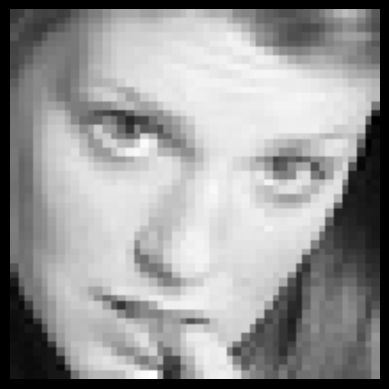

Image: /content/images/images/validation/fear/11687.jpg
Predicted class: fear
Probability: 99.3%
1/1 [==============================] - 0s 35ms/step


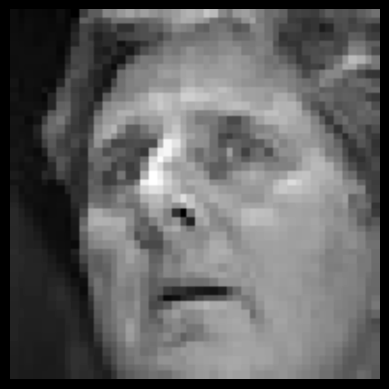

Image: /content/images/images/validation/fear/18104.jpg
Predicted class: fear
Probability: 95.3%
1/1 [==============================] - 0s 31ms/step


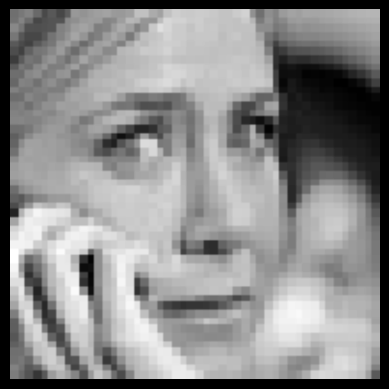

Image: /content/images/images/validation/fear/18317.jpg
Predicted class: fear
Probability: 80.5%
1/1 [==============================] - 0s 43ms/step


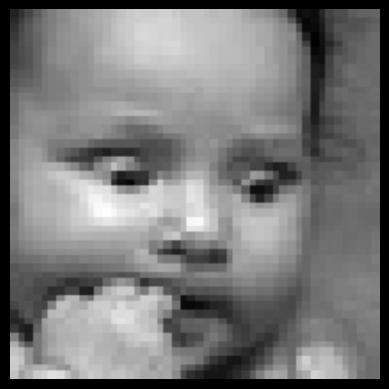

Image: /content/images/images/validation/fear/17934.jpg
Predicted class: neutral
Probability: 61.2%
1/1 [==============================] - 0s 52ms/step


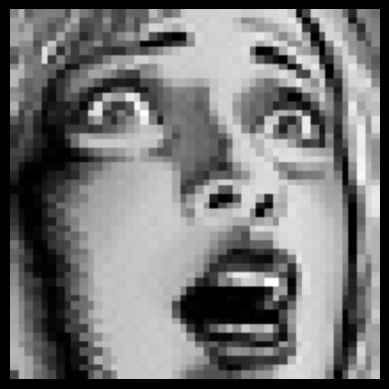

Image: /content/images/images/validation/fear/26250.jpg
Predicted class: fear
Probability: 99.9%
1/1 [==============================] - 0s 51ms/step


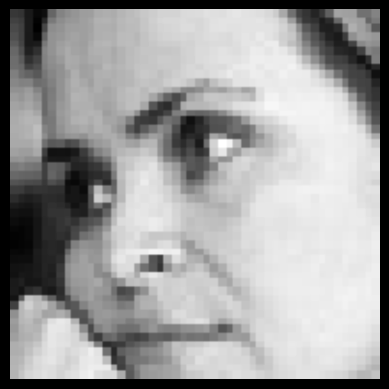

Image: /content/images/images/validation/fear/6608.jpg
Predicted class: fear
Probability: 63.4%
1/1 [==============================] - 0s 41ms/step


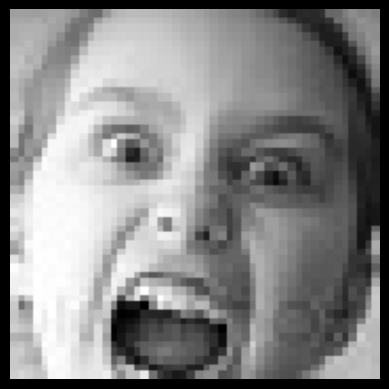

Image: /content/images/images/validation/fear/14891.jpg
Predicted class: fear
Probability: 89.1%
1/1 [==============================] - 0s 34ms/step


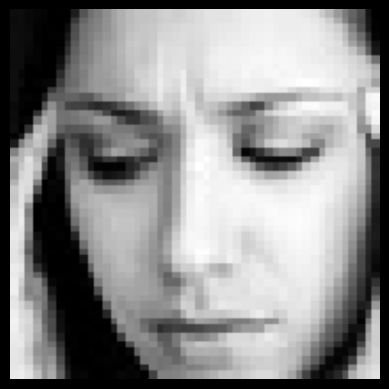

Image: /content/images/images/validation/fear/33051.jpg
Predicted class: fear
Probability: 99.2%
1/1 [==============================] - 0s 27ms/step


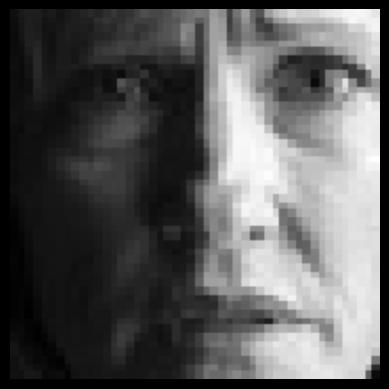

Image: /content/images/images/validation/fear/2416.jpg
Predicted class: fear
Probability: 97.7%
1/1 [==============================] - 0s 35ms/step


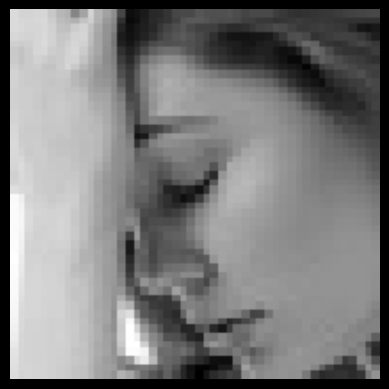

Image: /content/images/images/validation/fear/11999.jpg
Predicted class: fear
Probability: 80.3%
1/1 [==============================] - 0s 31ms/step


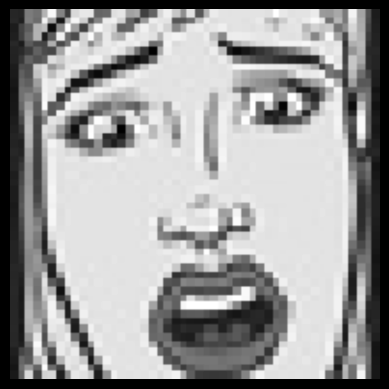

Image: /content/images/images/validation/fear/35697.jpg
Predicted class: fear
Probability: 57.9%
1/1 [==============================] - 0s 43ms/step


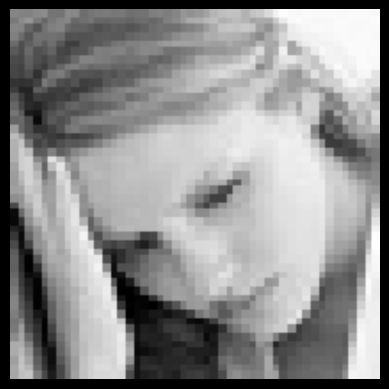

Image: /content/images/images/validation/fear/13593.jpg
Predicted class: fear
Probability: 85.6%
1/1 [==============================] - 0s 40ms/step


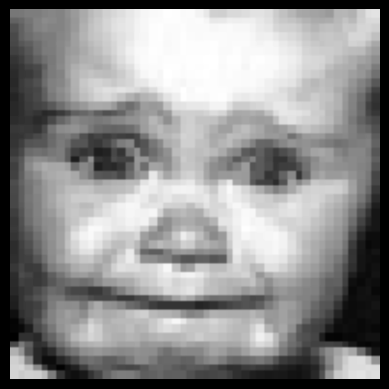

Image: /content/images/images/validation/fear/22349.jpg
Predicted class: fear
Probability: 96.6%
1/1 [==============================] - 0s 27ms/step


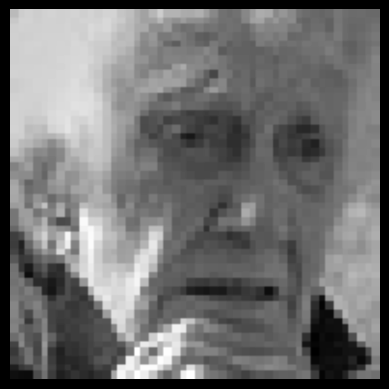

Image: /content/images/images/validation/fear/23778.jpg
Predicted class: fear
Probability: 43.0%
1/1 [==============================] - 0s 26ms/step


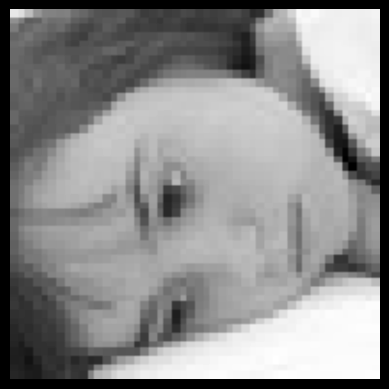

Image: /content/images/images/validation/fear/9474.jpg
Predicted class: fear
Probability: 77.2%
1/1 [==============================] - 0s 27ms/step


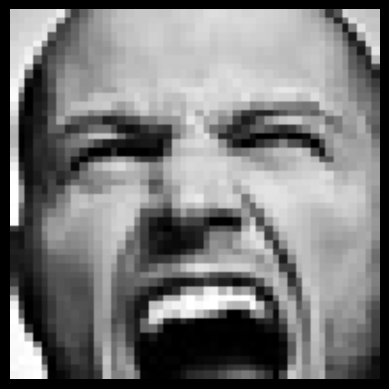

Image: /content/images/images/validation/fear/19559.jpg
Predicted class: fear
Probability: 96.1%
1/1 [==============================] - 0s 27ms/step


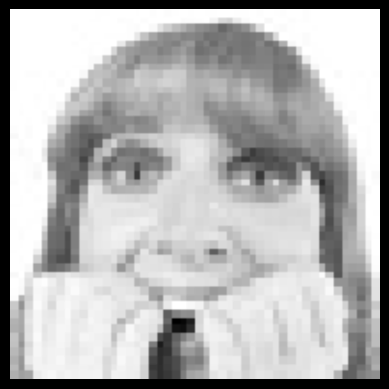

Image: /content/images/images/validation/fear/31116.jpg
Predicted class: fear
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


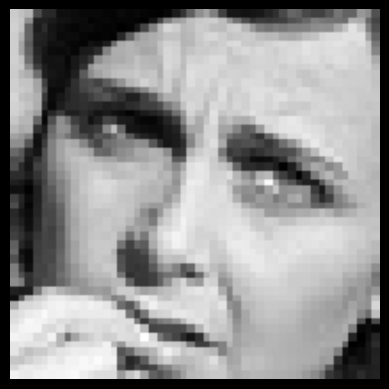

Image: /content/images/images/validation/fear/25621.jpg
Predicted class: fear
Probability: 99.1%
1/1 [==============================] - 0s 31ms/step


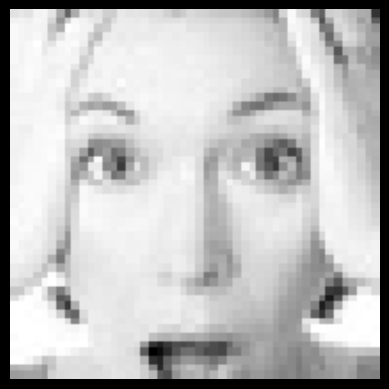

Image: /content/images/images/validation/fear/1193.jpg
Predicted class: surprise
Probability: 94.8%
1/1 [==============================] - 0s 25ms/step


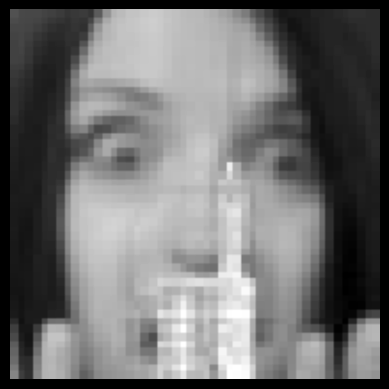

Image: /content/images/images/validation/fear/23566.jpg
Predicted class: fear
Probability: 61.1%
1/1 [==============================] - 0s 26ms/step


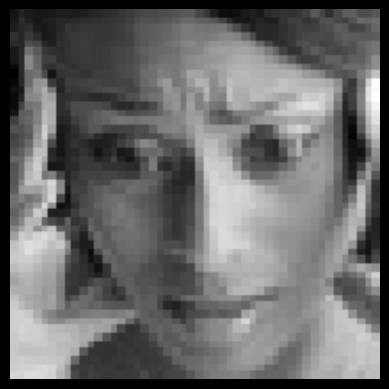

Image: /content/images/images/validation/fear/1756.jpg
Predicted class: fear
Probability: 98.2%
1/1 [==============================] - 0s 25ms/step


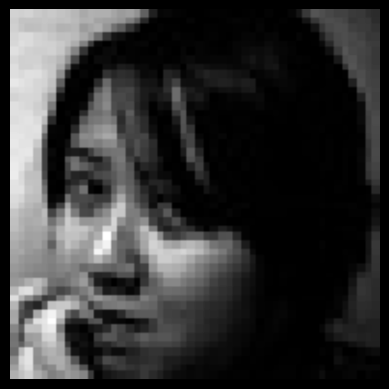

Image: /content/images/images/validation/fear/32692.jpg
Predicted class: sad
Probability: 52.5%
1/1 [==============================] - 0s 38ms/step


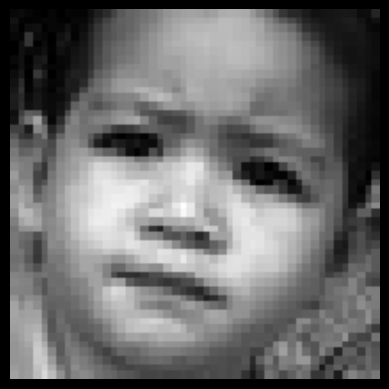

Image: /content/images/images/validation/fear/10832.jpg
Predicted class: angry
Probability: 55.3%
1/1 [==============================] - 0s 27ms/step


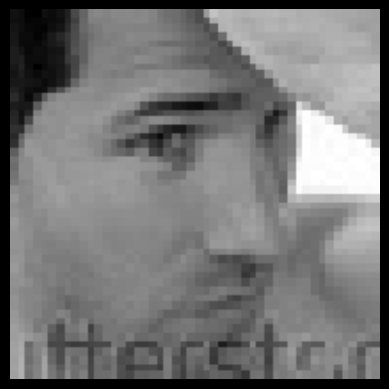

Image: /content/images/images/validation/fear/33701.jpg
Predicted class: fear
Probability: 51.9%
1/1 [==============================] - 0s 29ms/step


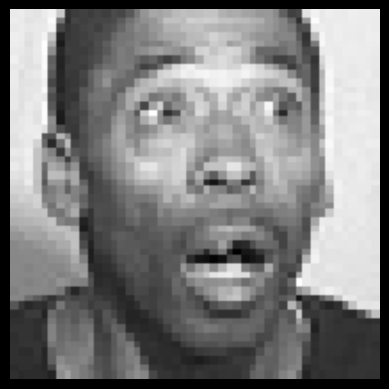

Image: /content/images/images/validation/fear/15040.jpg
Predicted class: fear
Probability: 99.9%
1/1 [==============================] - 0s 32ms/step


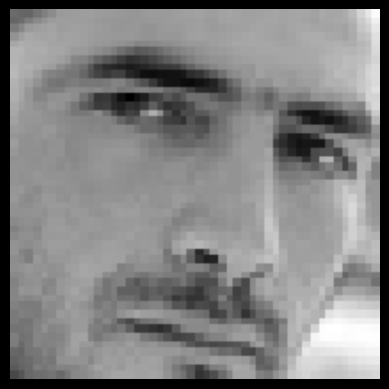

Image: /content/images/images/validation/fear/31421.jpg
Predicted class: fear
Probability: 51.8%
1/1 [==============================] - 0s 27ms/step


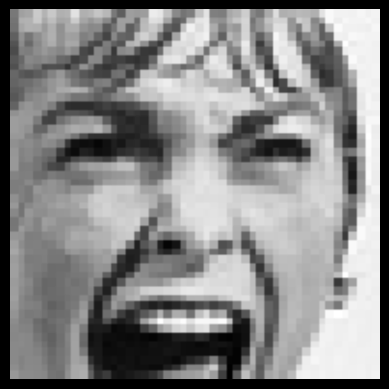

Image: /content/images/images/validation/fear/31855.jpg
Predicted class: fear
Probability: 99.6%
1/1 [==============================] - 0s 26ms/step


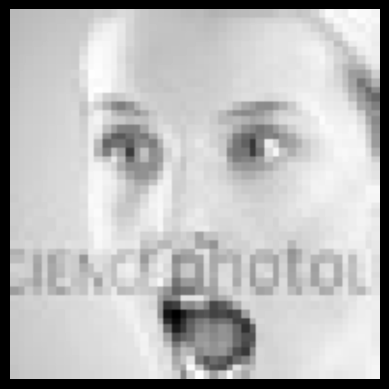

Image: /content/images/images/validation/fear/29349.jpg
Predicted class: fear
Probability: 99.4%
1/1 [==============================] - 0s 26ms/step


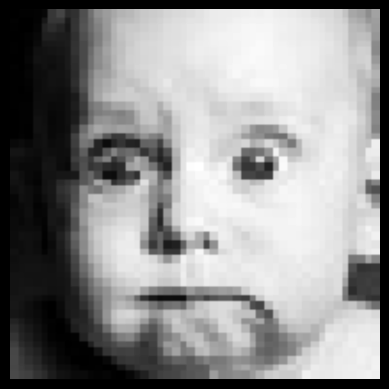

Image: /content/images/images/validation/fear/7038.jpg
Predicted class: fear
Probability: 59.2%
1/1 [==============================] - 0s 30ms/step


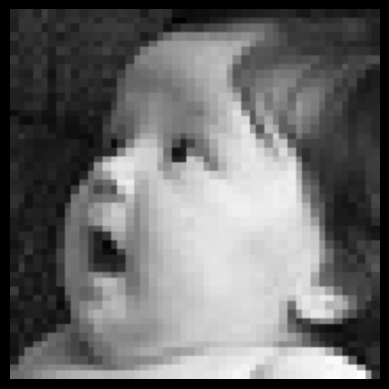

Image: /content/images/images/validation/fear/28701.jpg
Predicted class: fear
Probability: 99.2%
1/1 [==============================] - 0s 26ms/step


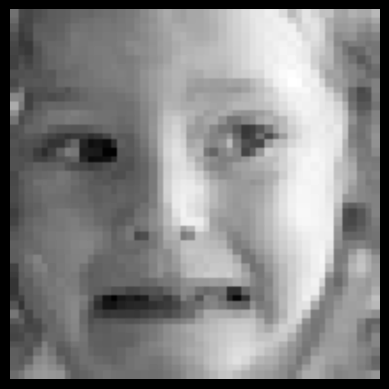

Image: /content/images/images/validation/fear/35363.jpg
Predicted class: fear
Probability: 99.8%
1/1 [==============================] - 0s 28ms/step


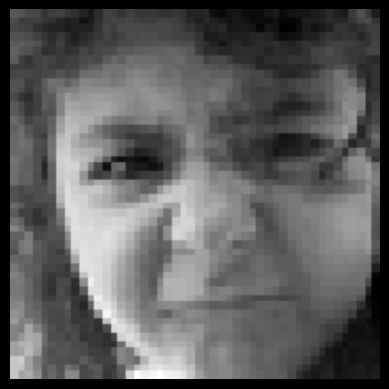

Image: /content/images/images/validation/fear/15999.jpg
Predicted class: angry
Probability: 81.9%
1/1 [==============================] - 0s 26ms/step


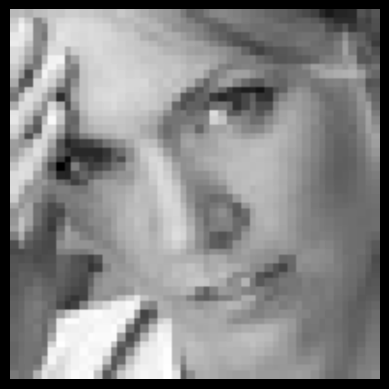

Image: /content/images/images/validation/fear/17191.jpg
Predicted class: sad
Probability: 98.9%
1/1 [==============================] - 0s 33ms/step


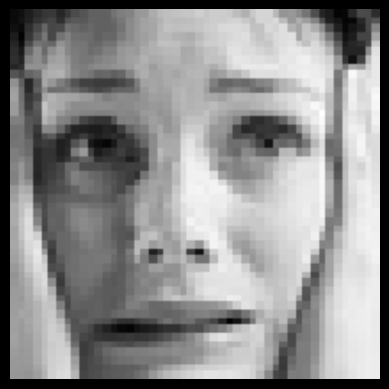

Image: /content/images/images/validation/fear/16788.jpg
Predicted class: fear
Probability: 99.8%
1/1 [==============================] - 0s 26ms/step


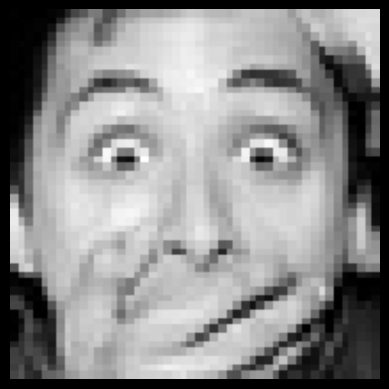

Image: /content/images/images/validation/fear/35238.jpg
Predicted class: surprise
Probability: 58.9%
1/1 [==============================] - 0s 31ms/step


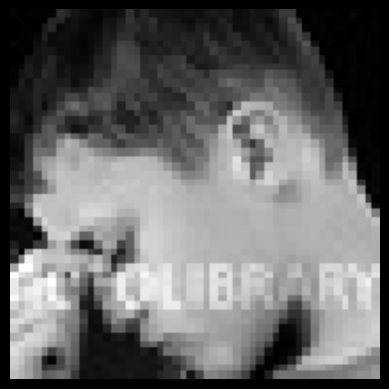

Image: /content/images/images/validation/fear/31954.jpg
Predicted class: angry
Probability: 54.7%
1/1 [==============================] - 0s 32ms/step


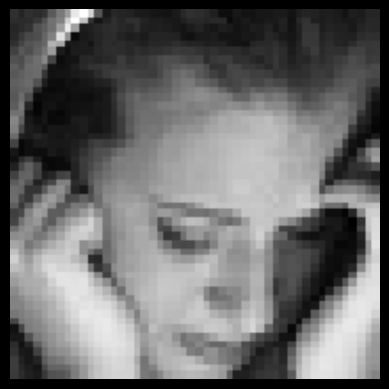

Image: /content/images/images/validation/fear/14044.jpg
Predicted class: fear
Probability: 64.3%
1/1 [==============================] - 0s 32ms/step


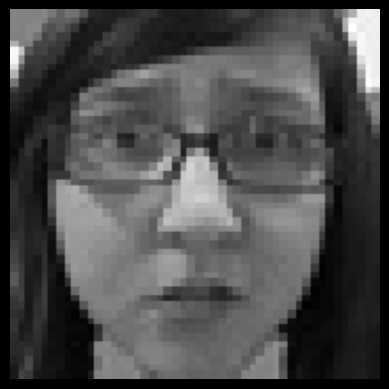

Image: /content/images/images/validation/fear/3584.jpg
Predicted class: fear
Probability: 94.3%
1/1 [==============================] - 0s 30ms/step


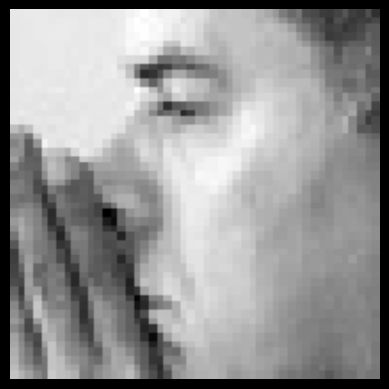

Image: /content/images/images/validation/fear/6814.jpg
Predicted class: fear
Probability: 99.7%
1/1 [==============================] - 0s 37ms/step


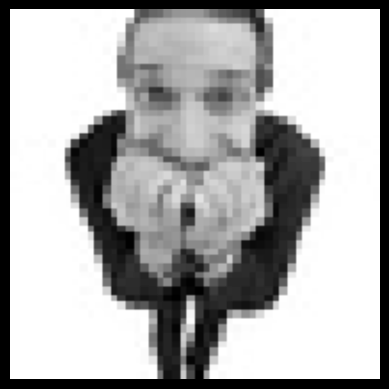

Image: /content/images/images/validation/fear/23561.jpg
Predicted class: fear
Probability: 99.8%
1/1 [==============================] - 0s 26ms/step


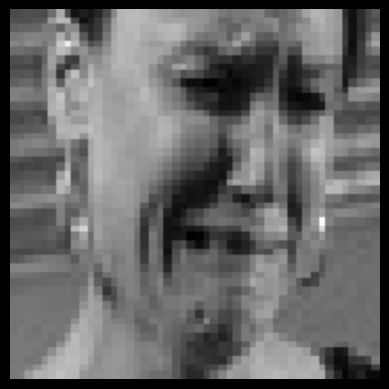

Image: /content/images/images/validation/fear/15012.jpg
Predicted class: sad
Probability: 40.7%
1/1 [==============================] - 0s 26ms/step


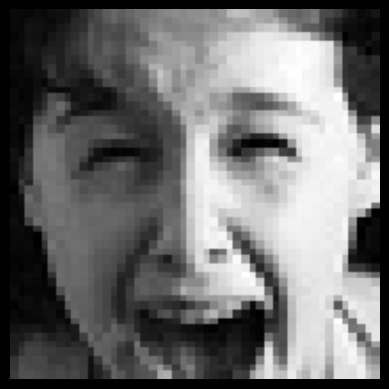

Image: /content/images/images/validation/fear/33587.jpg
Predicted class: fear
Probability: 52.0%
1/1 [==============================] - 0s 28ms/step


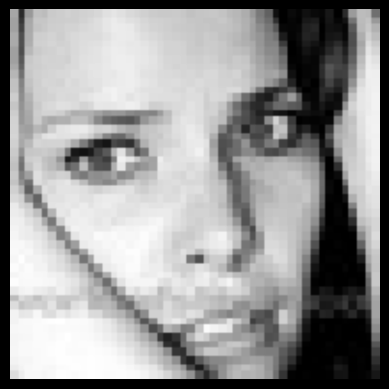

Image: /content/images/images/validation/fear/13482.jpg
Predicted class: fear
Probability: 99.7%
1/1 [==============================] - 0s 26ms/step


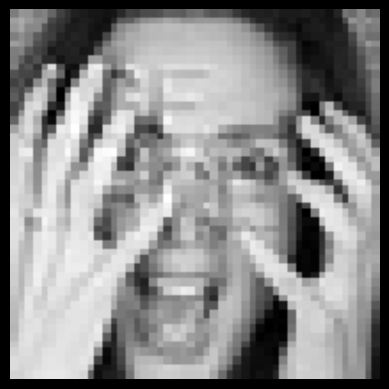

Image: /content/images/images/validation/fear/15198.jpg
Predicted class: fear
Probability: 99.5%
1/1 [==============================] - 0s 31ms/step


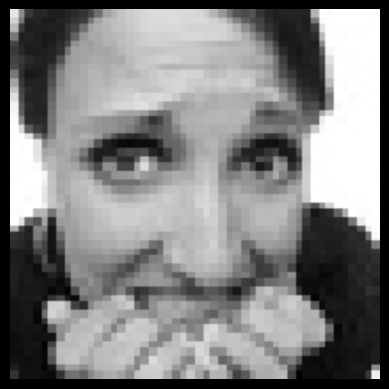

Image: /content/images/images/validation/fear/4523.jpg
Predicted class: fear
Probability: 99.9%
1/1 [==============================] - 0s 29ms/step


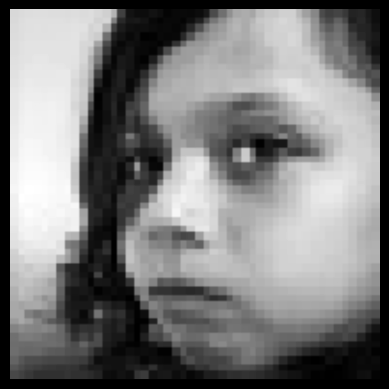

Image: /content/images/images/validation/fear/35410.jpg
Predicted class: sad
Probability: 54.7%
1/1 [==============================] - 0s 30ms/step


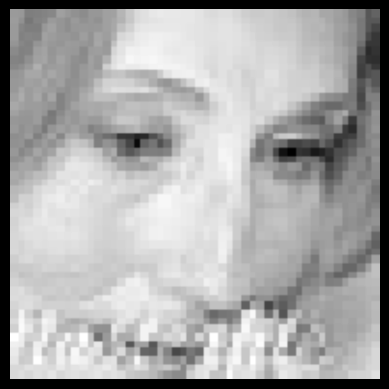

Image: /content/images/images/validation/fear/13971.jpg
Predicted class: fear
Probability: 91.8%
1/1 [==============================] - 0s 32ms/step


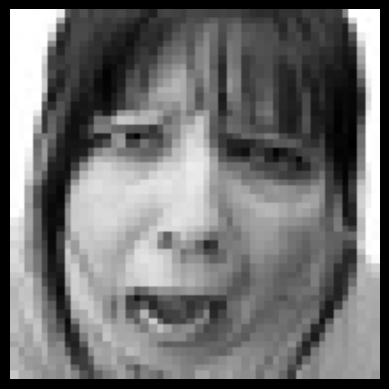

Image: /content/images/images/validation/fear/29315.jpg
Predicted class: angry
Probability: 99.9%
1/1 [==============================] - 0s 31ms/step


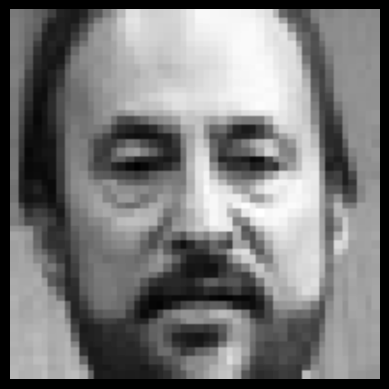

Image: /content/images/images/validation/fear/29924.jpg
Predicted class: sad
Probability: 46.8%
1/1 [==============================] - 0s 30ms/step


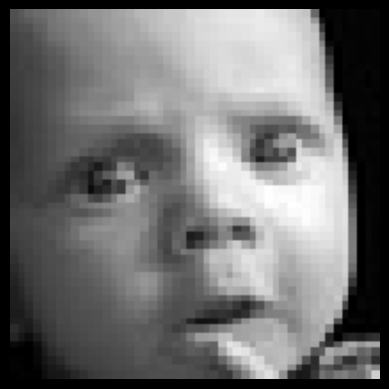

Image: /content/images/images/validation/fear/32323.jpg
Predicted class: surprise
Probability: 74.8%
1/1 [==============================] - 0s 43ms/step


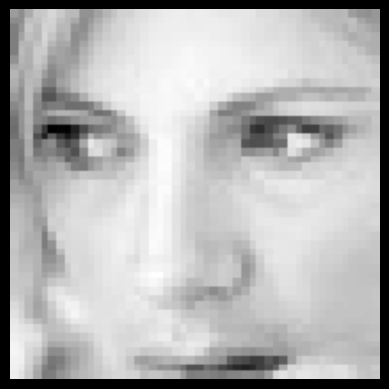

Image: /content/images/images/validation/fear/9261.jpg
Predicted class: fear
Probability: 88.6%
1/1 [==============================] - 0s 47ms/step


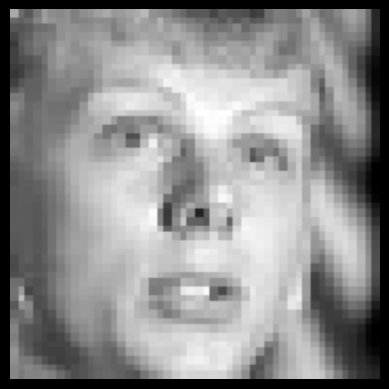

Image: /content/images/images/validation/fear/22840.jpg
Predicted class: surprise
Probability: 54.9%
1/1 [==============================] - 0s 65ms/step


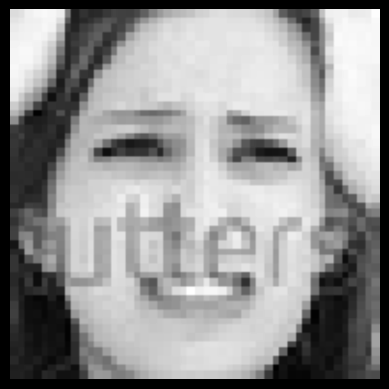

Image: /content/images/images/validation/fear/6469.jpg
Predicted class: fear
Probability: 97.5%
1/1 [==============================] - 0s 43ms/step


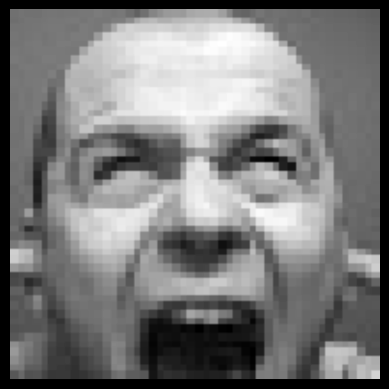

Image: /content/images/images/validation/fear/10278.jpg
Predicted class: fear
Probability: 62.7%
1/1 [==============================] - 0s 68ms/step


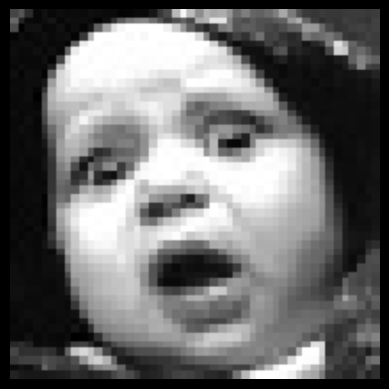

Image: /content/images/images/validation/fear/32103.jpg
Predicted class: fear
Probability: 83.8%
1/1 [==============================] - 0s 52ms/step


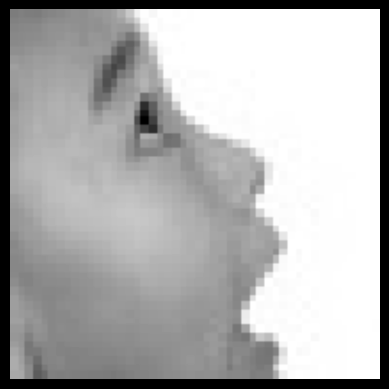

Image: /content/images/images/validation/fear/32461.jpg
Predicted class: surprise
Probability: 48.7%
1/1 [==============================] - 0s 49ms/step


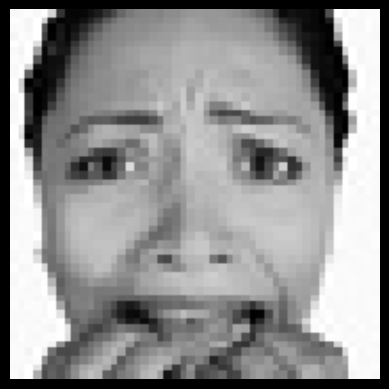

Image: /content/images/images/validation/fear/34675.jpg
Predicted class: fear
Probability: 99.9%
1/1 [==============================] - 0s 31ms/step


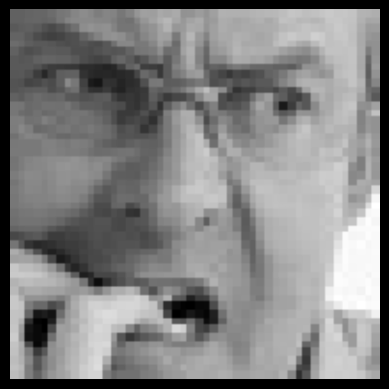

Image: /content/images/images/validation/fear/11471.jpg
Predicted class: fear
Probability: 85.6%
1/1 [==============================] - 0s 42ms/step


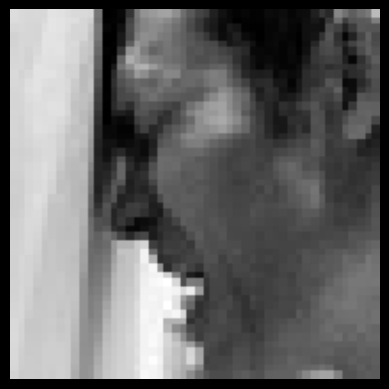

Image: /content/images/images/validation/fear/13913.jpg
Predicted class: fear
Probability: 86.5%
1/1 [==============================] - 0s 27ms/step


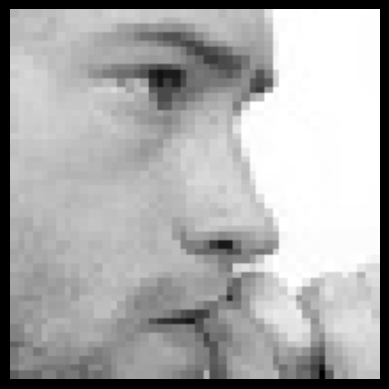

Image: /content/images/images/validation/fear/31330.jpg
Predicted class: angry
Probability: 44.5%
1/1 [==============================] - 0s 29ms/step


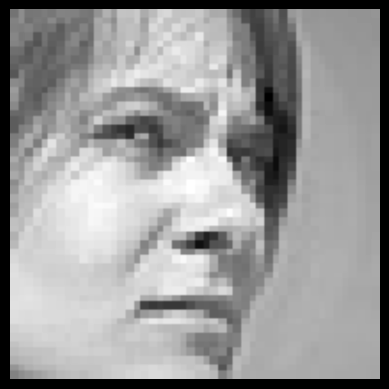

Image: /content/images/images/validation/fear/3036.jpg
Predicted class: fear
Probability: 63.5%
1/1 [==============================] - 0s 32ms/step


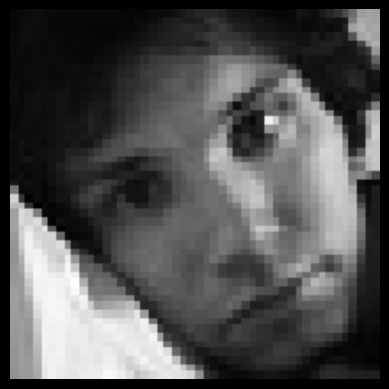

Image: /content/images/images/validation/fear/8454.jpg
Predicted class: fear
Probability: 75.8%
1/1 [==============================] - 0s 37ms/step


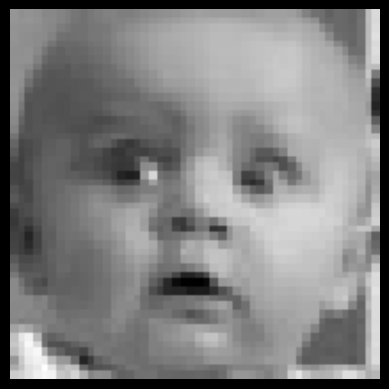

Image: /content/images/images/validation/fear/18911.jpg
Predicted class: surprise
Probability: 61.0%
1/1 [==============================] - 0s 46ms/step


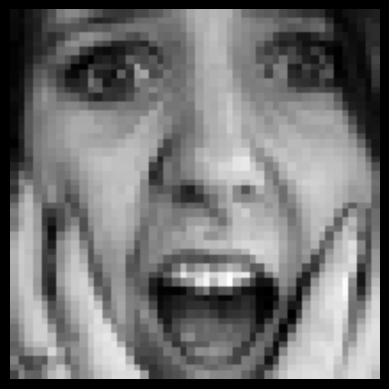

Image: /content/images/images/validation/fear/3722.jpg
Predicted class: surprise
Probability: 55.8%
1/1 [==============================] - 0s 33ms/step


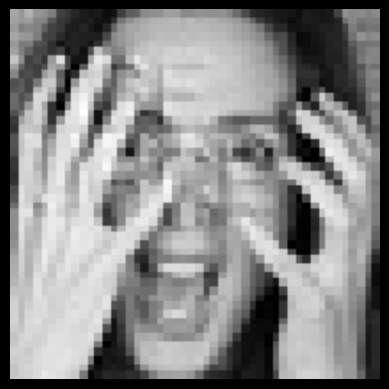

Image: /content/images/images/validation/fear/31821.jpg
Predicted class: fear
Probability: 99.2%
1/1 [==============================] - 0s 41ms/step


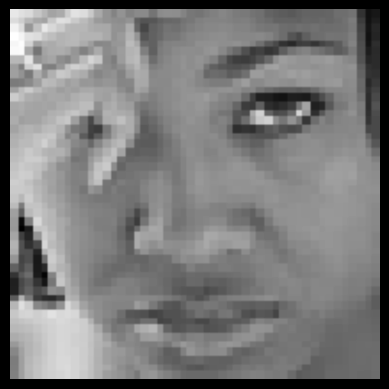

Image: /content/images/images/validation/fear/14452.jpg
Predicted class: neutral
Probability: 61.0%
1/1 [==============================] - 0s 43ms/step


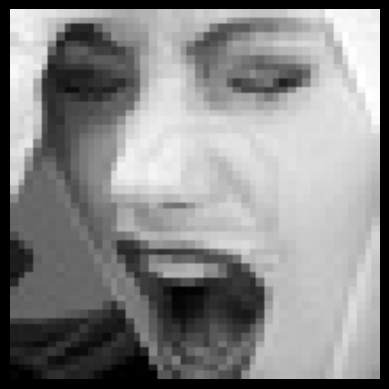

Image: /content/images/images/validation/fear/7517.jpg
Predicted class: fear
Probability: 95.1%
1/1 [==============================] - 0s 47ms/step


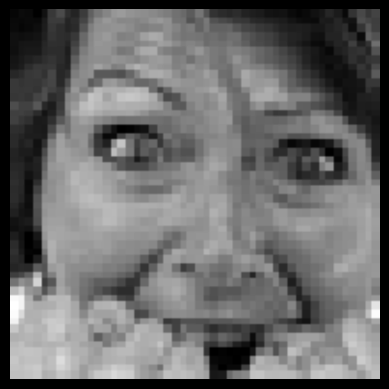

Image: /content/images/images/validation/fear/18404.jpg
Predicted class: fear
Probability: 97.6%
1/1 [==============================] - 0s 26ms/step


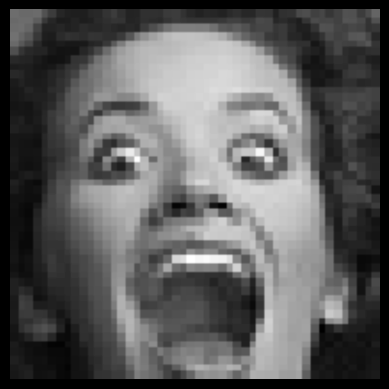

Image: /content/images/images/validation/fear/9251.jpg
Predicted class: fear
Probability: 97.3%
1/1 [==============================] - 0s 26ms/step


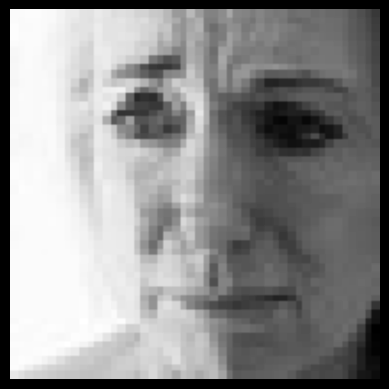

Image: /content/images/images/validation/fear/35257.jpg
Predicted class: sad
Probability: 83.3%
1/1 [==============================] - 0s 25ms/step


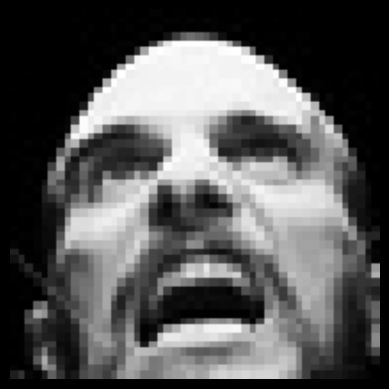

Image: /content/images/images/validation/fear/29389.jpg
Predicted class: angry
Probability: 98.1%
1/1 [==============================] - 0s 26ms/step


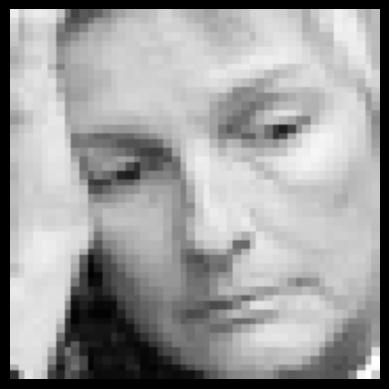

Image: /content/images/images/validation/fear/1796.jpg
Predicted class: neutral
Probability: 79.0%
1/1 [==============================] - 0s 27ms/step


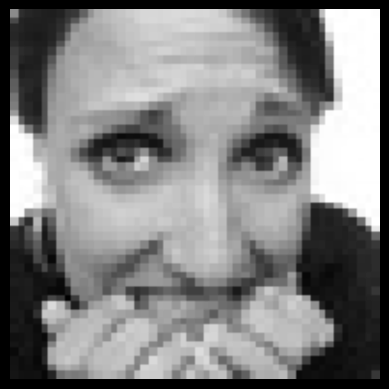

Image: /content/images/images/validation/fear/17180.jpg
Predicted class: fear
Probability: 99.9%
1/1 [==============================] - 0s 29ms/step


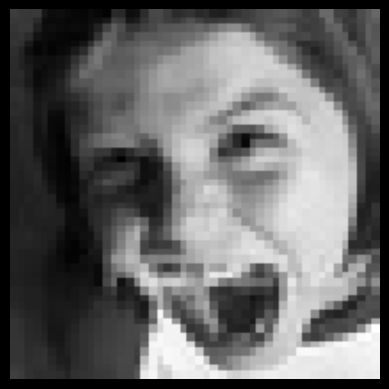

Image: /content/images/images/validation/fear/34730.jpg
Predicted class: fear
Probability: 91.6%
1/1 [==============================] - 0s 27ms/step


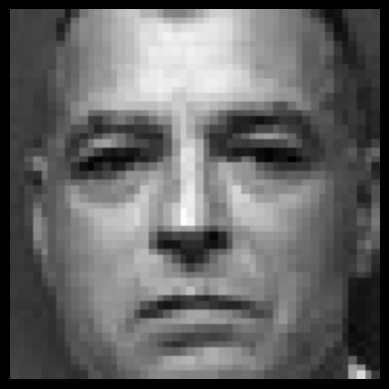

Image: /content/images/images/validation/fear/35279.jpg
Predicted class: neutral
Probability: 48.1%
1/1 [==============================] - 0s 26ms/step


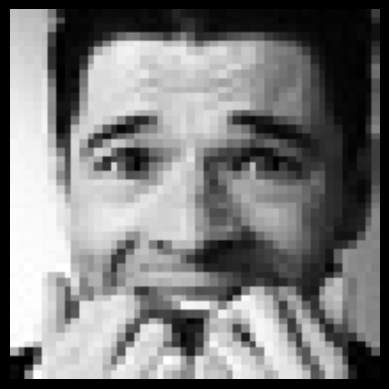

Image: /content/images/images/validation/fear/23260.jpg
Predicted class: fear
Probability: 99.9%
1/1 [==============================] - 0s 51ms/step


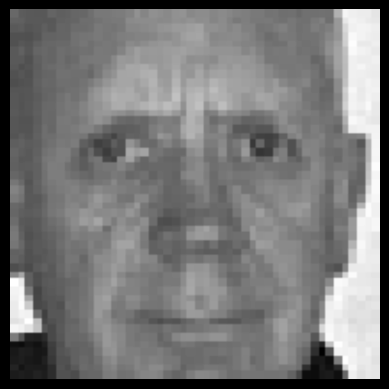

Image: /content/images/images/validation/fear/23447.jpg
Predicted class: fear
Probability: 55.6%
1/1 [==============================] - 0s 26ms/step


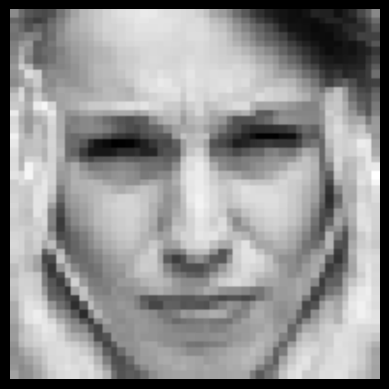

Image: /content/images/images/validation/fear/14786.jpg
Predicted class: fear
Probability: 94.2%
1/1 [==============================] - 0s 25ms/step


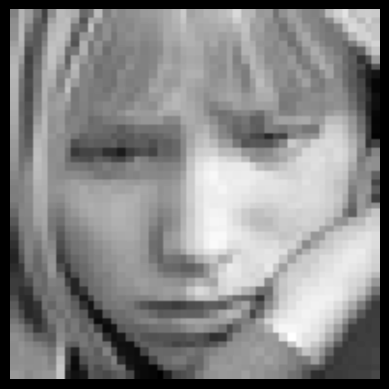

Image: /content/images/images/validation/fear/13179.jpg
Predicted class: sad
Probability: 80.8%
1/1 [==============================] - 0s 42ms/step


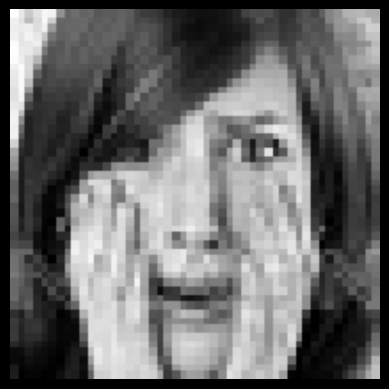

Image: /content/images/images/validation/fear/4986.jpg
Predicted class: fear
Probability: 98.7%
1/1 [==============================] - 0s 34ms/step


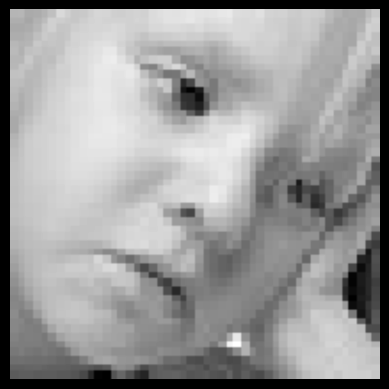

Image: /content/images/images/validation/fear/8797.jpg
Predicted class: fear
Probability: 93.2%
1/1 [==============================] - 0s 27ms/step


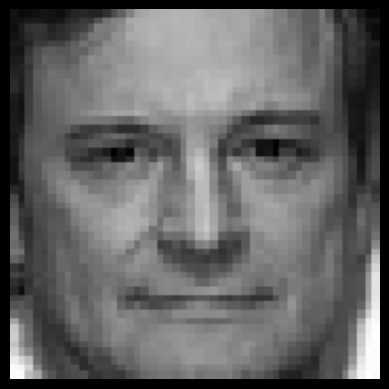

Image: /content/images/images/validation/fear/30062.jpg
Predicted class: neutral
Probability: 59.6%
1/1 [==============================] - 0s 26ms/step


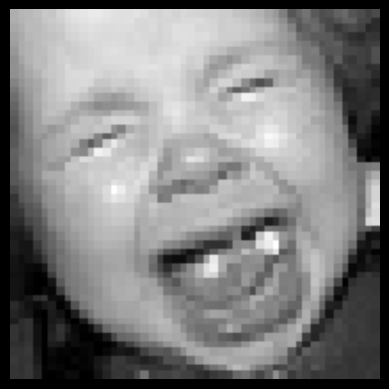

Image: /content/images/images/validation/fear/24778.jpg
Predicted class: fear
Probability: 96.5%
1/1 [==============================] - 0s 26ms/step


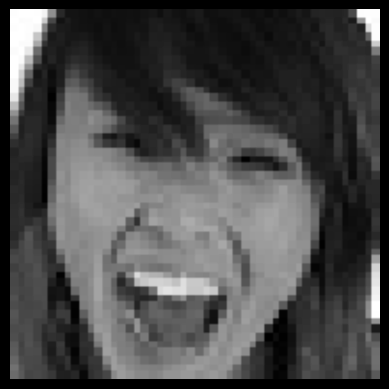

Image: /content/images/images/validation/fear/22944.jpg
Predicted class: fear
Probability: 97.6%
1/1 [==============================] - 0s 26ms/step


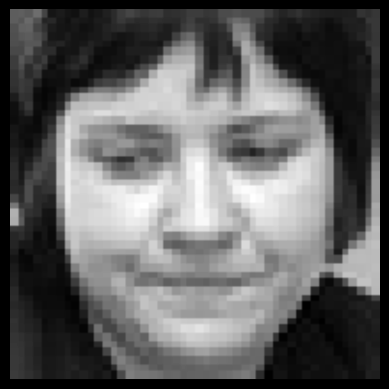

Image: /content/images/images/validation/fear/23142.jpg
Predicted class: sad
Probability: 49.7%
1/1 [==============================] - 0s 30ms/step


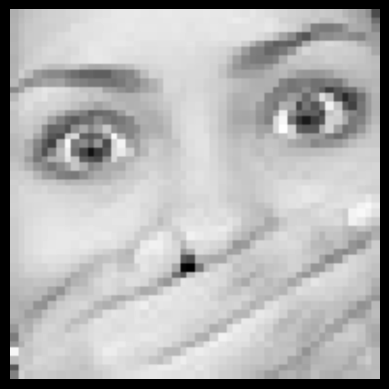

Image: /content/images/images/validation/fear/32940.jpg
Predicted class: fear
Probability: 94.0%
1/1 [==============================] - 0s 29ms/step


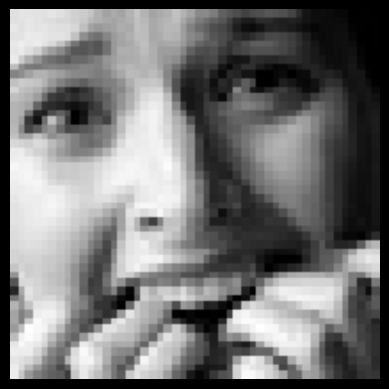

Image: /content/images/images/validation/fear/8040.jpg
Predicted class: fear
Probability: 97.9%
1/1 [==============================] - 0s 26ms/step


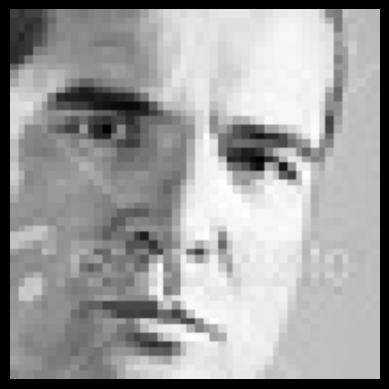

Image: /content/images/images/validation/fear/22662.jpg
Predicted class: fear
Probability: 82.6%
1/1 [==============================] - 0s 26ms/step


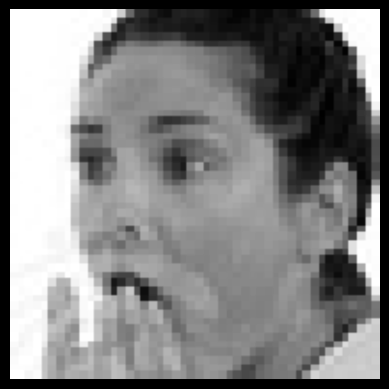

Image: /content/images/images/validation/fear/16440.jpg
Predicted class: fear
Probability: 87.1%
1/1 [==============================] - 0s 27ms/step


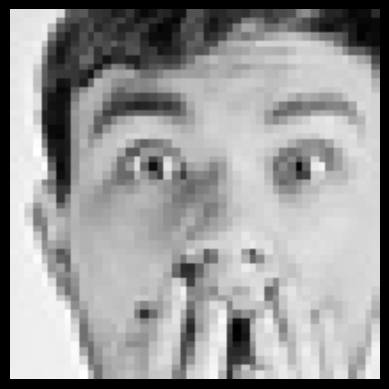

Image: /content/images/images/validation/fear/22839.jpg
Predicted class: fear
Probability: 98.8%
1/1 [==============================] - 0s 43ms/step


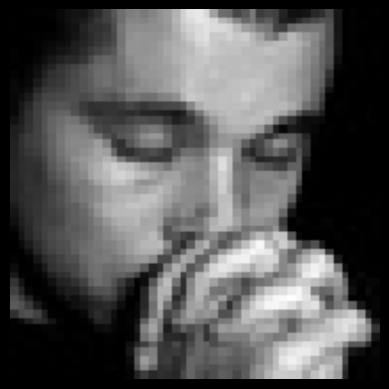

Image: /content/images/images/validation/sad/13483.jpg
Predicted class: sad
Probability: 99.6%
1/1 [==============================] - 0s 25ms/step


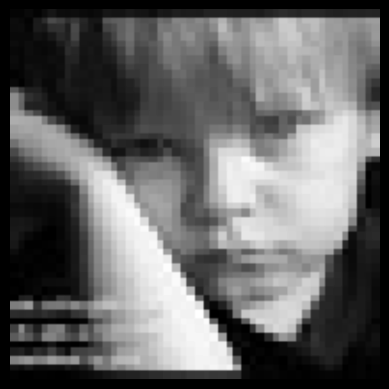

Image: /content/images/images/validation/sad/19486.jpg
Predicted class: sad
Probability: 99.8%
1/1 [==============================] - 0s 27ms/step


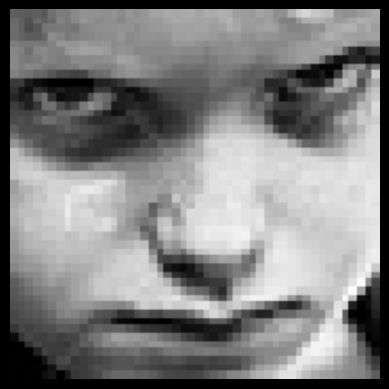

Image: /content/images/images/validation/sad/35386.jpg
Predicted class: sad
Probability: 73.8%
1/1 [==============================] - 0s 46ms/step


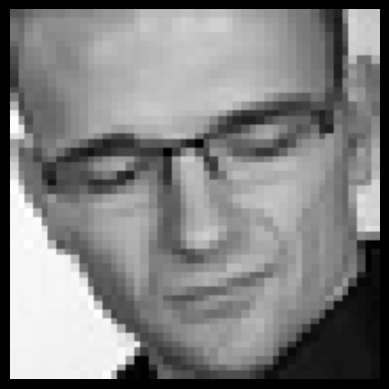

Image: /content/images/images/validation/sad/4412.jpg
Predicted class: sad
Probability: 94.6%
1/1 [==============================] - 0s 27ms/step


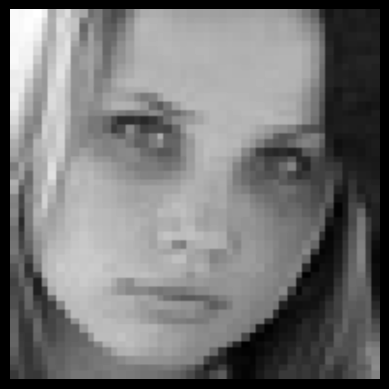

Image: /content/images/images/validation/sad/29121.jpg
Predicted class: angry
Probability: 48.0%
1/1 [==============================] - 0s 36ms/step


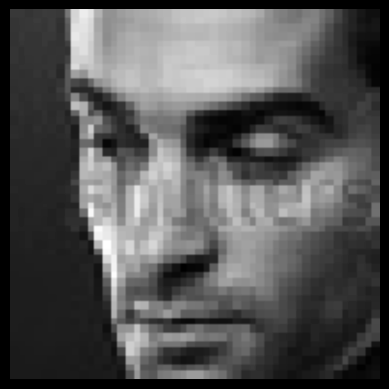

Image: /content/images/images/validation/sad/33628.jpg
Predicted class: angry
Probability: 85.7%
1/1 [==============================] - 0s 27ms/step


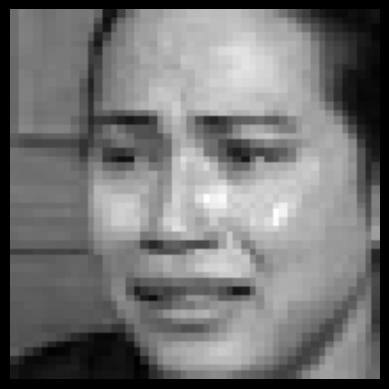

Image: /content/images/images/validation/sad/30439.jpg
Predicted class: sad
Probability: 94.5%
1/1 [==============================] - 0s 25ms/step


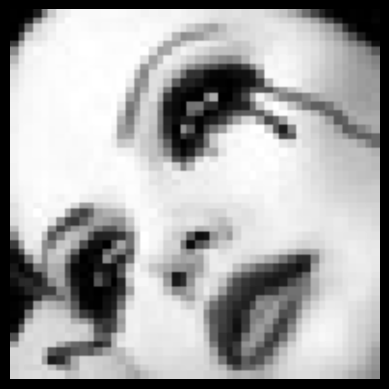

Image: /content/images/images/validation/sad/4811.jpg
Predicted class: sad
Probability: 99.2%
1/1 [==============================] - 0s 51ms/step


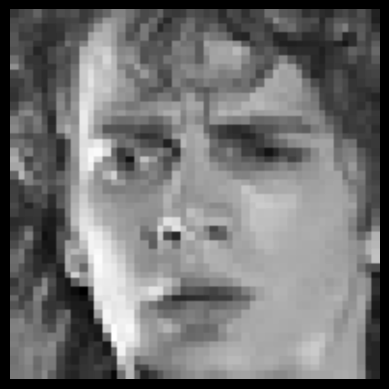

Image: /content/images/images/validation/sad/20964.jpg
Predicted class: fear
Probability: 32.2%
1/1 [==============================] - 0s 33ms/step


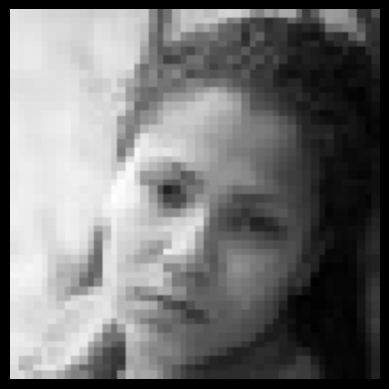

Image: /content/images/images/validation/sad/3378.jpg
Predicted class: sad
Probability: 95.7%
1/1 [==============================] - 0s 27ms/step


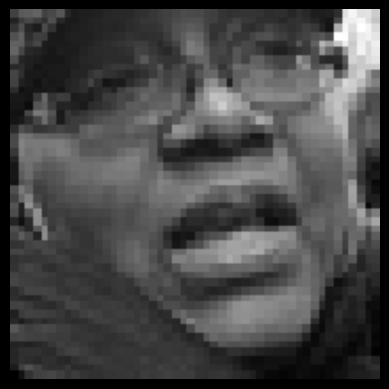

Image: /content/images/images/validation/sad/32711.jpg
Predicted class: happy
Probability: 42.9%
1/1 [==============================] - 0s 35ms/step


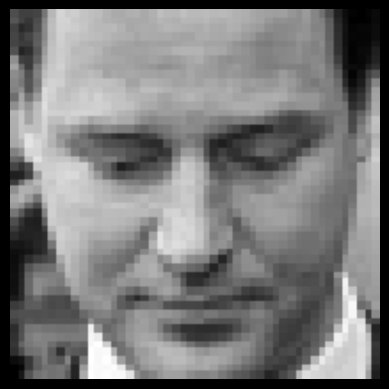

Image: /content/images/images/validation/sad/30104.jpg
Predicted class: sad
Probability: 92.1%
1/1 [==============================] - 0s 25ms/step


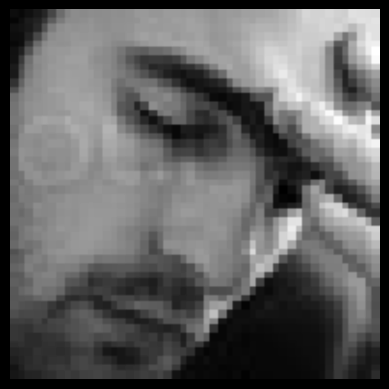

Image: /content/images/images/validation/sad/29617.jpg
Predicted class: sad
Probability: 93.1%
1/1 [==============================] - 0s 30ms/step


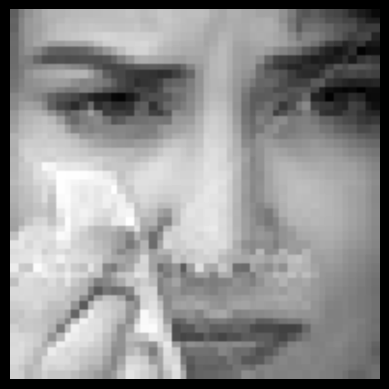

Image: /content/images/images/validation/sad/1973.jpg
Predicted class: sad
Probability: 95.4%
1/1 [==============================] - 0s 30ms/step


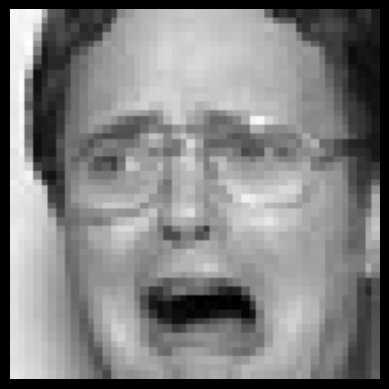

Image: /content/images/images/validation/sad/2091.jpg
Predicted class: surprise
Probability: 50.1%
1/1 [==============================] - 0s 25ms/step


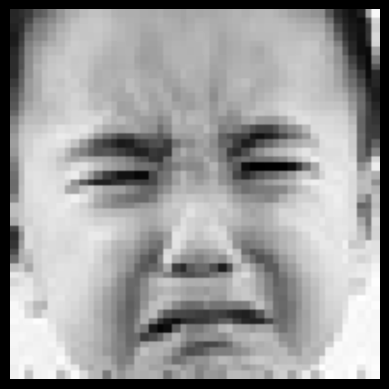

Image: /content/images/images/validation/sad/15294.jpg
Predicted class: sad
Probability: 99.9%
1/1 [==============================] - 0s 27ms/step


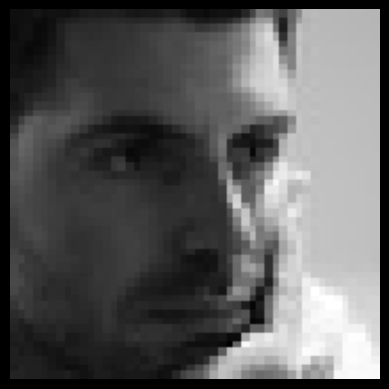

Image: /content/images/images/validation/sad/7962.jpg
Predicted class: sad
Probability: 75.6%
1/1 [==============================] - 0s 29ms/step


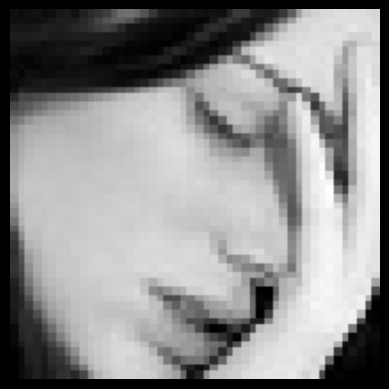

Image: /content/images/images/validation/sad/23060.jpg
Predicted class: sad
Probability: 99.4%
1/1 [==============================] - 0s 29ms/step


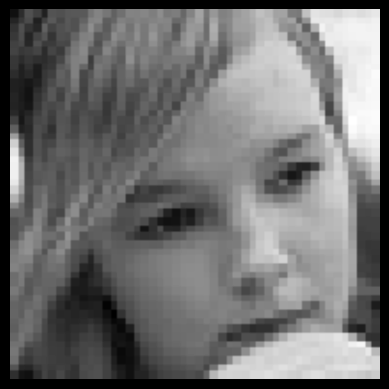

Image: /content/images/images/validation/sad/11794.jpg
Predicted class: sad
Probability: 82.0%
1/1 [==============================] - 0s 25ms/step


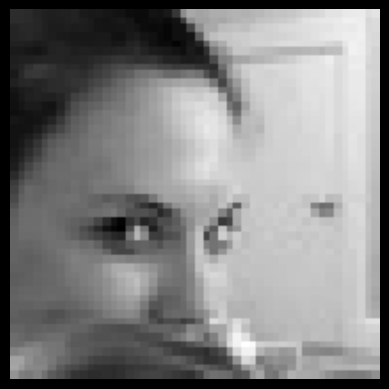

Image: /content/images/images/validation/sad/10713.jpg
Predicted class: sad
Probability: 90.1%
1/1 [==============================] - 0s 26ms/step


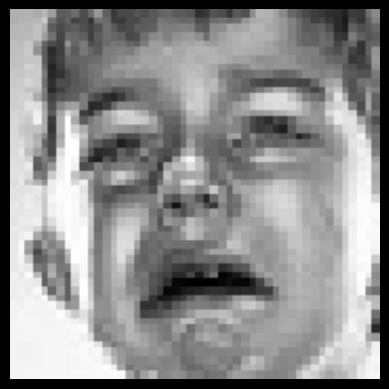

Image: /content/images/images/validation/sad/35318.jpg
Predicted class: sad
Probability: 48.8%
1/1 [==============================] - 0s 31ms/step


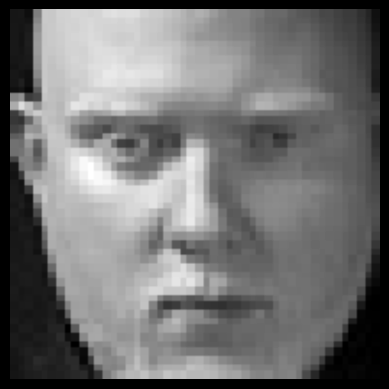

Image: /content/images/images/validation/sad/21249.jpg
Predicted class: sad
Probability: 46.9%
1/1 [==============================] - 0s 30ms/step


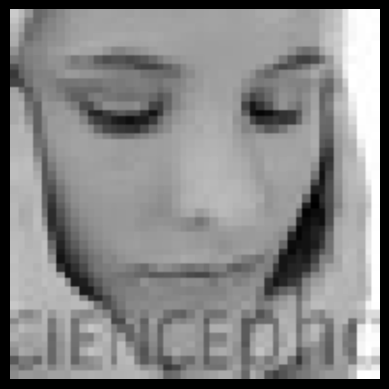

Image: /content/images/images/validation/sad/10383.jpg
Predicted class: sad
Probability: 84.1%
1/1 [==============================] - 0s 34ms/step


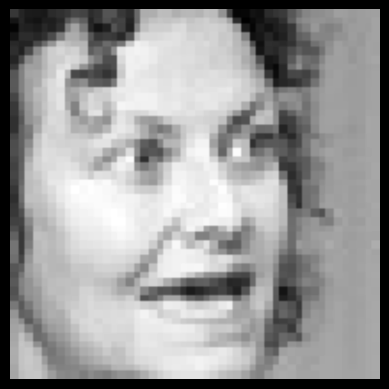

Image: /content/images/images/validation/sad/3206.jpg
Predicted class: surprise
Probability: 76.7%
1/1 [==============================] - 0s 33ms/step


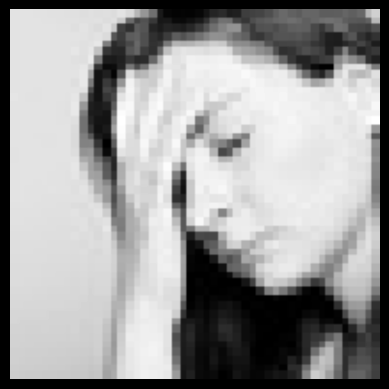

Image: /content/images/images/validation/sad/35567.jpg
Predicted class: neutral
Probability: 90.3%
1/1 [==============================] - 0s 33ms/step


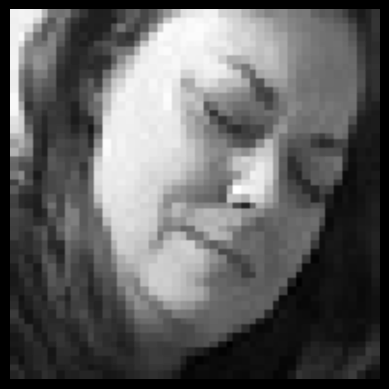

Image: /content/images/images/validation/sad/31113.jpg
Predicted class: sad
Probability: 30.9%
1/1 [==============================] - 0s 36ms/step


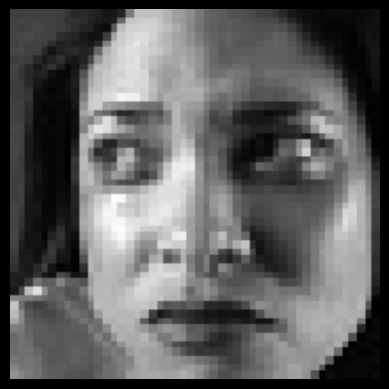

Image: /content/images/images/validation/sad/2546.jpg
Predicted class: sad
Probability: 74.5%
1/1 [==============================] - 0s 69ms/step


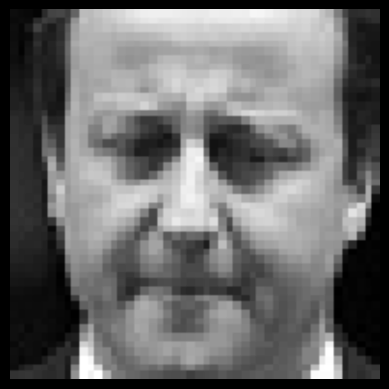

Image: /content/images/images/validation/sad/9923.jpg
Predicted class: sad
Probability: 99.4%
1/1 [==============================] - 0s 65ms/step


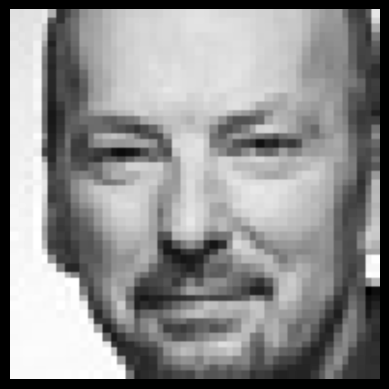

Image: /content/images/images/validation/sad/16387.jpg
Predicted class: neutral
Probability: 61.2%
1/1 [==============================] - 0s 60ms/step


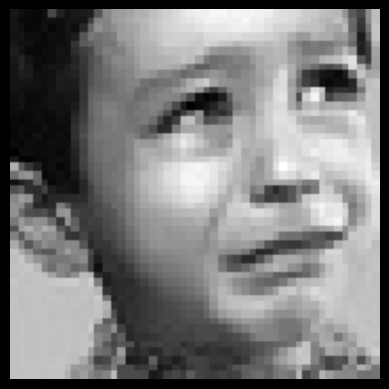

Image: /content/images/images/validation/sad/9548.jpg
Predicted class: neutral
Probability: 84.3%
1/1 [==============================] - 0s 48ms/step


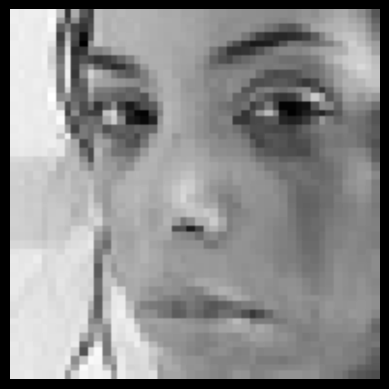

Image: /content/images/images/validation/sad/6930.jpg
Predicted class: sad
Probability: 49.8%
1/1 [==============================] - 0s 52ms/step


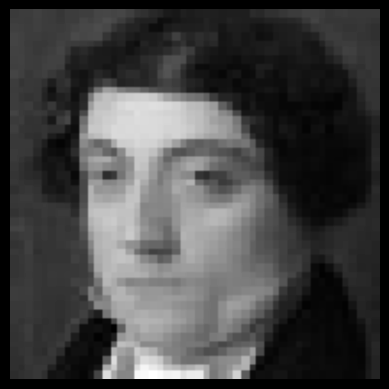

Image: /content/images/images/validation/sad/27759.jpg
Predicted class: sad
Probability: 71.2%
1/1 [==============================] - 0s 69ms/step


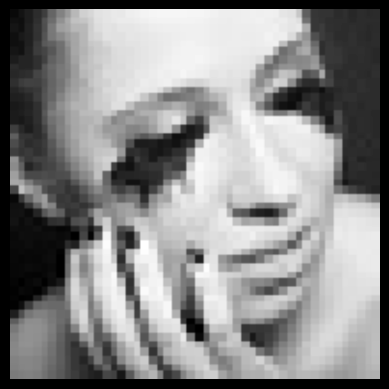

Image: /content/images/images/validation/sad/29322.jpg
Predicted class: happy
Probability: 99.7%
1/1 [==============================] - 0s 66ms/step


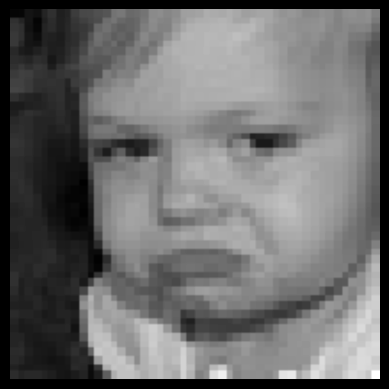

Image: /content/images/images/validation/sad/31099.jpg
Predicted class: sad
Probability: 52.6%
1/1 [==============================] - 0s 62ms/step


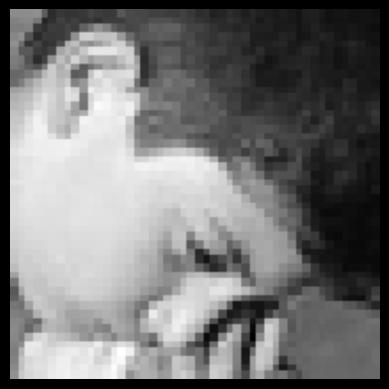

Image: /content/images/images/validation/sad/35615.jpg
Predicted class: sad
Probability: 69.3%
1/1 [==============================] - 0s 61ms/step


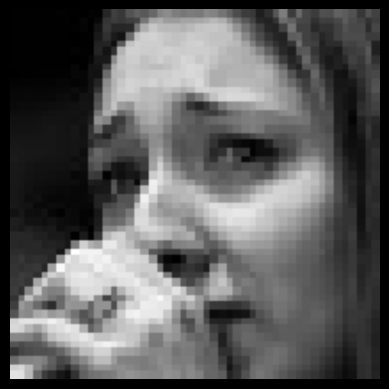

Image: /content/images/images/validation/sad/32005.jpg
Predicted class: sad
Probability: 62.4%
1/1 [==============================] - 0s 48ms/step


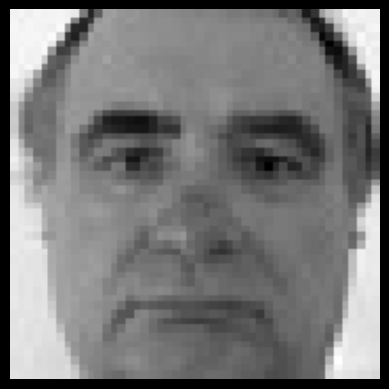

Image: /content/images/images/validation/sad/9713.jpg
Predicted class: sad
Probability: 50.8%
1/1 [==============================] - 0s 28ms/step


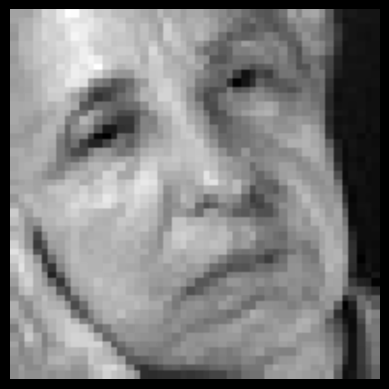

Image: /content/images/images/validation/sad/12040.jpg
Predicted class: angry
Probability: 70.5%
1/1 [==============================] - 0s 31ms/step


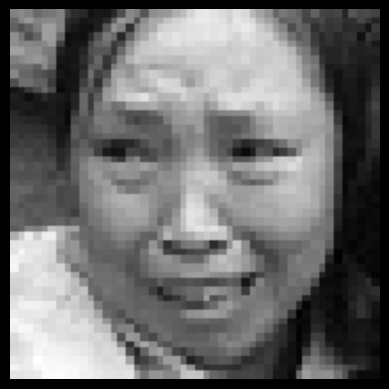

Image: /content/images/images/validation/sad/9498.jpg
Predicted class: sad
Probability: 94.8%
1/1 [==============================] - 0s 30ms/step


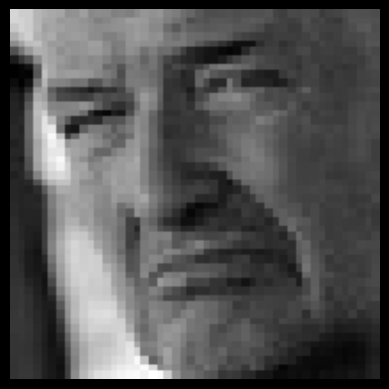

Image: /content/images/images/validation/sad/5224.jpg
Predicted class: sad
Probability: 73.5%
1/1 [==============================] - 0s 31ms/step


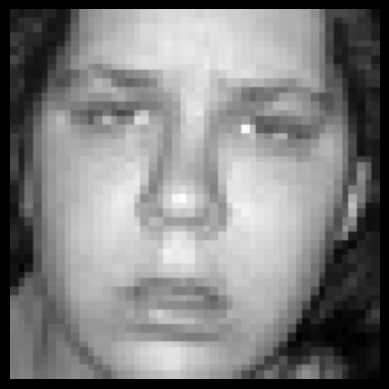

Image: /content/images/images/validation/sad/9066.jpg
Predicted class: sad
Probability: 94.9%
1/1 [==============================] - 0s 30ms/step


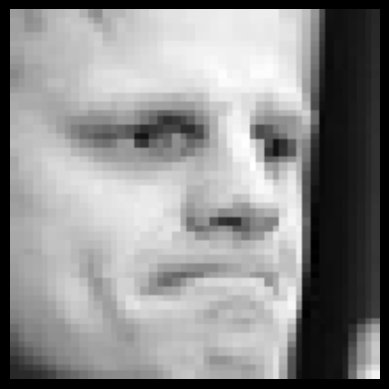

Image: /content/images/images/validation/sad/14836.jpg
Predicted class: sad
Probability: 64.7%
1/1 [==============================] - 0s 33ms/step


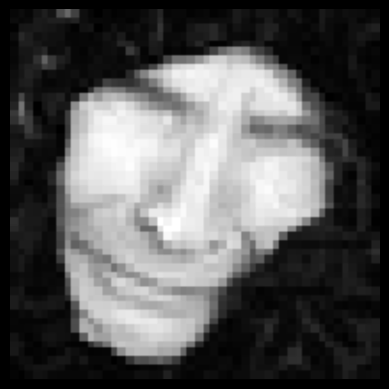

Image: /content/images/images/validation/sad/8851.jpg
Predicted class: sad
Probability: 92.9%
1/1 [==============================] - 0s 28ms/step


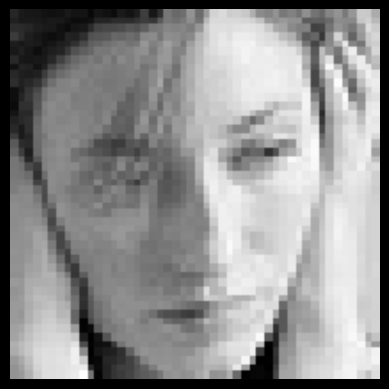

Image: /content/images/images/validation/sad/688.jpg
Predicted class: sad
Probability: 97.1%
1/1 [==============================] - 0s 28ms/step


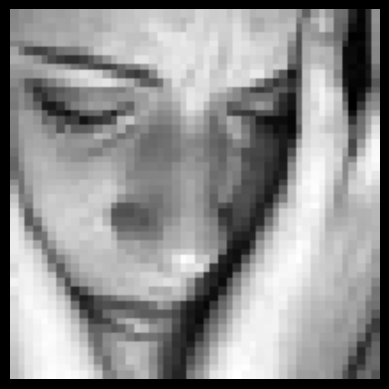

Image: /content/images/images/validation/sad/23760.jpg
Predicted class: sad
Probability: 94.2%
1/1 [==============================] - 0s 43ms/step


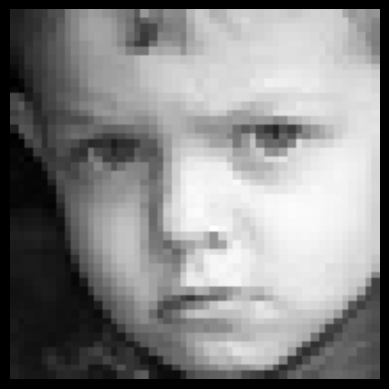

Image: /content/images/images/validation/sad/3972.jpg
Predicted class: sad
Probability: 86.5%
1/1 [==============================] - 0s 27ms/step


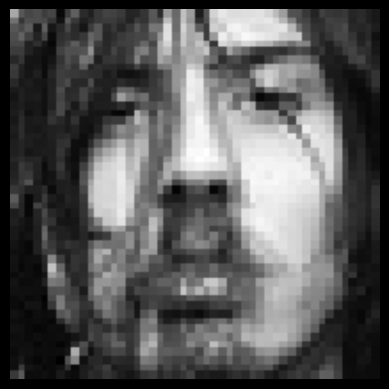

Image: /content/images/images/validation/sad/16003.jpg
Predicted class: sad
Probability: 91.8%
1/1 [==============================] - 0s 26ms/step


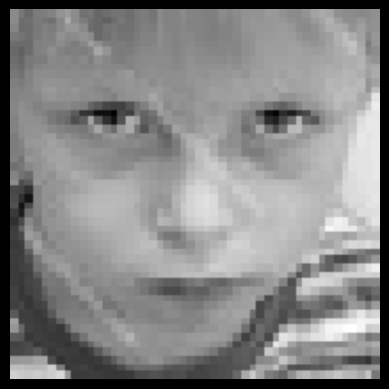

Image: /content/images/images/validation/sad/9119.jpg
Predicted class: sad
Probability: 71.7%
1/1 [==============================] - 0s 31ms/step


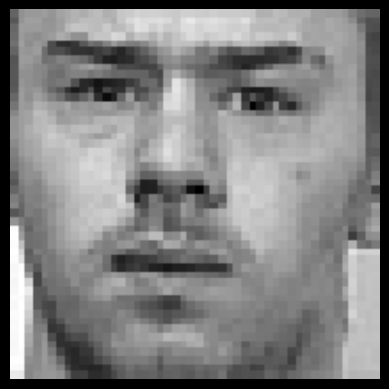

Image: /content/images/images/validation/sad/2615.jpg
Predicted class: sad
Probability: 99.1%
1/1 [==============================] - 0s 31ms/step


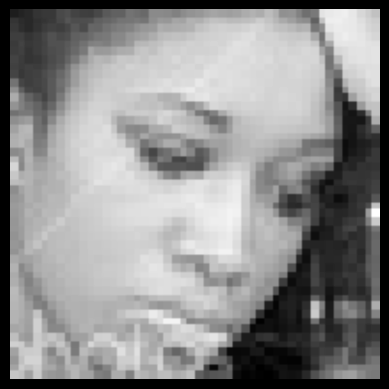

Image: /content/images/images/validation/sad/9219.jpg
Predicted class: sad
Probability: 96.3%
1/1 [==============================] - 0s 46ms/step


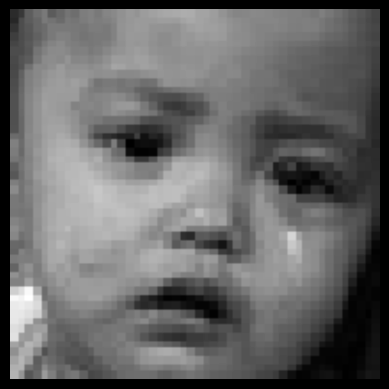

Image: /content/images/images/validation/sad/34195.jpg
Predicted class: fear
Probability: 48.0%
1/1 [==============================] - 0s 34ms/step


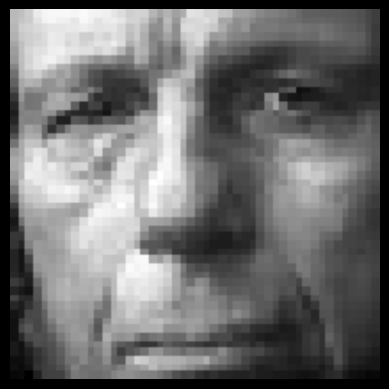

Image: /content/images/images/validation/sad/28794.jpg
Predicted class: sad
Probability: 76.8%
1/1 [==============================] - 0s 28ms/step


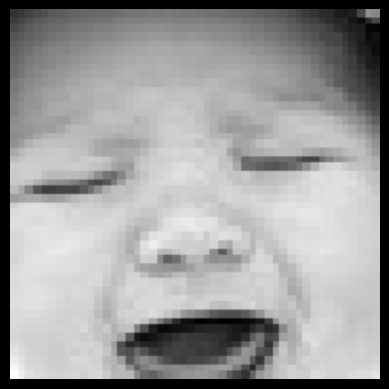

Image: /content/images/images/validation/sad/28294.jpg
Predicted class: sad
Probability: 84.1%
1/1 [==============================] - 0s 43ms/step


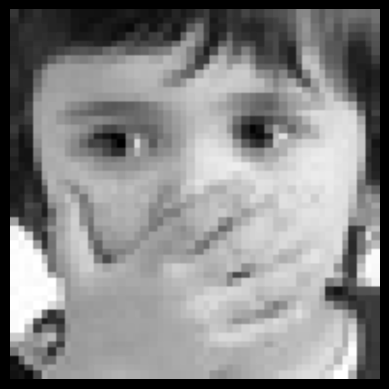

Image: /content/images/images/validation/sad/30170.jpg
Predicted class: neutral
Probability: 99.3%
1/1 [==============================] - 0s 26ms/step


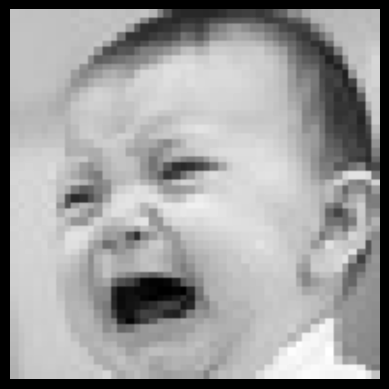

Image: /content/images/images/validation/sad/29792.jpg
Predicted class: sad
Probability: 59.7%
1/1 [==============================] - 0s 39ms/step


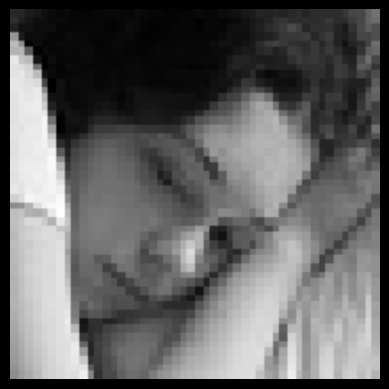

Image: /content/images/images/validation/sad/25832.jpg
Predicted class: sad
Probability: 98.4%
1/1 [==============================] - 0s 26ms/step


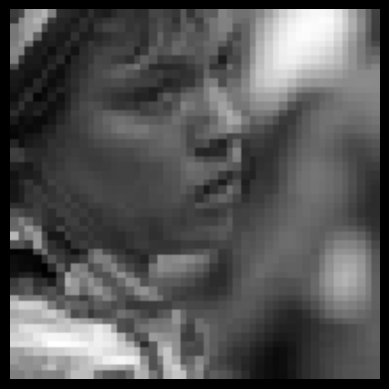

Image: /content/images/images/validation/sad/26566.jpg
Predicted class: sad
Probability: 84.0%
1/1 [==============================] - 0s 26ms/step


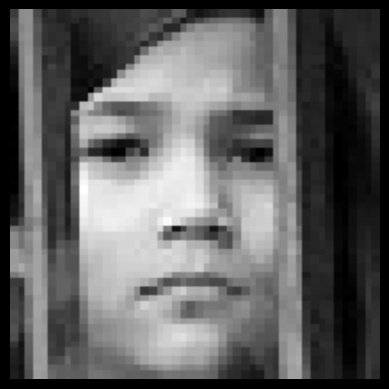

Image: /content/images/images/validation/sad/30144.jpg
Predicted class: neutral
Probability: 95.9%
1/1 [==============================] - 0s 26ms/step


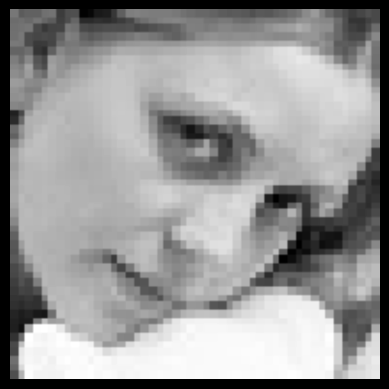

Image: /content/images/images/validation/sad/23304.jpg
Predicted class: sad
Probability: 83.5%
1/1 [==============================] - 0s 31ms/step


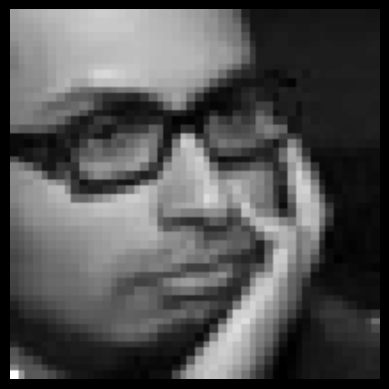

Image: /content/images/images/validation/sad/4207.jpg
Predicted class: sad
Probability: 85.6%
1/1 [==============================] - 0s 36ms/step


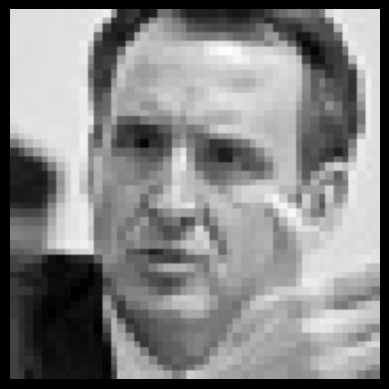

Image: /content/images/images/validation/sad/16776.jpg
Predicted class: sad
Probability: 54.4%
1/1 [==============================] - 0s 26ms/step


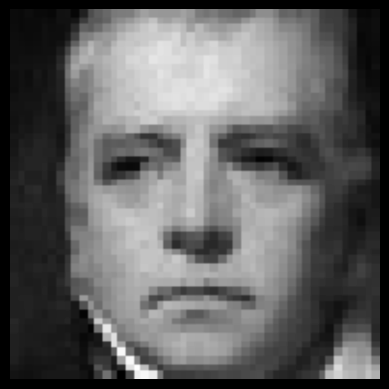

Image: /content/images/images/validation/sad/23658.jpg
Predicted class: sad
Probability: 45.0%
1/1 [==============================] - 0s 25ms/step


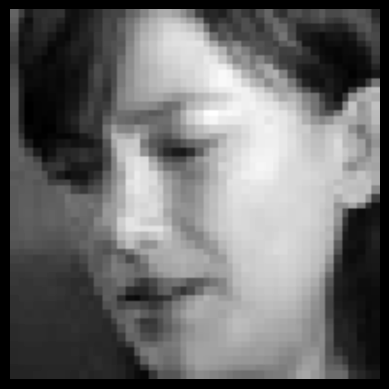

Image: /content/images/images/validation/sad/17128.jpg
Predicted class: sad
Probability: 98.7%
1/1 [==============================] - 0s 29ms/step


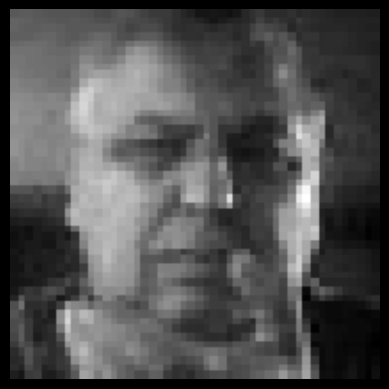

Image: /content/images/images/validation/sad/1198.jpg
Predicted class: sad
Probability: 41.9%
1/1 [==============================] - 0s 26ms/step


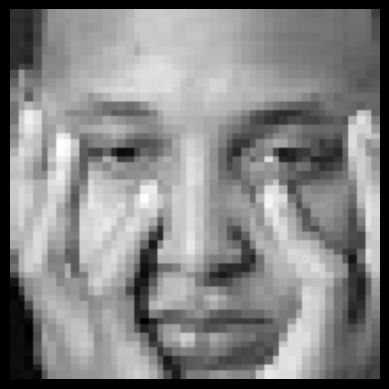

Image: /content/images/images/validation/sad/18345.jpg
Predicted class: sad
Probability: 97.9%
1/1 [==============================] - 0s 32ms/step


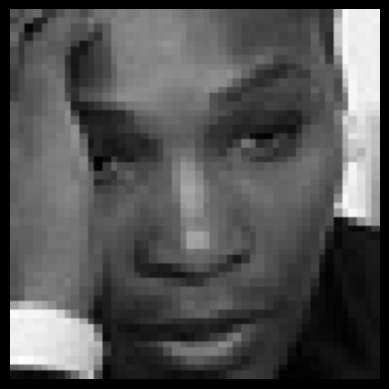

Image: /content/images/images/validation/sad/19274.jpg
Predicted class: sad
Probability: 65.6%
1/1 [==============================] - 0s 25ms/step


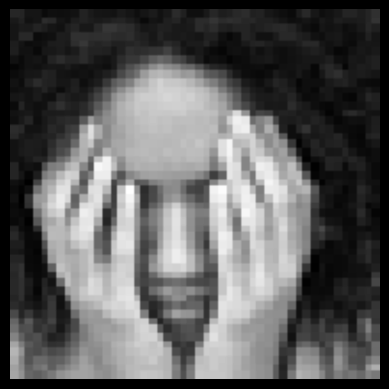

Image: /content/images/images/validation/sad/30094.jpg
Predicted class: fear
Probability: 99.3%
1/1 [==============================] - 0s 45ms/step


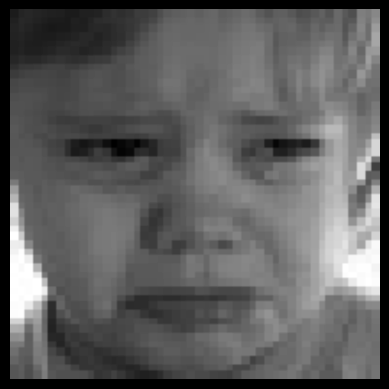

Image: /content/images/images/validation/sad/29703.jpg
Predicted class: sad
Probability: 90.1%
1/1 [==============================] - 0s 41ms/step


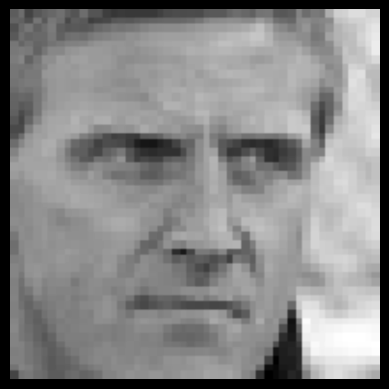

Image: /content/images/images/validation/sad/1778.jpg
Predicted class: sad
Probability: 71.0%
1/1 [==============================] - 0s 27ms/step


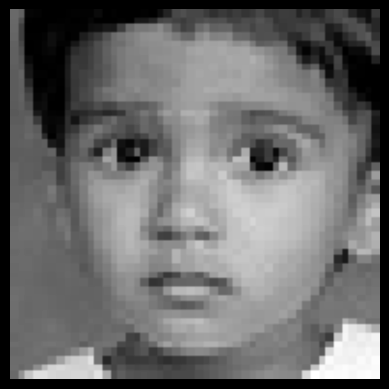

Image: /content/images/images/validation/sad/27471.jpg
Predicted class: neutral
Probability: 74.6%
1/1 [==============================] - 0s 30ms/step


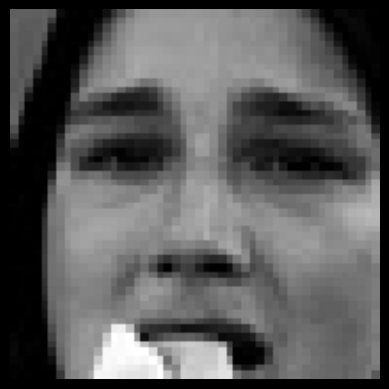

Image: /content/images/images/validation/sad/16475.jpg
Predicted class: sad
Probability: 92.5%
1/1 [==============================] - 0s 37ms/step


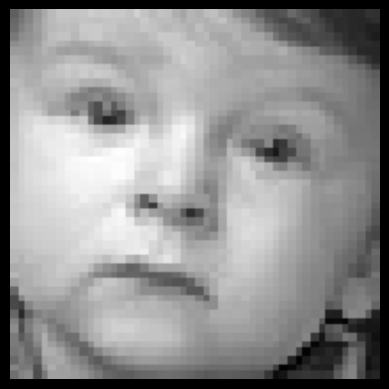

Image: /content/images/images/validation/sad/26249.jpg
Predicted class: sad
Probability: 87.9%
1/1 [==============================] - 0s 36ms/step


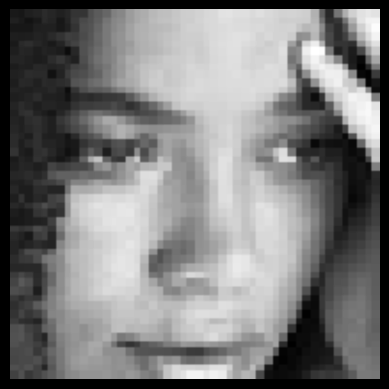

Image: /content/images/images/validation/sad/21312.jpg
Predicted class: sad
Probability: 91.2%
1/1 [==============================] - 0s 42ms/step


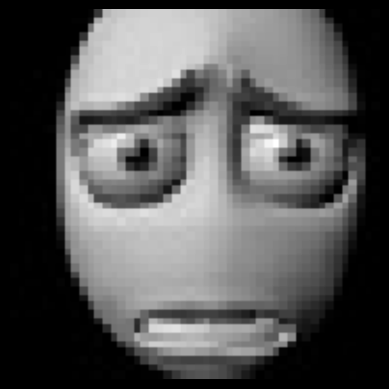

Image: /content/images/images/validation/sad/17625.jpg
Predicted class: sad
Probability: 82.6%
1/1 [==============================] - 0s 30ms/step


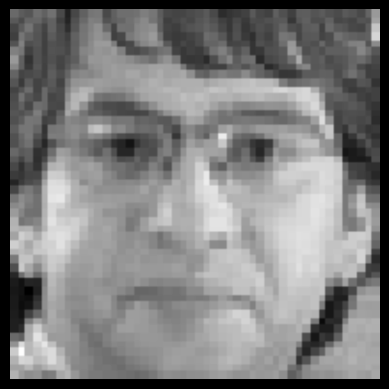

Image: /content/images/images/validation/sad/6720.jpg
Predicted class: sad
Probability: 67.9%
1/1 [==============================] - 0s 27ms/step


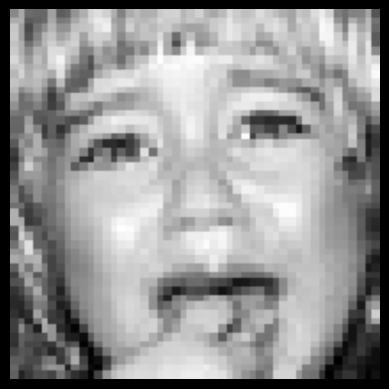

Image: /content/images/images/validation/sad/30565.jpg
Predicted class: sad
Probability: 35.2%
1/1 [==============================] - 0s 25ms/step


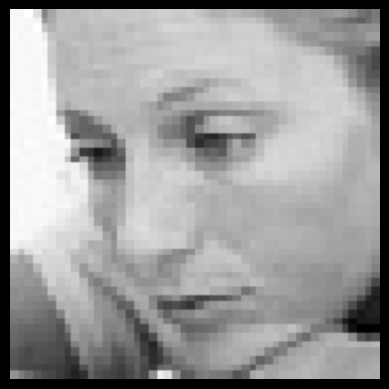

Image: /content/images/images/validation/sad/27588.jpg
Predicted class: sad
Probability: 98.2%
1/1 [==============================] - 0s 31ms/step


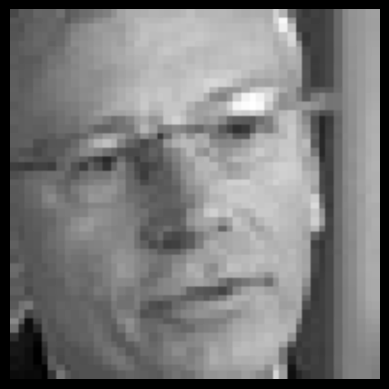

Image: /content/images/images/validation/sad/19799.jpg
Predicted class: sad
Probability: 30.8%
1/1 [==============================] - 0s 35ms/step


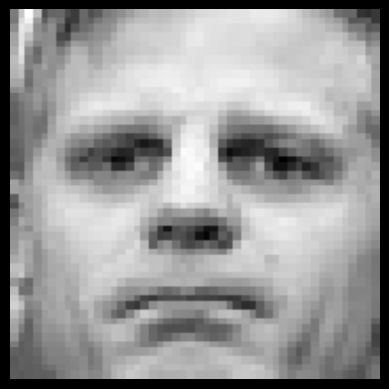

Image: /content/images/images/validation/sad/8738.jpg
Predicted class: sad
Probability: 46.5%
1/1 [==============================] - 0s 40ms/step


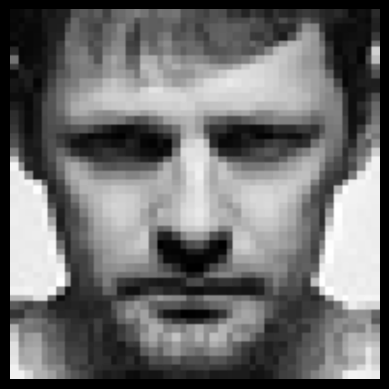

Image: /content/images/images/validation/sad/3492.jpg
Predicted class: neutral
Probability: 54.7%
1/1 [==============================] - 0s 26ms/step


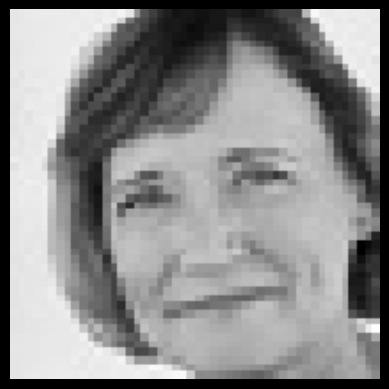

Image: /content/images/images/validation/sad/35737.jpg
Predicted class: happy
Probability: 94.8%
1/1 [==============================] - 0s 38ms/step


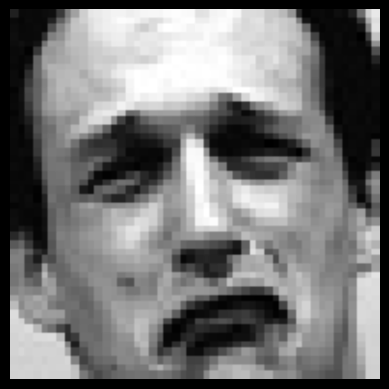

Image: /content/images/images/validation/sad/24545.jpg
Predicted class: sad
Probability: 55.9%
1/1 [==============================] - 0s 50ms/step


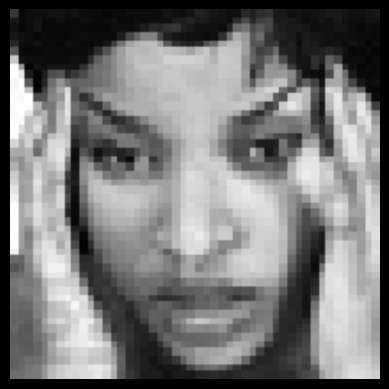

Image: /content/images/images/validation/sad/680.jpg
Predicted class: sad
Probability: 99.6%
1/1 [==============================] - 0s 46ms/step


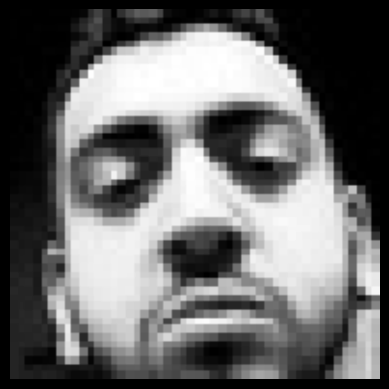

Image: /content/images/images/validation/sad/26612.jpg
Predicted class: sad
Probability: 99.4%
1/1 [==============================] - 0s 64ms/step


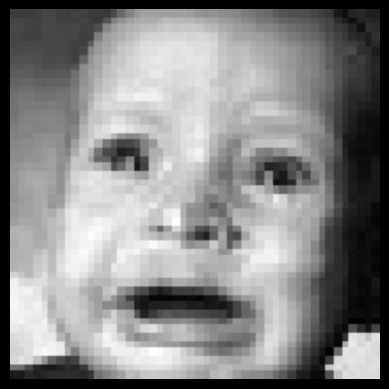

Image: /content/images/images/validation/sad/13150.jpg
Predicted class: sad
Probability: 80.1%
1/1 [==============================] - 0s 58ms/step


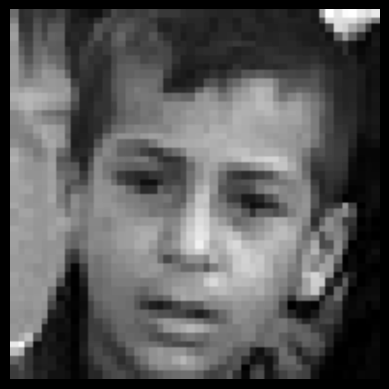

Image: /content/images/images/validation/sad/9171.jpg
Predicted class: sad
Probability: 94.5%
1/1 [==============================] - 0s 44ms/step


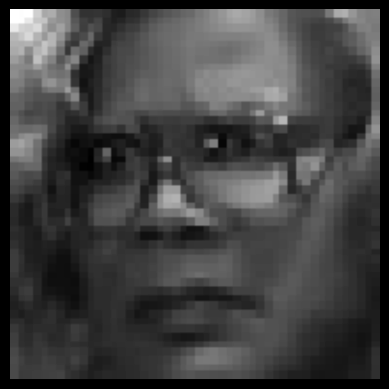

Image: /content/images/images/validation/sad/2785.jpg
Predicted class: sad
Probability: 61.4%
1/1 [==============================] - 0s 51ms/step


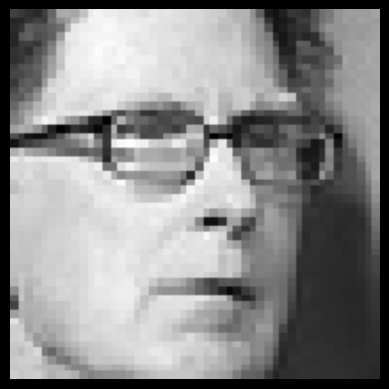

Image: /content/images/images/validation/sad/14464.jpg
Predicted class: neutral
Probability: 33.1%
1/1 [==============================] - 0s 49ms/step


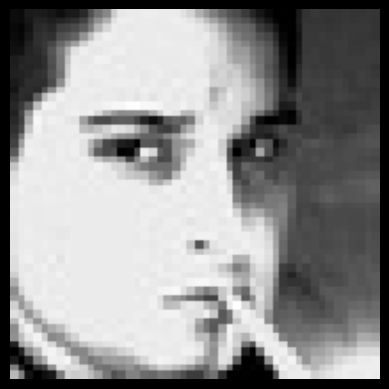

Image: /content/images/images/validation/sad/21078.jpg
Predicted class: sad
Probability: 51.0%
1/1 [==============================] - 0s 52ms/step


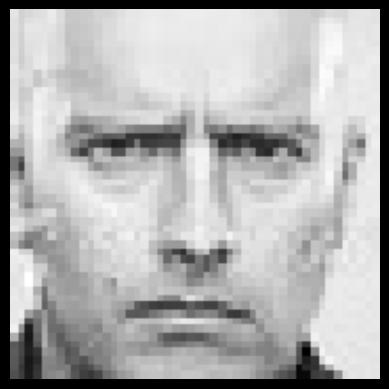

Image: /content/images/images/validation/sad/22448.jpg
Predicted class: sad
Probability: 69.3%
1/1 [==============================] - 0s 48ms/step


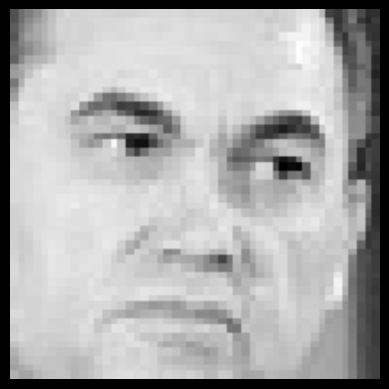

Image: /content/images/images/validation/sad/24239.jpg
Predicted class: sad
Probability: 44.4%
1/1 [==============================] - 0s 34ms/step


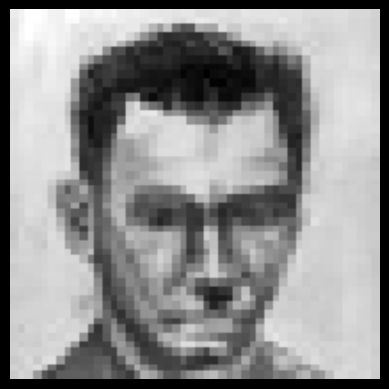

Image: /content/images/images/validation/sad/14474.jpg
Predicted class: sad
Probability: 96.3%
1/1 [==============================] - 0s 51ms/step


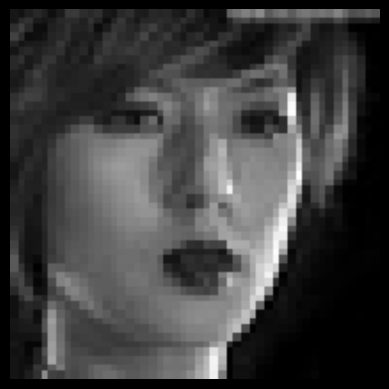

Image: /content/images/images/validation/sad/29970.jpg
Predicted class: sad
Probability: 51.4%
1/1 [==============================] - 0s 48ms/step


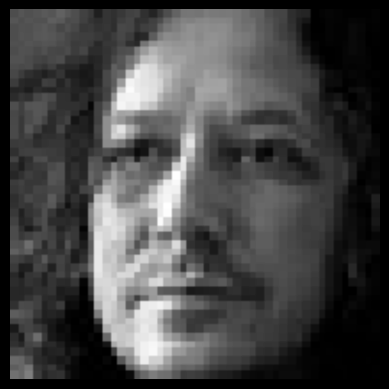

Image: /content/images/images/validation/sad/7121.jpg
Predicted class: sad
Probability: 88.0%
1/1 [==============================] - 0s 37ms/step


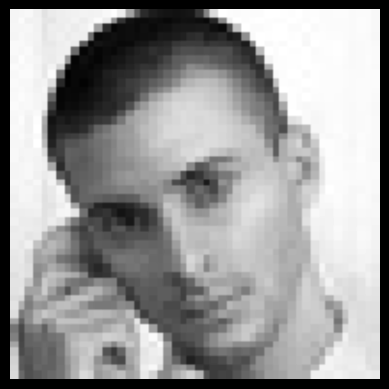

Image: /content/images/images/validation/sad/34205.jpg
Predicted class: neutral
Probability: 99.4%
1/1 [==============================] - 0s 37ms/step


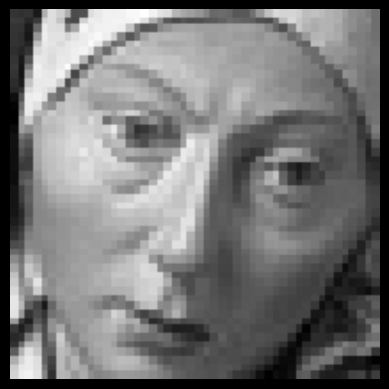

Image: /content/images/images/validation/sad/18855.jpg
Predicted class: angry
Probability: 41.3%
1/1 [==============================] - 0s 41ms/step


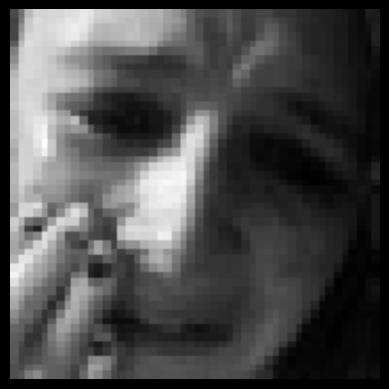

Image: /content/images/images/validation/sad/23220.jpg
Predicted class: sad
Probability: 98.3%
1/1 [==============================] - 0s 27ms/step


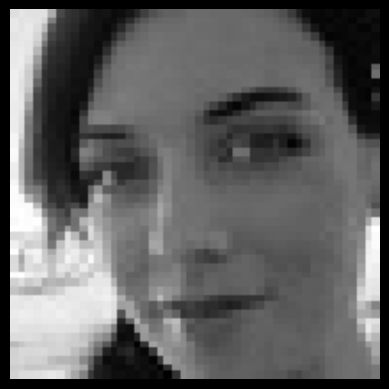

Image: /content/images/images/validation/sad/34387.jpg
Predicted class: neutral
Probability: 84.6%
1/1 [==============================] - 0s 25ms/step


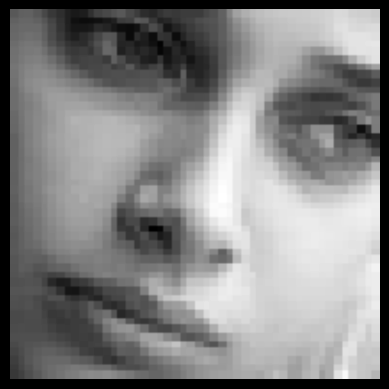

Image: /content/images/images/validation/sad/20750.jpg
Predicted class: sad
Probability: 89.4%
1/1 [==============================] - 0s 26ms/step


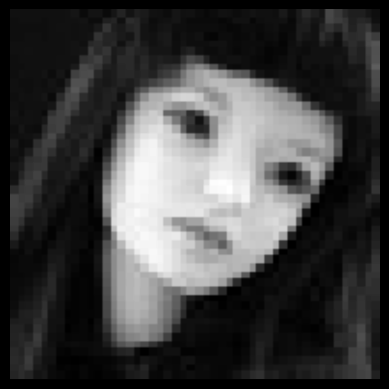

Image: /content/images/images/validation/sad/30331.jpg
Predicted class: sad
Probability: 94.3%
1/1 [==============================] - 0s 30ms/step


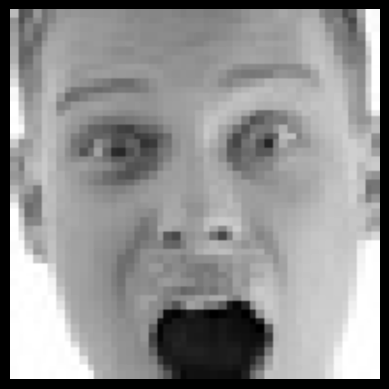

Image: /content/images/images/validation/surprise/23662.jpg
Predicted class: surprise
Probability: 98.6%
1/1 [==============================] - 0s 26ms/step


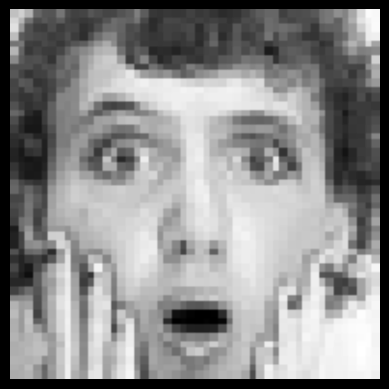

Image: /content/images/images/validation/surprise/9630.jpg
Predicted class: surprise
Probability: 99.2%
1/1 [==============================] - 0s 27ms/step


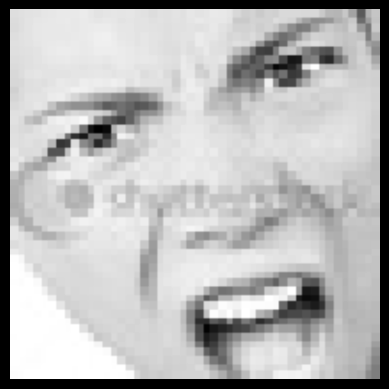

Image: /content/images/images/validation/surprise/8240.jpg
Predicted class: surprise
Probability: 99.5%
1/1 [==============================] - 0s 26ms/step


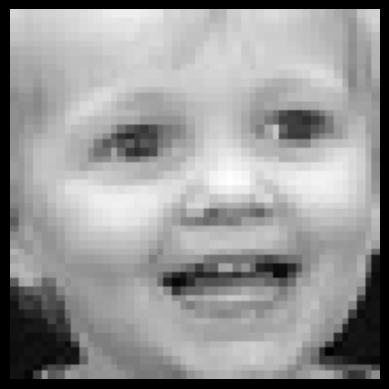

Image: /content/images/images/validation/surprise/29677.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


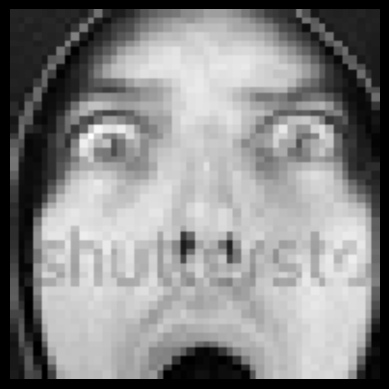

Image: /content/images/images/validation/surprise/78.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


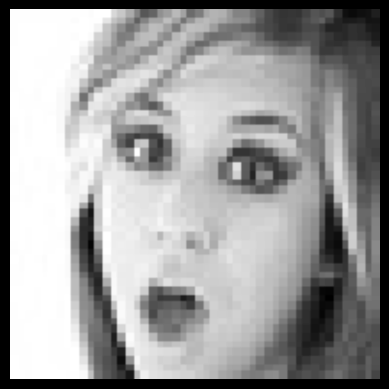

Image: /content/images/images/validation/surprise/5037.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 36ms/step


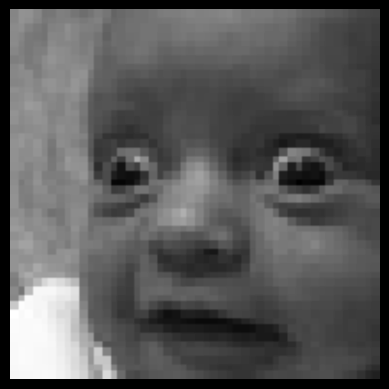

Image: /content/images/images/validation/surprise/15944.jpg
Predicted class: surprise
Probability: 90.0%
1/1 [==============================] - 0s 27ms/step


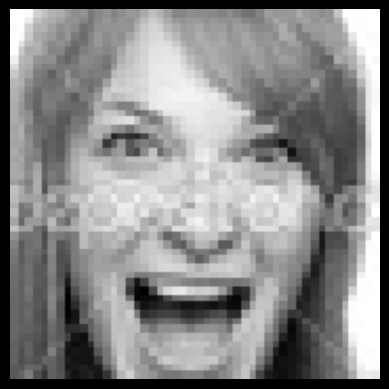

Image: /content/images/images/validation/surprise/2619.jpg
Predicted class: surprise
Probability: 91.3%
1/1 [==============================] - 0s 25ms/step


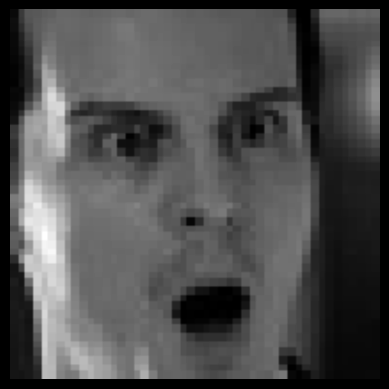

Image: /content/images/images/validation/surprise/20691.jpg
Predicted class: surprise
Probability: 95.9%
1/1 [==============================] - 0s 35ms/step


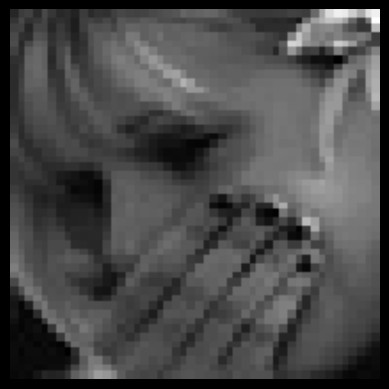

Image: /content/images/images/validation/surprise/4352.jpg
Predicted class: surprise
Probability: 45.8%
1/1 [==============================] - 0s 26ms/step


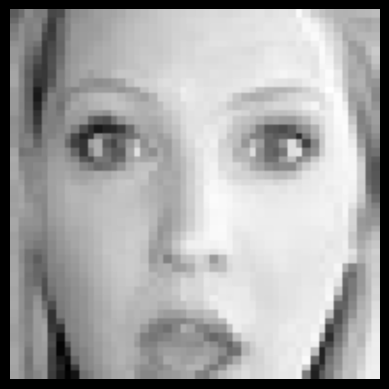

Image: /content/images/images/validation/surprise/6050.jpg
Predicted class: surprise
Probability: 98.4%
1/1 [==============================] - 0s 34ms/step


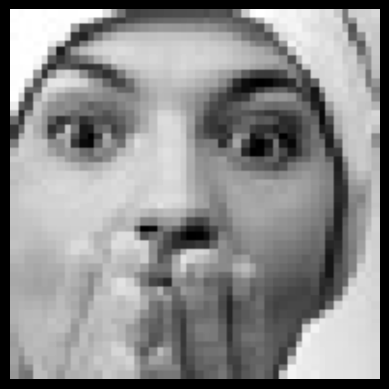

Image: /content/images/images/validation/surprise/27926.jpg
Predicted class: surprise
Probability: 95.1%
1/1 [==============================] - 0s 25ms/step


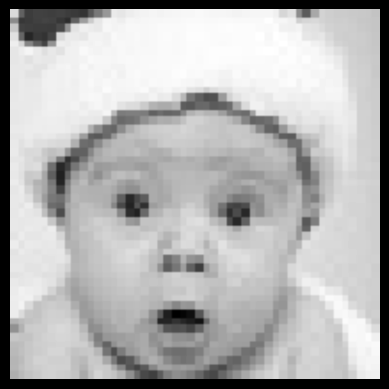

Image: /content/images/images/validation/surprise/21896.jpg
Predicted class: surprise
Probability: 96.7%
1/1 [==============================] - 0s 26ms/step


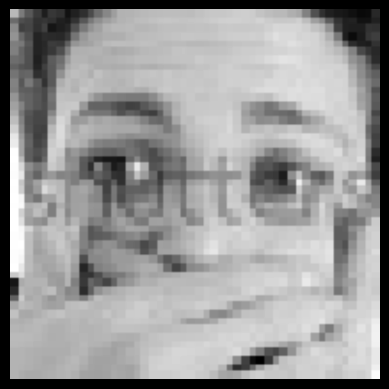

Image: /content/images/images/validation/surprise/16756.jpg
Predicted class: surprise
Probability: 53.4%
1/1 [==============================] - 0s 26ms/step


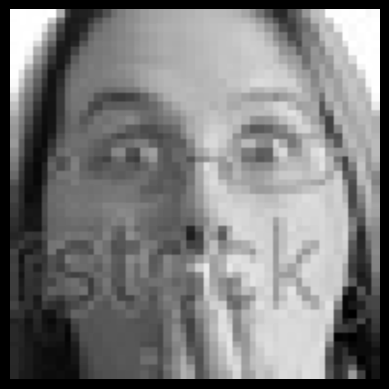

Image: /content/images/images/validation/surprise/28448.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


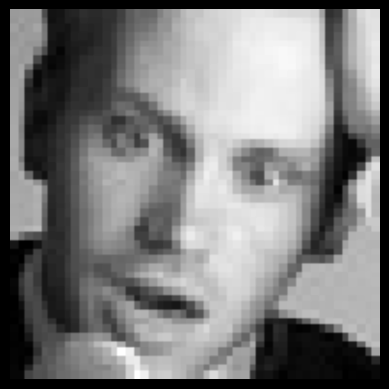

Image: /content/images/images/validation/surprise/34385.jpg
Predicted class: angry
Probability: 63.3%
1/1 [==============================] - 0s 28ms/step


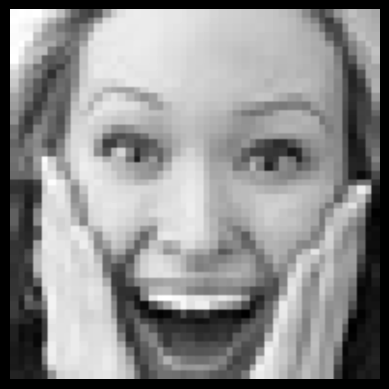

Image: /content/images/images/validation/surprise/25397.jpg
Predicted class: surprise
Probability: 99.7%
1/1 [==============================] - 0s 35ms/step


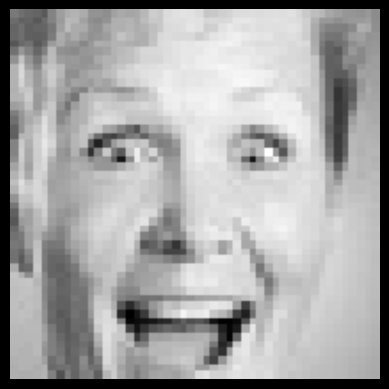

Image: /content/images/images/validation/surprise/27696.jpg
Predicted class: surprise
Probability: 91.6%
1/1 [==============================] - 0s 26ms/step


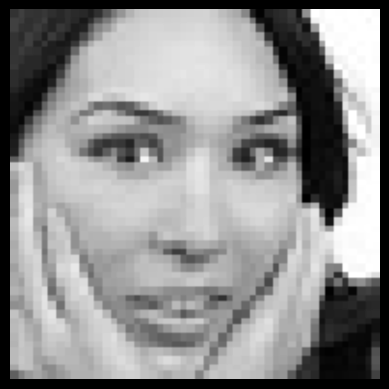

Image: /content/images/images/validation/surprise/1449.jpg
Predicted class: surprise
Probability: 99.6%
1/1 [==============================] - 0s 28ms/step


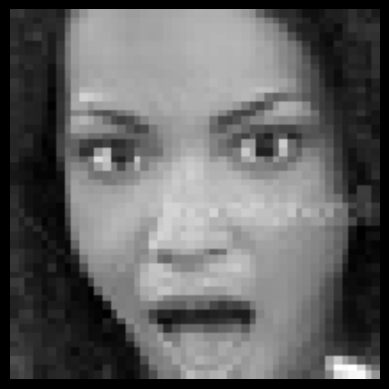

Image: /content/images/images/validation/surprise/24050.jpg
Predicted class: surprise
Probability: 97.8%
1/1 [==============================] - 0s 47ms/step


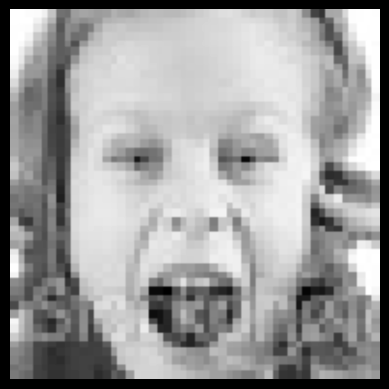

Image: /content/images/images/validation/surprise/9021.jpg
Predicted class: surprise
Probability: 67.0%
1/1 [==============================] - 0s 28ms/step


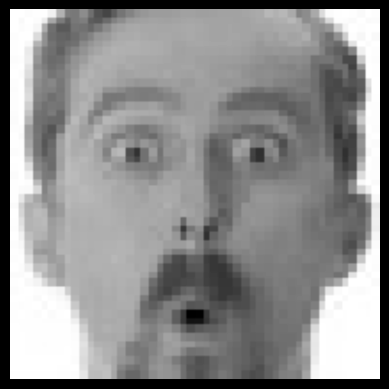

Image: /content/images/images/validation/surprise/6427.jpg
Predicted class: surprise
Probability: 99.7%
1/1 [==============================] - 0s 28ms/step


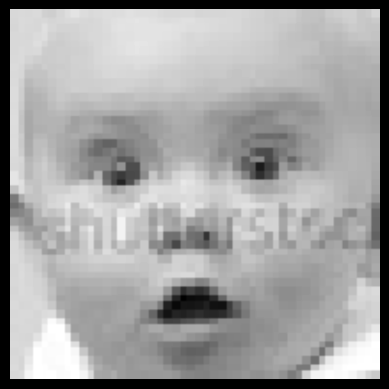

Image: /content/images/images/validation/surprise/28441.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


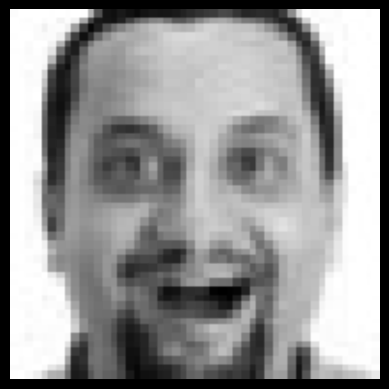

Image: /content/images/images/validation/surprise/6247.jpg
Predicted class: surprise
Probability: 95.1%
1/1 [==============================] - 0s 27ms/step


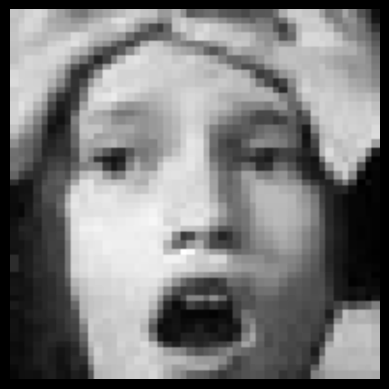

Image: /content/images/images/validation/surprise/32979.jpg
Predicted class: surprise
Probability: 98.8%
1/1 [==============================] - 0s 25ms/step


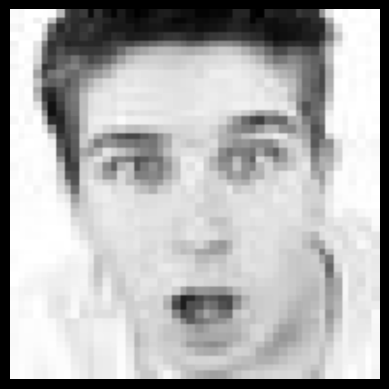

Image: /content/images/images/validation/surprise/23053.jpg
Predicted class: surprise
Probability: 99.2%
1/1 [==============================] - 0s 26ms/step


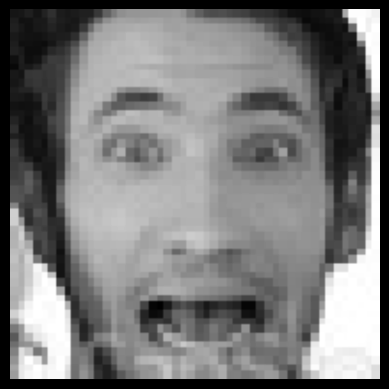

Image: /content/images/images/validation/surprise/32753.jpg
Predicted class: surprise
Probability: 98.4%
1/1 [==============================] - 0s 45ms/step


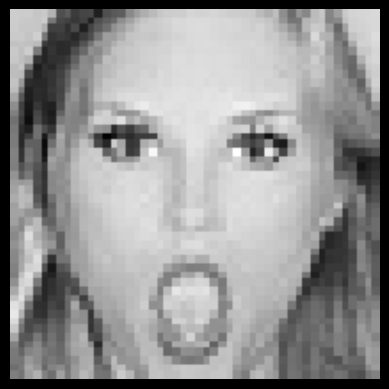

Image: /content/images/images/validation/surprise/15467.jpg
Predicted class: surprise
Probability: 99.2%
1/1 [==============================] - 0s 28ms/step


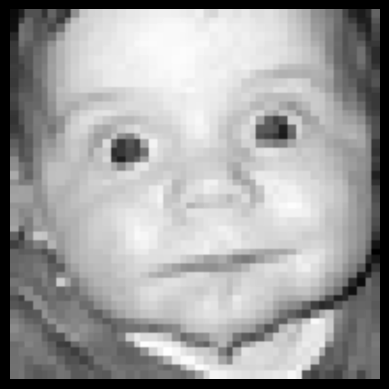

Image: /content/images/images/validation/surprise/16995.jpg
Predicted class: surprise
Probability: 99.4%
1/1 [==============================] - 0s 26ms/step


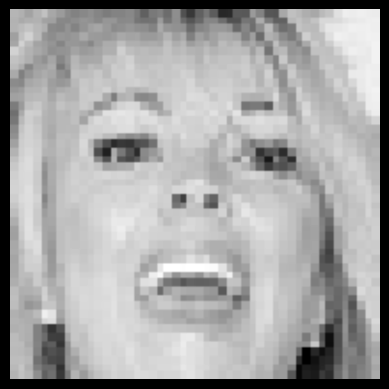

Image: /content/images/images/validation/surprise/26800.jpg
Predicted class: happy
Probability: 94.3%
1/1 [==============================] - 0s 28ms/step


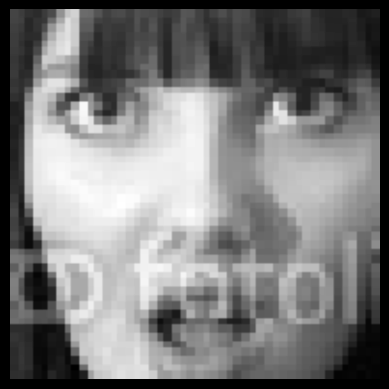

Image: /content/images/images/validation/surprise/13230.jpg
Predicted class: surprise
Probability: 99.7%
1/1 [==============================] - 0s 26ms/step


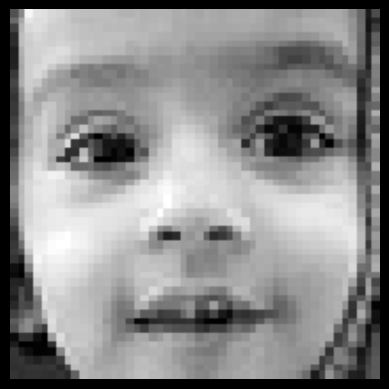

Image: /content/images/images/validation/surprise/26556.jpg
Predicted class: surprise
Probability: 99.6%
1/1 [==============================] - 0s 26ms/step


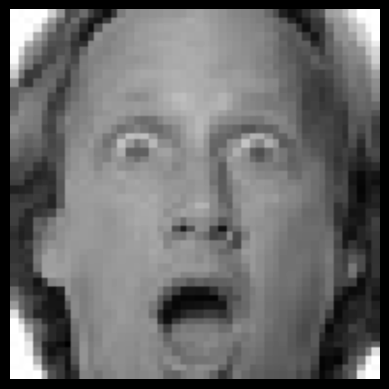

Image: /content/images/images/validation/surprise/25036.jpg
Predicted class: surprise
Probability: 91.6%
1/1 [==============================] - 0s 29ms/step


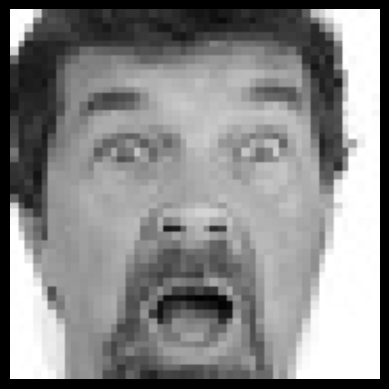

Image: /content/images/images/validation/surprise/13101.jpg
Predicted class: surprise
Probability: 98.8%
1/1 [==============================] - 0s 41ms/step


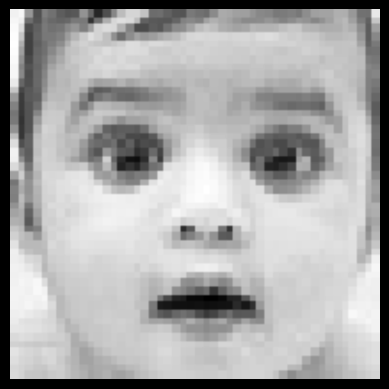

Image: /content/images/images/validation/surprise/14697.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


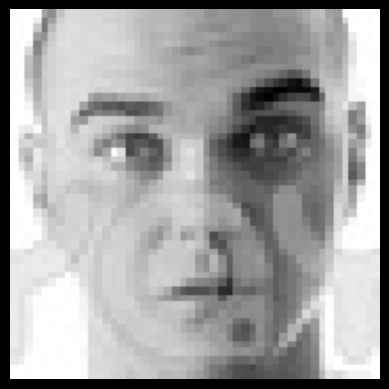

Image: /content/images/images/validation/surprise/10372.jpg
Predicted class: surprise
Probability: 86.1%
1/1 [==============================] - 0s 27ms/step


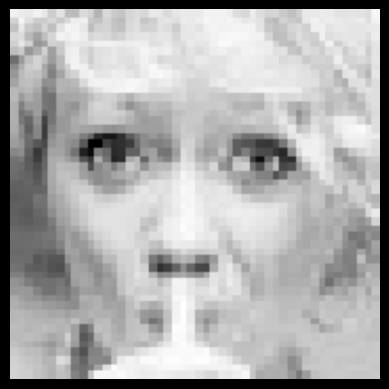

Image: /content/images/images/validation/surprise/35688.jpg
Predicted class: surprise
Probability: 90.3%
1/1 [==============================] - 0s 27ms/step


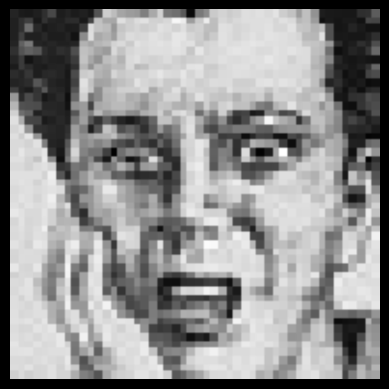

Image: /content/images/images/validation/surprise/12960.jpg
Predicted class: fear
Probability: 41.1%
1/1 [==============================] - 0s 31ms/step


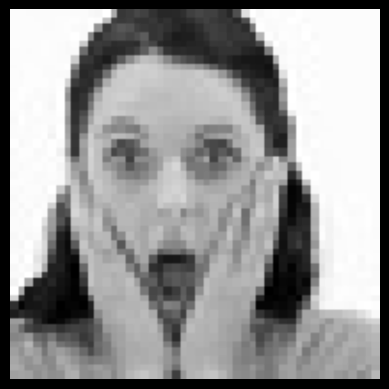

Image: /content/images/images/validation/surprise/31899.jpg
Predicted class: surprise
Probability: 99.0%
1/1 [==============================] - 0s 27ms/step


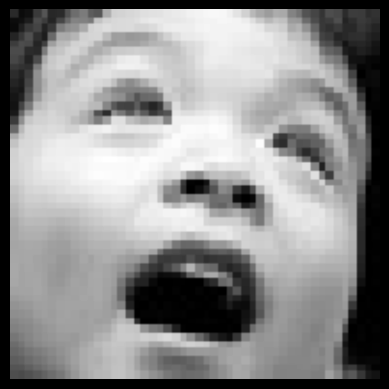

Image: /content/images/images/validation/surprise/3878.jpg
Predicted class: surprise
Probability: 99.6%
1/1 [==============================] - 0s 28ms/step


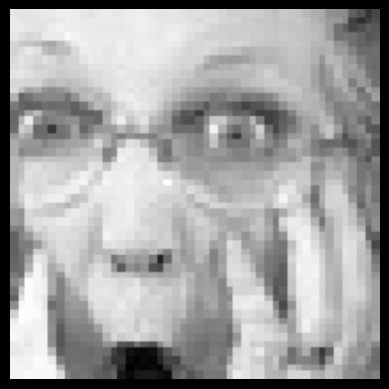

Image: /content/images/images/validation/surprise/6877.jpg
Predicted class: surprise
Probability: 96.7%
1/1 [==============================] - 0s 44ms/step


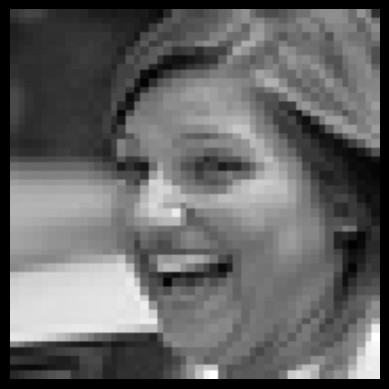

Image: /content/images/images/validation/surprise/24904.jpg
Predicted class: surprise
Probability: 66.1%
1/1 [==============================] - 0s 32ms/step


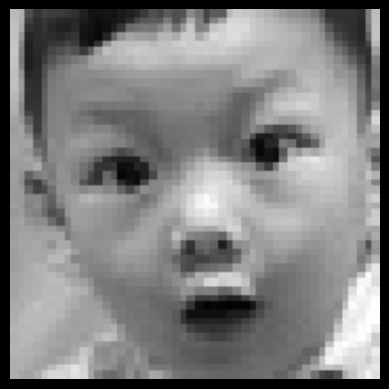

Image: /content/images/images/validation/surprise/25563.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 34ms/step


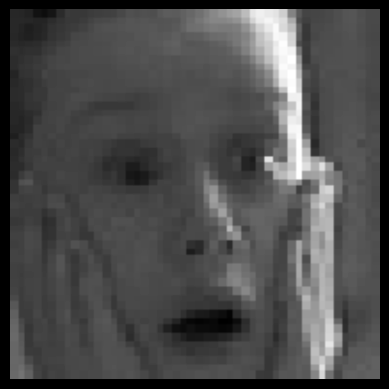

Image: /content/images/images/validation/surprise/8115.jpg
Predicted class: surprise
Probability: 99.2%
1/1 [==============================] - 0s 33ms/step


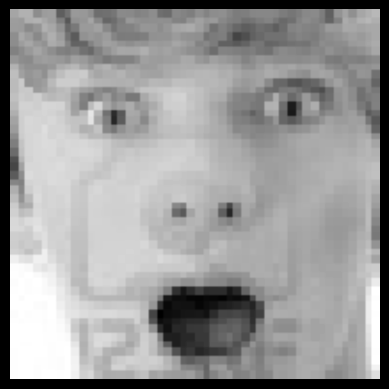

Image: /content/images/images/validation/surprise/8329.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 29ms/step


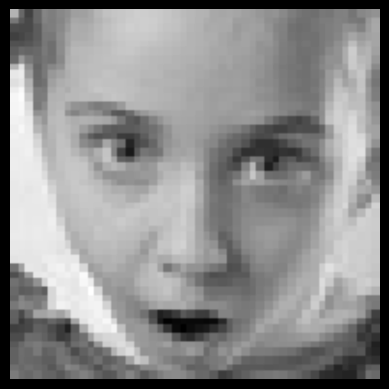

Image: /content/images/images/validation/surprise/3675.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 35ms/step


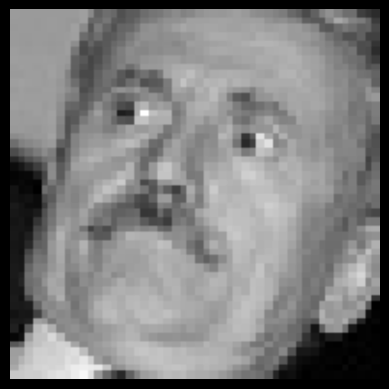

Image: /content/images/images/validation/surprise/5893.jpg
Predicted class: surprise
Probability: 67.7%
1/1 [==============================] - 0s 49ms/step


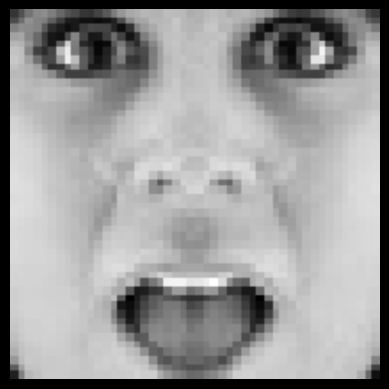

Image: /content/images/images/validation/surprise/16646.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 53ms/step


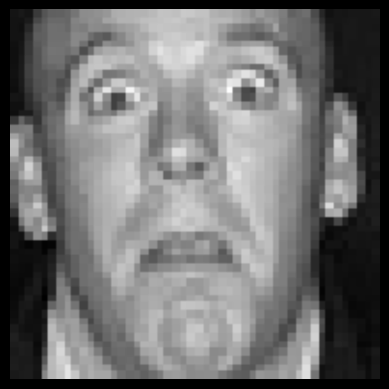

Image: /content/images/images/validation/surprise/1710.jpg
Predicted class: surprise
Probability: 98.5%
1/1 [==============================] - 0s 56ms/step


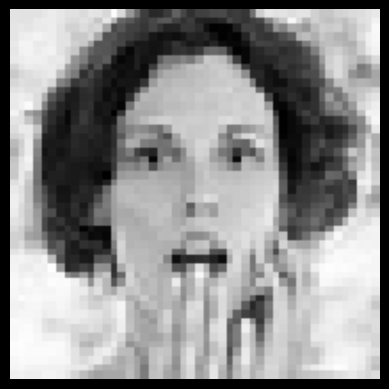

Image: /content/images/images/validation/surprise/17137.jpg
Predicted class: surprise
Probability: 99.8%
1/1 [==============================] - 0s 59ms/step


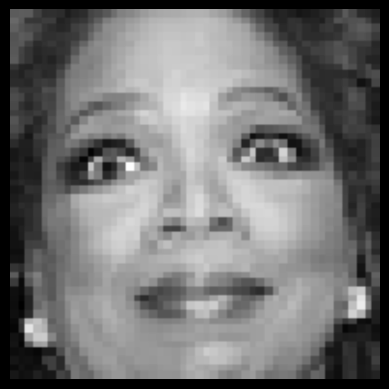

Image: /content/images/images/validation/surprise/5450.jpg
Predicted class: surprise
Probability: 93.5%
1/1 [==============================] - 0s 44ms/step


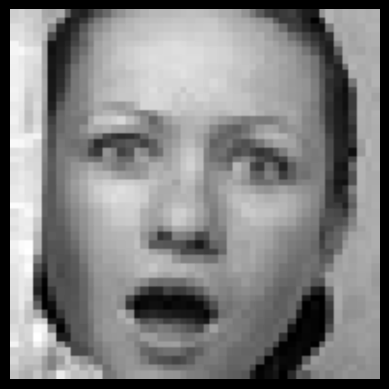

Image: /content/images/images/validation/surprise/21587.jpg
Predicted class: surprise
Probability: 94.0%
1/1 [==============================] - 0s 43ms/step


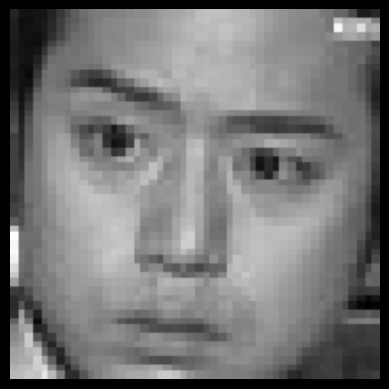

Image: /content/images/images/validation/surprise/10097.jpg
Predicted class: neutral
Probability: 97.4%
1/1 [==============================] - 0s 45ms/step


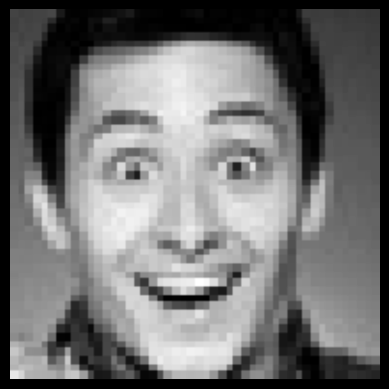

Image: /content/images/images/validation/surprise/12903.jpg
Predicted class: surprise
Probability: 84.5%
1/1 [==============================] - 0s 40ms/step


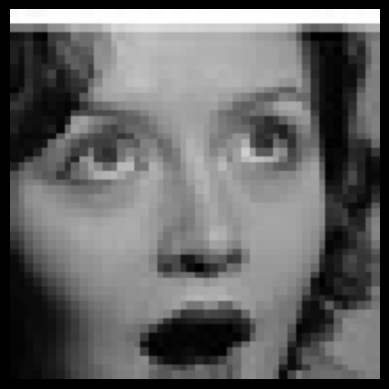

Image: /content/images/images/validation/surprise/1764.jpg
Predicted class: surprise
Probability: 94.2%
1/1 [==============================] - 0s 49ms/step


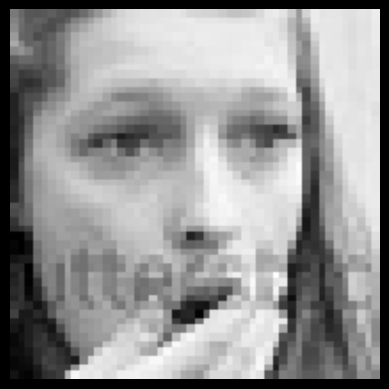

Image: /content/images/images/validation/surprise/32734.jpg
Predicted class: surprise
Probability: 86.1%
1/1 [==============================] - 0s 37ms/step


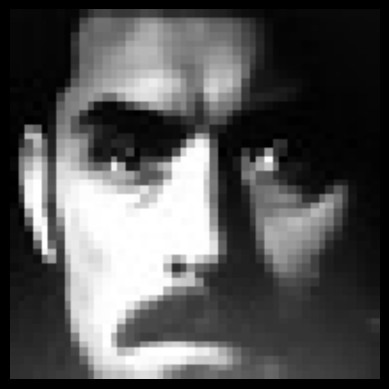

Image: /content/images/images/validation/surprise/35084.jpg
Predicted class: neutral
Probability: 99.1%
1/1 [==============================] - 0s 38ms/step


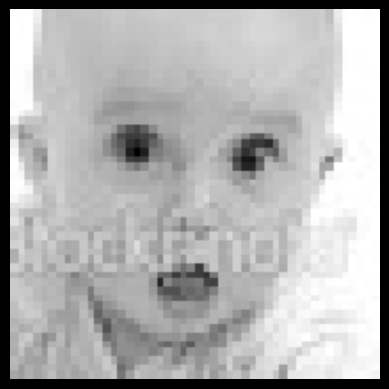

Image: /content/images/images/validation/surprise/1864.jpg
Predicted class: neutral
Probability: 47.9%
1/1 [==============================] - 0s 26ms/step


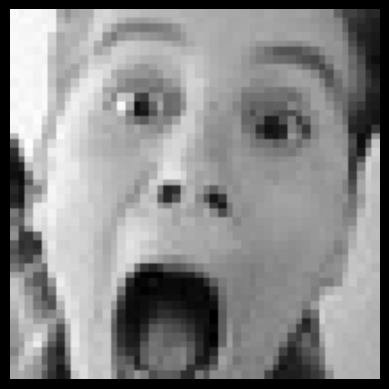

Image: /content/images/images/validation/surprise/26825.jpg
Predicted class: surprise
Probability: 98.8%
1/1 [==============================] - 0s 26ms/step


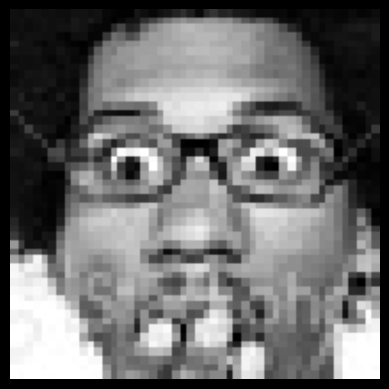

Image: /content/images/images/validation/surprise/1750.jpg
Predicted class: surprise
Probability: 95.2%
1/1 [==============================] - 0s 26ms/step


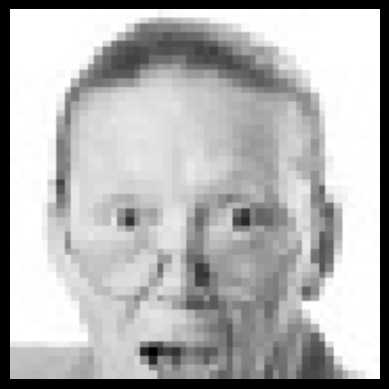

Image: /content/images/images/validation/surprise/17245.jpg
Predicted class: fear
Probability: 91.1%
1/1 [==============================] - 0s 26ms/step


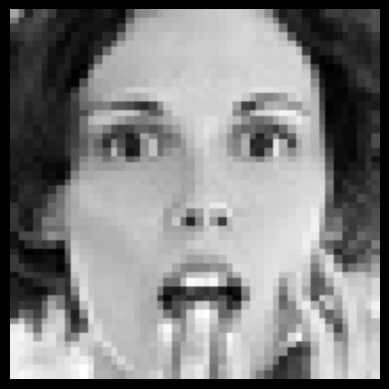

Image: /content/images/images/validation/surprise/27039.jpg
Predicted class: surprise
Probability: 99.0%
1/1 [==============================] - 0s 47ms/step


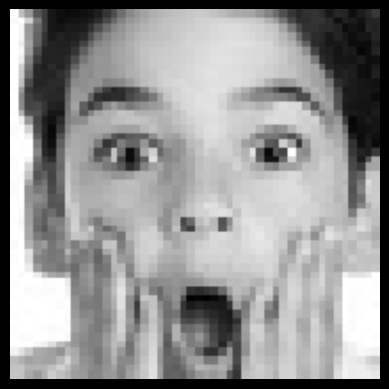

Image: /content/images/images/validation/surprise/20162.jpg
Predicted class: surprise
Probability: 93.4%
1/1 [==============================] - 0s 27ms/step


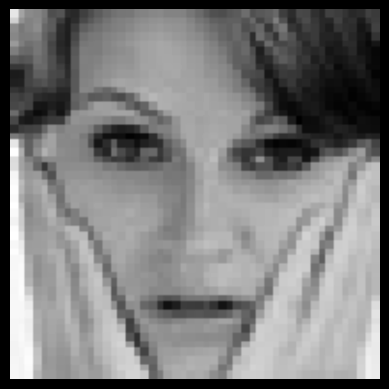

Image: /content/images/images/validation/surprise/15527.jpg
Predicted class: fear
Probability: 89.1%
1/1 [==============================] - 0s 26ms/step


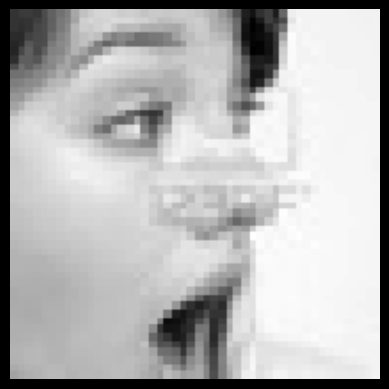

Image: /content/images/images/validation/surprise/19650.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


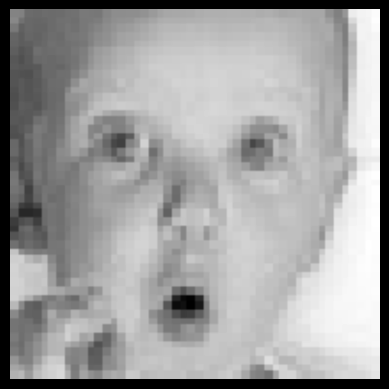

Image: /content/images/images/validation/surprise/12134.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


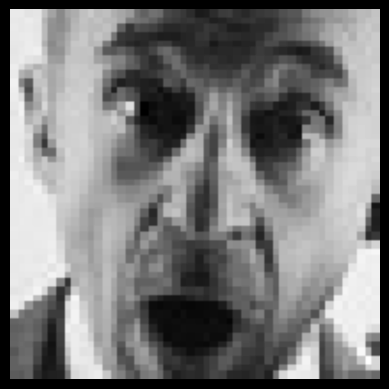

Image: /content/images/images/validation/surprise/15922.jpg
Predicted class: angry
Probability: 47.4%
1/1 [==============================] - 0s 26ms/step


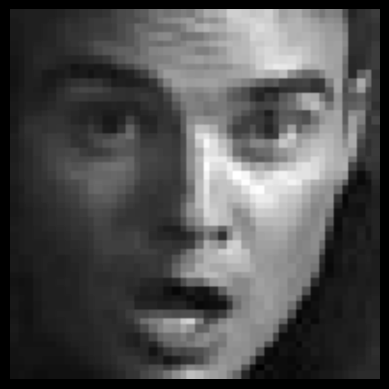

Image: /content/images/images/validation/surprise/9450.jpg
Predicted class: surprise
Probability: 81.5%
1/1 [==============================] - 0s 41ms/step


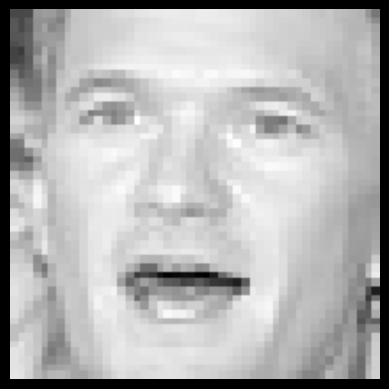

Image: /content/images/images/validation/surprise/29542.jpg
Predicted class: surprise
Probability: 64.7%
1/1 [==============================] - 0s 34ms/step


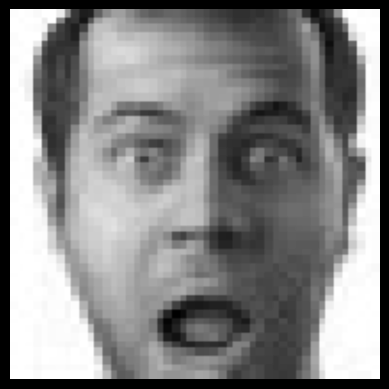

Image: /content/images/images/validation/surprise/3002.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


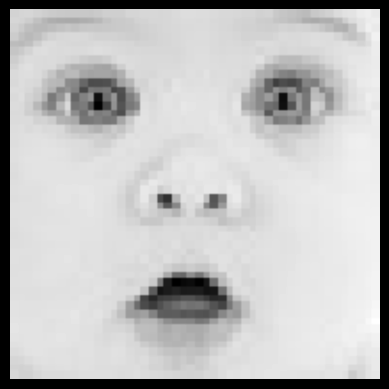

Image: /content/images/images/validation/surprise/7562.jpg
Predicted class: surprise
Probability: 99.5%
1/1 [==============================] - 0s 26ms/step


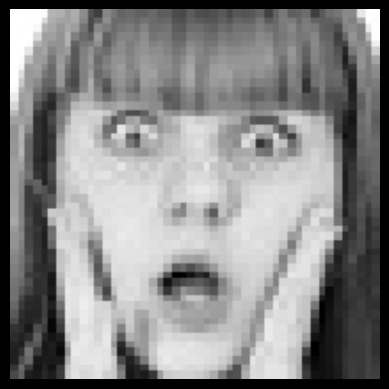

Image: /content/images/images/validation/surprise/5530.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


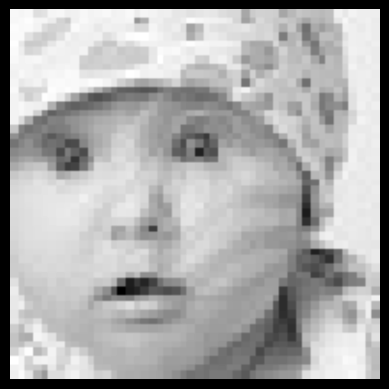

Image: /content/images/images/validation/surprise/29038.jpg
Predicted class: sad
Probability: 89.2%
1/1 [==============================] - 0s 25ms/step


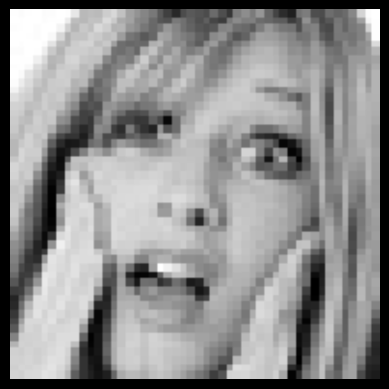

Image: /content/images/images/validation/surprise/35757.jpg
Predicted class: surprise
Probability: 98.9%
1/1 [==============================] - 0s 25ms/step


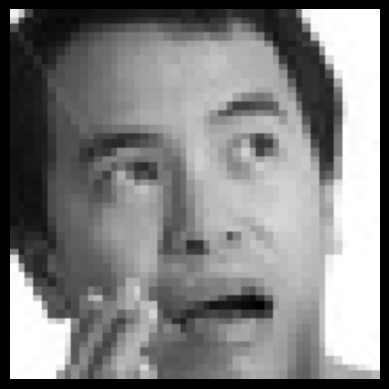

Image: /content/images/images/validation/surprise/14914.jpg
Predicted class: fear
Probability: 83.1%
1/1 [==============================] - 0s 30ms/step


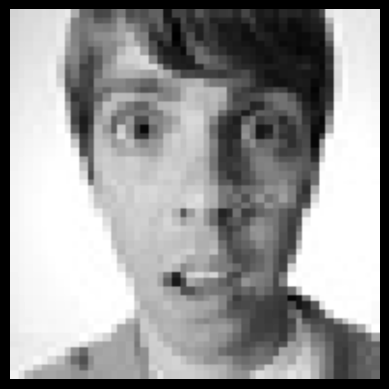

Image: /content/images/images/validation/surprise/33993.jpg
Predicted class: surprise
Probability: 98.3%
1/1 [==============================] - 0s 27ms/step


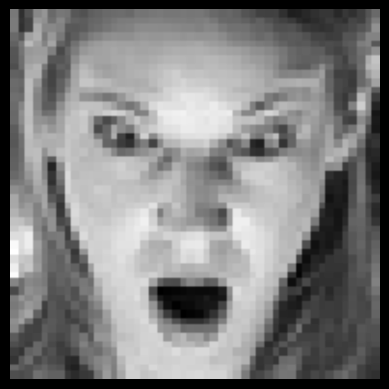

Image: /content/images/images/validation/surprise/9118.jpg
Predicted class: surprise
Probability: 99.5%
1/1 [==============================] - 0s 25ms/step


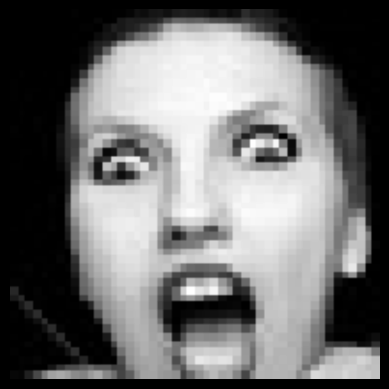

Image: /content/images/images/validation/surprise/9162.jpg
Predicted class: surprise
Probability: 83.2%
1/1 [==============================] - 0s 32ms/step


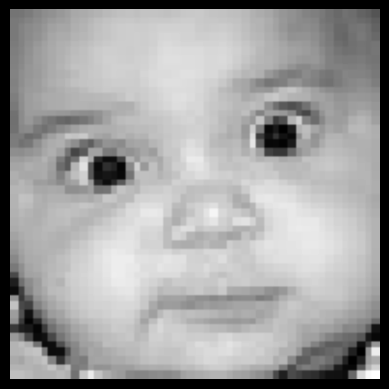

Image: /content/images/images/validation/surprise/18436.jpg
Predicted class: surprise
Probability: 98.4%
1/1 [==============================] - 0s 34ms/step


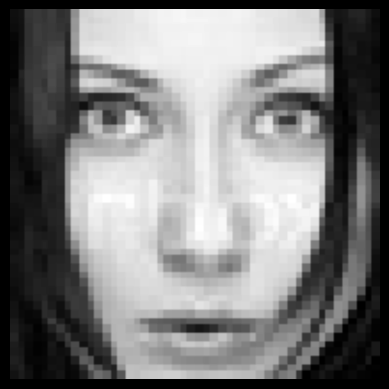

Image: /content/images/images/validation/surprise/25492.jpg
Predicted class: surprise
Probability: 81.9%
1/1 [==============================] - 0s 39ms/step


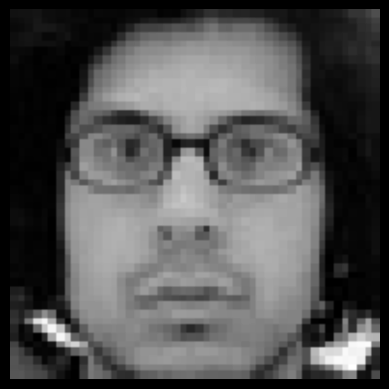

Image: /content/images/images/validation/surprise/24022.jpg
Predicted class: surprise
Probability: 67.8%
1/1 [==============================] - 0s 27ms/step


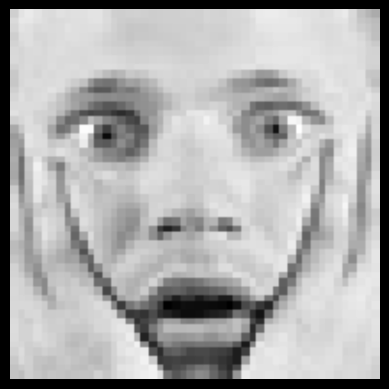

Image: /content/images/images/validation/surprise/30943.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 25ms/step


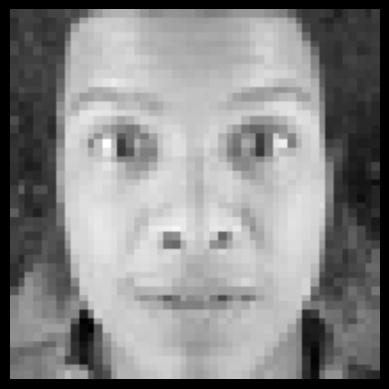

Image: /content/images/images/validation/surprise/15263.jpg
Predicted class: surprise
Probability: 97.7%
1/1 [==============================] - 0s 25ms/step


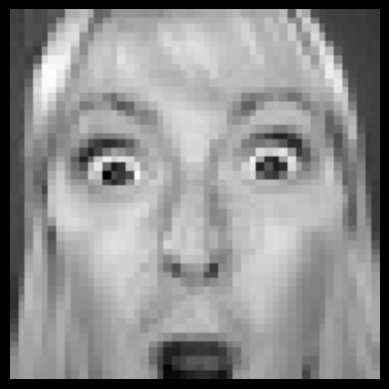

Image: /content/images/images/validation/surprise/8173.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


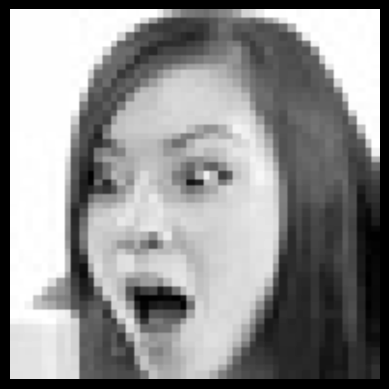

Image: /content/images/images/validation/surprise/32432.jpg
Predicted class: surprise
Probability: 100.%
1/1 [==============================] - 0s 28ms/step


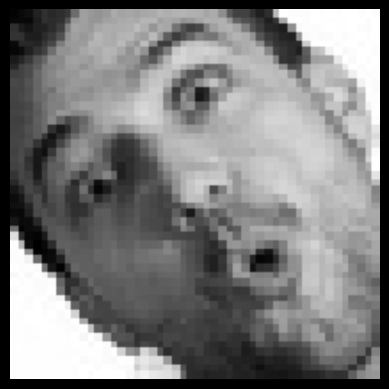

Image: /content/images/images/validation/surprise/647.jpg
Predicted class: fear
Probability: 48.9%
1/1 [==============================] - 0s 27ms/step


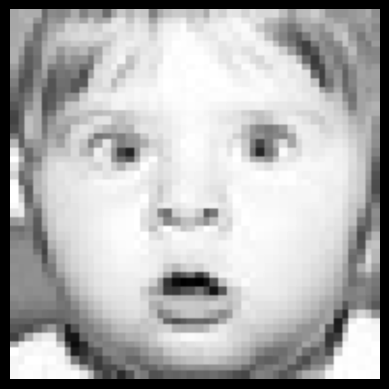

Image: /content/images/images/validation/surprise/33879.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 29ms/step


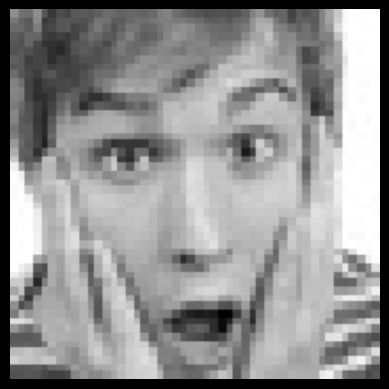

Image: /content/images/images/validation/surprise/6598.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 27ms/step


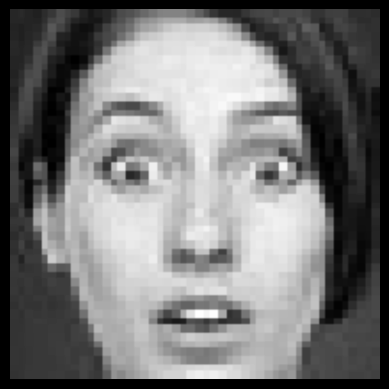

Image: /content/images/images/validation/surprise/18313.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 41ms/step


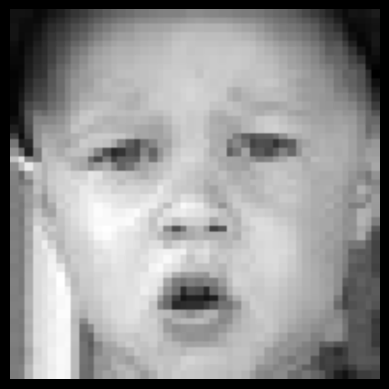

Image: /content/images/images/validation/surprise/783.jpg
Predicted class: surprise
Probability: 68.6%
1/1 [==============================] - 0s 26ms/step


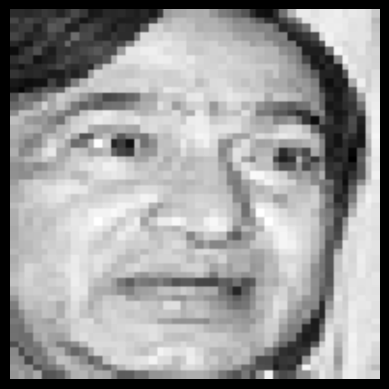

Image: /content/images/images/validation/surprise/27025.jpg
Predicted class: surprise
Probability: 31.6%
1/1 [==============================] - 0s 32ms/step


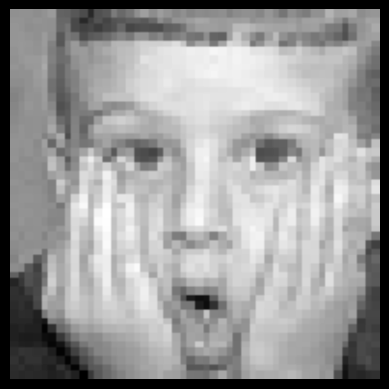

Image: /content/images/images/validation/surprise/33745.jpg
Predicted class: surprise
Probability: 99.1%
1/1 [==============================] - 0s 32ms/step


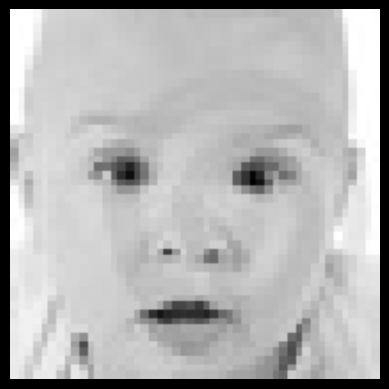

Image: /content/images/images/validation/surprise/35237.jpg
Predicted class: sad
Probability: 58.6%
1/1 [==============================] - 0s 41ms/step


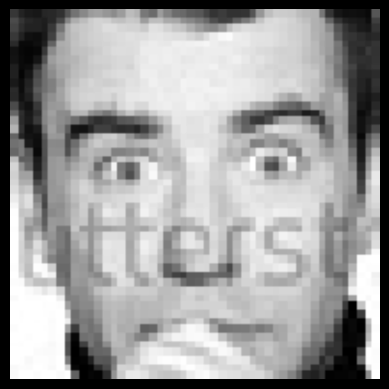

Image: /content/images/images/validation/surprise/17610.jpg
Predicted class: surprise
Probability: 97.4%
1/1 [==============================] - 0s 55ms/step


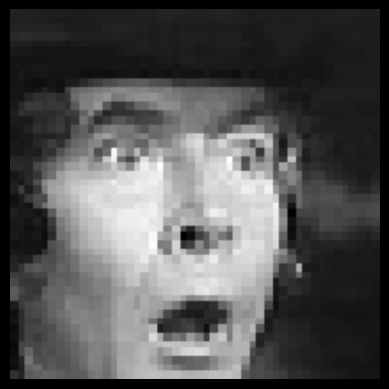

Image: /content/images/images/validation/surprise/35083.jpg
Predicted class: surprise
Probability: 99.7%
1/1 [==============================] - 0s 34ms/step


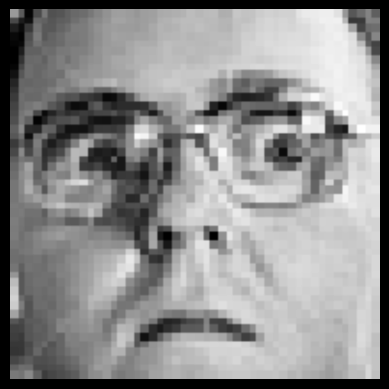

Image: /content/images/images/validation/surprise/5855.jpg
Predicted class: surprise
Probability: 95.1%
1/1 [==============================] - 0s 45ms/step


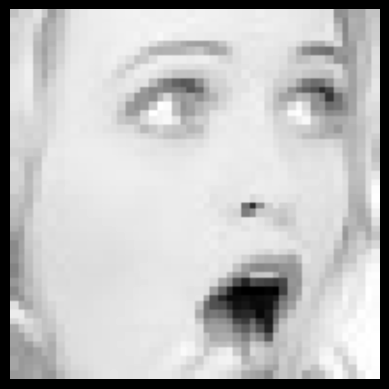

Image: /content/images/images/validation/surprise/8016.jpg
Predicted class: surprise
Probability: 99.9%
1/1 [==============================] - 0s 59ms/step


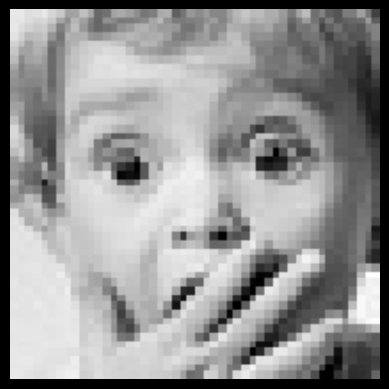

Image: /content/images/images/validation/surprise/4036.jpg
Predicted class: surprise
Probability: 99.7%
1/1 [==============================] - 0s 59ms/step


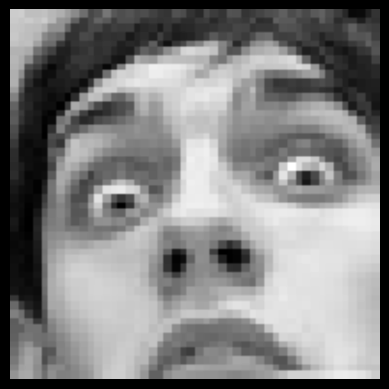

Image: /content/images/images/validation/surprise/32132.jpg
Predicted class: surprise
Probability: 99.8%
1/1 [==============================] - 0s 65ms/step


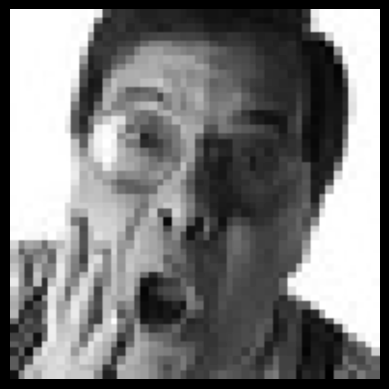

Image: /content/images/images/validation/surprise/19177.jpg
Predicted class: fear
Probability: 65.8%
1/1 [==============================] - 0s 70ms/step


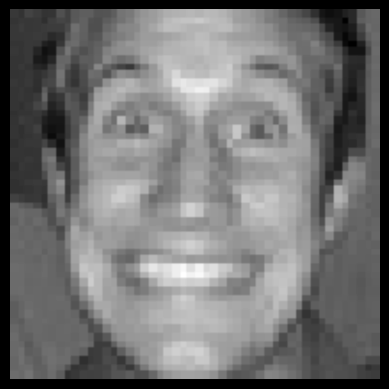

Image: /content/images/images/validation/happy/35794.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 40ms/step


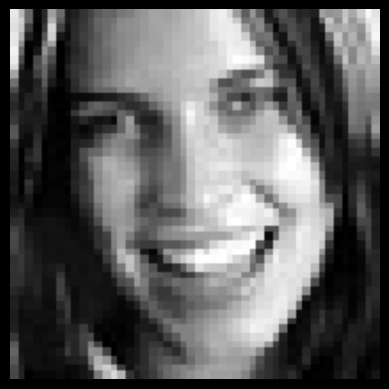

Image: /content/images/images/validation/happy/8338.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 37ms/step


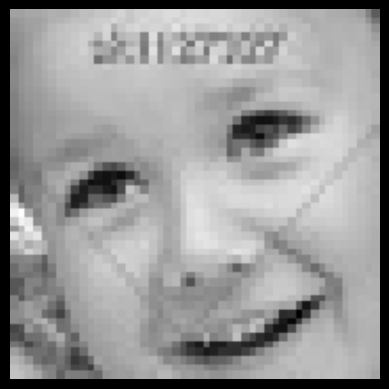

Image: /content/images/images/validation/happy/30478.jpg
Predicted class: happy
Probability: 99.8%
1/1 [==============================] - 0s 69ms/step


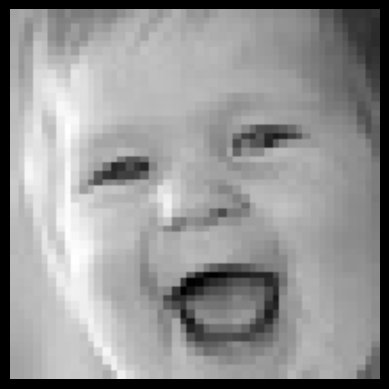

Image: /content/images/images/validation/happy/9272.jpg
Predicted class: happy
Probability: 99.3%
1/1 [==============================] - 0s 29ms/step


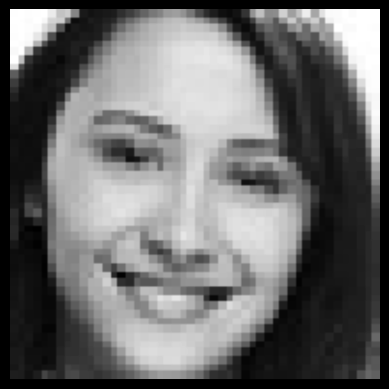

Image: /content/images/images/validation/happy/11500.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 54ms/step


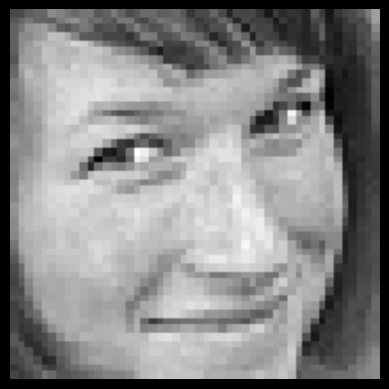

Image: /content/images/images/validation/happy/7299.jpg
Predicted class: happy
Probability: 99.4%
1/1 [==============================] - 0s 31ms/step


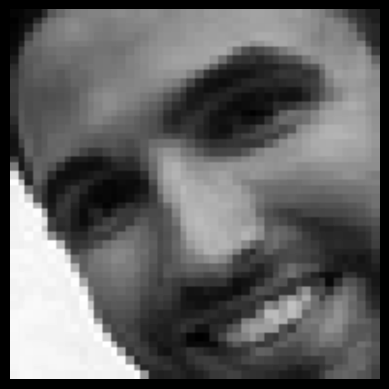

Image: /content/images/images/validation/happy/674.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 37ms/step


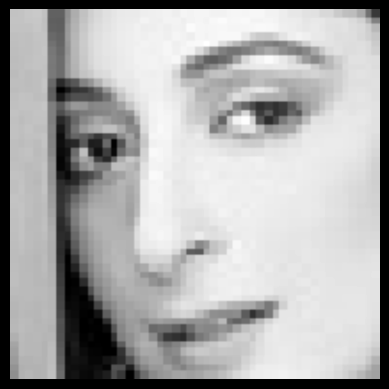

Image: /content/images/images/validation/happy/18541.jpg
Predicted class: happy
Probability: 49.3%
1/1 [==============================] - 0s 45ms/step


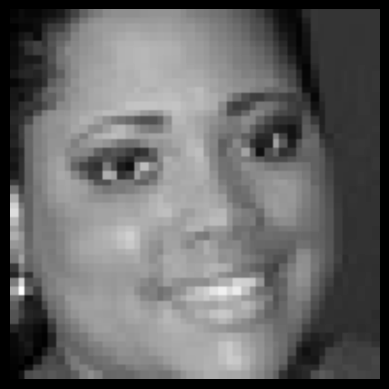

Image: /content/images/images/validation/happy/4589.jpg
Predicted class: happy
Probability: 99.6%
1/1 [==============================] - 0s 37ms/step


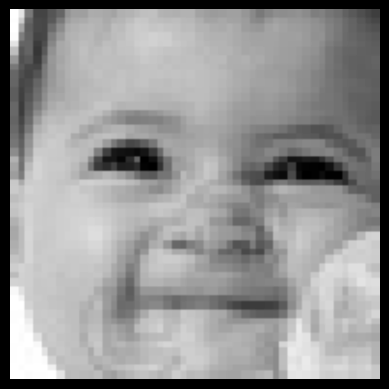

Image: /content/images/images/validation/happy/18822.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


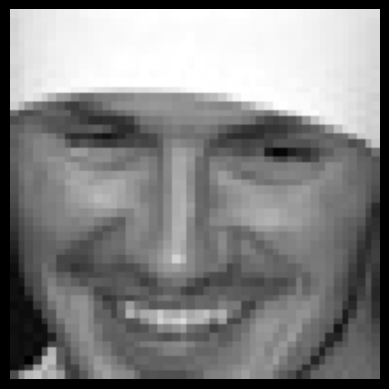

Image: /content/images/images/validation/happy/26098.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 27ms/step


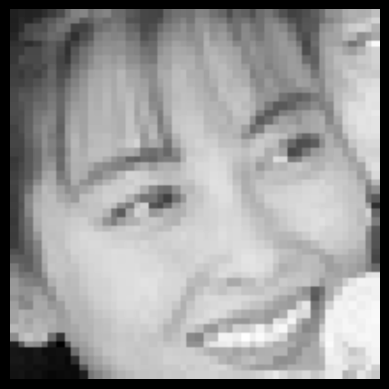

Image: /content/images/images/validation/happy/1202.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


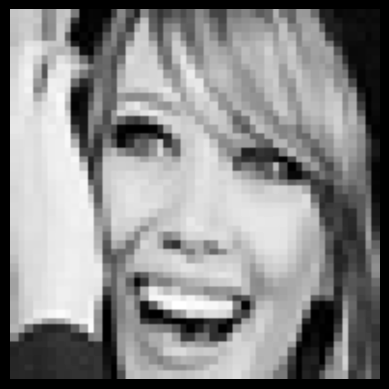

Image: /content/images/images/validation/happy/26775.jpg
Predicted class: happy
Probability: 83.7%
1/1 [==============================] - 0s 59ms/step


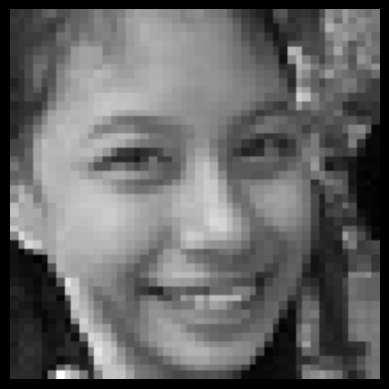

Image: /content/images/images/validation/happy/25420.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


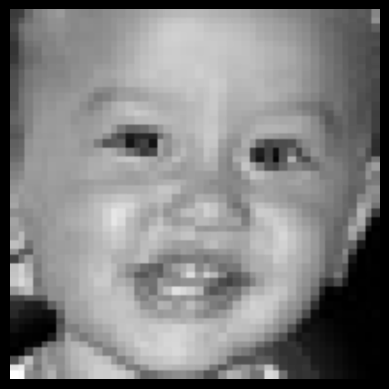

Image: /content/images/images/validation/happy/31285.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 27ms/step


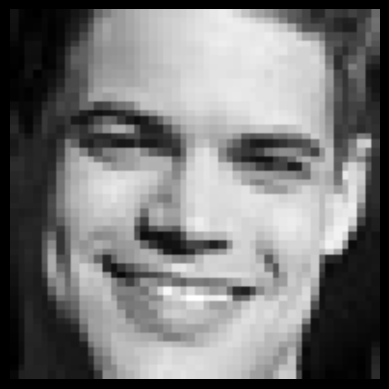

Image: /content/images/images/validation/happy/19105.jpg
Predicted class: happy
Probability: 98.4%
1/1 [==============================] - 0s 28ms/step


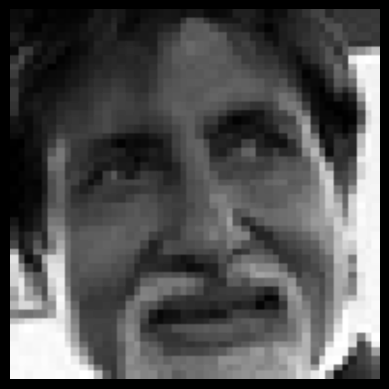

Image: /content/images/images/validation/happy/17021.jpg
Predicted class: neutral
Probability: 76.7%
1/1 [==============================] - 0s 26ms/step


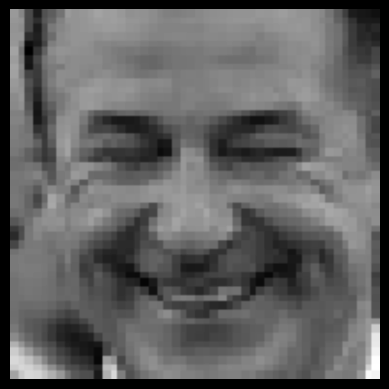

Image: /content/images/images/validation/happy/16370.jpg
Predicted class: happy
Probability: 100.%
1/1 [==============================] - 0s 27ms/step


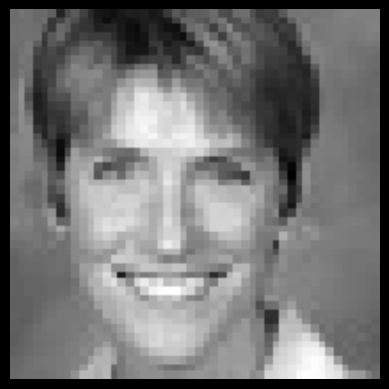

Image: /content/images/images/validation/happy/5954.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


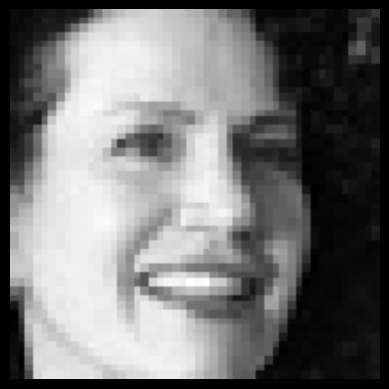

Image: /content/images/images/validation/happy/247.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 25ms/step


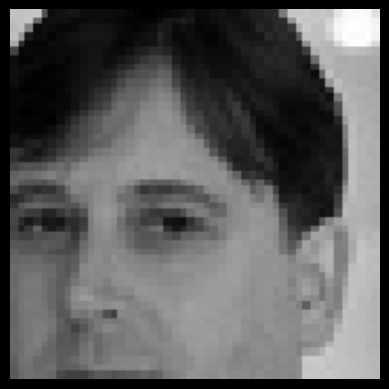

Image: /content/images/images/validation/happy/30909.jpg
Predicted class: angry
Probability: 54.0%
1/1 [==============================] - 0s 26ms/step


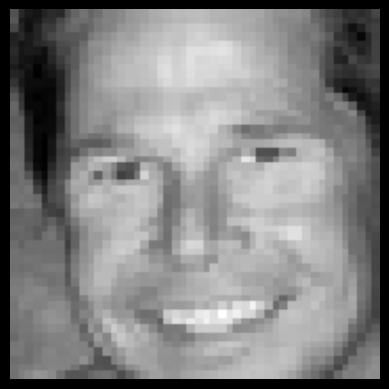

Image: /content/images/images/validation/happy/2730.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


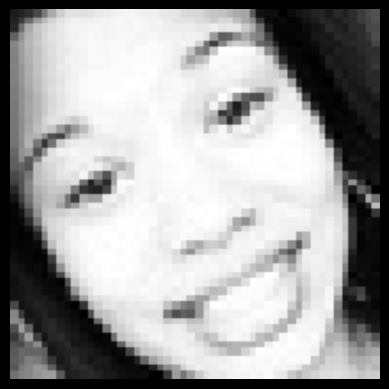

Image: /content/images/images/validation/happy/7986.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 34ms/step


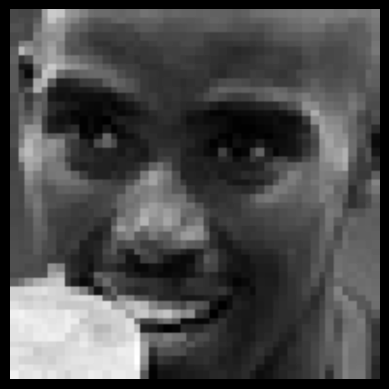

Image: /content/images/images/validation/happy/9538.jpg
Predicted class: happy
Probability: 90.7%
1/1 [==============================] - 0s 25ms/step


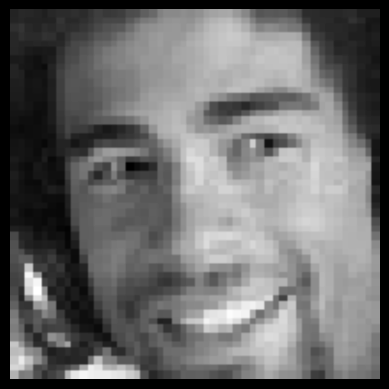

Image: /content/images/images/validation/happy/32627.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 29ms/step


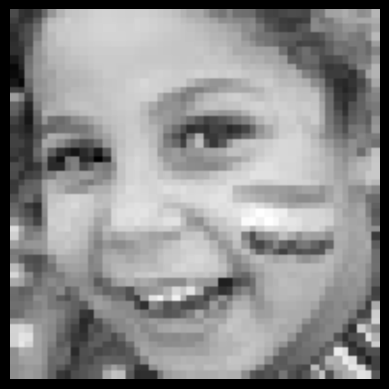

Image: /content/images/images/validation/happy/7713.jpg
Predicted class: happy
Probability: 100.%
1/1 [==============================] - 0s 43ms/step


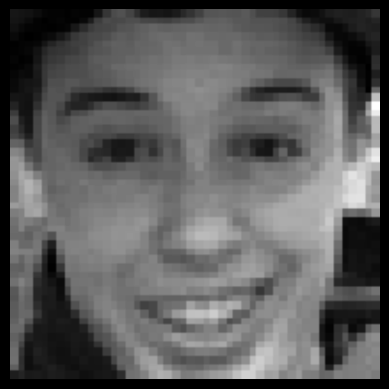

Image: /content/images/images/validation/happy/30683.jpg
Predicted class: happy
Probability: 99.8%
1/1 [==============================] - 0s 28ms/step


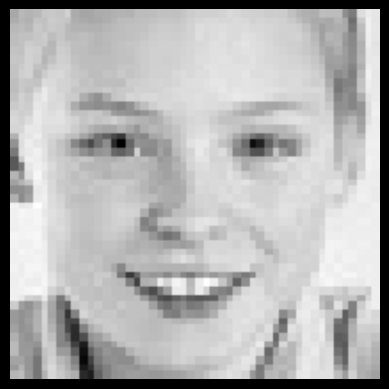

Image: /content/images/images/validation/happy/20988.jpg
Predicted class: happy
Probability: 99.7%
1/1 [==============================] - 0s 26ms/step


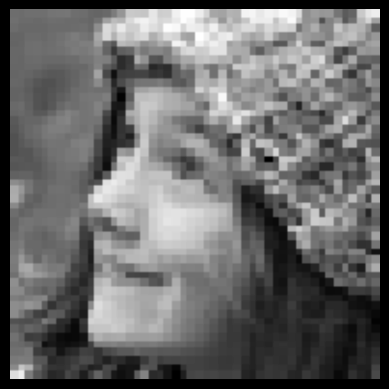

Image: /content/images/images/validation/happy/531.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 35ms/step


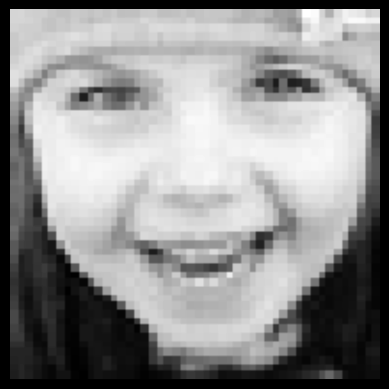

Image: /content/images/images/validation/happy/35582.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


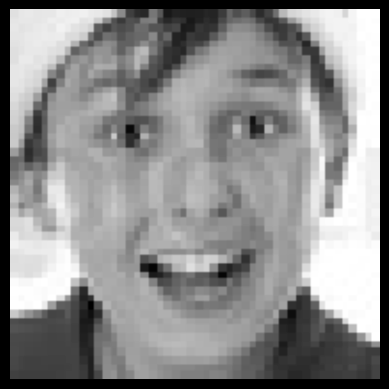

Image: /content/images/images/validation/happy/33144.jpg
Predicted class: surprise
Probability: 99.5%
1/1 [==============================] - 0s 26ms/step


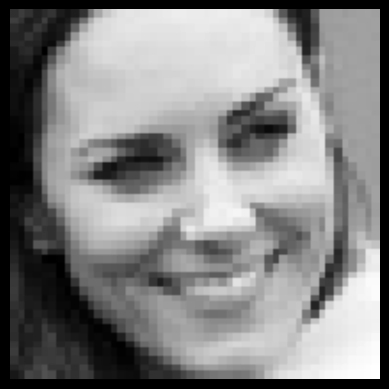

Image: /content/images/images/validation/happy/18165.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


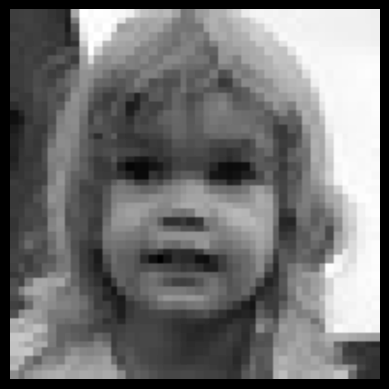

Image: /content/images/images/validation/happy/35787.jpg
Predicted class: neutral
Probability: 70.9%
1/1 [==============================] - 0s 29ms/step


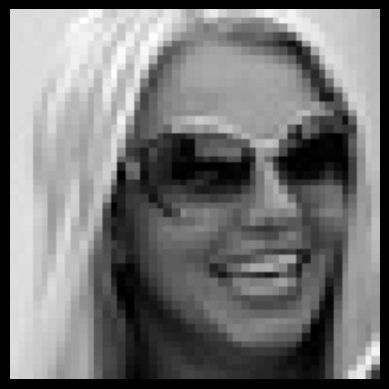

Image: /content/images/images/validation/happy/485.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


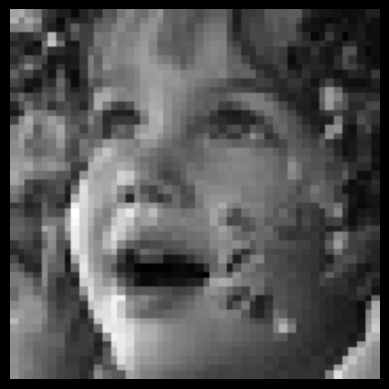

Image: /content/images/images/validation/happy/4849.jpg
Predicted class: happy
Probability: 89.9%
1/1 [==============================] - 0s 27ms/step


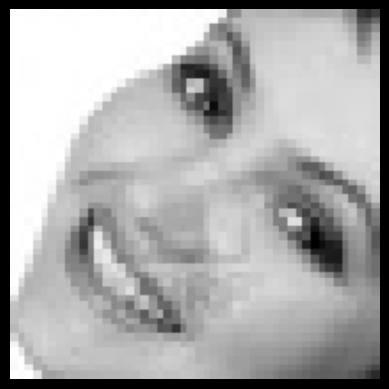

Image: /content/images/images/validation/happy/16770.jpg
Predicted class: happy
Probability: 100.%
1/1 [==============================] - 0s 36ms/step


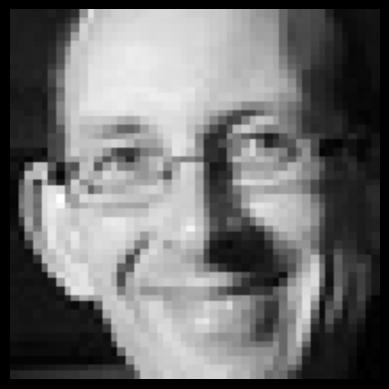

Image: /content/images/images/validation/happy/213.jpg
Predicted class: happy
Probability: 99.0%
1/1 [==============================] - 0s 26ms/step


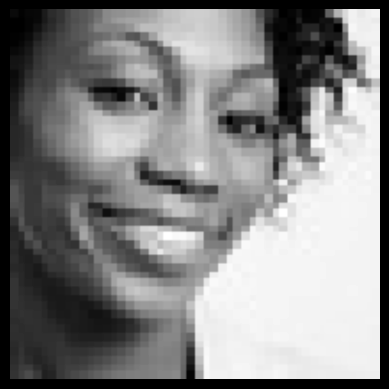

Image: /content/images/images/validation/happy/35321.jpg
Predicted class: angry
Probability: 93.3%
1/1 [==============================] - 0s 26ms/step


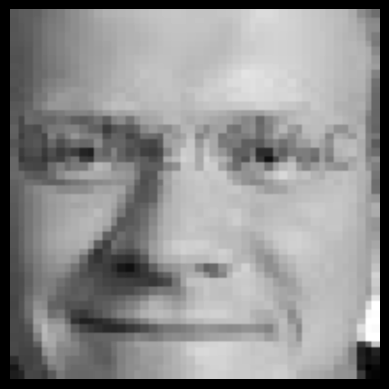

Image: /content/images/images/validation/happy/3543.jpg
Predicted class: happy
Probability: 93.3%
1/1 [==============================] - 0s 30ms/step


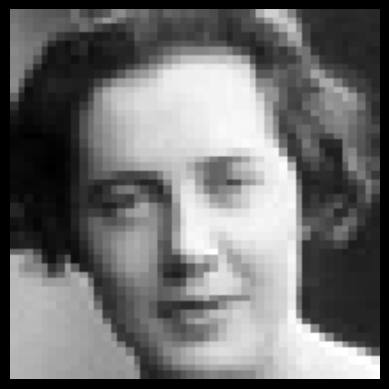

Image: /content/images/images/validation/happy/15455.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 45ms/step


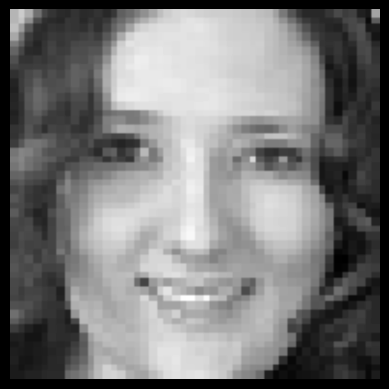

Image: /content/images/images/validation/happy/10622.jpg
Predicted class: happy
Probability: 98.1%
1/1 [==============================] - 0s 26ms/step


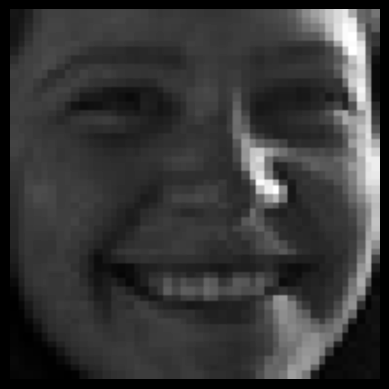

Image: /content/images/images/validation/happy/21305.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 40ms/step


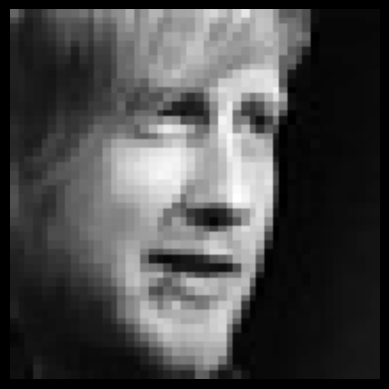

Image: /content/images/images/validation/happy/18827.jpg
Predicted class: happy
Probability: 94.4%
1/1 [==============================] - 0s 25ms/step


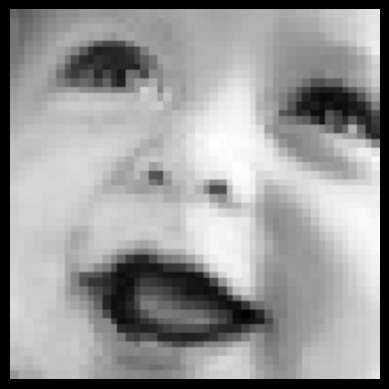

Image: /content/images/images/validation/happy/16619.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 25ms/step


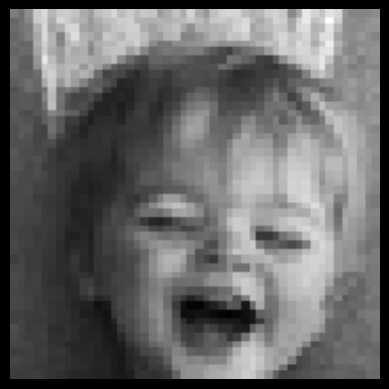

Image: /content/images/images/validation/happy/19711.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


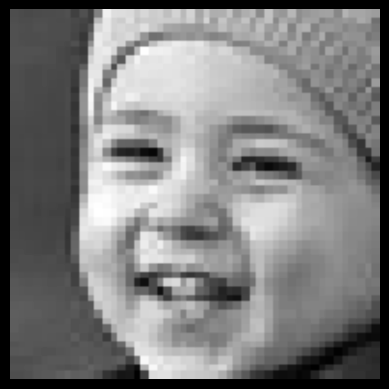

Image: /content/images/images/validation/happy/27152.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 34ms/step


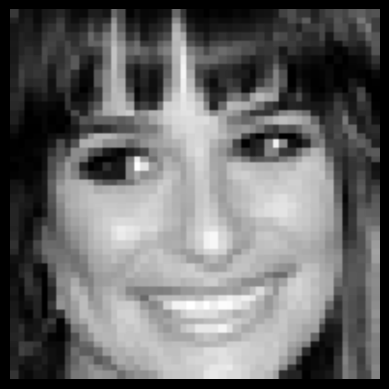

Image: /content/images/images/validation/happy/12359.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 27ms/step


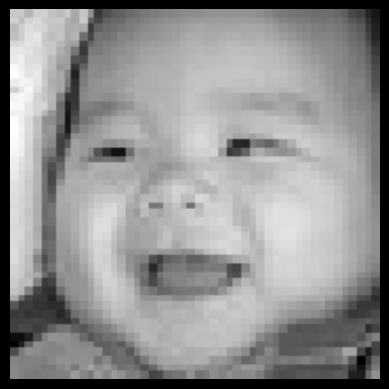

Image: /content/images/images/validation/happy/16141.jpg
Predicted class: happy
Probability: 99.7%
1/1 [==============================] - 0s 26ms/step


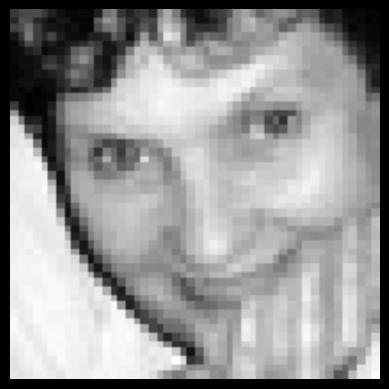

Image: /content/images/images/validation/happy/27779.jpg
Predicted class: happy
Probability: 89.9%
1/1 [==============================] - 0s 27ms/step


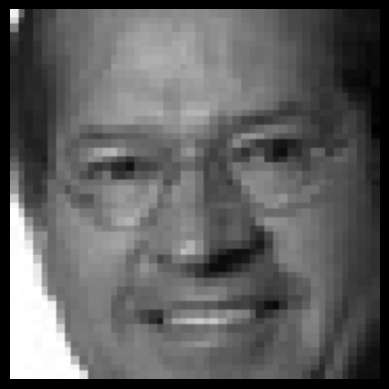

Image: /content/images/images/validation/happy/18405.jpg
Predicted class: happy
Probability: 99.5%
1/1 [==============================] - 0s 28ms/step


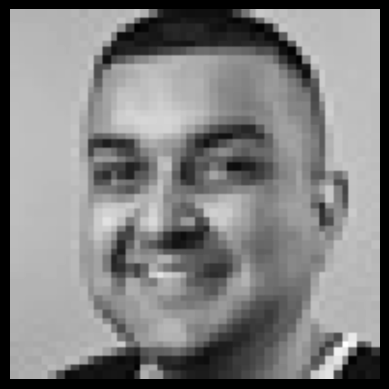

Image: /content/images/images/validation/happy/19245.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


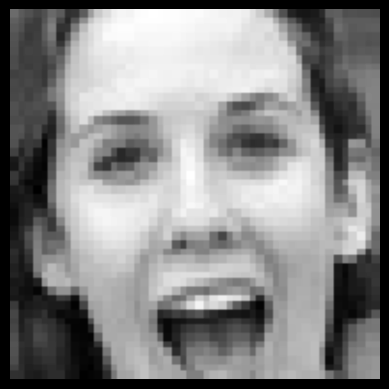

Image: /content/images/images/validation/happy/13968.jpg
Predicted class: angry
Probability: 41.7%
1/1 [==============================] - 0s 30ms/step


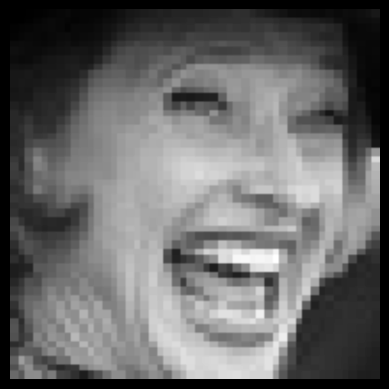

Image: /content/images/images/validation/happy/3120.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


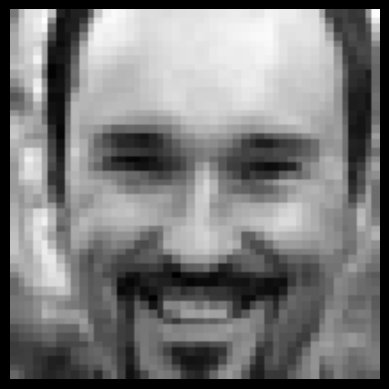

Image: /content/images/images/validation/happy/26935.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


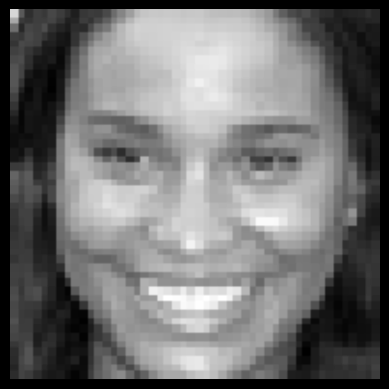

Image: /content/images/images/validation/happy/33046.jpg
Predicted class: happy
Probability: 99.4%
1/1 [==============================] - 0s 28ms/step


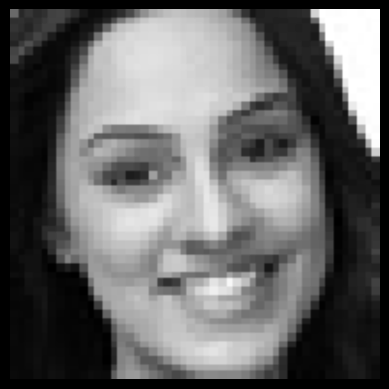

Image: /content/images/images/validation/happy/32595.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 39ms/step


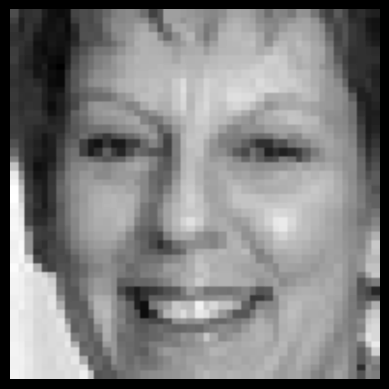

Image: /content/images/images/validation/happy/26338.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 45ms/step


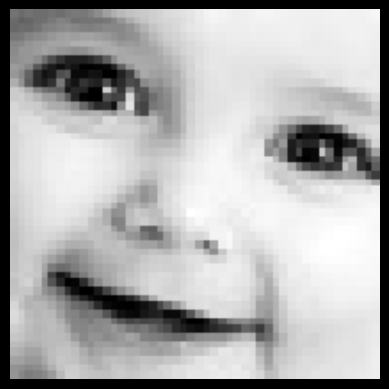

Image: /content/images/images/validation/happy/7379.jpg
Predicted class: happy
Probability: 98.5%
1/1 [==============================] - 0s 64ms/step


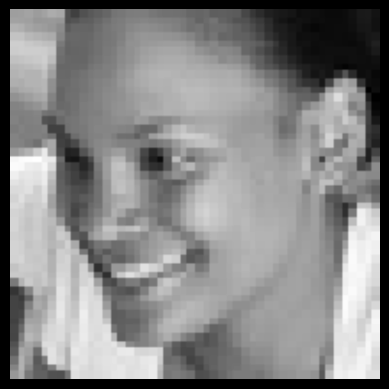

Image: /content/images/images/validation/happy/9152.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 44ms/step


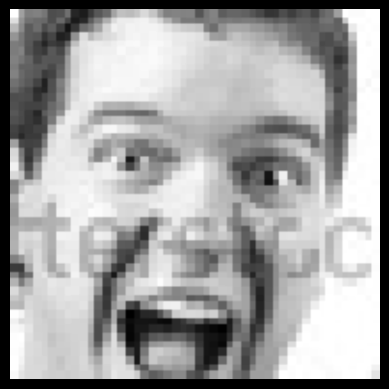

Image: /content/images/images/validation/happy/11835.jpg
Predicted class: happy
Probability: 53.1%
1/1 [==============================] - 0s 47ms/step


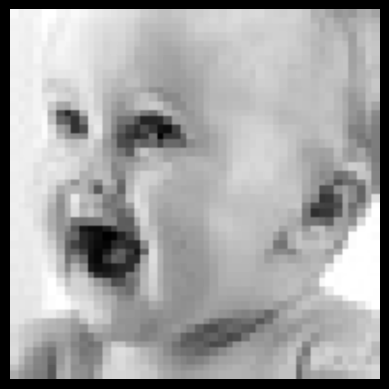

Image: /content/images/images/validation/happy/19449.jpg
Predicted class: happy
Probability: 88.5%
1/1 [==============================] - 0s 51ms/step


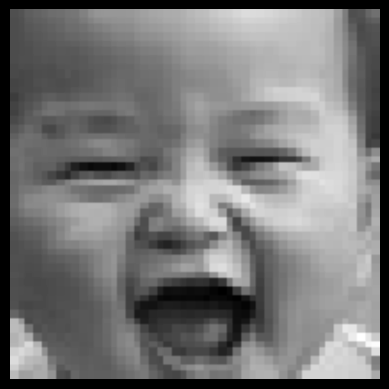

Image: /content/images/images/validation/happy/21846.jpg
Predicted class: happy
Probability: 99.1%
1/1 [==============================] - 0s 48ms/step


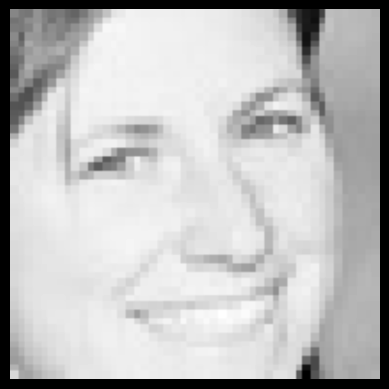

Image: /content/images/images/validation/happy/17694.jpg
Predicted class: happy
Probability: 97.1%
1/1 [==============================] - 0s 44ms/step


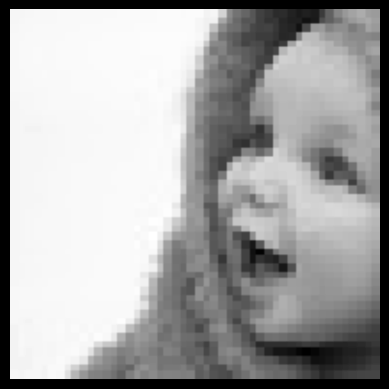

Image: /content/images/images/validation/happy/7511.jpg
Predicted class: happy
Probability: 99.0%
1/1 [==============================] - 0s 50ms/step


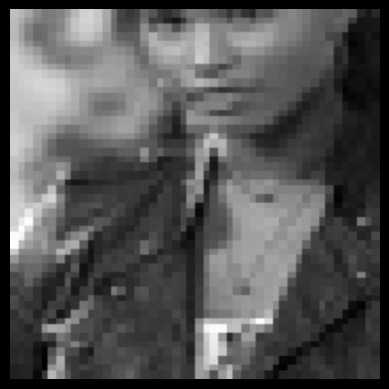

Image: /content/images/images/validation/happy/639.jpg
Predicted class: happy
Probability: 99.7%
1/1 [==============================] - 0s 33ms/step


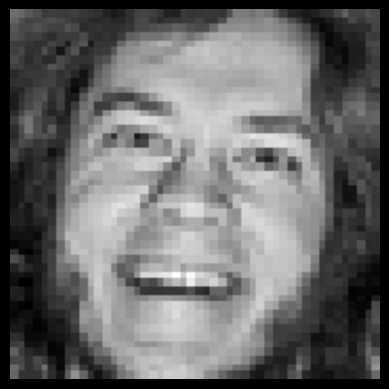

Image: /content/images/images/validation/happy/34316.jpg
Predicted class: happy
Probability: 99.0%
1/1 [==============================] - 0s 52ms/step


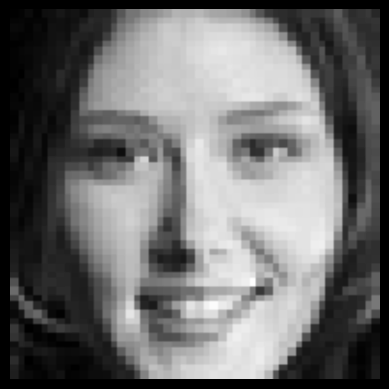

Image: /content/images/images/validation/happy/10362.jpg
Predicted class: happy
Probability: 73.0%
1/1 [==============================] - 0s 26ms/step


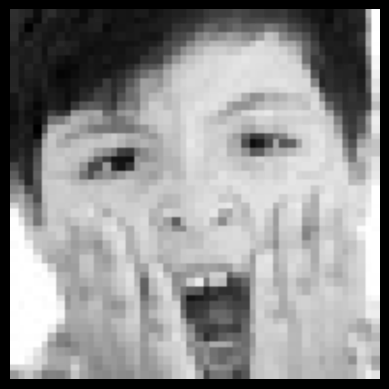

Image: /content/images/images/validation/happy/8691.jpg
Predicted class: neutral
Probability: 41.4%
1/1 [==============================] - 0s 27ms/step


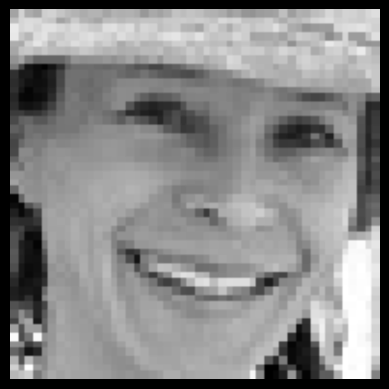

Image: /content/images/images/validation/happy/17381.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 37ms/step


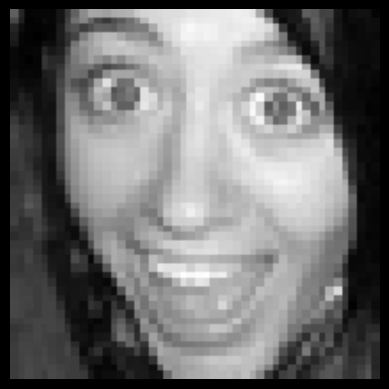

Image: /content/images/images/validation/happy/26660.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 47ms/step


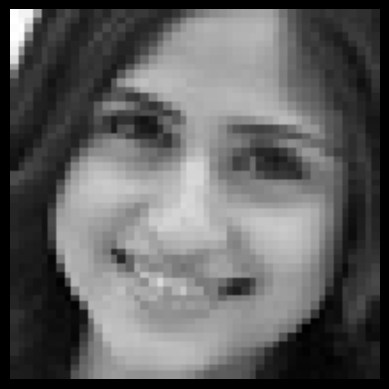

Image: /content/images/images/validation/happy/23525.jpg
Predicted class: happy
Probability: 98.7%
1/1 [==============================] - 0s 40ms/step


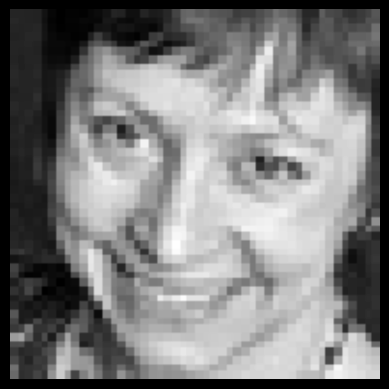

Image: /content/images/images/validation/happy/17397.jpg
Predicted class: happy
Probability: 99.8%
1/1 [==============================] - 0s 27ms/step


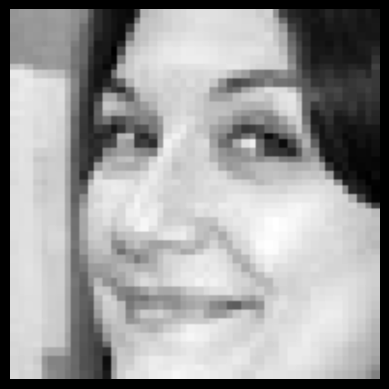

Image: /content/images/images/validation/happy/32388.jpg
Predicted class: happy
Probability: 99.8%
1/1 [==============================] - 0s 29ms/step


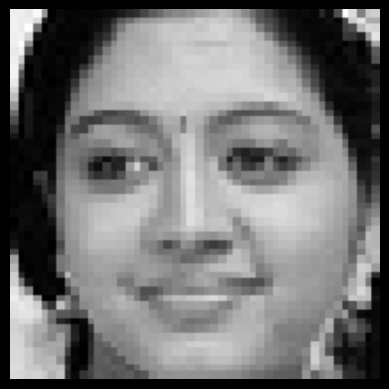

Image: /content/images/images/validation/happy/23453.jpg
Predicted class: happy
Probability: 87.2%
1/1 [==============================] - 0s 27ms/step


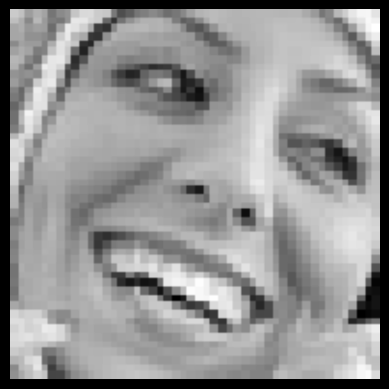

Image: /content/images/images/validation/happy/8473.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 33ms/step


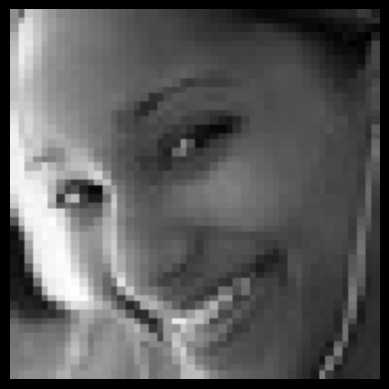

Image: /content/images/images/validation/happy/1152.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


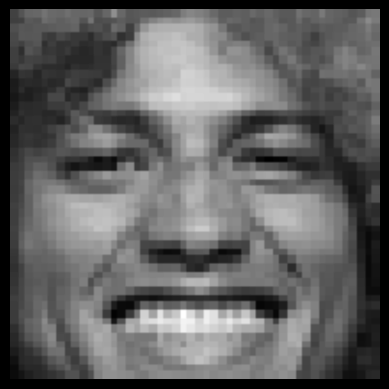

Image: /content/images/images/validation/happy/19514.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 36ms/step


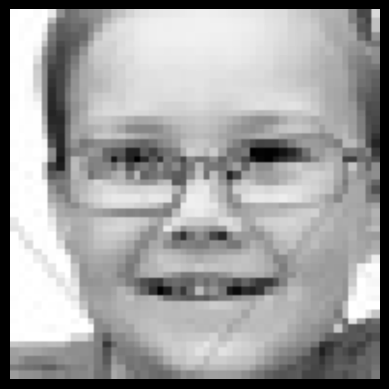

Image: /content/images/images/validation/happy/27940.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 31ms/step


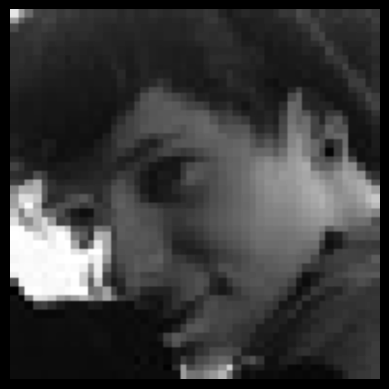

Image: /content/images/images/validation/happy/25454.jpg
Predicted class: happy
Probability: 94.0%
1/1 [==============================] - 0s 41ms/step


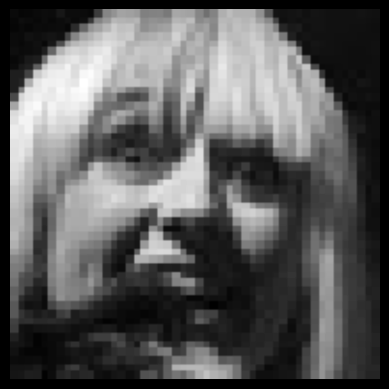

Image: /content/images/images/validation/happy/25438.jpg
Predicted class: happy
Probability: 46.7%
1/1 [==============================] - 0s 35ms/step


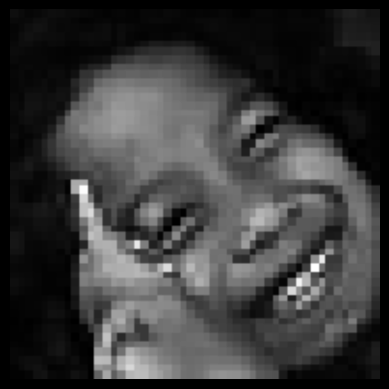

Image: /content/images/images/validation/happy/23612.jpg
Predicted class: happy
Probability: 99.8%
1/1 [==============================] - 0s 36ms/step


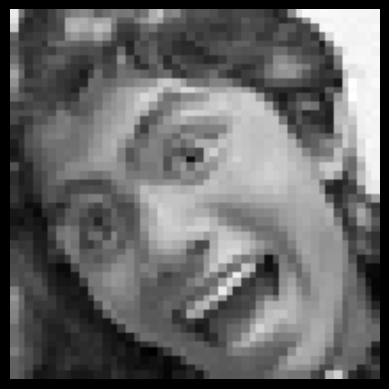

Image: /content/images/images/validation/happy/12257.jpg
Predicted class: happy
Probability: 64.8%
1/1 [==============================] - 0s 26ms/step


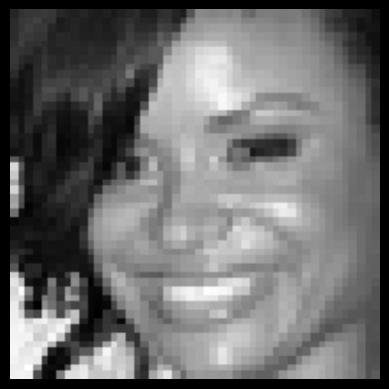

Image: /content/images/images/validation/happy/4980.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


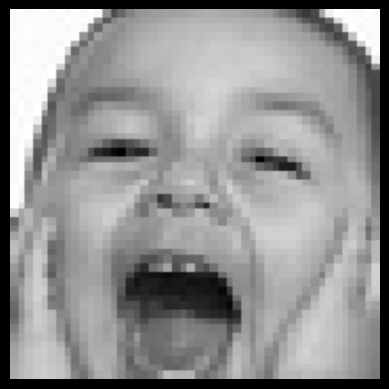

Image: /content/images/images/validation/happy/3411.jpg
Predicted class: happy
Probability: 98.0%
1/1 [==============================] - 0s 37ms/step


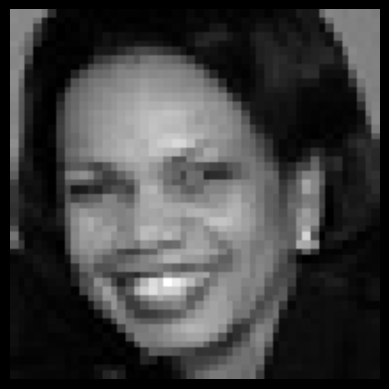

Image: /content/images/images/validation/happy/1628.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 26ms/step


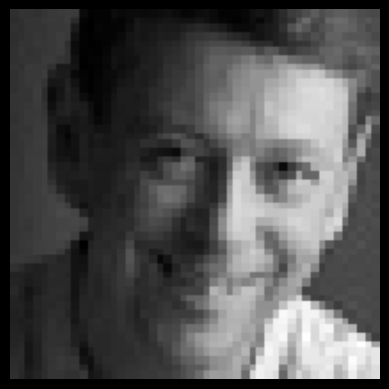

Image: /content/images/images/validation/happy/27823.jpg
Predicted class: happy
Probability: 97.7%
1/1 [==============================] - 0s 26ms/step


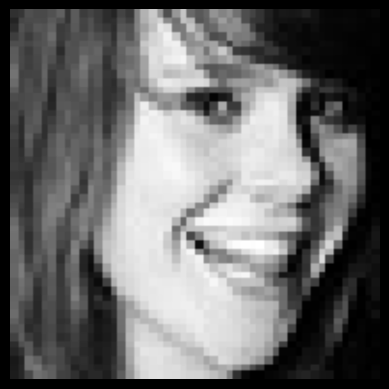

Image: /content/images/images/validation/happy/12024.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 30ms/step


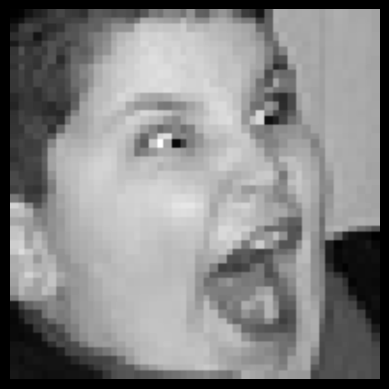

Image: /content/images/images/validation/happy/32684.jpg
Predicted class: surprise
Probability: 91.5%
1/1 [==============================] - 0s 27ms/step


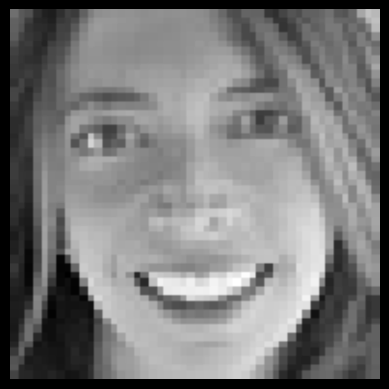

Image: /content/images/images/validation/happy/24299.jpg
Predicted class: happy
Probability: 93.8%
1/1 [==============================] - 0s 48ms/step


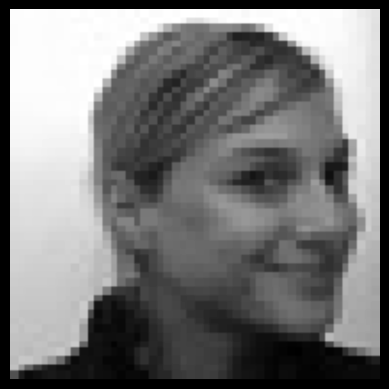

Image: /content/images/images/validation/happy/5558.jpg
Predicted class: neutral
Probability: 82.4%
1/1 [==============================] - 0s 26ms/step


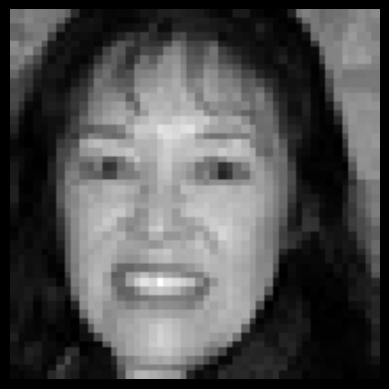

Image: /content/images/images/validation/happy/16550.jpg
Predicted class: happy
Probability: 99.6%
1/1 [==============================] - 0s 33ms/step


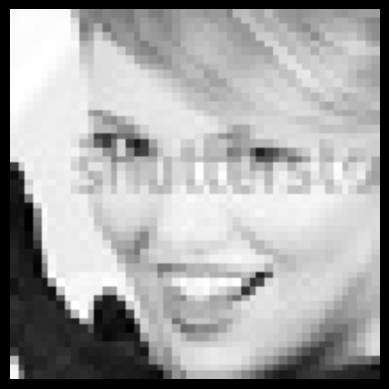

Image: /content/images/images/validation/happy/16818.jpg
Predicted class: happy
Probability: 99.8%
1/1 [==============================] - 0s 29ms/step


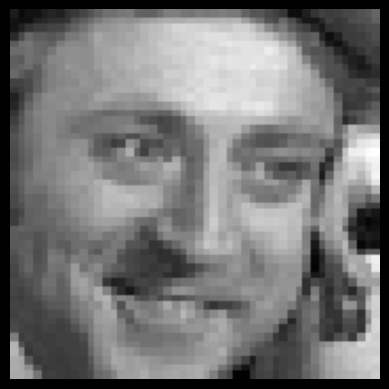

Image: /content/images/images/validation/happy/2064.jpg
Predicted class: happy
Probability: 98.2%
1/1 [==============================] - 0s 26ms/step


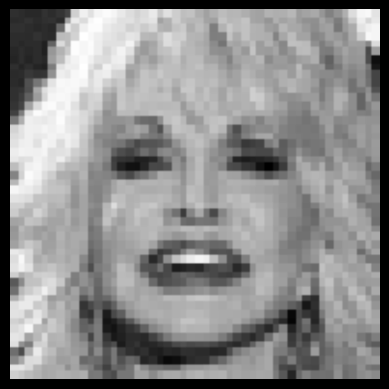

Image: /content/images/images/validation/happy/18531.jpg
Predicted class: happy
Probability: 98.1%
1/1 [==============================] - 0s 26ms/step


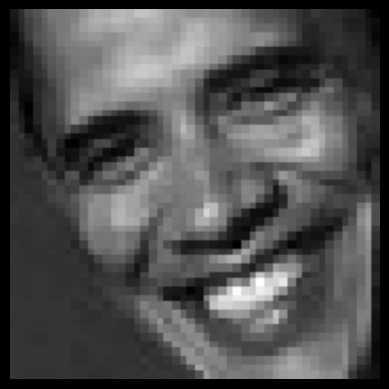

Image: /content/images/images/validation/happy/11785.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 46ms/step


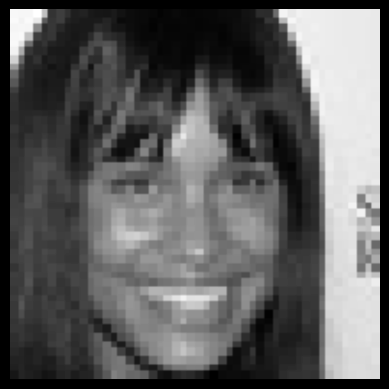

Image: /content/images/images/validation/happy/30675.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 34ms/step


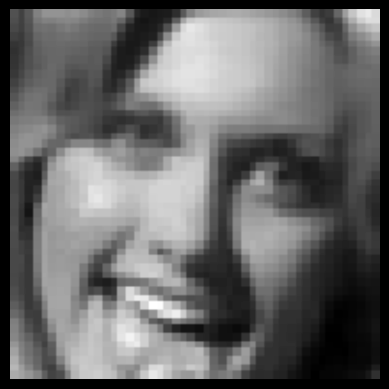

Image: /content/images/images/validation/happy/12487.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 38ms/step


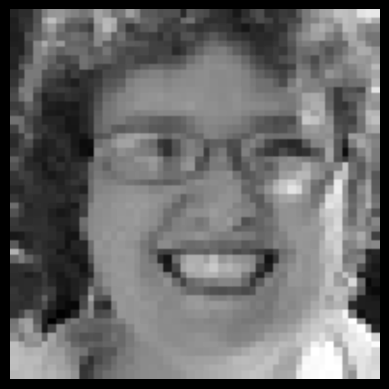

Image: /content/images/images/validation/happy/2820.jpg
Predicted class: happy
Probability: 99.9%
1/1 [==============================] - 0s 28ms/step


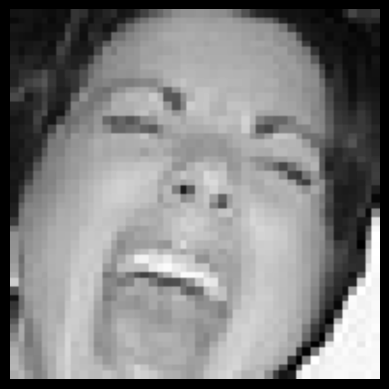

Image: /content/images/images/validation/happy/8086.jpg
Predicted class: happy
Probability: 95.5%
1/1 [==============================] - 0s 37ms/step


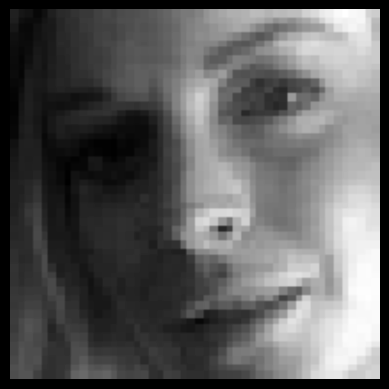

Image: /content/images/images/validation/happy/8649.jpg
Predicted class: happy
Probability: 91.2%


In [ ]:
import random
import tensorflow as tf

class_names = ['angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise']
test_dir = '/content/images/images/validation'
total_images_per_class = 100 # Jumlah gambar per kelas yang ingin diuji

correct_predictions = 0
total_predictions = 0

for class_name in os.listdir(test_dir):
    class_dir = os.path.join(test_dir, class_name)
    if os.path.isdir(class_dir):
        image_files = os.listdir(class_dir)
        random.shuffle(image_files)  # Acak urutan gambar dalam kelas
        image_files = image_files[:total_images_per_class]  # Ambil 1% dari gambar dalam kelas

        for image_name in image_files:
            image_path = os.path.join(class_dir, image_name)
            img = tf.keras.utils.load_img(image_path, color_mode='grayscale', target_size=(128, 128))
            x = tf.keras.utils.img_to_array(img)
            x = np.expand_dims(x, axis=0)
            x = x / 255.0
            prediction = model.predict(x)
            probability = prediction.flatten()
            max_prob = probability.max()
            index = prediction.argmax(axis=-1)[0]
            predicted_class = class_names[index]

            plt.imshow(img, cmap='gray')
            plt.axis('off')
            plt.show()

            print("Image:", image_path)
            print("Predicted class:", predicted_class)


            if predicted_class == class_name:
                correct_predictions += 1
            total_predictions += 1

# Menampilkan jumlah prediksi yang benar dan salah
print("Correct predictions:", correct_predictions)
print("Incorrect predictions:", total_predictions - correct_predictions)


In [ ]:
metrics = model.evaluate(test_set)

# Mengambil nilai metrik evaluasi
loss = metrics[0]
accuracy = metrics[1]
print("Tes Akurasi: ",accuracy)

56/56 [==============================] - 6s 103ms/step - loss: 0.5416 - accuracy: 0.8510
Tes Akurasi:  0.8509765267372131


In [ ]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score, accuracy_score, classification_report

prediksi = model.predict(test_set)
y_pred = np.argmax(prediksi, axis=1)
cm = confusion_matrix(test_set.classes, y_pred)


print('confusion matrix = ',cm)

56/56 [==============================] - 4s 68ms/step
confusion matrix =  [[128  10 131 255 208 142  86]
 [ 20   2  16  22  25  18   8]
 [136  24 114 252 189 180 123]
 [270  23 222 445 359 303 203]
 [153  10 159 350 217 195 132]
 [158  15 133 281 226 187 139]
 [120  13 110 203 136 131  84]]


In [ ]:
cr = classification_report(test_set.classes, y_pred, target_names=train_set.class_indices.keys())
print('classification report : ',cr)

classification report :                precision    recall  f1-score   support

       angry       0.13      0.13      0.13       960
     disgust       0.02      0.02      0.02       111
        fear       0.13      0.11      0.12      1018
       happy       0.25      0.24      0.24      1825
     neutral       0.16      0.18      0.17      1216
         sad       0.16      0.16      0.16      1139
    surprise       0.11      0.11      0.11       797

    accuracy                           0.17      7066
   macro avg       0.14      0.14      0.14      7066
weighted avg       0.17      0.17      0.17      7066



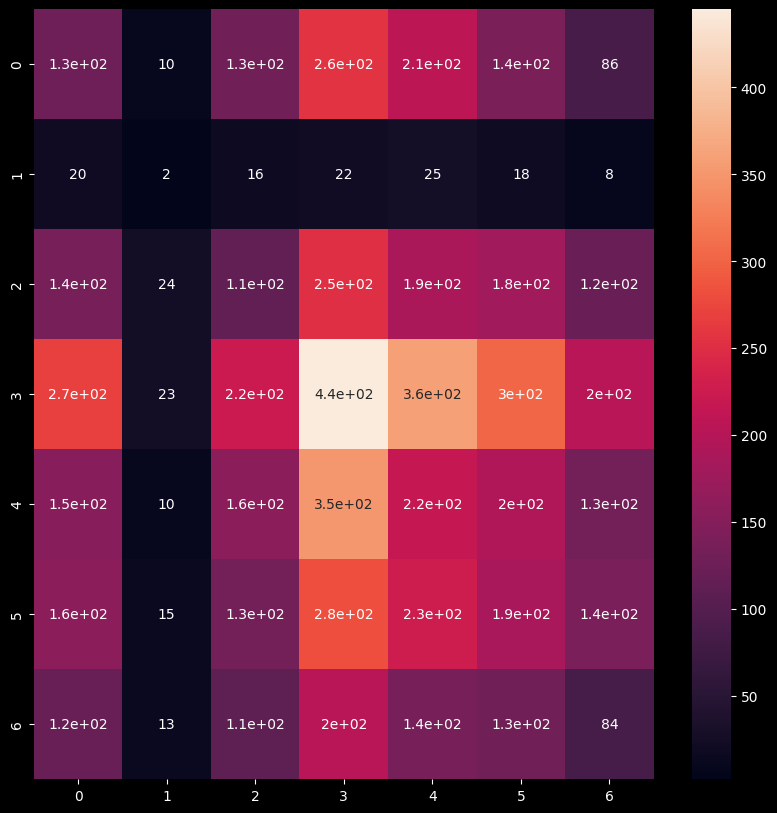

In [ ]:
import seaborn as sns

plt.figure(figsize=[10, 10])
sns.heatmap(cm, annot=True)
plt.show()

In [ ]:
model.save("./model.h5")